<h1> GAN comparison on Kaggle Credit Card Fraud Data </h1><br>
Cody Nash<br>
Development Notebook
<hr>

This notebook accompanies the Toptal blog found <a href='https://www.toptal.com/machine-learning/generative-adversarial-networks'>here</a>.<br>
<hr>


<a id="TOC"></a><h2>Table of Contents</h2>
<br>
<a href='#Setup'> Setup</a><br>
<br>
<a href='#EDA'> Exploratory Data Analysis (EDA)</a><br>
<a href='#xgboost fraud detection'> xgboost fraud detection</a><br>
<a href='#Classification'> Classification of fraud data</a><br>
<br>
<a href="#GAN setup"> GAN setup and training</a><br>
<br>
<a href="#Compare GAN Output"> Compare GAN Output</a><br>
<a href="#Generated Data Testing"> Generated Data Testing</a><br>
<a href="#Summary"> Summary of Training Data</a><br>
<br>
<a href="#DRAGAN"> DRAGAN testing</a><br>
<br>
<h3>Blog Figures:</h3>
<br>
<a href="#Fig3"> Figure 3: Data Distributions by Feature and Class</a><br>
<a href="#Fig5"> Figure 5: Comparison of GAN Outputs</a><br>
<a href="#Fig6"> Figure 6: Accuracy of Generated Data Detection</a><br>
<a href="#Fig7"> Figure 7: Differences in Critic Loss</a><br>
<a href="#Fig8"> Figure 8: Effects of Additional Data</a><br>

<a id="Setup"><h1>Setup</h1></a>

<a href='#TOC'>Table of contents</a>
<br><br>

- Load libraries
- Load common functions
- Load stored datasets
- Use linux for xgboost and tensorflow

In [1]:

# Load libraries and check memory

import psutil ; print(list(psutil.virtual_memory())[0:2])

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use('ggplot')

import xgboost as xgb

import pickle

import gc
gc.collect()
print(list(psutil.virtual_memory())[0:2])

[68719476736, 48781213696]
[68719476736, 48633081856]


In [2]:

# Load custom functions
import GAN_171103

# For reloading after making changes
import importlib
importlib.reload(GAN_171103) 
from GAN_171103 import *


Instructions for updating:
non-resource variables are not supported in the long term


In [3]:

# Load engineered dataset from EDA section

data = pickle.load(open('data/' + 'credicard.engineered.pkl','rb'))

# data columns will be all other columns except class
data_cols = list(data.columns[ data.columns != 'Class' ])
label_cols = ['Class']

print(data_cols)
print('# of data columns: ',len(data_cols))


['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount']
# of data columns:  30


In [4]:

# Put columns in order of importance for xgboost fraud detection (from that section)

# sorted_cols = ['V14', 'V4', 'V12', 'V10', 'V26', 'V17', 'Amount', 'V7', 'V21', 'V28', 'V20', 'V3', 'V18', 'V8', 'V13', 'V22', 'V16', 'V11', 'V19', 'V27', 'V5', 'V6', 'V25', 'V15', 'V24', 'V9', 'V1', 'V2', 'V23', 'Class']
# sorted_cols = ['V14', 'V4', 'V12', 'V10', 'Amount', 'V26', 'V17', 'Time', 'V7', 'V28', 'V21', 'V19', 'V8', 'V3', 'V22', 'V20', 'V25', 'V11', 'V6', 'V16', 'V27', 'V5', 'V18', 'V9', 'V1', 'V2', 'V15', 'V23', 'V24', 'V13', 'Class']
sorted_cols = ['V14', 'V4', 'V10', 'V17', 'Time', 'V12', 'V26', 'Amount', 'V21', 'V8', 'V11', 'V7', 'V28', 'V19', 'V3', 'V22', 'V6', 'V20', 'V27', 'V16', 'V13', 'V25', 'V24', 'V18', 'V2', 'V1', 'V5', 'V15', 'V9', 'V23', 'Class']

data = data[ sorted_cols ].copy()


In [5]:

# Add KMeans generated classes to fraud data - see classification section for more details on this

import sklearn.cluster as cluster

train = data.loc[ data['Class']==1 ].copy()

algorithm = cluster.KMeans
args, kwds = (), {'n_clusters':2, 'random_state':0}
labels = algorithm(*args, **kwds).fit_predict(train[ data_cols ])

print( pd.DataFrame( [ [np.sum(labels==i)] for i in np.unique(labels) ], columns=['count'], index=np.unique(labels) ) )

fraud_w_classes = train.copy()
fraud_w_classes['Class'] = labels


   count
0    357
1    135


In [6]:

# Function to create toy spiral dataset (looks like swiss roll)

def create_toy_spiral_df( n, seed=0):
    np.random.seed(seed)
    toy = np.array([ [ (i/10+1) * np.sin(i), -(i/10+1) * np.cos(i) ] for i in np.random.uniform(0,3*np.pi,size=n) ])
    toy = pd.DataFrame( toy, columns=[ ['v'+str(i+1) for i in range(2)] ])
    return toy

# toy = create_toy_spiral_df(1000)    
# plt.scatter( toy['v1'], toy['v2'] ) ;


In [7]:

# Function to create toy dataset of multiple groups of normal distributions in n dimensions

def create_toy_df( n, n_dim, n_classes, seed=0):
    toy = pd.DataFrame(columns=[ ['v'+str(i+1) for i in range(n_dim)] + ['Class'] ])
    toy_cols = toy.columns
    np.random.seed(seed)
    for class0 in range(n_classes):
        center0s = np.random.randint(-10,10,size=n_dim)/10
        var0s = np.random.randint(1,3,size=n_dim)/10
        temp = np.array([[class0]]*n)
        for dim0 in range(n_dim):
            temp = np.hstack( [np.random.normal(center0s[dim0],var0s[dim0],n).reshape(-1,1), temp] )
        toy = pd.concat([toy,pd.DataFrame(temp,columns=toy_cols)],axis=0).reset_index(drop=True)
    return toy

# toy = create_toy_df(n=1000,n_dim=2,n_classes=2,seed=0)
# plt.scatter(toy[toy.columns[0]],toy[toy.columns[1]],c=toy['Class'], alpha=0.2) ;


<a id="EDA"><h1>Exploratory Data Analysis (EDA)</h1></a>

<a href='#TOC'>Table of contents</a>
<br><br>

In [8]:

# Load the credit card data

# Original data available from:
# https://www.kaggle.com/dalpozz/creditcardfraud

data = pd.read_csv("data/creditcard.csv")
print(data.shape)
print(data.columns)
data.head(3)

(284807, 31)
Index(['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount',
       'Class'],
      dtype='object')


,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0


In [9]:

# data columns will be all other columns except class

label_cols = ['Class']
data_cols = list(data.columns[ data.columns != 'Class' ])

print(data_cols)
print('# of data columns: ',len(data_cols))


['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount']
# of data columns:  30


In [10]:

# 284315 normal transactions (class 0)
# 492 fraud transactions (class 1)

data.groupby('Class')['Class'].count()


Class
0    284315
1       492
Name: Class, dtype: int64

In [11]:

# Total nulls in dataset (sum over rows, then over columns)

data.isnull().sum().sum()


0

In [12]:

# Duplicates? Yes

normal_duplicates = sum( data.loc[ data.Class==0 ].duplicated() )
fraud_duplicates = sum( data.loc[ data.Class==1 ].duplicated() )
total_duplicates = normal_duplicates + fraud_duplicates

print( 'Normal duplicates', normal_duplicates )
print( 'Fraud duplicates', fraud_duplicates )
print( 'Total duplicates', total_duplicates )
print( 'Fraction duplicated', total_duplicates / len(data) )


Normal duplicates 1062
Fraud duplicates 19
Total duplicates 1081
Fraction duplicated 0.00379555277784605


Last time value: 48.00


/Users/scott/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:10: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.
  # Remove the CWD from sys.path while we load stuff.


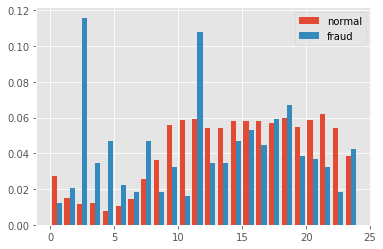

In [13]:

# 'Time' is seconds from first transaction in set
# 48 hours worth of data
# Let's convert time to time of day, in hours

print( 'Last time value: {:.2f}'.format( data['Time'].max() / 3600 ) )

data['Time'] = ( data['Time'].values / 3600 ) % 24

plt.hist( [ data.loc[ data['Class']==0, 'Time'], data.loc[ data['Class']==1, 'Time'] ],
         normed=True, label=['normal','fraud'], bins=np.linspace(0,24,25))
plt.legend()
plt.show()

# Looks like normal transactions have a bias towards 8am to midnight
# Fraud has spikes at 2-3am and noon


In [14]:

# several columns heavily skewed, 'Amount' the highest (besides Class)

data.skew()


Time      -0.499981
V1        -3.280667
V2        -4.624866
V3        -2.240155
V4         0.676292
V5        -2.425901
V6         1.826581
V7         2.553907
V8        -8.521944
V9         0.554680
V10        1.187141
V11        0.356506
V12       -2.278401
V13        0.065233
V14       -1.995176
V15       -0.308423
V16       -1.100966
V17       -3.844914
V18       -0.259880
V19        0.109192
V20       -2.037155
V21        3.592991
V22       -0.213258
V23       -5.875140
V24       -0.552499
V25       -0.415793
V26        0.576693
V27       -1.170209
V28       11.192091
Amount    16.977724
Class     23.997579
dtype: float64

In [15]:
# Minimum 'Amount' is 0
# 0's account for 0.6% of the data set

print( data['Amount'].min() )
print( np.sum( data['Amount']==0 ) )
# print( np.sum( data['Amount']<0.01 ) )
print( np.sum( data['Amount']==0 ) / len(data) )

0.0
1825
0.006407848121710491


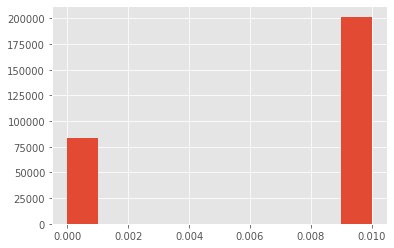

In [16]:
# Looks like all 'Amount' values are rounded to the hundredths (0.01) place
data['Amount'].mod(0.01).hist() ;

In [17]:

# Some values are much more frequent than others
# 0.00 comes in 12th in the list

print( data.Amount.value_counts().head(15) )


1.00     13688
1.98      6044
0.89      4872
9.99      4747
15.00     3280
0.76      2998
10.00     2950
1.29      2892
1.79      2623
0.99      2304
20.00     2002
0.00      1825
8.99      1811
11.50     1741
4.49      1579
Name: Amount, dtype: int64


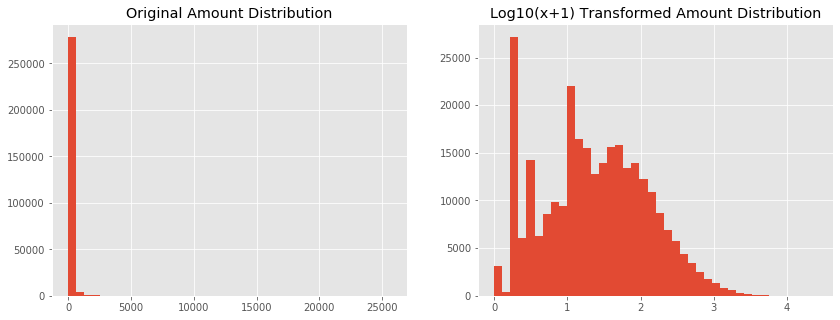

In [18]:
# Log transform amount values to give more normal distribution

plt.figure(figsize=(14,5))
plt.subplot(1,2,1)
plt.hist(data['Amount'], bins=40)
plt.title('Original Amount Distribution')

plt.subplot(1,2,2)
d0 = np.log10( data['Amount'].values + 1 )
# d0 = np.log1p( data['Amount'].values ) / np.log(10)
plt.hist( d0, bins=40 )
plt.title('Log10(x+1) Transformed Amount Distribution')
plt.show()

In [19]:

# Use log transformed data

data['Amount'] = d0


In [20]:

# Center and scale all data, only using the middle 99.8%, so outliers don't pull too much.
# First generate the percentile data for each feature

percentiles =  pd.DataFrame( np.array([ np.percentile( data[i], [ 0.1, 99.9 ] ) for i in data_cols ]).T,
                            columns=data_cols, index=['min','max'] )

percentile_means = \
    [ [ np.mean( data.loc[ (data[i]>percentiles[i]['min']) & (data[i]<percentiles[i]['max']) , i ] ) ]
     for i in data_cols ]

percentiles = percentiles.append( pd.DataFrame(np.array(percentile_means).T, columns=data_cols, index=['mean']) )

percentile_stds = \
    [ [ np.std( data.loc[ (data[i]>percentiles[i]['min']) & (data[i]<percentiles[i]['max']) , i ] ) ]
     for i in data_cols ]

percentiles = percentiles.append( pd.DataFrame(np.array(percentile_stds).T, columns=data_cols, index=['stdev']) )

percentiles


,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
min,0.025833,-16.044343,-15.126221,-9.870326,-4.163262,-9.408512,-5.290163,-9.365179,-13.102174,-3.305247,...,-6.621889,-5.490204,-3.119845,-5.452756,-2.001248,-2.403083,-1.276676,-3.823857,-2.629030,0.000000
max,23.965278,2.344685,7.852129,3.387393,6.235906,8.074611,6.164944,7.972745,6.135087,5.960836,...,5.809376,7.879007,2.260348,4.759942,1.246819,1.873743,2.251097,2.607462,2.095818,3.477266
mean,14.543063,0.020195,0.012756,0.011923,-0.003827,0.002532,-0.000677,0.001153,0.011022,-0.002363,...,0.002214,-0.002930,0.001083,0.002081,0.000089,0.000504,-0.001117,0.001314,-0.000914,1.375513
stdev,5.827070,1.814661,1.429787,1.419404,1.383725,1.208541,1.263637,1.018486,0.956445,1.064801,...,0.595668,0.550113,0.704365,0.433626,0.596816,0.505554,0.474011,0.330955,0.223416,0.710045


In [21]:

# Center and scale the data using the percentile data we just generated

data[data_cols] = ( data[data_cols] - percentiles.loc[ 'mean', data_cols ] ) / percentiles.loc[ 'stdev', data_cols ]


In [22]:

# # Or we can center and scale using all of the data

# from sklearn.preprocessing import StandardScaler

# data[data_cols] = StandardScaler().fit_transform(data[data_cols])


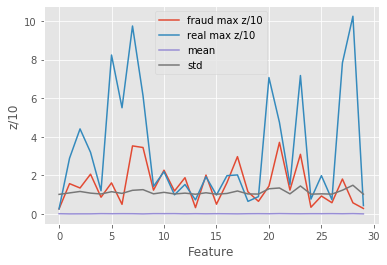

In [23]:
# There are outliers, 50-100 stdevs away from mean in several columns

plot_cols = data_cols
# plt.plot( np.log10( data[ plot_cols ].abs().max().values ) )
# plt.plot( data[ plot_cols ].abs().max().values / data[ plot_cols ].std().values / 10, label='max z/10' )
plt.plot( data.loc[ data.Class==1, plot_cols ].abs().max().values / data[ plot_cols ].std().values / 10, label='fraud max z/10' )
plt.plot( data.loc[ data.Class==0, plot_cols ].abs().max().values / data[ plot_cols ].std().values / 10, label='real max z/10' )
plt.plot( data[ plot_cols ].mean().values, label='mean' )
# plt.plot( data[ plot_cols ].abs().mean().values, label='abs mean' )
plt.plot( data[ plot_cols ].std().values, label='std' )
plt.xlabel('Feature')
plt.ylabel('z/10')
plt.legend() ; 


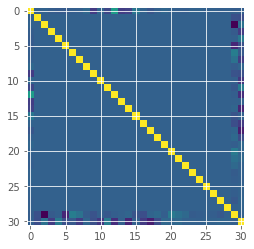

In [24]:
# Check Correlations
# Note no correlations among PCA transformed columns, as expected
corr0 = data.corr()
plt.imshow(corr0) ;

In [25]:

# Looking at correlation values

# np.round(corr0[['Time','Amount','Class']],2)
# plt.imshow( np.round(corr0[['Time','Amount','Class']],2) ) ;
# corr0[data_cols]
# np.round(corr0[data_cols],1)
# np.round(corr0[data_cols],1)


<a id="Fig3"><h1>Figure 3: Data Distributions by Feature and Class</h1></a><br>
<a href='#TOC'>Table of contents</a>

/Users/scott/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.
  


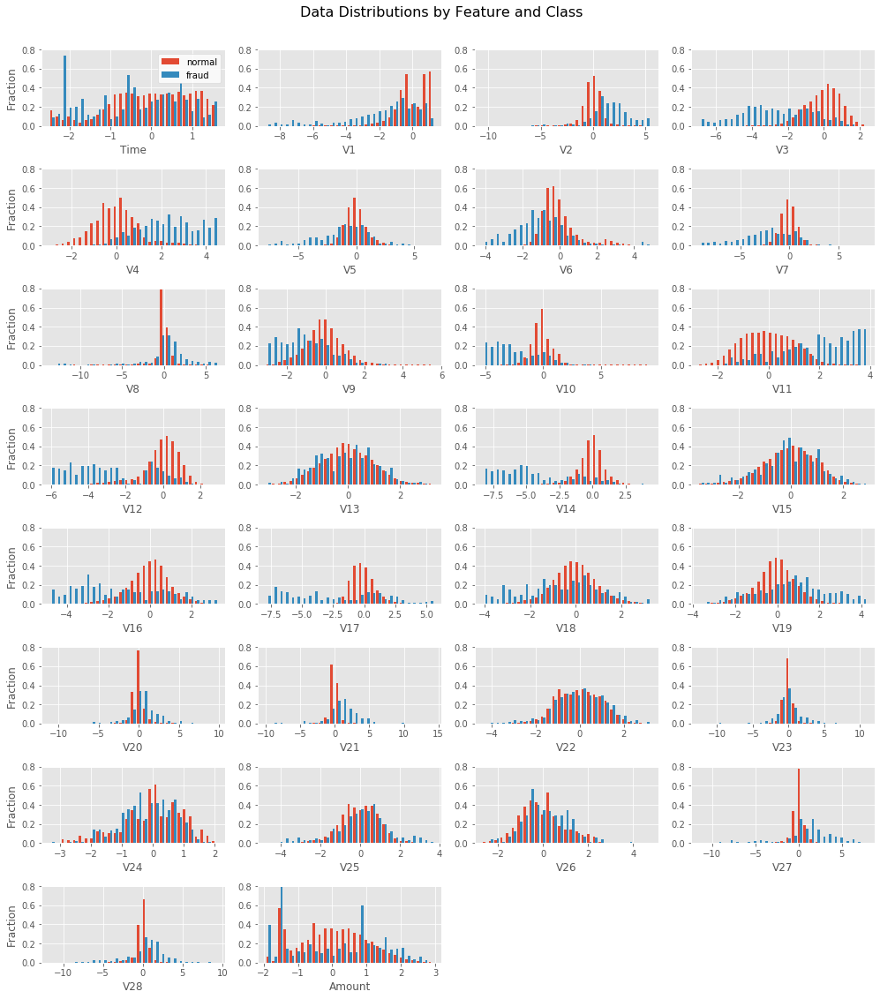

In [26]:

# Plot the data by each feature

axarr = [[]]*len(data_cols)
columns = 4
rows = int( np.ceil( len(data_cols) / columns ) )
f, fig = plt.subplots( figsize=(columns*3.5, rows*2) )

f.suptitle('Data Distributions by Feature and Class', size=16)

for i, col in enumerate(data_cols[:]):
    axarr[i] = plt.subplot2grid( (int(rows), int(columns)), (int(i//columns), int(i%columns)) )
    axarr[i].hist( [ data.loc[ data.Class == 0, col ], data.loc[ data.Class == 1, col ] ], label=['normal','fraud'], 
                          bins=np.linspace( np.percentile(data[col],0.1), np.percentile(data[col],99.9), 30 ),
                          normed=True )
    axarr[i].set_xlabel(col, size=12)
    axarr[i].set_ylim([0,0.8])
    axarr[i].tick_params(axis='both', labelsize=10)
    if i == 0: 
        legend = axarr[i].legend()
        legend.get_frame().set_facecolor('white')
    if i%4 != 0 : 
        axarr[i].tick_params(axis='y', left='off', labelleft='off')
    else:
        axarr[i].set_ylabel('Fraction',size=12)

plt.tight_layout(rect=[0,0,1,0.95]) # xmin, ymin, xmax, ymax
# plt.savefig('plots/Engineered_Data_Distributions.png')
plt.show()

In [27]:

# Save engineered dataset for use in analysis
# Save as pickle for faster reload

pickle.dump(data, open('data/' + 'credicard.engineered.pkl','wb'))


In [28]:

# # Save as csv for human readability - much slower save

# data.to_csv('data/' + 'credicard.engineered.csv.zip')


<a id="xgboost fraud detection"><h1>xgboost fraud detection</h1></a>

<a href='#TOC'>Table of contents</a>
<br><br>

- Here we'll use the xgboost algorithm to detect fraud cases

In [29]:

# define the columns we want to test on, in case we want to use less than the full set

test_cols = data.columns

# test_cols = data.columns[ data.columns != 'Amount' ]

print(len(test_cols))
print(test_cols)

31
Index(['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount',
       'Class'],
      dtype='object')


In [30]:

# Define some custom metric functions for use with the xgboost algorithm
# https://github.com/dmlc/xgboost/blob/master/demo/guide-python/custom_objective.py

from sklearn.metrics import recall_score, precision_score, roc_auc_score

def recall(preds, dtrain):
    labels = dtrain.get_label()
    return 'recall',  recall_score(labels, np.round(preds), average='macro')

def precision(preds, dtrain):
    labels = dtrain.get_label()
    return 'precision',  precision_score(labels, np.round(preds))

def roc_auc(preds, dtrain):
    labels = dtrain.get_label()
    return 'roc_auc',  roc_auc_score(labels, preds)


In [31]:
# Set up the test and train sets

np.random.seed(0)

n_real = np.sum(data.Class==0) # 200000
n_test = np.sum(data.Class==1) # 492
train_fraction = 0.7
fn_real = int(n_real * train_fraction)
fn_test = int(n_test * train_fraction)

real_samples = data.loc[ data.Class==0, test_cols].sample(n_real, replace=False).reset_index(drop=True)
test_samples = data.loc[ data.Class==1, test_cols].sample(n_test, replace=False).reset_index(drop=True)

train_df = pd.concat([real_samples[:fn_real],test_samples[:fn_test]],axis=0,ignore_index=True).reset_index(drop=True)
# train_df = pd.concat([real_samples[:fn_test],test_samples[:fn_test]],axis=0,ignore_index=True).reset_index(drop=True)

test_df = pd.concat([real_samples[fn_real:],test_samples[fn_test:]],axis=0,ignore_index=True).reset_index(drop=True)
print( 'classes 0, 1: ', n_real, n_test )
print( 'train, test: ', len(train_df), len(test_df) )

X_col = test_df.columns[:-1]
y_col = test_df.columns[-1]
dtrain = xgb.DMatrix(train_df[X_col], train_df[y_col], feature_names=X_col)
dtest = xgb.DMatrix(test_df[X_col], test_df[y_col], feature_names=X_col)


classes 0, 1:  284315 492
train, test:  199364 85443


In [32]:

# Run the xgboost algorithm, maximize recall on the test set

results_dict = {}

xgb_params = {
#     'max_depth': 4,
    'objective': 'binary:logistic',
    'random_state': 0,
    'eval_metric': 'auc', # auc, error
#     'tree_method': 'hist'
#     'grow_policy': 'lossguide' # depthwise, lossguide
}

xgb_test = xgb.train(xgb_params, dtrain, num_boost_round=100, 
                     verbose_eval=False,
                     early_stopping_rounds=20, 
                     evals=[(dtrain,'train'),(dtest,'test')],
                     evals_result = results_dict,              
                     feval = recall, maximize=True
#                      feval = roc_auc, maximize=True
                    )

y_pred = xgb_test.predict(dtest, ntree_limit=xgb_test.best_iteration+1)
y_true = test_df['Class'].values
print( 'best iteration: ', xgb_test.best_iteration )
print( recall( y_pred, dtest ) )
print( precision( y_pred, dtest ) )
print( roc_auc( y_pred, dtest ) )
# print( 'Accuracy: {:.3f}'.format(SimpleAccuracy(y_pred, y_true)) )
SimpleMetrics( np.round(y_pred), y_true)

/Users/scott/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


best iteration:  1
('recall', 0.8681846231600028)
('precision', 0.9159663865546218)
('roc_auc', 0.9086121219994835)
Confusion Matrix


,Pred 0,Pred 1
True 0,85285,10
True 1,39,109


Accuracy : 0.9994265182636377


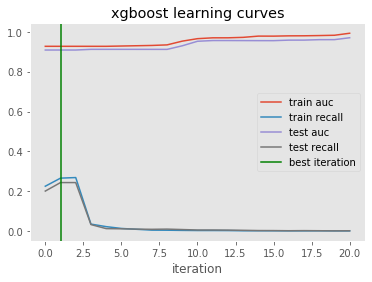

In [33]:

# Let's look at how the metrics changed on the train and test sets as more trees were added

for i in results_dict:
    for err in results_dict[i]:
        plt.plot(results_dict[i][err], label=i+' '+err)   
plt.axvline(xgb_test.best_iteration, c='green', label='best iteration')
plt.xlabel('iteration')
# plt.ylabel(err)
plt.title('xgboost learning curves')
plt.legend()
plt.grid() ;

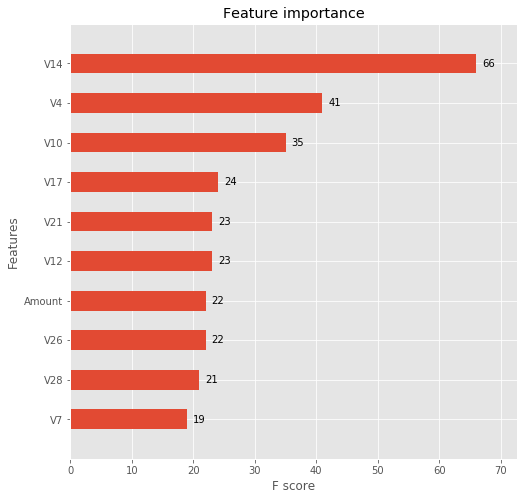

In [34]:
# Plot feature importances

fig, ax = plt.subplots(1, 1, figsize=(8, 8))
xgb.plot_importance(xgb_test, max_num_features=10, height=0.5, ax=ax);

In [35]:

# Generate list of features sorted by importance in detecting fraud
# https://stackoverflow.com/questions/613183/sort-a-python-dictionary-by-value

import operator
x = xgb_test.get_fscore()
sorted_x = sorted(x.items(), key=operator.itemgetter(1), reverse=True)

# print( 'Top eight features for fraud detection: ', [ i[0] for i in sorted_x[:8] ] )

sorted_cols = [i[0] for i in sorted_x] + ['Class']
print( sorted_cols )


['V14', 'V4', 'V10', 'V17', 'V12', 'V21', 'V26', 'Amount', 'V28', 'Time', 'V7', 'V11', 'V5', 'V20', 'V8', 'V16', 'V27', 'V1', 'V3', 'V25', 'V6', 'V24', 'V18', 'V13', 'V15', 'V19', 'V22', 'V9', 'V23', 'V2', 'Class']


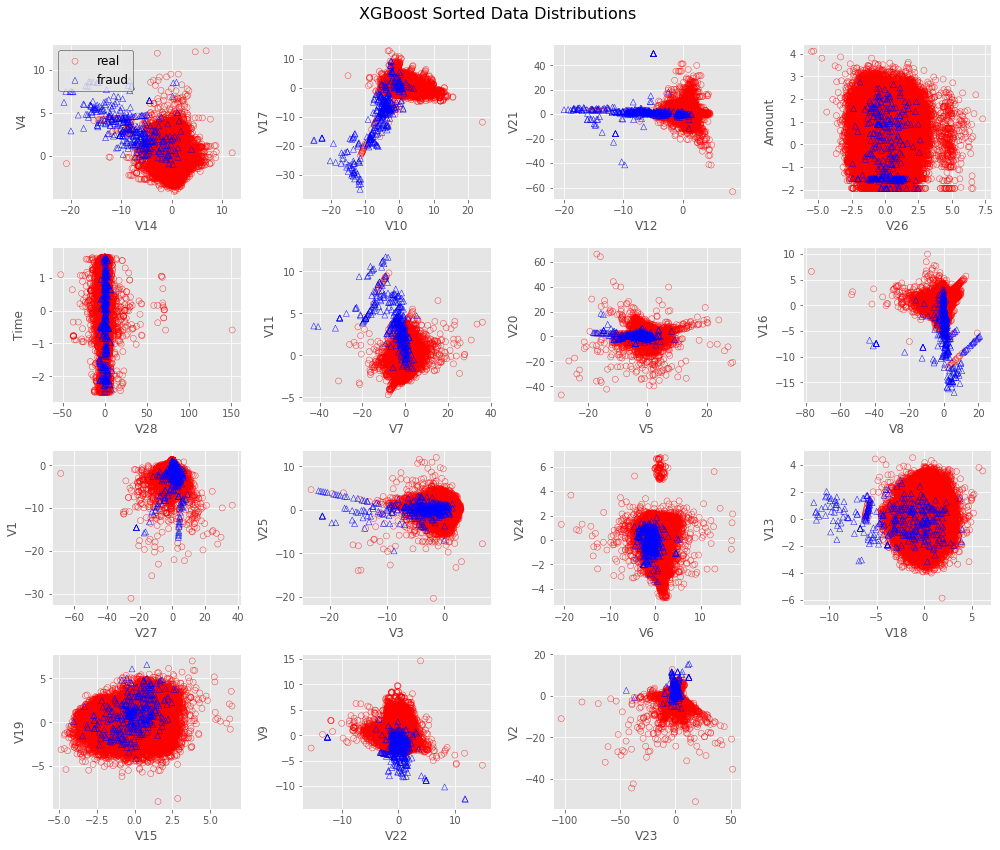

In [36]:

# Plot all of the training data with paired features sorted by importance
# This takes a while

colors = ['red','blue']
markers = ['o','^']
labels = ['real','fraud']
alphas = [0.7, 0.9]

columns = 4
rows = int( np.ceil( len(data_cols) / columns / 2 ) )
plt.figure( figsize=(columns*3.5, rows*3) )
plt.suptitle('XGBoost Sorted Data Distributions ', size=16)

train = train_df.copy()

for i in range( int(np.floor(len(sorted_x)/2)) )[:]:
    col1, col2 = sorted_x[i*2][0], sorted_x[i*2+1][0]
#     print(i,col1,col2)
    
    plt.subplot(rows,columns,i+1)  
    for group, color, marker, label, alpha in zip( train.groupby('Class'), colors, markers, labels, alphas ):
        plt.scatter( group[1][col1], group[1][col2], 
                         label=label, marker=marker, alpha=alpha,
                         edgecolors=color, facecolors='none' )         
    plt.xlabel(col1, size=12)
    plt.ylabel(col2, size=12)
    plt.tick_params(axis='both', labelsize=10)
    if i == 0: plt.legend(fontsize=12, edgecolor='black')

plt.tight_layout(rect=[0,0,1,0.95]) # xmin, ymin, xmax, ymax
# plt.savefig('plots/XGB_Sorted_Data_Distributions.png')
plt.show()


In [37]:


# Lets look at the effect of the ratio of normal:fraud data in the dataset on recall and roc_auc
# We'll use cross validation to see if differences are significant


np.random.seed(0)

n_real = np.sum(data.Class==0) # 200000
n_test = np.sum(data.Class==1) # 492
real_samples = data.loc[ data.Class==0, test_cols].sample(n_real, replace=False).reset_index(drop=True)
test_samples = data.loc[ data.Class==1, test_cols].sample(n_test, replace=False).reset_index(drop=True)
X_col = data.columns[:-1]
y_col = data.columns[-1]

test_data=[]

# for i in [1]:
# for i in [0.1,0.5,1,2,10]:
for i in np.logspace(-1,2,8):
    print(i)
    train_df = pd.concat([real_samples[:int(n_test*i)],test_samples[:n_test]],axis=0,ignore_index=True).reset_index(drop=True)
    dtrain = xgb.DMatrix(train_df[X_col], train_df[y_col], feature_names=X_col)
    results = xgb.cv(xgb_params, dtrain, 
                     nfold=5, num_boost_round=100, early_stopping_rounds=10, seed=0,
                     feval=recall)
    test_data.append(list([i]) + list(results.tail(1).index) + list(results.tail(1).values[0]))
    
test_data = pd.DataFrame(test_data, columns=list(['ratio','best'])+list(results.columns))
test_data

0.1


/Users/scott/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0.2682695795279726
0.7196856730011519
1.9306977288832496
5.17947467923121
13.894954943731374
37.27593720314938
100.0


,ratio,best,train-auc-mean,train-auc-std,test-auc-mean,test-auc-std,train-recall-mean,train-recall-std,test-recall-mean,test-recall-std
0,0.100000,19,1.000000,0.000000,0.987674,0.009681,0.000287,0.000184,0.011109,0.005263
1,0.268270,28,1.000000,0.000000,0.984642,0.010055,0.000115,0.000094,0.002578,0.000976
2,0.719686,49,1.000000,0.000000,0.982564,0.004454,0.000000,0.000000,0.002637,0.000844
3,1.930698,40,1.000000,0.000000,0.979363,0.011075,0.000090,0.000073,0.001065,0.000768
4,5.179475,22,1.000000,0.000000,0.981739,0.002739,0.003604,0.000288,0.000307,0.000307
5,13.894955,11,0.998651,0.001054,0.977056,0.007871,0.004408,0.000977,0.000584,0.000625
6,37.275937,42,1.000000,0.000000,0.981079,0.007558,0.001143,0.000164,0.000413,0.000495
7,100.000000,45,1.000000,0.000000,0.977775,0.015200,0.001763,0.000189,0.000665,0.000360


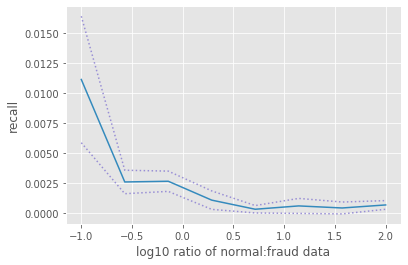

In [38]:

# Recall decreases as more normal data is added

# metric = 'auc'
metric = 'recall'
# xs = test_data['ratio'].values
xs = np.log10(test_data['ratio'].values)
ys = test_data['test-'+metric+'-mean'].values
stds = test_data['test-'+metric+'-std'].values
plt.plot(xs,ys,c='C1')
plt.plot(xs,ys+stds,linestyle=':',c='C2')
plt.plot(xs,ys-stds,linestyle=':',c='C2')
plt.xlabel('log10 ratio of normal:fraud data')
plt.ylabel(metric)
# plt.ylim([0.96,1.01])
plt.show()

<a id="Classification"><h1>Classification</h1></a>

<a href='#TOC'>Table of contents</a>

In [39]:

# load clustering libraries

import sklearn.cluster as cluster


In [40]:

# hdbscan not in kaggle/python at present

import hdbscan


In [41]:

# Set up training set to consist of only fraud data

train = data.loc[ data['Class']==1 ].copy()

print( pd.DataFrame( [ [np.sum(train['Class']==i)] for i in np.unique(train['Class']) ], columns=['count'], index=np.unique(train['Class']) ) )

# train = pd.get_dummies(train, columns=['Class'], prefix='Class')
label_cols = [ i for i in train.columns if 'Class' in i ]
data_cols = [ i for i in train.columns if i not in label_cols ]
train_no_label = train[ data_cols ]


   count
1    492


In [42]:
%%time

# TSNE is an interesting method to map higher dimensional data into two dimensions
# http://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html

# Note TSNE map may not be what you might think:
# https://distill.pub/2016/misread-tsne/

# Create multiple projections to compare results from different random states

from sklearn.manifold import TSNE

projections = [ TSNE(random_state=i).fit_transform(train_no_label) for i in range(3) ]


CPU times: user 16.1 s, sys: 184 ms, total: 16.3 s
Wall time: 2.16 s


0 KMeans
1 Agglomerative
2 HDBSCAN


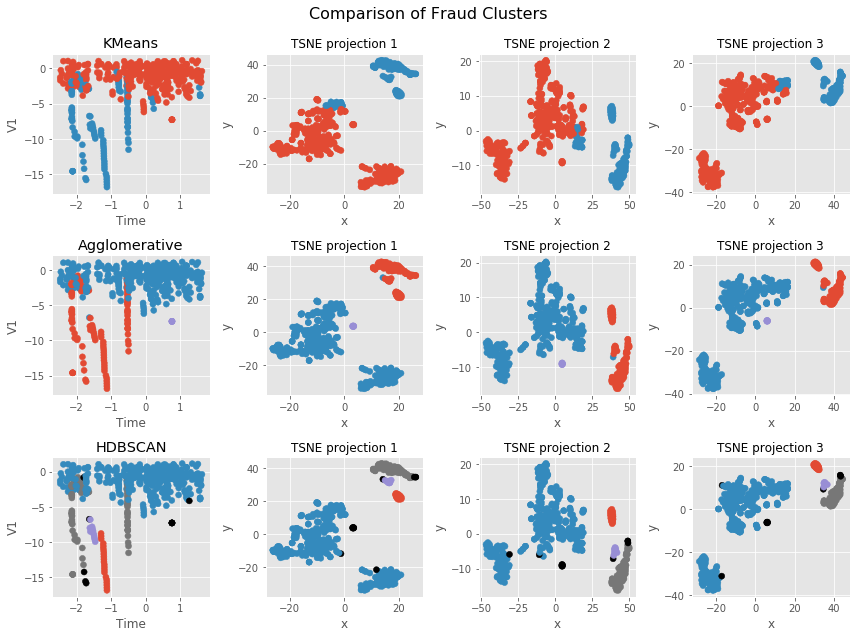

CPU times: user 2.85 s, sys: 47.3 ms, total: 2.89 s
Wall time: 1.65 s


In [43]:
%%time 

# Now we'll compare some different clustering algorithms
# https://github.com/scikit-learn-contrib/hdbscan/blob/master/docs/comparing_clustering_algorithms.rst

algorithms = [ 
#     [ 'KMeans', cluster.KMeans, (), {'random_state':0} ],
    [ 'KMeans', cluster.KMeans, (), {'n_clusters':2, 'random_state':0} ],
#     [ 'KMeans 3', cluster.KMeans, (), {'n_clusters':3, 'random_state':0} ],
#     [ 'Agglomerative', cluster.AgglomerativeClustering, (), {} ],
    [ 'Agglomerative', cluster.AgglomerativeClustering, (), {'linkage': 'ward', 'n_clusters': 3} ],
#     [ 'Agg. Ave 3', cluster.AgglomerativeClustering, (), {'linkage': 'average', 'n_clusters': 3} ],
#     [ 'Agg. Complete 3', cluster.AgglomerativeClustering, (), {'linkage': 'complete', 'n_clusters': 3} ],
#     [ 'DBSCAN', cluster.DBSCAN, (), {'eps':0.025} ],
#     [ 'HDBSCAN', hdbscan.HDBSCAN, (), {} ],
    [ 'HDBSCAN', hdbscan.HDBSCAN, (), {'min_cluster_size':10, 'min_samples':1, } ],
#     [ 'HDBSCAN 2 10', hdbscan.HDBSCAN, (), {'min_cluster_size':2, 'min_samples':10, } ],
#     [ 'HDBSCAN 10 10 ', hdbscan.HDBSCAN, (), {'min_cluster_size':10, 'min_samples':10, } ],
]

rows = len(algorithms)
columns = 4
plt.figure(figsize=(columns*3, rows*3))

for i, [name, algorithm, args, kwds] in enumerate(algorithms):
    print(i, name)

    labels = algorithm(*args, **kwds).fit_predict(train_no_label)
#     labels = algorithm(*args, **kwds).fit_predict(projections[0])
    
#     print( pd.DataFrame( [ [np.sum(labels==i)] for i in np.unique(labels) ], columns=['count'], index=np.unique(labels) ) )
    
    colors = np.clip(labels,-1,9)
    colors = [ 'C'+str(i) if i>-1 else 'black' for i in colors ]
    
    plt.subplot(rows,columns,i*columns+1)
    plt.scatter(train_no_label[data_cols[0]], train_no_label[data_cols[1]], c=colors)
    plt.xlabel(data_cols[0]), plt.ylabel(data_cols[1])
    plt.title(name)

    for j in range(3):
        plt.subplot(rows,columns,i*columns+1+j+1)
        plt.scatter(*(projections[j].T), c=colors) 
        plt.xlabel('x'), plt.ylabel('y')
        plt.title('TSNE projection '+str(j+1),size=12)
        
#     break

plt.suptitle('Comparison of Fraud Clusters', size=16)
plt.tight_layout(rect=[0,0,1,0.95])
plt.savefig('plots/Fraud_Cluster_Diagram.png')
plt.show()

In [44]:

# Now pick a set of labels and add to the dataset

algorithm = cluster.KMeans
args, kwds = (), {'n_clusters':2, 'random_state':0}
labels = algorithm(*args, **kwds).fit_predict(train_no_label)
# labels = algorithm(*args, **kwds).fit_predict(projections[0])

print( pd.DataFrame( [ [np.sum(labels==i)] for i in np.unique(labels) ], columns=['count'], index=np.unique(labels) ) )

fraud_w_classes = train.copy()
fraud_w_classes['Class'] = labels


   count
0    357
1    135


In [45]:

# Let's see which features are most useful for detecting differences between the classes:

dtrain = xgb.DMatrix(fraud_w_classes[data_cols], fraud_w_classes['Class'], feature_names=data_cols)

xgb_params = {
    'objective': 'binary:logistic',
    'random_state': 0,
    'eval_metric': 'auc', # allows for balanced or unbalanced classes 
    }
xgb_test = xgb.train(xgb_params, dtrain, num_boost_round=10) # limit to ten rounds for fast evaluation

import operator
x = xgb_test.get_fscore()
sorted_x = sorted(x.items(), key=operator.itemgetter(1), reverse=True)
print( 'Top eight features: ', [ [i[0],i[1]] for i in sorted_x[:8] ] )


Top eight features:  [['V17', 10], ['V7', 5], ['V10', 5], ['V4', 2], ['V3', 2], ['V6', 1], ['V11', 1], ['V15', 1]]


<a id="GAN setup"><h1>GAN setup and training</h1></a>

<a href='#TOC'>Table of contents</a>


Resources:

https://github.com/wayaai/GAN-Sandbox
<br>
http://blog.richardweiss.org/2017/07/21/conditional-wasserstein-gan.html



Conversion of Waya.ai GAN and WGAN
- Remove convolutional layers
- Remove ResNeXt
- Add simple dense networks
- Convert WGAN back to simple GAN
- Use common functions as much as possible



For these functions I've passed the arguments as lists because it was easy to implement.

Standard solutions (because they are more stable) include using keyword dictionaries or objects, but those create a larger code base.


In [83]:


# reloading the libraries and setting the parameters

import GAN_171103
import importlib
importlib.reload(GAN_171103) # For reloading after making changes
from GAN_171103 import *

rand_dim = 32 # 32 # needs to be ~data_dim
base_n_count = 128 # 128

nb_steps = 500 + 1 # 50000 # Add one for logging of the last interval
batch_size = 128 # 64

k_d = 1  # number of critic network updates per adversarial training step
k_g = 1  # number of generator network updates per adversarial training step
critic_pre_train_steps = 100 # 100  # number of steps to pre-train the critic before starting adversarial training
log_interval = 100 # 100  # interval (in steps) at which to log loss summaries and save plots of image samples to disc
learning_rate = 5e-4 # 5e-5
data_dir = 'cache/'
generator_model_path, discriminator_model_path, loss_pickle_path = None, None, None

# show = False
show = True 

# train = create_toy_spiral_df(1000)
# train = create_toy_df(n=1000,n_dim=2,n_classes=4,seed=0)
train = fraud_w_classes.copy().reset_index(drop=True) # fraud only with labels from classification

# train = pd.get_dummies(train, columns=['Class'], prefix='Class', drop_first=True)
label_cols = [ i for i in train.columns if 'Class' in i ]
data_cols = [ i for i in train.columns if i not in label_cols ]
train[ data_cols ] = train[ data_cols ] / 10 # scale to random noise size, one less thing to learn
train_no_label = train[ data_cols ]

data_dim:  30
data_cols:  ['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount']
Model: "generator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_20 (InputLayer)        [(None, 32)]              0         
_________________________________________________________________
dense_64 (Dense)             (None, 128)               4224      
_________________________________________________________________
dense_65 (Dense)             (None, 256)               33024     
_________________________________________________________________
dense_66 (Dense)             (None, 512)               131584    
_________________________________________________________________
dense_67 (Dense)             (None, 30)                15390     
Total params: 184,222
T

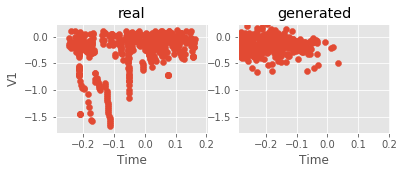

Step: 100 of 501.
Losses: G, D Gen, D Real, Xgb: 0.8735, 0.9396, 0.3812, 0.9939
D Real - D Gen: -0.5584


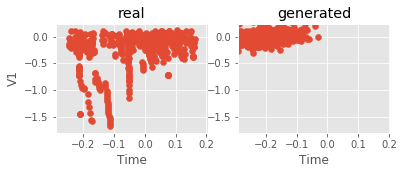

Step: 200 of 501.
Losses: G, D Gen, D Real, Xgb: 1.2840, 0.5962, 0.7808, 1.0000
D Real - D Gen: 0.1845


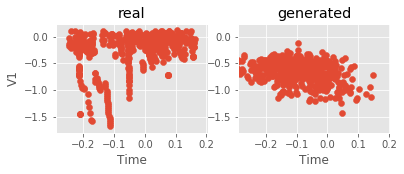

Step: 300 of 501.
Losses: G, D Gen, D Real, Xgb: 1.0762, 0.5633, 0.6206, 0.9776
D Real - D Gen: 0.0573


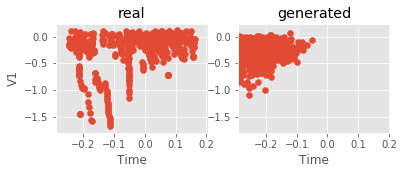

Step: 400 of 501.
Losses: G, D Gen, D Real, Xgb: 1.1149, 0.5726, 0.7738, 0.9715
D Real - D Gen: 0.2012


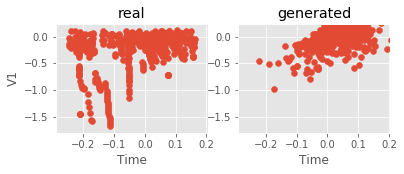

Step: 500 of 501.
Losses: G, D Gen, D Real, Xgb: 1.0992, 0.6376, 0.5785, 0.9695
D Real - D Gen: -0.0591


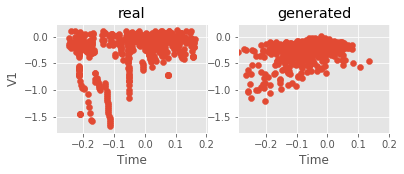

data_dim:  30
data_cols:  ['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount']
label_dim:  1
label_cols:  ['Class']
Model: "generator"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_22 (InputLayer)           [(None, 32)]         0                                            
__________________________________________________________________________________________________
input_23 (InputLayer)           [(None, 1)]          0                                            
__________________________________________________________________________________________________
concatenate_6 (Concatenate)     (None, 33)           0           input_22[0][0]                   
                   

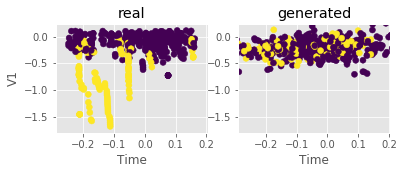

Step: 100 of 501.
Losses: G, D Gen, D Real, Xgb: 0.7193, 1.1316, 0.5928, 0.9858
D Real - D Gen: -0.5388


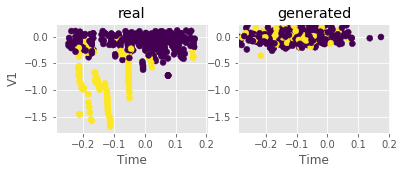

Step: 200 of 501.
Losses: G, D Gen, D Real, Xgb: 1.6714, 0.4262, 0.5015, 1.0000
D Real - D Gen: 0.0753


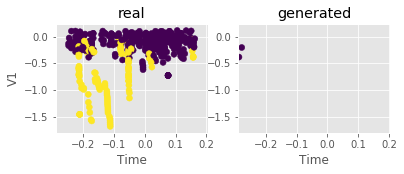

Step: 300 of 501.
Losses: G, D Gen, D Real, Xgb: 1.0853, 0.6915, 0.7036, 0.9593
D Real - D Gen: 0.0122


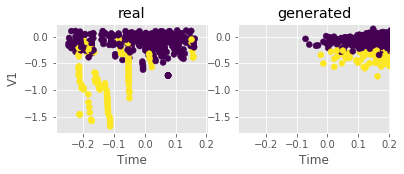

Step: 400 of 501.
Losses: G, D Gen, D Real, Xgb: 1.0760, 0.5960, 0.6301, 0.9756
D Real - D Gen: 0.0341


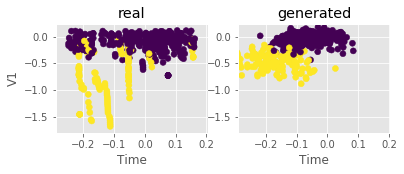

Step: 500 of 501.
Losses: G, D Gen, D Real, Xgb: 1.4847, 0.4688, 0.7167, 0.9797
D Real - D Gen: 0.2479


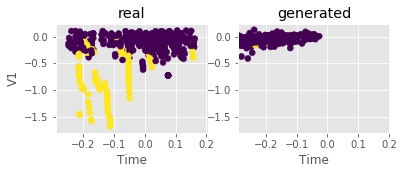

CPU times: user 1min 9s, sys: 7.15 s, total: 1min 16s
Wall time: 17.1 s


In [84]:
%%time

# Training the vanilla GAN and CGAN architectures

k_d = 1  # number of critic network updates per adversarial training step
learning_rate = 5e-4 # 5e-5
arguments = [rand_dim, nb_steps, batch_size, 
             k_d, k_g, critic_pre_train_steps, log_interval, learning_rate, base_n_count,
            data_dir, generator_model_path, discriminator_model_path, loss_pickle_path, show ]

adversarial_training_GAN(arguments, train_no_label, data_cols ) # GAN
adversarial_training_GAN(arguments, train, data_cols=data_cols, label_cols=label_cols ) # CGAN

In [85]:
%%time

# Training the WGAN and WCGAN architectures

k_d = 5 # train critic to optimal state each time
learning_rate = 1e-4 # 5e-5
arguments = [rand_dim, nb_steps, batch_size, 
             k_d, k_g, critic_pre_train_steps, log_interval, learning_rate, base_n_count,
            data_dir, generator_model_path, discriminator_model_path, loss_pickle_path, show ]

adversarial_training_WGAN(arguments, train_no_label, data_cols=data_cols ) # WGAN
adversarial_training_WGAN(arguments, train, data_cols=data_cols, label_cols=label_cols ) # WCGAN

data_dim:  30
data_cols:  ['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount']
Model: "generator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_25 (InputLayer)        [(None, 32)]              0         
_________________________________________________________________
dense_80 (Dense)             (None, 128)               4224      
_________________________________________________________________
dense_81 (Dense)             (None, 256)               33024     
_________________________________________________________________
dense_82 (Dense)             (None, 512)               131584    
_________________________________________________________________
dense_83 (Dense)             (None, 30)                15390     
Total params: 184,222
T

FailedPreconditionError: Error while reading resource variable beta1_power_4 from Container: localhost. This could mean that the variable was uninitialized. Not found: Resource localhost/beta1_power_4/N10tensorflow3VarE does not exist.
	 [[node Adam_4/update_dense_84/bias/ResourceApplyAdam/ReadVariableOp (defined at /Users/scott/Desktop/TabularGANs/GAN_171103.py:403) ]]

Original stack trace for 'Adam_4/update_dense_84/bias/ResourceApplyAdam/ReadVariableOp':
  File "/Users/scott/anaconda3/lib/python3.7/runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "/Users/scott/anaconda3/lib/python3.7/runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/traitlets/config/application.py", line 664, in launch_instance
    app.start()
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/ipykernel/kernelapp.py", line 583, in start
    self.io_loop.start()
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tornado/platform/asyncio.py", line 153, in start
    self.asyncio_loop.run_forever()
  File "/Users/scott/anaconda3/lib/python3.7/asyncio/base_events.py", line 538, in run_forever
    self._run_once()
  File "/Users/scott/anaconda3/lib/python3.7/asyncio/base_events.py", line 1782, in _run_once
    handle._run()
  File "/Users/scott/anaconda3/lib/python3.7/asyncio/events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tornado/ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tornado/ioloop.py", line 743, in _run_callback
    ret = callback()
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tornado/gen.py", line 787, in inner
    self.run()
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tornado/gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/ipykernel/kernelbase.py", line 377, in dispatch_queue
    yield self.process_one()
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tornado/gen.py", line 225, in wrapper
    runner = Runner(result, future, yielded)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tornado/gen.py", line 714, in __init__
    self.run()
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tornado/gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/ipykernel/kernelbase.py", line 361, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tornado/gen.py", line 209, in wrapper
    yielded = next(result)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/ipykernel/kernelbase.py", line 268, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tornado/gen.py", line 209, in wrapper
    yielded = next(result)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/ipykernel/kernelbase.py", line 541, in execute_request
    user_expressions, allow_stdin,
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tornado/gen.py", line 209, in wrapper
    yielded = next(result)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/ipykernel/ipkernel.py", line 300, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/ipykernel/zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 2858, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 2886, in _run_cell
    return runner(coro)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/IPython/core/async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 3063, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 3254, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 3331, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-85-ba5dd8676777>", line 1, in <module>
    get_ipython().run_cell_magic('time', '', '\n# Training the WGAN and WCGAN architectures\n\nk_d = 5 # train critic to optimal state each time\nlearning_rate = 1e-4 # 5e-5\narguments = [rand_dim, nb_steps, batch_size, \n             k_d, k_g, critic_pre_train_steps, log_interval, learning_rate, base_n_count,\n            data_dir, generator_model_path, discriminator_model_path, loss_pickle_path, show ]\n\nadversarial_training_WGAN(arguments, train_no_label, data_cols=data_cols ) # WGAN\nadversarial_training_WGAN(arguments, train, data_cols=data_cols, label_cols=label_cols ) # WCGAN\n')
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 2362, in run_cell_magic
    result = fn(*args, **kwargs)
  File "</Users/scott/anaconda3/lib/python3.7/site-packages/decorator.py:decorator-gen-61>", line 2, in time
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/IPython/core/magic.py", line 187, in <lambda>
    call = lambda f, *a, **k: f(*a, **k)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/IPython/core/magics/execution.py", line 1312, in time
    exec(code, glob, local_ns)
  File "<timed exec>", line 9, in <module>
  File "/Users/scott/Desktop/TabularGANs/GAN_171103.py", line 403, in adversarial_training_WGAN
    disc_optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate, beta1=0.5, beta2=0.9).minimize(_disc_loss, var_list=discriminator_model.trainable_weights)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tensorflow/python/training/optimizer.py", line 413, in minimize
    name=name)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tensorflow/python/training/optimizer.py", line 616, in apply_gradients
    update_ops.append(processor.update_op(self, grad))
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tensorflow/python/training/optimizer.py", line 171, in update_op
    update_op = optimizer._resource_apply_dense(g, self._v)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tensorflow/python/training/adam.py", line 181, in _resource_apply_dense
    use_locking=self._use_locking)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tensorflow/python/training/gen_training_ops.py", line 1436, in resource_apply_adam
    use_nesterov=use_nesterov, name=name)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/op_def_library.py", line 470, in _apply_op_helper
    preferred_dtype=default_dtype)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/ops.py", line 1341, in convert_to_tensor
    ret = conversion_func(value, dtype=dtype, name=name, as_ref=as_ref)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/resource_variable_ops.py", line 1825, in _dense_var_to_tensor
    return var._dense_var_to_tensor(dtype=dtype, name=name, as_ref=as_ref)  # pylint: disable=protected-access
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/resource_variable_ops.py", line 1242, in _dense_var_to_tensor
    return self.value()
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/resource_variable_ops.py", line 550, in value
    return self._read_variable_op()
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/resource_variable_ops.py", line 645, in _read_variable_op
    result = read_and_set_handle()
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/resource_variable_ops.py", line 636, in read_and_set_handle
    self._dtype)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/gen_resource_variable_ops.py", line 483, in read_variable_op
    "ReadVariableOp", resource=resource, dtype=dtype, name=name)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/op_def_library.py", line 744, in _apply_op_helper
    attrs=attr_protos, op_def=op_def)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/ops.py", line 3327, in _create_op_internal
    op_def=op_def)
  File "/Users/scott/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/ops.py", line 1791, in __init__
    self._traceback = tf_stack.extract_stack()


In [79]:
# %%time

# # for continued training

# import GAN_1711103
# import importlib
# importlib.reload(GAN_171103) # For reloading after making changes
# from GAN_171103 import *

# last_step = 1000
# prefix = 'WGAN'
# # data_dir = 'cache lr mix base 128 act mix 171026/'
# data_dir = 'cache/'

# # Choose your learning rate
# # learning_rate = 1e-5 # first 10k
# # learning_rate = 1e-5 # 10-15k
# # learning_rate = 1e-6 # 15-20k

# generator_model_path = data_dir + prefix + '_generator_model_weights_step_' + str(last_step) + '.h5'
# discriminator_model_path = data_dir + prefix + '_discriminator_model_weights_step_' + str(last_step) + '.h5'
# loss_pickle_path = data_dir + prefix + '_losses_step_' + str(last_step) + '.pkl'

# nb_steps = 4000

# arguments = [rand_dim, nb_steps, batch_size, 
#              k_d, k_g, critic_pre_train_steps, log_interval, learning_rate, base_n_count,
#             data_dir, generator_model_path, discriminator_model_path, loss_pickle_path, show ]

# # Choose your training algorithm
# # adversarial_training_GAN(arguments, train_no_label, data_cols=data_cols, starting_step=last_step+1 ) # GAN
# # adversarial_training_GAN(arguments, train, data_cols=data_cols, label_cols=label_cols, starting_step=last_step+1 ) # CGAN
# # adversarial_training_WGAN(arguments, train_no_label, data_cols=data_cols, starting_step=last_step+1 ) # WGAN
# adversarial_training_WGAN(arguments, train, data_cols=data_cols, label_cols=label_cols, starting_step=last_step+1 ) # WCGAN

In [50]:

# For reloading loss data from pickles

prefix = 'WCGAN'
step = 500

[combined_loss, disc_loss_generated, disc_loss_real, xgb_losses] = pickle.load(
    open(data_dir+prefix+'_losses_step_'+str(step)+'.pkl','rb'))


FileNotFoundError: [Errno 2] No such file or directory: 'cache/WCGAN_losses_step_500.pkl'

In [53]:
# plt.plot( xgb_losses[:] ) ;
w = 10
plt.plot( pd.DataFrame(xgb_losses[:]).rolling(w).mean() ) ;

NameError: name 'xgb_losses' is not defined

In [ ]:

# Look for the step with the lowest xgboost accuracy, and the lowest step saved (every 100)

best_step = list(xgb_losses).index( xgb_losses.min() ) * 10
print( best_step, xgb_losses.min() )

xgb100 = [ xgb_losses[i] for i in range(0, len(xgb_losses), 10) ]
best_step = xgb100.index( min(xgb100) ) * log_interval
print( best_step, min(xgb100) )

In [ ]:

# Look for the step with the lowest critic loss, and the lowest step saved (every 100)

delta_losses = np.array(disc_loss_real) - np.array(disc_loss_generated)

best_step = list(delta_losses).index( delta_losses.min() )
print( best_step, delta_losses.min() )

delta100 = [ delta_losses[i] for i in range(0, len(delta_losses), 100) ]
best_step = delta100.index( min(delta100) ) * log_interval
print( best_step, min(delta100) )

In [ ]:
# plt.plot( (np.array(disc_loss_real) - np.array(disc_loss_generated)) )

w = 50
# plt.plot( list(range(0,5001,1)), pd.rolling_mean((np.array(disc_loss_real) - np.array(disc_loss_generated)),w) )
plt.plot( pd.DataFrame(disc_loss_real[:]).rolling(w).mean() - pd.DataFrame(disc_loss_generated[:]).rolling(w).mean() ) ;

# plt.xlim([9000,10000])
# plt.ylim([0.03,0.05])

In [ ]:
# Let's look at some of the generated data
# First create the networks locally and load the weights

import GAN_171103
import importlib
importlib.reload(GAN_171103) # For reloading after making changes
from GAN_171103 import *

seed = 17

train = fraud_w_classes.copy().reset_index(drop=True) # fraud only with labels from classification

# train = pd.get_dummies(train, columns=['Class'], prefix='Class', drop_first=True)
label_cols = [ i for i in train.columns if 'Class' in i ]
data_cols = [ i for i in train.columns if i not in label_cols ]
train[ data_cols ] = train[ data_cols ] / 10 # scale to random noise size, one less thing to learn
train_no_label = train[ data_cols ]

data_dim = len(data_cols)
label_dim = len(label_cols)
with_class = False
if label_dim > 0: with_class = True
np.random.seed(seed)

# define network models

# generator_model, discriminator_model, combined_model = define_models_CGAN(rand_dim, data_dim, label_dim, base_n_count, type='Wasserstein')
# generator_model.load_weights('cache/WCGAN_generator_model_weights_step_4800.h5')
generator_model, discriminator_model, combined_model = define_models_CGAN(rand_dim, data_dim, label_dim, base_n_count)
generator_model.load_weights('cache/CGAN_generator_model_weights_step_500.h5')


# with_class = False
# train = train_no_label
# label_cols = []
# # generator_model, discriminator_model, combined_model = define_models_GAN(rand_dim, data_dim, base_n_count, type='Wasserstein')
# # generator_model.load_weights('cache/WGAN_generator_model_weights_step_4800.h5')

# generator_model, discriminator_model, combined_model = define_models_GAN(rand_dim, data_dim, base_n_count)
# generator_model.load_weights('cache/GAN_generator_model_weights_step_5000.h5')

In [ ]:

# Now generate some new data

test_size = 492 # Equal to all of the fraud cases

x = get_data_batch(train, test_size, seed=i+j)
z = np.random.normal(size=(test_size, rand_dim))
if with_class:
    labels = x[:,-label_dim:]
    g_z = generator_model.predict([z, labels])
else:
    g_z = generator_model.predict(z)

In [ ]:
# Check using the same functions used during GAN training

print( CheckAccuracy( x, g_z, data_cols, label_cols, seed=0, with_class=with_class, data_dim=data_dim ) )

PlotData( x, g_z, data_cols, label_cols, seed=0, with_class=with_class, data_dim=data_dim )

In [ ]:
# Now we can train and test an xgboost classifier on our generated data

real_samples = pd.DataFrame(x, columns=data_cols+label_cols)
test_samples = pd.DataFrame(g_z, columns=data_cols+label_cols)
real_samples['syn_label'] = 0
test_samples['syn_label'] = 1

training_fraction = 0.5
n_real, n_test = int(len(real_samples)*training_fraction), int(len(test_samples)*training_fraction)
train_df = pd.concat([real_samples[:n_real],test_samples[:n_test]],axis=0)
test_df = pd.concat([real_samples[n_real:],test_samples[n_test:]],axis=0)

# X_col = test_df.columns[:-(label_dim+1)]
X_col = test_df.columns[:-1]
y_col = test_df.columns[-1]
dtrain = xgb.DMatrix(train_df[X_col], train_df[y_col], feature_names=X_col)
dtest = xgb.DMatrix(test_df[X_col], feature_names=X_col)
y_true = test_df['syn_label']

# dtrain = np.vstack( [ x[:int(len(x)/2)], g_z[:int(len(g_z)/2)] ] )
# dlabels = np.hstack( [ np.zeros(int(len(x)/2)), np.ones(int(len(g_z)/2)) ] )
# dtest = np.vstack( [ x[int(len(x)/2):], g_z[int(len(g_z)/2):] ] )

# dtrain = xgb.DMatrix(dtrain, dlabels, feature_names=data_cols+label_cols)
# dtest = xgb.DMatrix(dtest, feature_names=data_cols+label_cols)
# y_true = dlabels

xgb_params = {
    'max_depth': 4,
    'objective': 'binary:logistic',
    'random_state': 0,
    'eval_metric': 'auc', # allows for balanced or unbalanced classes 
}
xgb_test = xgb.train(xgb_params, dtrain, num_boost_round=10)

y_pred = np.round(xgb_test.predict(dtest))

print( '{:.2f}'.format(SimpleAccuracy(y_pred, y_true)) )

In [ ]:

# Let's look at how the discrimnator scored real and generated data, visualized along every feature

y_pred0 = xgb_test.predict(dtest)

for i in range(0,len(X_col)-1, 2):

    f, axarr = plt.subplots(1, 2, figsize=(6,2) )

    axarr[0].scatter( test_df[:n_real][X_col[i]], test_df[:n_real][X_col[i+1]], c=y_pred0[:n_real], cmap='plasma'  )
    axarr[0].set_title('real')
    axarr[0].set_ylabel(X_col[i+1])

    axarr[1].scatter( test_df[n_real:][X_col[i]], test_df[n_real:][X_col[i+1]], c=y_pred0[n_real:], cmap='plasma'  )
    axarr[1].set_title('test')
    axarr[1].set_xlim(axarr[0].get_xlim()), axarr[1].set_ylim(axarr[0].get_ylim())

    for a in axarr:
        a.set_xlabel(X_col[i])

    plt.show()

In [ ]:

# Now we can compare the real and generated data by class, along every feature

colors = ['red','blue']
markers = ['o','^']
labels = ['real','fraud']

class_label = 'Class'

for i in range(0,len(X_col), 2):
    col1, col2 = i, i+1
    if i+1 >= len(X_col): continue
    
    f, axarr = plt.subplots(1, 2, figsize=(6,2) )
    for group, color, marker, label in zip( test_df[:n_real].groupby(class_label), colors, markers, labels ):
        axarr[0].scatter( group[1][X_col[col1]], group[1][X_col[col2]], label=label, c=color, marker=marker, alpha=0.2) 
    axarr[0].legend()
    axarr[0].set_title('real')
    axarr[0].set_ylabel(X_col[col2])

    for group, color, marker, label in zip( test_df[n_real:].groupby(class_label), colors, markers, labels ):
        axarr[1].scatter( group[1][X_col[col1]], group[1][X_col[col2]], label=label, c=color, marker=marker, alpha=0.2) 
    axarr[1].set_xlim(axarr[0].get_xlim()), axarr[1].set_ylim(axarr[0].get_ylim())
    axarr[1].legend()
    axarr[1].set_title('generated') ;

    for a in axarr:
        a.set_xlabel(X_col[col1])

    plt.show()

In [ ]:

# Evaluate performance on validation set

SimpleMetrics(y_pred,y_true)

In [ ]:

# Plot feature importances used for identifying generated data

fig, ax = plt.subplots(1, 1, figsize=(8, 8))
xgb.plot_importance(xgb_test, max_num_features=20, height=0.5, ax=ax);

<a id="Compare GAN Output"><h1>Compare GAN Output</h1></a>

<a href='#TOC'>Table of contents</a>
<br><br>



It may be best to restart the notebook, run the setup section, and then run this section


In [72]:

# Set up the training dataset

train = fraud_w_classes.copy().reset_index(drop=True) # fraud only with labels from classification

train = pd.get_dummies(train, columns=['Class'], prefix='Class', drop_first=True)
label_cols = [ i for i in train.columns if 'Class' in i ]
data_cols = [ i for i in train.columns if i not in label_cols ]
train[ data_cols ] = train[ data_cols ] / 10 # scale to random noise size, one less thing to learn
train_no_label = train[ data_cols ]

data_dim = len(data_cols)
label_dim = len(label_cols)

In [73]:
# Generate empty models

rand_dim = 32
base_n_count = 128
model_names = ['GAN','CGAN','WGAN','WCGAN']
with_classes = [False, True, False, True]
type0s = [None, None, 'Wasserstein', 'Wasserstein']

models = {}

for model_name, with_class, type0 in zip(model_names, with_classes, type0s ):

    if with_class:
        generator_model, discriminator_model, combined_model = \
            define_models_CGAN(rand_dim, data_dim, label_dim, base_n_count, type=type0)
    else:
         generator_model, discriminator_model, combined_model = \
            define_models_GAN(rand_dim, data_dim, base_n_count, type=type0)   
    
    models[model_name] = [ model_name, with_class, type0, generator_model ]

In [74]:

# Setup parameters

seed = 17
test_size = 492 # number of fraud cases

np.random.seed(seed)
z = np.random.normal(size=(test_size, rand_dim))
x = get_data_batch(train, test_size, seed=seed)
real_samples = pd.DataFrame(x, columns=data_cols+label_cols)
labels = x[:,-label_dim:]

# colors = ['C1','C9']
# colors = ['xkcd:plum', 'xkcd:navy']
colors = ['red','blue']
markers = ['o','^']
class_labels = ['Class 1','Class 2']

col1, col2 = 'V17', 'V10'

base_dir = 'cache lr mix base 128 act mix 171026/'


<a id="Fig5"><h1>Figure 5: Comparison of GAN outputs</h1></a><br>
<a href='#TOC'>Table of contents</a>

0


OSError: Unable to open file (unable to open file: name = 'cache lr mix base 128 act mix 171026/GAN_generator_model_weights_step_0.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

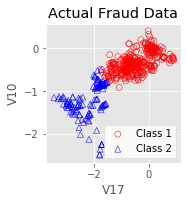

In [75]:


# model_steps = [500, 5000]
# model_steps = [ 0, 100, 200, 500, 1000 ]
model_steps = [ 0, 100, 200, 500, 1000, 2000, 5000]
rows = len(model_steps)
columns = 5

axarr = [[]]*len(model_steps)

fig = plt.figure(figsize=(14,rows*3))

for model_step_ix, model_step in enumerate( model_steps ):
    print(model_step)
        
    axarr[model_step_ix] = plt.subplot(rows, columns, model_step_ix*columns + 1)
    
    for group, color, marker, label in zip( real_samples.groupby('Class_1'), colors, markers, class_labels ):
        plt.scatter( group[1][[col1]], group[1][[col2]], 
                         label=label, marker=marker, edgecolors=color, facecolors='none' )
    
    plt.title('Actual Fraud Data')
    plt.ylabel(col2) # Only add y label to left plot
    plt.xlabel(col1)
    xlims, ylims = axarr[model_step_ix].get_xlim(), axarr[model_step_ix].get_ylim()
        
    if model_step_ix == 0: 
        legend = plt.legend()
        legend.get_frame().set_facecolor('white')
    
    for i, model_name in enumerate( model_names[:] ):
        
        [ model_name, with_class, type0, generator_model ] = models[model_name]
        
        generator_model.load_weights( base_dir + model_name + '_generator_model_weights_step_'+str(model_step)+'.h5')

        ax = plt.subplot(rows, columns, model_step_ix*columns + 1 + (i+1) )
        
        if with_class:
            g_z = generator_model.predict([z, labels])
            gen_samples = pd.DataFrame(g_z, columns=data_cols+label_cols)
            for group, color, marker, label in zip( gen_samples.groupby('Class_1'), colors, markers, class_labels ):
                plt.scatter( group[1][[col1]], group[1][[col2]], 
                                 label=label, marker=marker, edgecolors=color, facecolors='none' )
        else:
            g_z = generator_model.predict(z)
            gen_samples = pd.DataFrame(g_z, columns=data_cols)
            plt.scatter( gen_samples[[col1]], gen_samples[[col2]], 
                             label=class_labels[0], marker=markers[0], edgecolors=colors[0], facecolors='none' )
        plt.title(model_name)   
        plt.xlabel(data_cols[0])
        ax.set_xlim(xlims), ax.set_ylim(ylims)


plt.suptitle('Comparison of GAN outputs', size=16)
plt.tight_layout(rect=[0.075,0,1,0.95])

# Adding text labels for traning steps
vpositions = np.array([ i._position.bounds[1] for i in axarr ])
vpositions += ((vpositions[0] - vpositions[1]) * 0.35 )
for model_step_ix, model_step in enumerate( model_steps ):
    fig.text( 0.05, vpositions[model_step_ix], 'training\nstep\n'+str(model_step), ha='center', va='center', size=12)

# plt.savefig('plots/Comparison_of_GAN_outputs.png')

<a id="Generated Data Testing"><h1>Generated Data Testing</h1></a>

<a href='#TOC'>Table of contents</a>

In [ ]:

# Setup xgboost parameters

xgb_params = {
#     'max_depth': 4,
    'objective': 'binary:logistic',
    'random_state': 0,
    'eval_metric': 'auc', # auc, error
#     'tree_method': 'hist'
#     'grow_policy': 'lossguide' # depthwise, lossguide
}

# https://github.com/dmlc/xgboost/blob/master/demo/guide-python/custom_objective.py

from sklearn.metrics import recall_score, precision_score, roc_auc_score

def recall(preds, dtrain):
    labels = dtrain.get_label()
    return 'recall',  recall_score(labels, np.round(preds))

def precision(preds, dtrain):
    labels = dtrain.get_label()
    return 'precision',  precision_score(labels, np.round(preds))

def roc_auc(preds, dtrain):
    labels = dtrain.get_label()
    return 'roc_auc',  roc_auc_score(labels, preds)


In [ ]:

# Define model parameters

seed = 17
np.random.seed(seed)

data_dim = len(data_cols)
label_dim = len(label_cols)

base_dir = 'cache lr mix base 128 act mix 171026/'
rand_dim = 32
base_n_count = 128


In [ ]:

# defined training set parameters

train_fraction = 0.7
X_col = data.columns[:-1]
y_col = data.columns[-1]

folds = 5


In [ ]:

# Function to make cross folds with different amounts of an additional dataset added

def MakeCrossFolds( g_z_df=[] ):

    np.random.seed(0)

    train_real_set, test_real_set = [], []
    train_fraud_set, test_fraud_set = [], []

    real_samples = data.loc[ data.Class==0 ].copy()
    fraud_samples = data.loc[ data.Class==1 ].copy()

#     n_temp_real = 10000 
    n_temp_real = len(real_samples)

    for seed in range(folds):
        np.random.seed(seed)

        fraud_samples = fraud_samples.sample(len(fraud_samples), replace=False).reset_index(drop=True) # shuffle

    #     n_train_fraud = int(len(fraud_samples) * train_fraction)
        n_train_fraud = 100
        train_fraud_samples = fraud_samples[:n_train_fraud].reset_index(drop=True)

    #     test_fraud_samples = fraud_samples[n_train_fraud:].reset_index(drop=True)
        n_test_fraud = 148 # 30% left out
        test_fraud_samples = fraud_samples[-n_test_fraud:].reset_index(drop=True)

        if len(g_z_df)==0: g_z_df = fraud_samples[n_train_fraud:-n_test_fraud] # for adding real data, if no generated
        n_g_z = len(g_z_df)
        train_fraud_samples = train_fraud_samples.append(g_z_df).reset_index(drop=True)

        real_samples = real_samples.sample(len(real_samples), replace=False).reset_index(drop=True) # shuffle
        temp_real_samples = real_samples[:n_temp_real]
        n_train_real = int(len(temp_real_samples) * train_fraction)

        train_real_samples = temp_real_samples[:n_train_real].reset_index(drop=True) # with margin
        test_real_samples = temp_real_samples[n_train_real:].reset_index(drop=True) # with margin

        train_real_set.append( train_real_samples )
        test_real_set.append( test_real_samples )
        train_fraud_set.append( train_fraud_samples )
        test_fraud_set.append( test_fraud_samples )

    print( n_train_fraud )
    for i in [ fraud_samples, g_z_df, train_fraud_samples, test_fraud_samples ]: print( len(i) )
    for i in [ real_samples, train_real_samples, test_real_samples ]: print( len(i) )
    # [ [ len(i) for i in j ] for j in [train_real_set, test_real_set, train_fraud_set, test_fraud_set] ]
    
    return n_train_fraud, train_real_set, test_real_set, train_fraud_set, test_fraud_set


In [ ]:

# function to run an xgboost classifier on different cross-folds with different amounts of data added

def Run_CV_Xgb(n_train_fraud, train_real_set, test_real_set, train_fraud_set, test_fraud_set):

    test_data=[]

    # for i in [1]:
    # for i in [1,2,5,10,20]:
    # for i in np.logspace(0,np.log10(11),num=5):
    # for i in np.logspace(0,np.log10(11),num=3):
    for i in np.logspace(0,np.log10((492-148)/100),num=5):

        print('# additional generated data tested: {}'.format (int(n_train_fraud*(i-1)) ) )
        for k in range(folds):

            train_df = pd.concat( 
                [ train_real_set[k], train_fraud_set[k][:int(n_train_fraud*i)] ],
                 axis=0,ignore_index=True).reset_index(drop=True)

            test_df = pd.concat( 
                [ test_real_set[k], test_fraud_set[k] ],
                axis=0,ignore_index=True).reset_index(drop=True)

            dtrain = xgb.DMatrix(train_df[X_col], train_df[y_col], feature_names=X_col)
            dtest = xgb.DMatrix(test_df[X_col], test_df[y_col], feature_names=X_col)

            results_dict = {}
            xgb_test = xgb.train(xgb_params, dtrain, num_boost_round=100, 
                                 verbose_eval=False, early_stopping_rounds=10, 
                                 evals=[(dtrain,'train'),(dtest,'test')],
                                 evals_result = results_dict )

            y_pred = xgb_test.predict(dtest, ntree_limit=xgb_test.best_iteration+1)
            y_true = test_df['Class'].values
            results = [k, i, xgb_test.best_iteration, recall( y_pred, dtest )[1], precision( y_pred, dtest )[1], roc_auc( y_pred, dtest )[1] ]
    #         print(results)

            test_data.append(results)
    test_data = pd.DataFrame(test_data, columns=['k', 'ratio','best','recall','precision','auc'])
    return test_data


In [ ]:
%%time

# Generate and test data with untrained model

generator_model, discriminator_model, combined_model = define_models_CGAN(rand_dim, data_dim, label_dim, base_n_count, type='Wasserstein')
generator_model.load_weights( base_dir + 'WCGAN_generator_model_weights_step_0.h5')

test_size = 492
x = get_data_batch(fraud_w_classes, test_size, seed=0)
z = np.random.normal(size=(test_size, rand_dim))
labels = x[:,-label_dim:]
g_z = generator_model.predict([z, labels])


# The labels for the generate data will all be 1, as they are supposed to be fraud data
g_z_df = pd.DataFrame( np.hstack( [g_z[:,:len(data_cols)], np.ones((len(g_z),1))] ), columns=data.columns )

n_train_fraud, train_real_set, test_real_set, train_fraud_set, test_fraud_set = MakeCrossFolds(g_z_df)
    
t_0 = Run_CV_Xgb(n_train_fraud, train_real_set, test_real_set, train_fraud_set, test_fraud_set)


In [ ]:
%%time

# Generate and test data with trained model

generator_model, discriminator_model, combined_model = define_models_CGAN(rand_dim, data_dim, label_dim, base_n_count, type='Wasserstein')
generator_model.load_weights( base_dir + 'WCGAN_generator_model_weights_step_4800.h5')

test_size = 492
x = get_data_batch(fraud_w_classes, test_size, seed=0)
z = np.random.normal(size=(test_size, rand_dim))
labels = x[:,-label_dim:]
g_z = generator_model.predict([z, labels])



# The labels for the generate data will all be 1, as they are supposed to be fraud data
g_z_df = pd.DataFrame( np.hstack( [g_z[:,:len(data_cols)], np.ones((len(g_z),1))] ), columns=data.columns )

n_train_fraud, train_real_set, test_real_set, train_fraud_set, test_fraud_set = MakeCrossFolds(g_z_df)
    
t_4800 = Run_CV_Xgb(n_train_fraud, train_real_set, test_real_set, train_fraud_set, test_fraud_set)


/opt/conda/lib/python3.6/site-packages/Keras-2.0.4-py3.6.egg/keras/backend/tensorflow_backend.py:2289: UserWarning: Expected no kwargs, you passed 1
kwargs passed to function are ignored with Tensorflow backend
  warnings.warn('\n'.join(msg))


100
492
492
592
148
284315
199020
85295
# additional generated data tested: 0
# additional generated data tested: 36
# additional generated data tested: 85
# additional generated data tested: 152
# additional generated data tested: 244
CPU times: user 18min 20s, sys: 5.59 s, total: 18min 26s
Wall time: 9min 20s


In [ ]:
%%time

# Generate and test data with additional real data

n_train_fraud, train_real_set, test_real_set, train_fraud_set, test_fraud_set = MakeCrossFolds()
    
t_real = Run_CV_Xgb(n_train_fraud, train_real_set, test_real_set, train_fraud_set, test_fraud_set)


100
492
244
344
148
284315
199020
85295
# additional generated data tested: 0
# additional generated data tested: 36
# additional generated data tested: 85
# additional generated data tested: 152
# additional generated data tested: 244
CPU times: user 24min 3s, sys: 6.56 s, total: 24min 9s
Wall time: 12min 12s


In [ ]:

# # Save the testing data

# # Run using the WCGAN trained after 0 steps
# pickle.dump( t_0, open('cache/additional untrained generated fraud data test.pkl','wb'))

# # Run using the WCGAN trained after 4800 steps
# pickle.dump( t_4800, open('cache/additional generated fraud data test.pkl','wb'))

# # Run using the real data
# pickle.dump( t_real, open('cache/additional real fraud data test.pkl','wb'))

In [ ]:

# Reload the testing data

t_0 = pickle.load(open('cache/additional untrained generated fraud data test.pkl','rb'))
t_4800 = pickle.load(open('cache/additional generated fraud data test.pkl','rb'))
t_real = pickle.load(open('cache/additional real fraud data test.pkl','rb'))


<a id="Fig8"><h1>Figure 8: Effects of Additional Data on Fraud Detection</h1></a><br>

<a href='#TOC'>Table of contents</a>

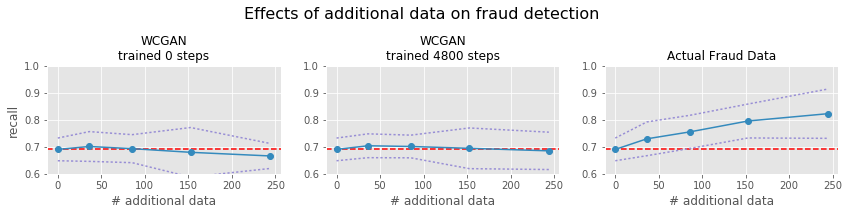

In [ ]:

# Plot the testing data

labels = ['WCGAN\ntrained 0 steps','WCGAN\ntrained 4800 steps','Actual Fraud Data']

metric = 'recall'

plt.figure(figsize=(12,3))
for i, [label, test_data] in enumerate(zip(labels, [t_0, t_4800, t_real])):

    xs = [ n_train_fraud * (i[0]-1) for i in test_data.groupby('ratio') ]
    ys = test_data.groupby('ratio')[metric].mean().values
    stds = 2 * test_data.groupby('ratio')[metric].std().values

    plt.subplot(1,3,i+1)
    plt.axhline(ys[0],linestyle='--',color='red')
    plt.plot(xs,ys,c='C1',marker='o')
    plt.plot(xs,ys+stds,linestyle=':',c='C2')
    plt.plot(xs,ys-stds,linestyle=':',c='C2')
    if i==0: plt.ylabel(metric)
    plt.xlabel('# additional data')
    plt.title(label,size=12)
#     plt.xlim([0,11])
#     plt.ylim([0.55,.85])
    plt.ylim([0.6,1.0])

plt.tight_layout(rect=[0,0,1,0.9])
plt.suptitle('Effects of additional data on fraud detection', size=16)
# plt.savefig('plots/Effects of addtional data on fraud detection.png')
plt.show()

<a id="Summary"><h1>Summary of Training Data</h1></a>

<a href='#TOC'>Table of contents</a>
<br><br>


In [ ]:

# Load the saved loss data from each model

# base_dir = 'cache/'
base_dir = 'cache lr mix base 128 act mix 171026/'

suffix = '_step_5000'

GAN_losses = pickle.load(open(base_dir + 'GAN_losses'+suffix+'.pkl','rb'))
# GAN_losses = [combined_loss, disc_loss_real, disc_loss_generated, xgb_losses]

CGAN_losses = pickle.load(open(base_dir + 'CGAN_losses'+suffix+'.pkl','rb'))
WGAN_losses = pickle.load(open(base_dir + 'WGAN_losses'+suffix+'.pkl','rb'))
WCGAN_losses = pickle.load(open(base_dir + 'WCGAN_losses'+suffix+'.pkl','rb'))

In [ ]:

# Find best xgb scores overall and saved (every 100 steps)

data_ix = 3
data_sets = [ GAN_losses[data_ix], CGAN_losses[data_ix], WGAN_losses[data_ix], WCGAN_losses[data_ix]]
labels = [ 'GAN','CGAN','WGAN','WCGAN' ]

for label, data_set in zip( labels, data_sets ):
    best_step = list(data_set).index( np.array(data_set).min() ) * 10
    print( '{: <5} step {: <4}: {:.4f}'.format( label, best_step, np.array(data_set).min() ) )

    xgb100 = [ data_set[i] for i in range(0, len(data_set), 10) ]
    best_step = xgb100.index( min(xgb100) ) * 100
    print( '{: <5} step {: <4}: {:.4f}\n'.format( label, best_step, np.array(xgb100).min() ) )
#     print( best_step, min(xgb100) )

GAN   step 760 : 0.7744
GAN   step 800 : 0.7886

CGAN  step 2020: 0.7500
CGAN  step 1800: 0.7825

WGAN  step 4580: 0.6768
WGAN  step 4800: 0.7215

WCGAN step 3570: 0.6789
WCGAN step 4800: 0.6951



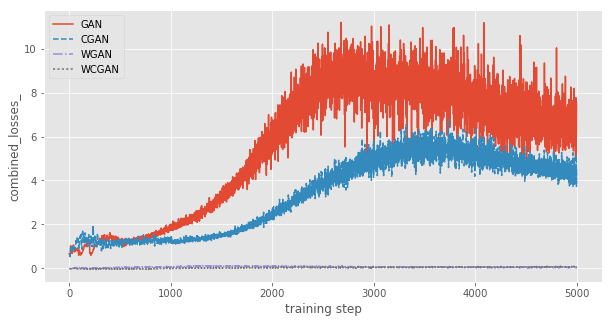

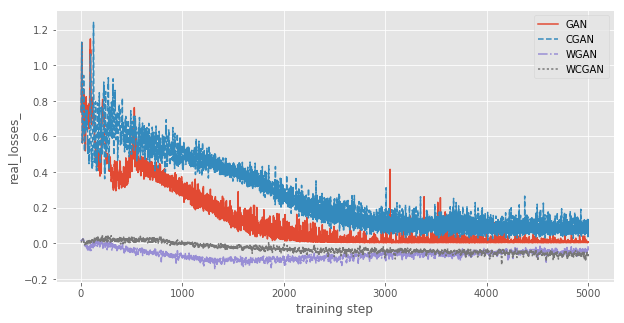

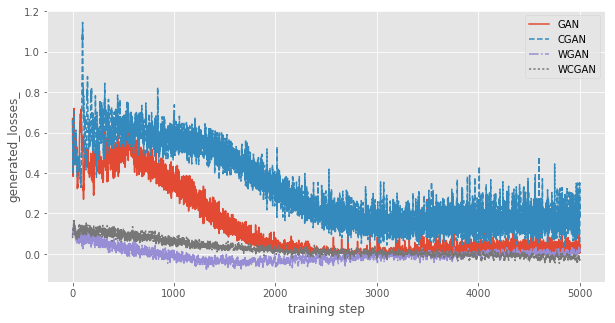

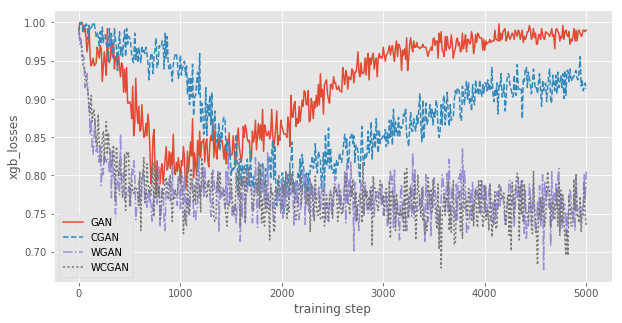

In [ ]:

# Look at the unsmoothed losses

data_fields = ['combined_losses_', 'real_losses_', 'generated_losses_', 'xgb_losses']
sampling_intervals = [ 1, 1, 1, 10 ]
labels = [ 'GAN','CGAN','WGAN','WCGAN' ]
linestyles = ['-', '--', '-.', ':']

for data_ix in range(len(data_fields)):
    data_sets = [ GAN_losses[data_ix], CGAN_losses[data_ix], WGAN_losses[data_ix], WCGAN_losses[data_ix]]

    plt.figure(figsize=(10,5))
    for data, label, linestyle in zip(data_sets, labels, linestyles):
        plt.plot( np.array(range(0,len(data)))*sampling_intervals[data_ix],
                 data,
                 label=label, linestyle=linestyle )

    plt.ylabel(data_fields[data_ix])
    plt.xlabel('training step')
    plt.legend()
    plt.show()


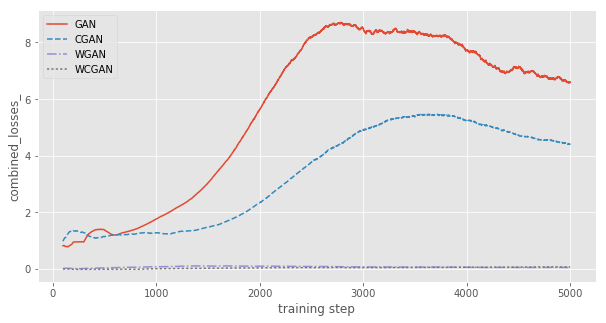

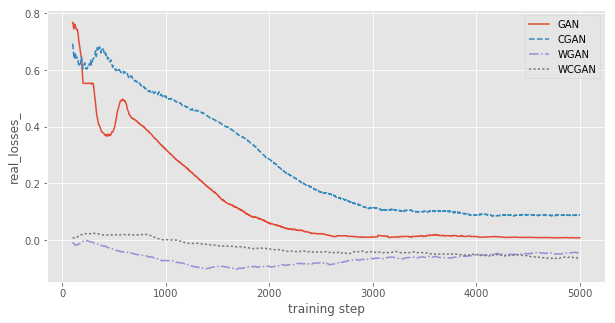

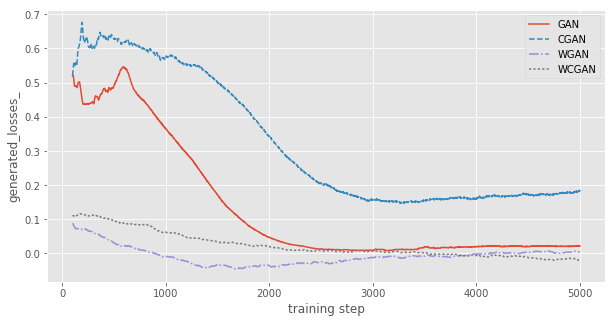

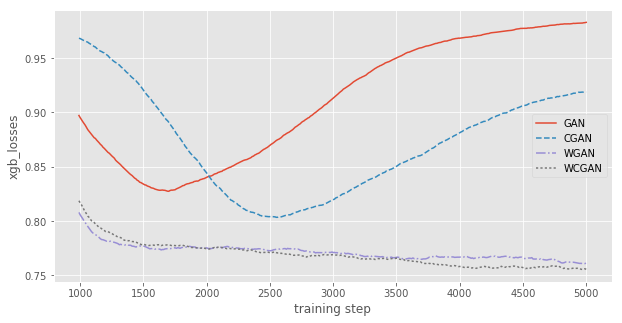

In [ ]:

# Look at the smoothed losses

data_fields = ['combined_losses_', 'real_losses_', 'generated_losses_', 'xgb_losses']
sampling_intervals = [ 1, 1, 1, 10 ]
labels = [ 'GAN','CGAN','WGAN','WCGAN' ]
linestyles = ['-', '--', '-.', ':']

w = 100
for data_ix in range(len(data_fields)):
    data_sets = [ GAN_losses[data_ix], CGAN_losses[data_ix], WGAN_losses[data_ix], WCGAN_losses[data_ix]]

    plt.figure(figsize=(10,5))
    for data, label, linestyle in zip(data_sets, labels, linestyles):
        plt.plot( np.array(range(0,len(data)))*sampling_intervals[data_ix],
                 pd.DataFrame(data).rolling(w).mean(),
                 label=label, linestyle=linestyle )

    plt.ylabel(data_fields[data_ix])
    plt.xlabel('training step')
    plt.legend()
    plt.show()


<a id="Fig6"><h1>Figure 6: Accuracy of Generated Data Detection</h1></a><br>

<a href='#TOC'>Table of contents</a>

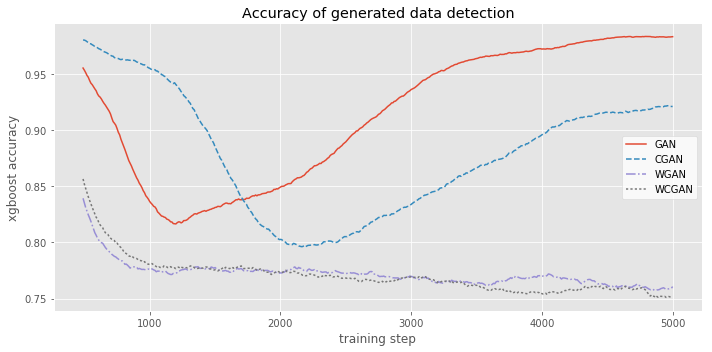

In [ ]:

# Create a figure for the smoothed xgboost losses

data_fields = ['combined_losses_', 'real_losses_', 'generated_losses_', 'xgb_losses']
sampling_intervals = [ 1, 1, 1, 10 ]
labels = [ 'GAN','CGAN','WGAN','WCGAN' ]
linestyles = ['-', '--', '-.', ':']

w = 50
data_ix = 3

data_sets = [ GAN_losses[data_ix], CGAN_losses[data_ix], WGAN_losses[data_ix], WCGAN_losses[data_ix]]

plt.figure(figsize=(10,5))
for data, label, linestyle in zip(data_sets, labels, linestyles):
    plt.plot( np.array(range(0,len(data)))*sampling_intervals[data_ix],
             pd.DataFrame(data).rolling(w).mean(),
             label=label, linestyle=linestyle )

plt.ylabel(data_fields[data_ix])
plt.xlabel('training step')
legend = plt.legend() 
legend.get_frame().set_facecolor('white')

plt.title('Accuracy of generated data detection')
plt.ylabel('xgboost accuracy')
plt.tight_layout() ;
# plt.savefig('plots/GAN_accuracy.png')

<a id="Fig7"><h1>Figure 7: Differences in Critic Loss</h1></a><br>

<a href='#TOC'>Table of contents</a>

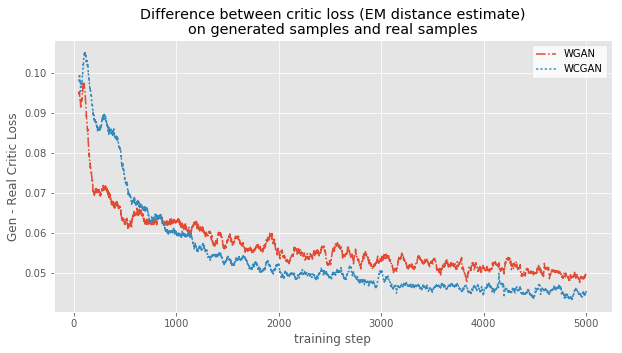

In [ ]:

# Create a figure for the critic losses for the WGAN and WCGAN

w = 50

data_ix0 = 2
data_ix1 = 1
data_fields = ['combined_losses_', 'real_losses_', 'generated_losses_', 'xgb_losses']

i1, i2 = 2, 3
i2 += 1

labels = [ 'GAN','CGAN','WGAN','WCGAN' ][i1:i2]
data_sets0 = [ GAN_losses[data_ix0], CGAN_losses[data_ix0], WGAN_losses[data_ix0], WCGAN_losses[data_ix0]][i1:i2]
data_sets1 = [ GAN_losses[data_ix1], CGAN_losses[data_ix1], WGAN_losses[data_ix1], WCGAN_losses[data_ix1]][i1:i2]
linestyles = ['-', '--', '-.', ':'][i1:i2]

plt.figure(figsize=(10,5))
for data0, data1, label, linestyle in zip(data_sets0, data_sets1, labels, linestyles):
    plt.plot( range(0,len(data0)), 
             pd.DataFrame( np.array(data0)-np.array(data1) ).rolling(w).mean(),  
             label=label, linestyle=linestyle )
plt.title('Difference between critic loss (EM distance estimate)\non generated samples and real samples')
plt.xlabel('training step')
plt.ylabel('Gen - Real Critic Loss')
legend = plt.legend() 
legend.get_frame().set_facecolor('white')
# plt.savefig('plots/Delta_critic_loss_plot.png')

<a id="DRAGAN"><h1>DRAGAN Training</h1></a>

<a href='#TOC'>Table of contents</a>
<br><br>


This section is less developed, and may contain more errors that average


A number of errors in the wiseodd code?:
- xavier initializer
- calculation of gradient penalties

Resources:
<br>
https://github.com/kodalinaveen3/DRAGAN
<br>
https://github.com/wiseodd/generative-models
<br>
https://github.com/wiseodd/generative-models/blob/master/GAN/improved_wasserstein_gan/wgan_gp_tensorflow.py
<br>
https://github.com/igul222/improved_wgan_training/blob/master/gan_toy.py


In [58]:
# Load engineered dataset from EDA section
data = pickle.load(open('data/' + 'credicard.engineered.pkl','rb'))

# Put columns in order of importance for xgboost fraud detection, from the xgboost section
sorted_cols = ['V14', 'V4', 'V10', 'V17', 'Time', 'V12', 'V26', 'Amount', 'V21', 'V8', 'V11', 'V7', 'V28', 'V19', 'V3', 'V22', 'V6', 'V20', 'V27', 'V16', 'V13', 'V25', 'V24', 'V18', 'V2', 'V1', 'V5', 'V15', 'V9', 'V23', 'Class']
data = data[ sorted_cols ].copy()

# data columns will be all other columns except class
data_cols = list(data.columns[ data.columns != 'Class' ])
data_dim = len(data_cols)
# label_cols = ['Class']
train = data.loc[ data.Class == 1, data_cols ].copy().reset_index(drop=True)
train[ data_cols ] = train[ data_cols ] / 10

with_class = False
show = True
data_dir = 'cache/'
cache_prefix = 'DRAGAN'
label_cols = []
log_interval = 100

z_dim = 32
X_dim = data_dim


In [59]:

# Load (and/or reload functions)

import GAN_171103
import importlib
importlib.reload(GAN_171103) # For reloading after making changes
from GAN_171103 import *


In [60]:

# Start with a clean tensorflow graph every time

tf.reset_default_graph()


In [61]:

# Define the DRAGAN network

mb_size = 128 # 128 # minibatch size
h_dim = 128 # 128 # hidden layer dim
lambda0 = 10
learning_rate = 1e-4 # 1e-4
global_seed = 0

[ D_solver, disc_cost, D_loss_real, D_loss_fake,
 X, X_p, z,
 G_solver, gen_cost, G_sample ] = \
    define_DRAGAN_network( X_dim=X_dim, h_dim=h_dim, z_dim=z_dim, learning_rate=learning_rate, mb_size=mb_size, seed=global_seed ) ;
    

In [62]:

# Set the tensorflow session, set seeds, create a saver function, and glance at the length of the operation set for the graph

sess = tf.Session()

np.random.seed(global_seed)
tf.set_random_seed(global_seed)
sess.graph.seed = global_seed

sess.run(tf.global_variables_initializer())

# saver = tf.train.Saver(theta_D + theta_G , max_to_keep=10000) # 20 Mb+ for all, 1.5 Mb for thetas only
saver = tf.train.Saver( max_to_keep=10000 ) # 20 Mb+ for all, 1.5 Mb for thetas only
# saver.save(sess, data_dir + cache_prefix + '_model_step_0' ) 
# saver.save(sess, data_dir + cache_prefix + '-initial_values' ) 
saver.save(sess, data_dir + cache_prefix ) 

combined_loss, disc_loss_generated, disc_loss_real, xgb_losses = [], [], [], []

best_xgb = 0.7

print( len( sess.graph.get_operations() ) )

1023


Iter: 0; D loss: 1.46; G_loss: -0.6656; xgb_loss: 0.9959


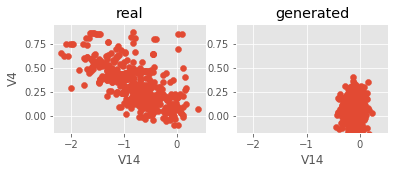

Iter: 100; D loss: 1.265; G_loss: -0.6605; xgb_loss: 0.9959


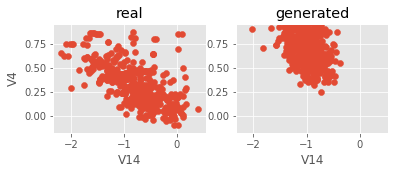

Iter: 200; D loss: 1.19; G_loss: -0.5886; xgb_loss: 0.9959


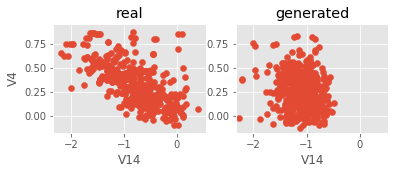

Iter: 300; D loss: 1.29; G_loss: -0.6229; xgb_loss: 0.9634


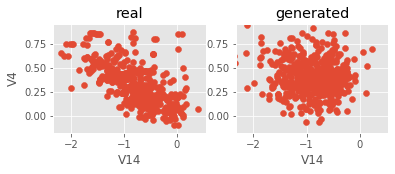

Iter: 400; D loss: 1.28; G_loss: -0.6359; xgb_loss: 0.9207


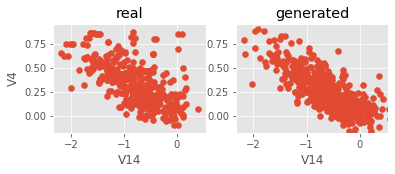

Iter: 500; D loss: 1.301; G_loss: -0.6606; xgb_loss: 0.9309


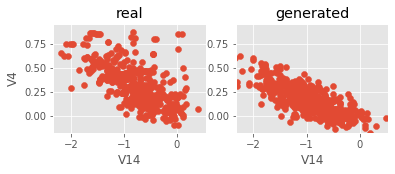

Iter: 600; D loss: 1.309; G_loss: -0.6363; xgb_loss: 0.8415


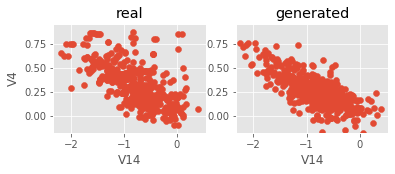

Iter: 700; D loss: 1.279; G_loss: -0.6228; xgb_loss: 0.878


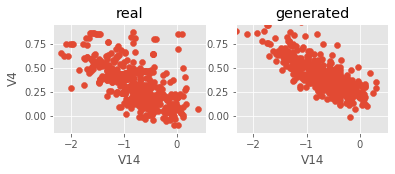

Iter: 800; D loss: 1.257; G_loss: -0.5986; xgb_loss: 0.8943


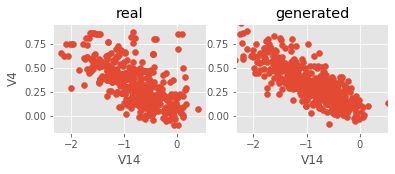

Iter: 900; D loss: 1.29; G_loss: -0.6452; xgb_loss: 0.8699


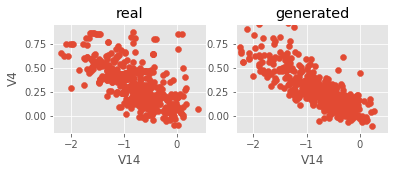

Iter: 1000; D loss: 1.266; G_loss: -0.6243; xgb_loss: 0.8293


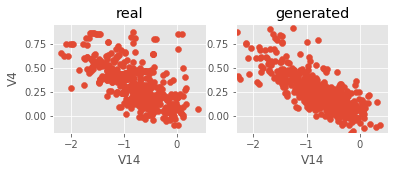

Iter: 1100; D loss: 1.321; G_loss: -0.6413; xgb_loss: 0.8923


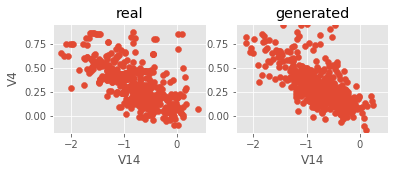

Iter: 1200; D loss: 1.303; G_loss: -0.6434; xgb_loss: 0.815


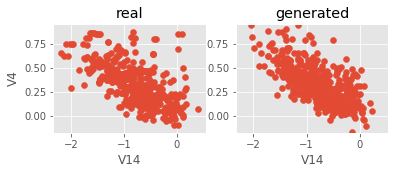

Iter: 1300; D loss: 1.298; G_loss: -0.6218; xgb_loss: 0.8455


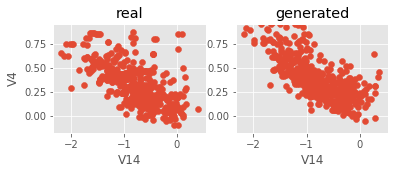

Iter: 1400; D loss: 1.32; G_loss: -0.6161; xgb_loss: 0.8333


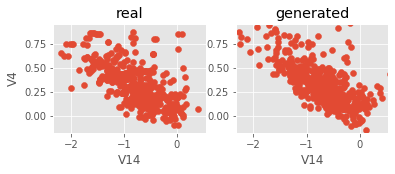

Iter: 1500; D loss: 1.31; G_loss: -0.6416; xgb_loss: 0.8923


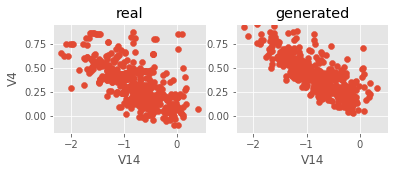

Iter: 1600; D loss: 1.316; G_loss: -0.658; xgb_loss: 0.7886


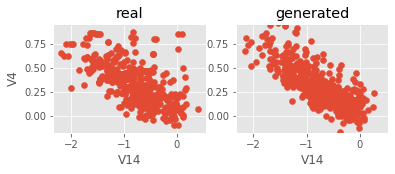

Iter: 1700; D loss: 1.303; G_loss: -0.6485; xgb_loss: 0.8293


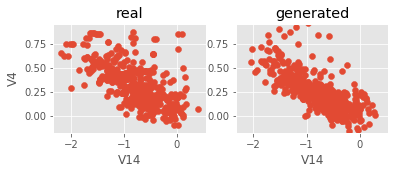

Iter: 1800; D loss: 1.309; G_loss: -0.6467; xgb_loss: 0.8455


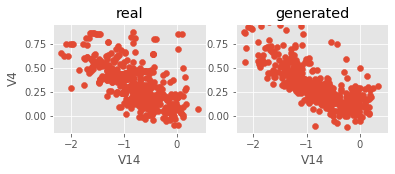

Iter: 1900; D loss: 1.304; G_loss: -0.654; xgb_loss: 0.8211


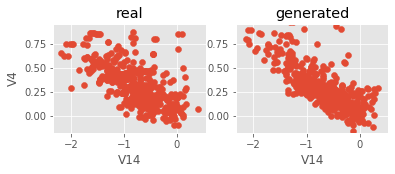

Iter: 2000; D loss: 1.28; G_loss: -0.6637; xgb_loss: 0.7805


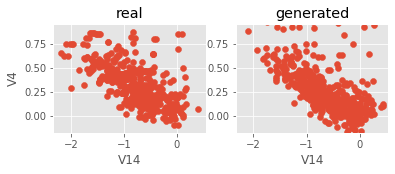

Iter: 2100; D loss: 1.289; G_loss: -0.6428; xgb_loss: 0.8008


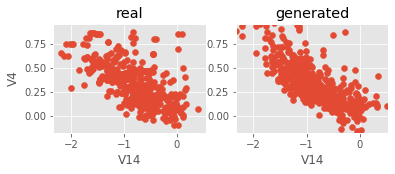

Iter: 2200; D loss: 1.286; G_loss: -0.6418; xgb_loss: 0.7642


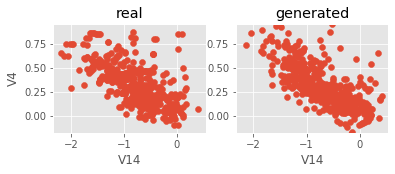

Iter: 2300; D loss: 1.3; G_loss: -0.6485; xgb_loss: 0.813


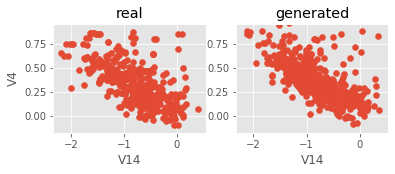

Iter: 2400; D loss: 1.286; G_loss: -0.6356; xgb_loss: 0.815


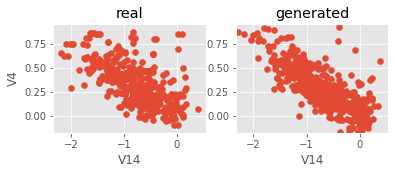

Iter: 2500; D loss: 1.296; G_loss: -0.6729; xgb_loss: 0.7886


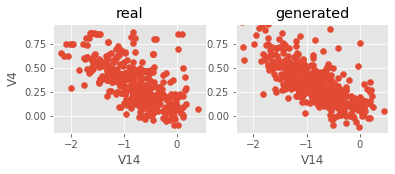

Iter: 2600; D loss: 1.29; G_loss: -0.6759; xgb_loss: 0.7927


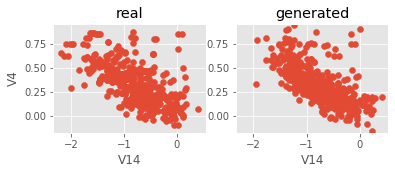

Iter: 2700; D loss: 1.289; G_loss: -0.6594; xgb_loss: 0.7866


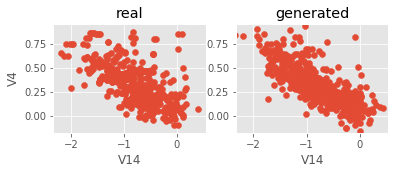

Iter: 2800; D loss: 1.291; G_loss: -0.6675; xgb_loss: 0.7703


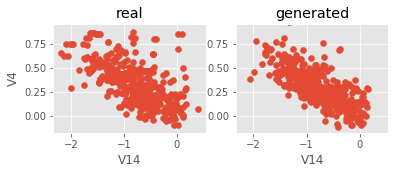

Iter: 2900; D loss: 1.308; G_loss: -0.645; xgb_loss: 0.8232


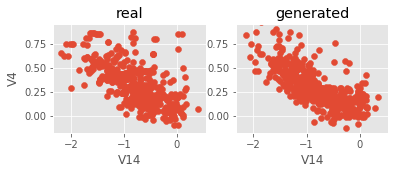

Iter: 3000; D loss: 1.31; G_loss: -0.7006; xgb_loss: 0.7764


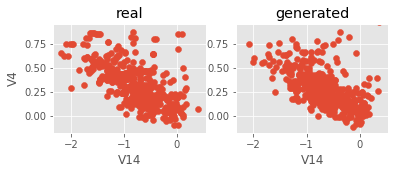

Iter: 3100; D loss: 1.304; G_loss: -0.6471; xgb_loss: 0.7907


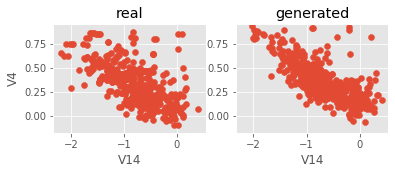

Iter: 3200; D loss: 1.305; G_loss: -0.6234; xgb_loss: 0.7907


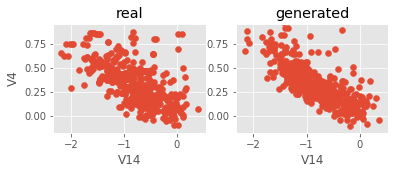

Iter: 3300; D loss: 1.279; G_loss: -0.6526; xgb_loss: 0.75


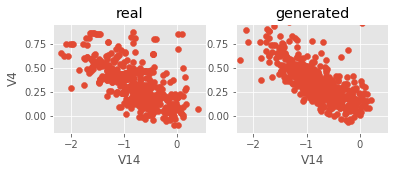

Iter: 3400; D loss: 1.31; G_loss: -0.6216; xgb_loss: 0.7886


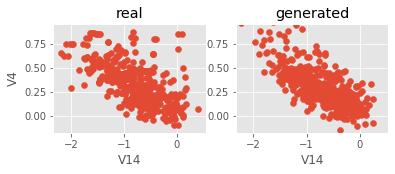

Iter: 3500; D loss: 1.313; G_loss: -0.7034; xgb_loss: 0.7825


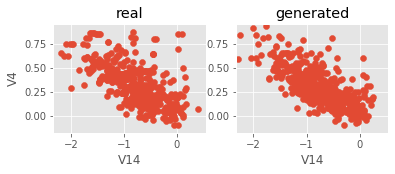

Iter: 3600; D loss: 1.293; G_loss: -0.6829; xgb_loss: 0.7825


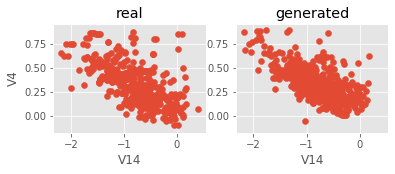

Iter: 3700; D loss: 1.32; G_loss: -0.6487; xgb_loss: 0.7581


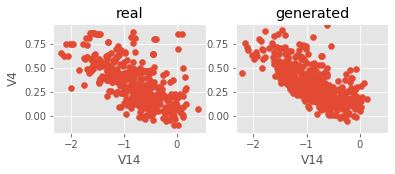

Iter: 3800; D loss: 1.306; G_loss: -0.6338; xgb_loss: 0.752


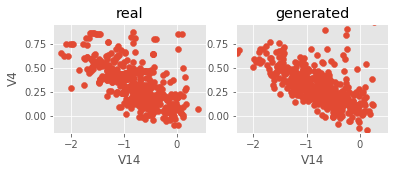

Iter: 3900; D loss: 1.308; G_loss: -0.6274; xgb_loss: 0.7541


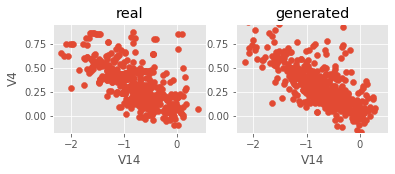

Iter: 4000; D loss: 1.303; G_loss: -0.6676; xgb_loss: 0.748


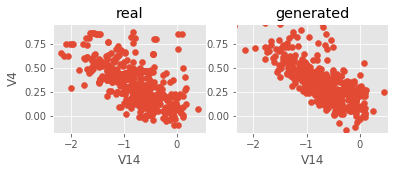

Iter: 4100; D loss: 1.303; G_loss: -0.6733; xgb_loss: 0.7134


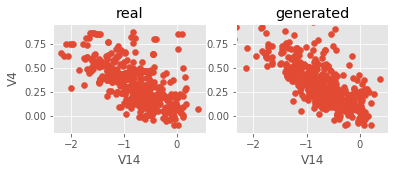

Iter: 4200; D loss: 1.309; G_loss: -0.685; xgb_loss: 0.7967


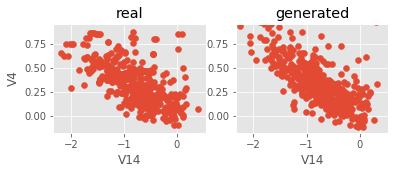

Iter: 4300; D loss: 1.314; G_loss: -0.6625; xgb_loss: 0.7825


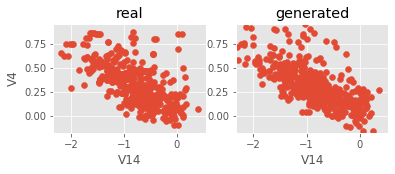

Iter: 4400; D loss: 1.294; G_loss: -0.6644; xgb_loss: 0.7907


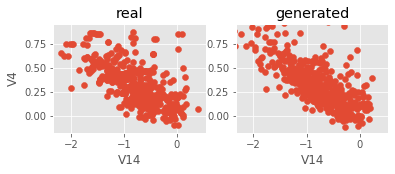

Iter: 4500; D loss: 1.293; G_loss: -0.658; xgb_loss: 0.7602


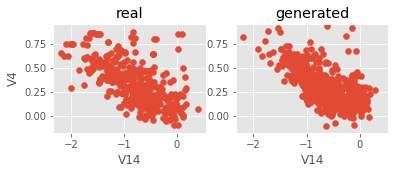

Iter: 4600; D loss: 1.302; G_loss: -0.6089; xgb_loss: 0.7642


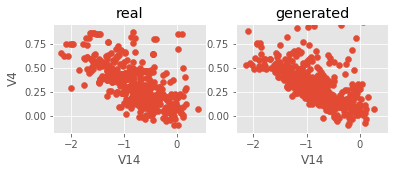

Iter: 4700; D loss: 1.316; G_loss: -0.6693; xgb_loss: 0.7459


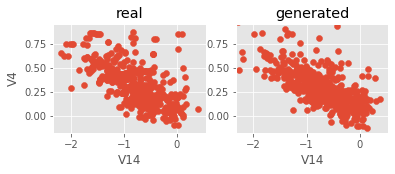

Iter: 4800; D loss: 1.316; G_loss: -0.6689; xgb_loss: 0.7805


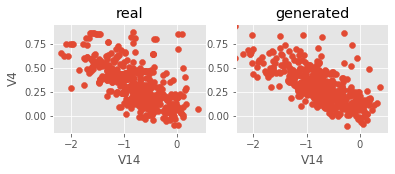

Iter: 4900; D loss: 1.3; G_loss: -0.6605; xgb_loss: 0.7805


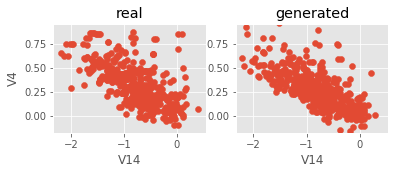

Iter: 5000; D loss: 1.289; G_loss: -0.6763; xgb_loss: 0.7724


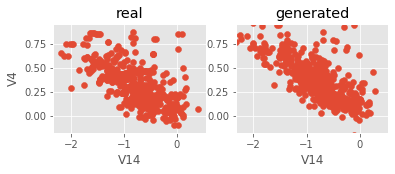

Iter: 5100; D loss: 1.315; G_loss: -0.6689; xgb_loss: 0.7581


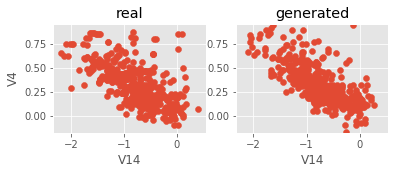

Iter: 5200; D loss: 1.292; G_loss: -0.6633; xgb_loss: 0.8028


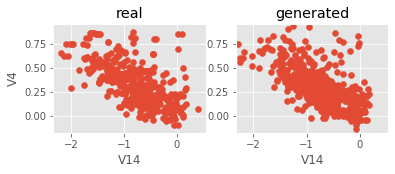

Iter: 5300; D loss: 1.304; G_loss: -0.67; xgb_loss: 0.7642


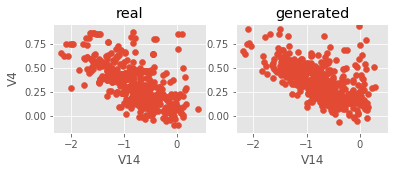

Iter: 5400; D loss: 1.298; G_loss: -0.6752; xgb_loss: 0.7866


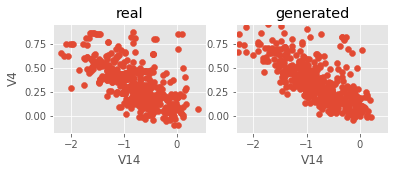

Iter: 5500; D loss: 1.292; G_loss: -0.6443; xgb_loss: 0.7215


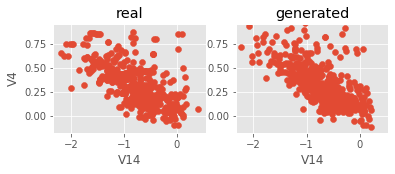

Iter: 5600; D loss: 1.276; G_loss: -0.6922; xgb_loss: 0.7297


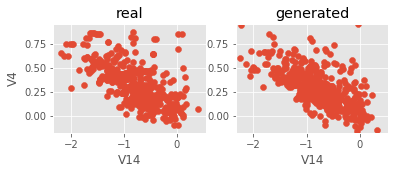

Iter: 5700; D loss: 1.315; G_loss: -0.6581; xgb_loss: 0.7439


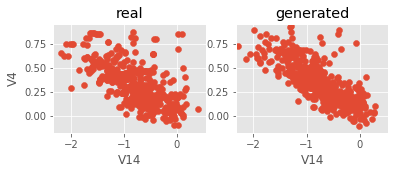

Iter: 5800; D loss: 1.308; G_loss: -0.671; xgb_loss: 0.7764


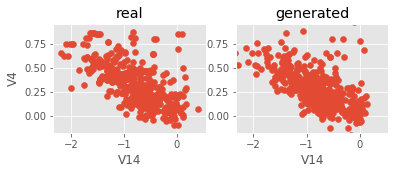

Iter: 5900; D loss: 1.302; G_loss: -0.6457; xgb_loss: 0.7541


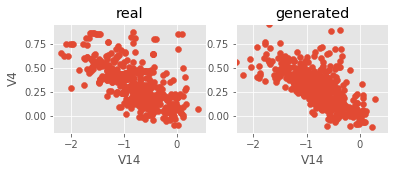

Iter: 6000; D loss: 1.31; G_loss: -0.6574; xgb_loss: 0.815


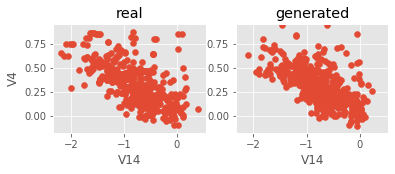

Iter: 6100; D loss: 1.303; G_loss: -0.6505; xgb_loss: 0.8049


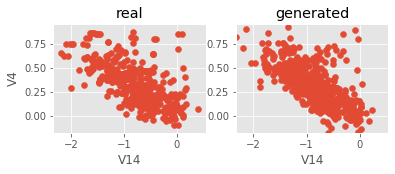

Iter: 6200; D loss: 1.312; G_loss: -0.6552; xgb_loss: 0.7561


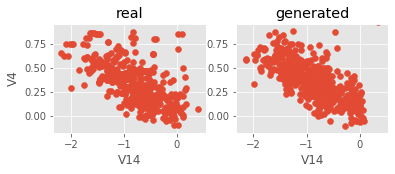

Iter: 6300; D loss: 1.296; G_loss: -0.6439; xgb_loss: 0.748


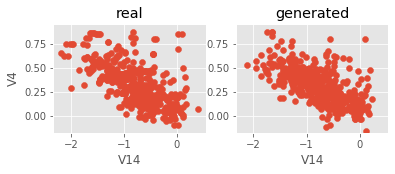

Iter: 6400; D loss: 1.327; G_loss: -0.6498; xgb_loss: 0.8008


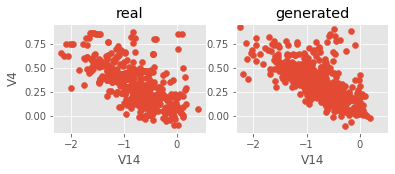

Iter: 6500; D loss: 1.315; G_loss: -0.6696; xgb_loss: 0.7683


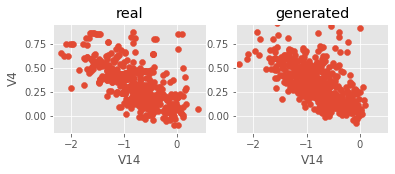

Iter: 6600; D loss: 1.311; G_loss: -0.6602; xgb_loss: 0.7866


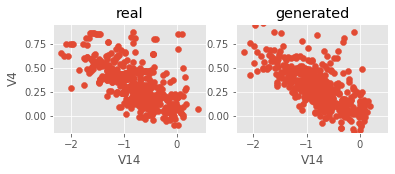

Iter: 6700; D loss: 1.298; G_loss: -0.6555; xgb_loss: 0.7967


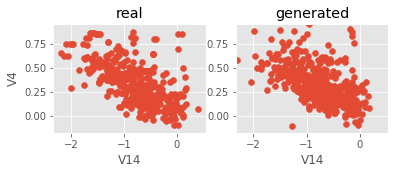

Iter: 6800; D loss: 1.311; G_loss: -0.6648; xgb_loss: 0.7154


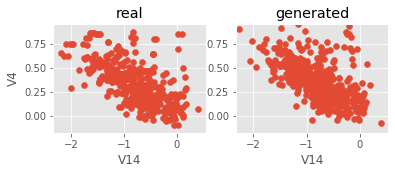

Iter: 6900; D loss: 1.304; G_loss: -0.6626; xgb_loss: 0.7215


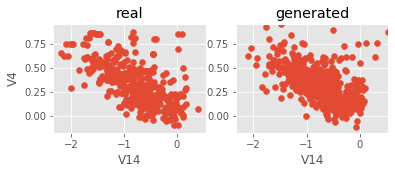

Iter: 7000; D loss: 1.308; G_loss: -0.6747; xgb_loss: 0.7764


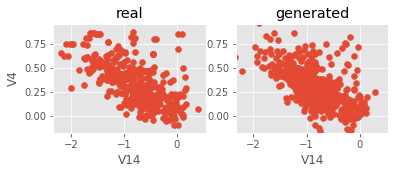

Iter: 7100; D loss: 1.303; G_loss: -0.6444; xgb_loss: 0.7358


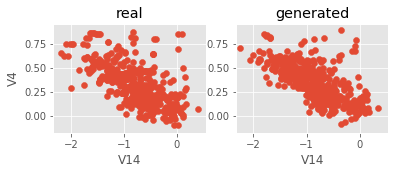

Iter: 7200; D loss: 1.312; G_loss: -0.6618; xgb_loss: 0.7541


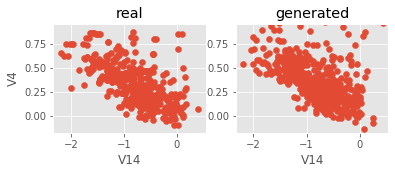

Iter: 7300; D loss: 1.325; G_loss: -0.6649; xgb_loss: 0.7134


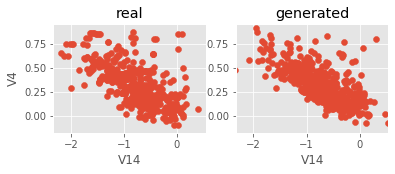

Iter: 7400; D loss: 1.306; G_loss: -0.6806; xgb_loss: 0.7541


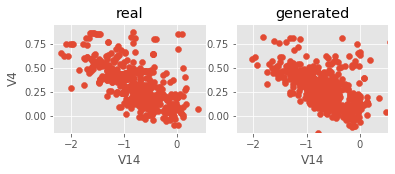

Iter: 7500; D loss: 1.326; G_loss: -0.6647; xgb_loss: 0.7764


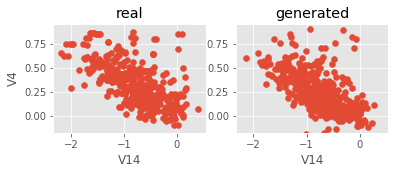

Iter: 7600; D loss: 1.303; G_loss: -0.6379; xgb_loss: 0.75


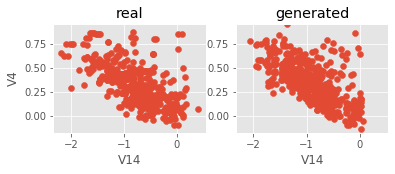

Iter: 7700; D loss: 1.314; G_loss: -0.6484; xgb_loss: 0.7256


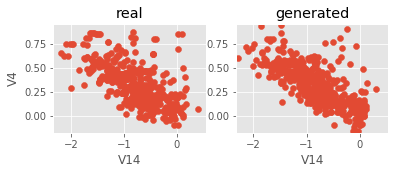

Iter: 7800; D loss: 1.307; G_loss: -0.6763; xgb_loss: 0.7825


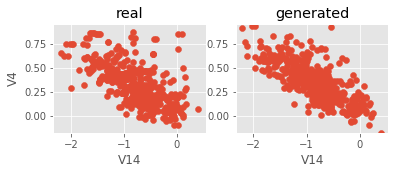

Iter: 7900; D loss: 1.31; G_loss: -0.6543; xgb_loss: 0.7825


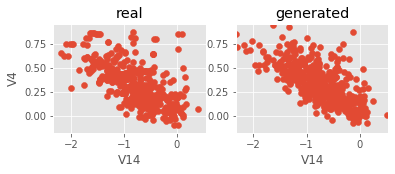

Iter: 8000; D loss: 1.319; G_loss: -0.6573; xgb_loss: 0.7602


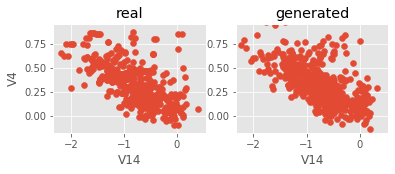

Iter: 8100; D loss: 1.316; G_loss: -0.6512; xgb_loss: 0.7825


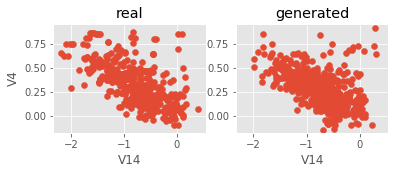

Iter: 8200; D loss: 1.305; G_loss: -0.6735; xgb_loss: 0.7703


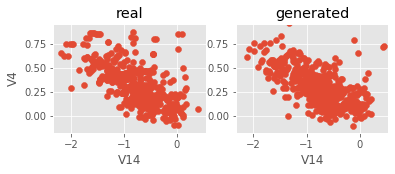

Iter: 8300; D loss: 1.298; G_loss: -0.6431; xgb_loss: 0.7358


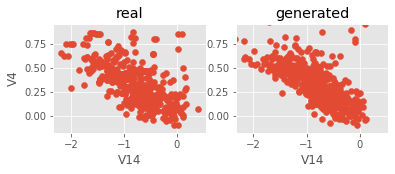

Iter: 8400; D loss: 1.329; G_loss: -0.6398; xgb_loss: 0.7927


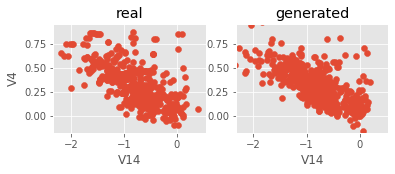

Iter: 8500; D loss: 1.306; G_loss: -0.6655; xgb_loss: 0.7805


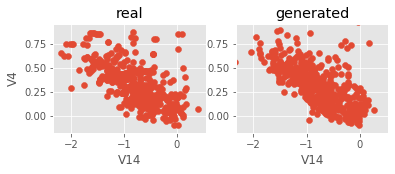

Iter: 8600; D loss: 1.301; G_loss: -0.6354; xgb_loss: 0.8028


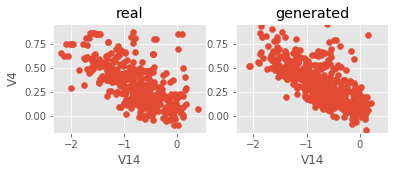

Iter: 8700; D loss: 1.29; G_loss: -0.6733; xgb_loss: 0.7663


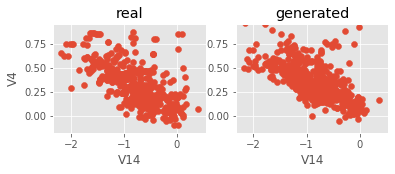

Iter: 8800; D loss: 1.302; G_loss: -0.633; xgb_loss: 0.6646


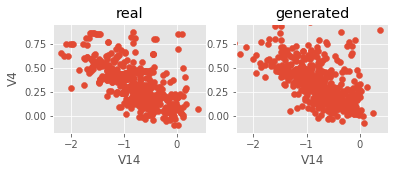

Iter: 8900; D loss: 1.317; G_loss: -0.6296; xgb_loss: 0.7419


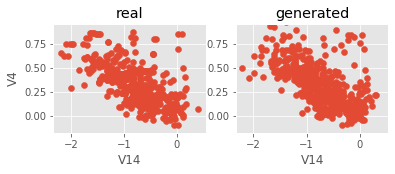

Iter: 9000; D loss: 1.293; G_loss: -0.6321; xgb_loss: 0.7947


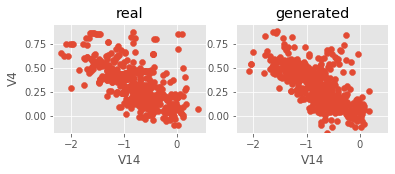

Iter: 9100; D loss: 1.291; G_loss: -0.6362; xgb_loss: 0.7846


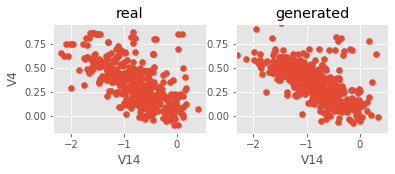

Iter: 9200; D loss: 1.309; G_loss: -0.6468; xgb_loss: 0.7622


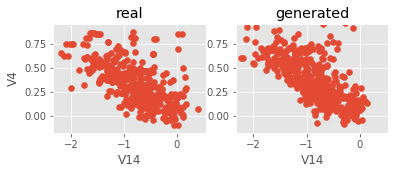

Iter: 9300; D loss: 1.292; G_loss: -0.7046; xgb_loss: 0.7744


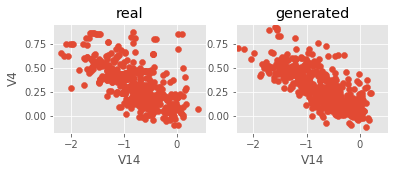

Iter: 9400; D loss: 1.302; G_loss: -0.653; xgb_loss: 0.7602


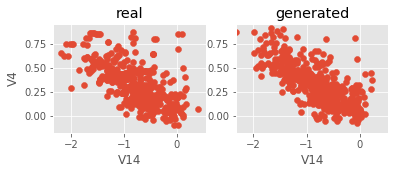

Iter: 9500; D loss: 1.286; G_loss: -0.6343; xgb_loss: 0.7988


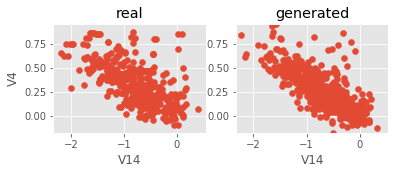

Iter: 9600; D loss: 1.313; G_loss: -0.6843; xgb_loss: 0.7581


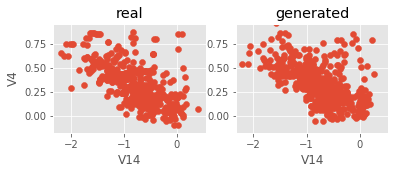

Iter: 9700; D loss: 1.306; G_loss: -0.6541; xgb_loss: 0.7236


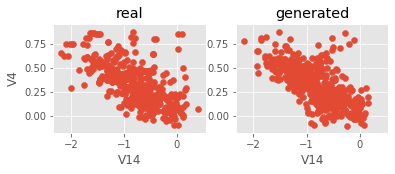

Iter: 9800; D loss: 1.319; G_loss: -0.639; xgb_loss: 0.7602


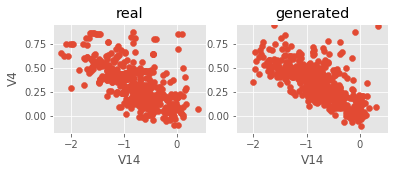

Iter: 9900; D loss: 1.299; G_loss: -0.6932; xgb_loss: 0.7724


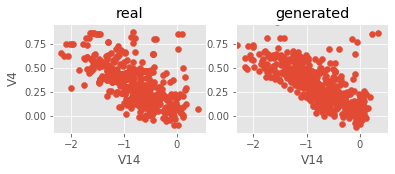

Iter: 10000; D loss: 1.315; G_loss: -0.6605; xgb_loss: 0.7439


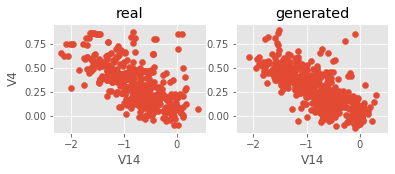

Iter: 10100; D loss: 1.31; G_loss: -0.6562; xgb_loss: 0.7622


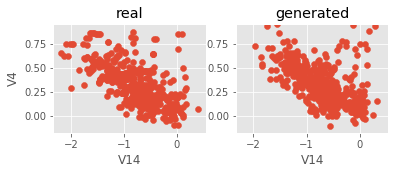

Iter: 10200; D loss: 1.292; G_loss: -0.6429; xgb_loss: 0.7724


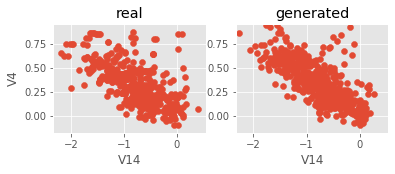

Iter: 10300; D loss: 1.291; G_loss: -0.675; xgb_loss: 0.7886


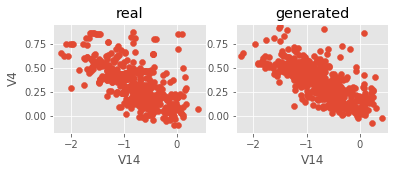

Iter: 10400; D loss: 1.303; G_loss: -0.6464; xgb_loss: 0.7825


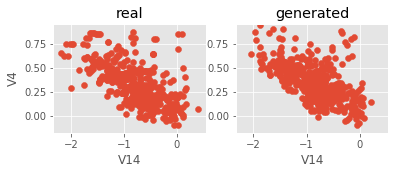

Iter: 10500; D loss: 1.288; G_loss: -0.6264; xgb_loss: 0.7033


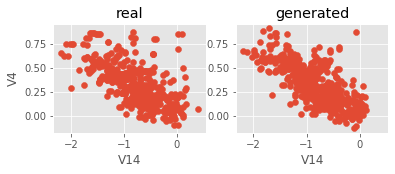

Iter: 10600; D loss: 1.297; G_loss: -0.6867; xgb_loss: 0.7561


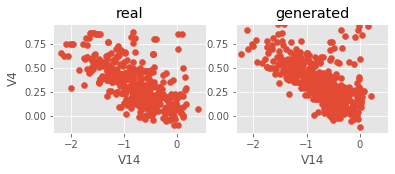

Iter: 10700; D loss: 1.283; G_loss: -0.7081; xgb_loss: 0.7683


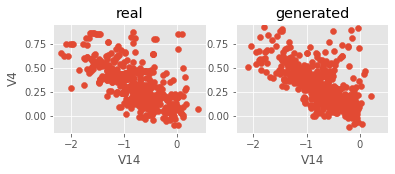

Iter: 10800; D loss: 1.287; G_loss: -0.6427; xgb_loss: 0.7459


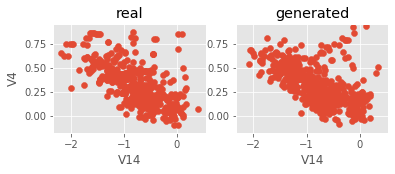

Iter: 10900; D loss: 1.291; G_loss: -0.6523; xgb_loss: 0.7337


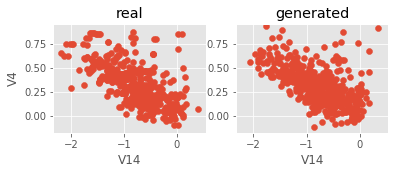

Iter: 11000; D loss: 1.302; G_loss: -0.7021; xgb_loss: 0.748


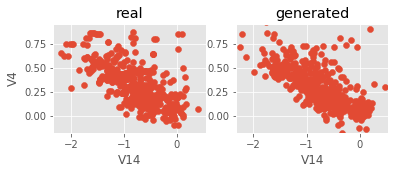

Iter: 11100; D loss: 1.302; G_loss: -0.6668; xgb_loss: 0.7297


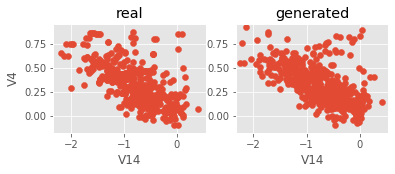

Iter: 11200; D loss: 1.29; G_loss: -0.6752; xgb_loss: 0.7378


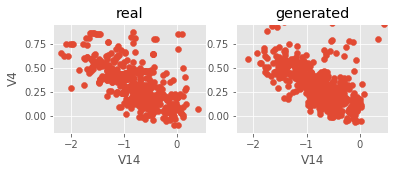

Iter: 11300; D loss: 1.304; G_loss: -0.6667; xgb_loss: 0.752


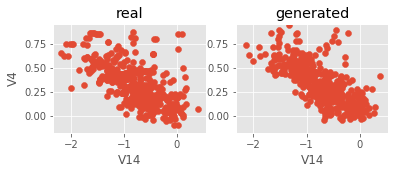

Iter: 11400; D loss: 1.301; G_loss: -0.6786; xgb_loss: 0.7378


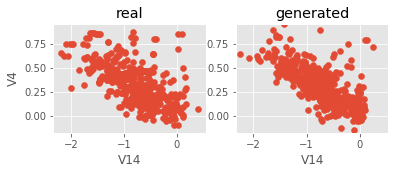

Iter: 11500; D loss: 1.299; G_loss: -0.6669; xgb_loss: 0.7785


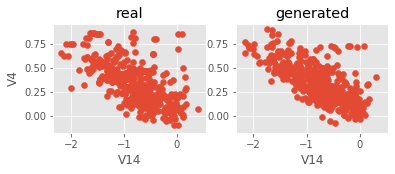

Iter: 11600; D loss: 1.295; G_loss: -0.6553; xgb_loss: 0.7561


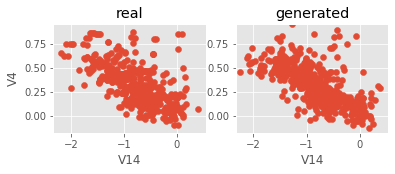

Iter: 11700; D loss: 1.297; G_loss: -0.6695; xgb_loss: 0.7561


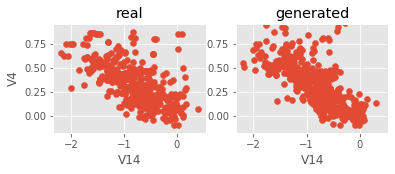

Iter: 11800; D loss: 1.301; G_loss: -0.6889; xgb_loss: 0.7846


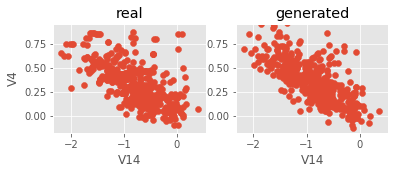

Iter: 11900; D loss: 1.307; G_loss: -0.6494; xgb_loss: 0.7378


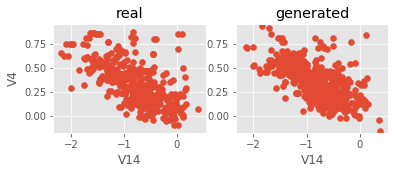

Iter: 12000; D loss: 1.289; G_loss: -0.6762; xgb_loss: 0.7683


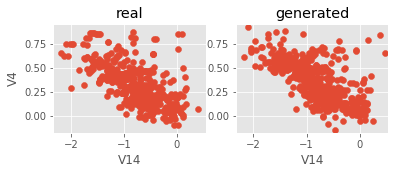

Iter: 12100; D loss: 1.286; G_loss: -0.6882; xgb_loss: 0.7256


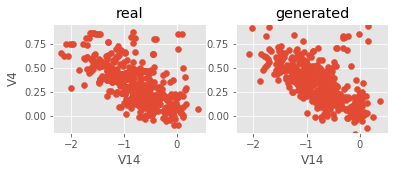

Iter: 12200; D loss: 1.284; G_loss: -0.6602; xgb_loss: 0.685


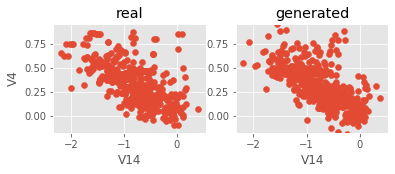

Iter: 12300; D loss: 1.305; G_loss: -0.6744; xgb_loss: 0.7663


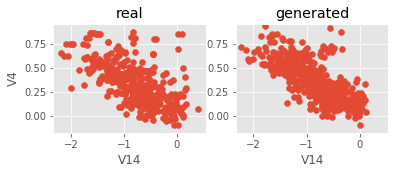

Iter: 12400; D loss: 1.309; G_loss: -0.6433; xgb_loss: 0.7561


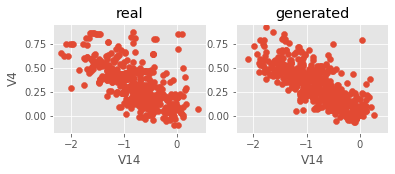

Iter: 12500; D loss: 1.291; G_loss: -0.6242; xgb_loss: 0.7317


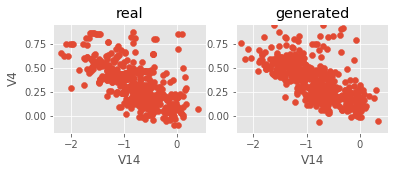

Iter: 12600; D loss: 1.325; G_loss: -0.6466; xgb_loss: 0.7358


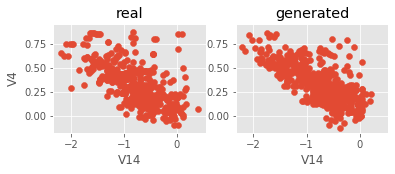

Iter: 12700; D loss: 1.29; G_loss: -0.6391; xgb_loss: 0.6972


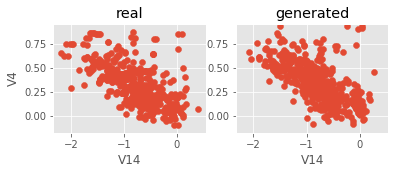

Iter: 12800; D loss: 1.329; G_loss: -0.6862; xgb_loss: 0.8089


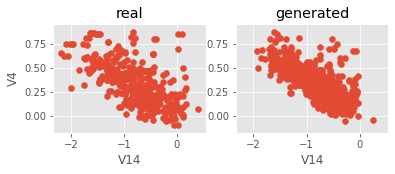

Iter: 12900; D loss: 1.293; G_loss: -0.6653; xgb_loss: 0.7114


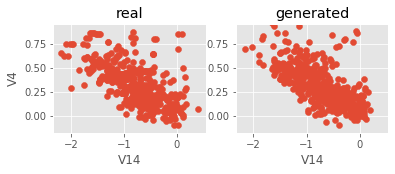

Iter: 13000; D loss: 1.311; G_loss: -0.6554; xgb_loss: 0.75


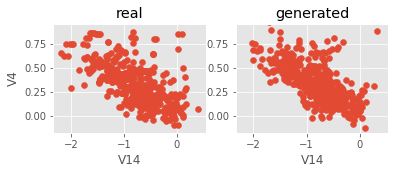

Iter: 13100; D loss: 1.304; G_loss: -0.6427; xgb_loss: 0.7907


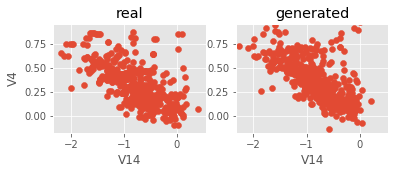

Iter: 13200; D loss: 1.297; G_loss: -0.6533; xgb_loss: 0.7703


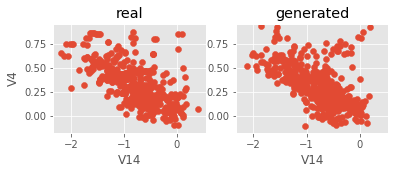

Iter: 13300; D loss: 1.334; G_loss: -0.6645; xgb_loss: 0.7703


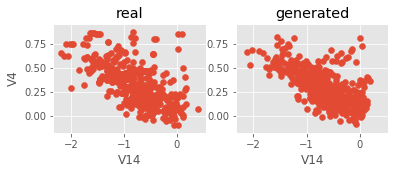

Iter: 13400; D loss: 1.293; G_loss: -0.6396; xgb_loss: 0.7276


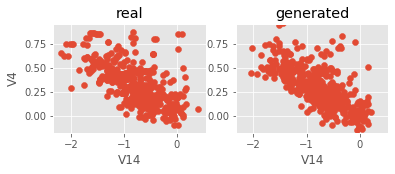

Iter: 13500; D loss: 1.321; G_loss: -0.6782; xgb_loss: 0.7642


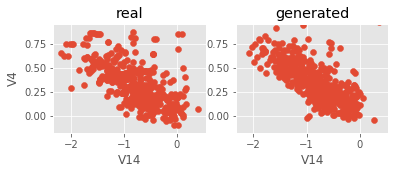

Iter: 13600; D loss: 1.307; G_loss: -0.6841; xgb_loss: 0.7439


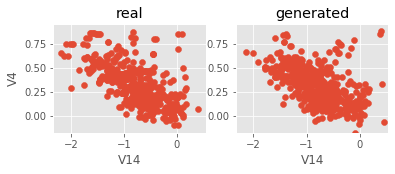

Iter: 13700; D loss: 1.321; G_loss: -0.6399; xgb_loss: 0.7947


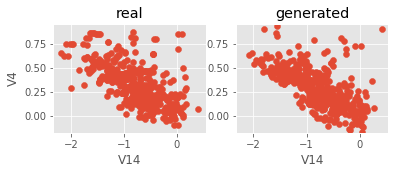

Iter: 13800; D loss: 1.31; G_loss: -0.6257; xgb_loss: 0.7459


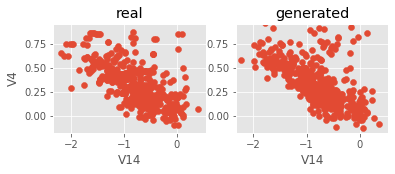

Iter: 13900; D loss: 1.299; G_loss: -0.6551; xgb_loss: 0.7541


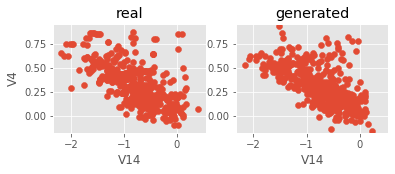

Iter: 14000; D loss: 1.303; G_loss: -0.631; xgb_loss: 0.7846


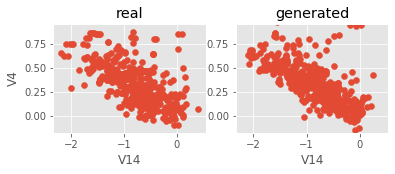

Iter: 14100; D loss: 1.299; G_loss: -0.6747; xgb_loss: 0.7947


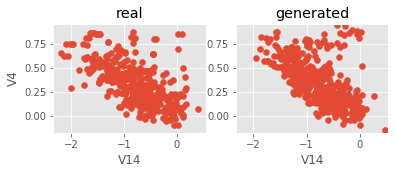

Iter: 14200; D loss: 1.293; G_loss: -0.6109; xgb_loss: 0.7846


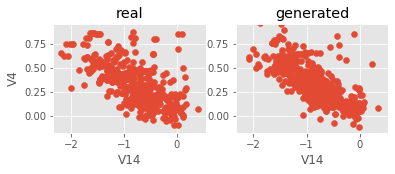

Iter: 14300; D loss: 1.314; G_loss: -0.6721; xgb_loss: 0.7358


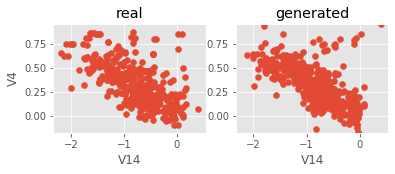

Iter: 14400; D loss: 1.303; G_loss: -0.6376; xgb_loss: 0.7236


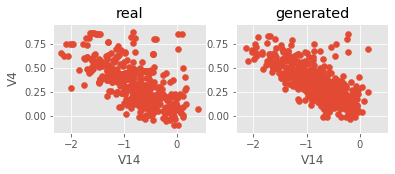

Iter: 14500; D loss: 1.303; G_loss: -0.6528; xgb_loss: 0.7764


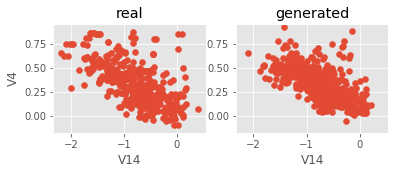

Iter: 14600; D loss: 1.314; G_loss: -0.6358; xgb_loss: 0.7764


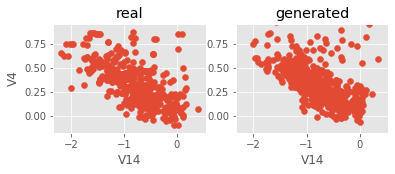

Iter: 14700; D loss: 1.309; G_loss: -0.6431; xgb_loss: 0.7642


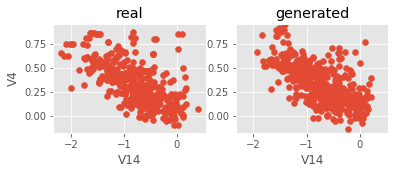

Iter: 14800; D loss: 1.285; G_loss: -0.648; xgb_loss: 0.7276


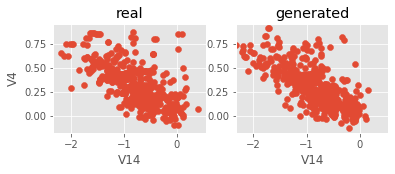

Iter: 14900; D loss: 1.291; G_loss: -0.6825; xgb_loss: 0.7337


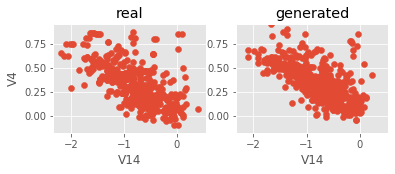

Iter: 15000; D loss: 1.314; G_loss: -0.6668; xgb_loss: 0.7602


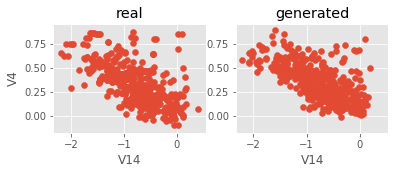

Iter: 15100; D loss: 1.289; G_loss: -0.6904; xgb_loss: 0.7825


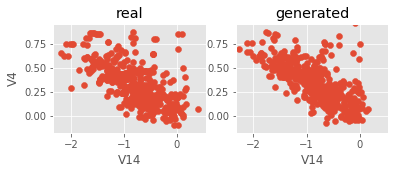

Iter: 15200; D loss: 1.315; G_loss: -0.6523; xgb_loss: 0.7317


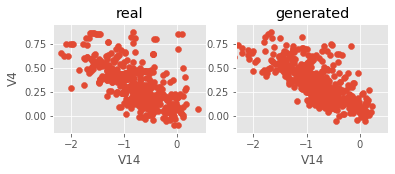

Iter: 15300; D loss: 1.305; G_loss: -0.6777; xgb_loss: 0.7439


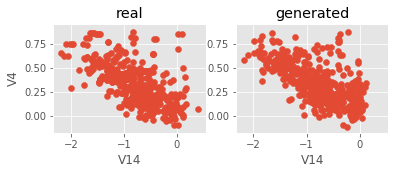

Iter: 15400; D loss: 1.312; G_loss: -0.6495; xgb_loss: 0.7317


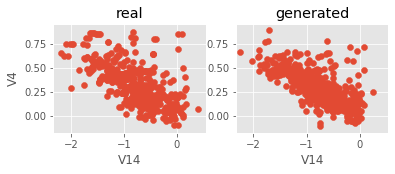

Iter: 15500; D loss: 1.302; G_loss: -0.6649; xgb_loss: 0.7012


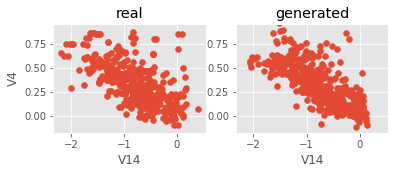

Iter: 15600; D loss: 1.289; G_loss: -0.6345; xgb_loss: 0.7724


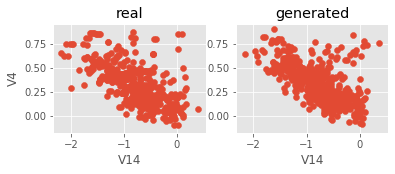

Iter: 15700; D loss: 1.299; G_loss: -0.6361; xgb_loss: 0.7459


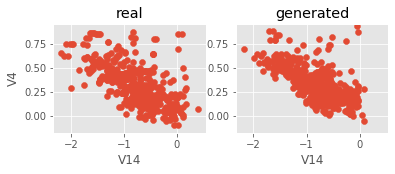

Iter: 15800; D loss: 1.307; G_loss: -0.6532; xgb_loss: 0.7419


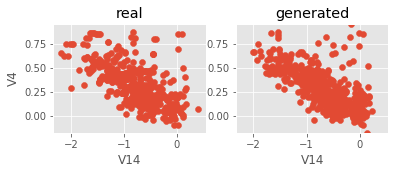

Iter: 15900; D loss: 1.324; G_loss: -0.6685; xgb_loss: 0.7134


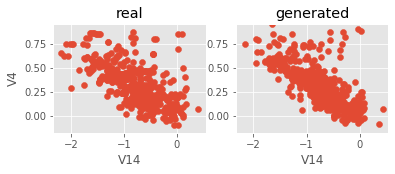

Iter: 16000; D loss: 1.303; G_loss: -0.6629; xgb_loss: 0.7439


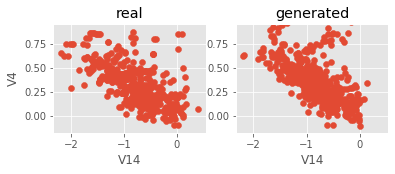

Iter: 16100; D loss: 1.312; G_loss: -0.6622; xgb_loss: 0.7337


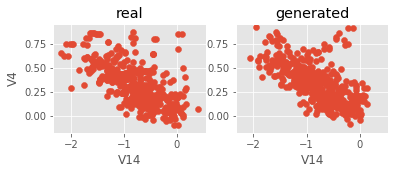

Iter: 16200; D loss: 1.297; G_loss: -0.6972; xgb_loss: 0.6951


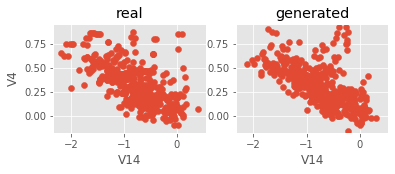

Iter: 16300; D loss: 1.303; G_loss: -0.6443; xgb_loss: 0.7602


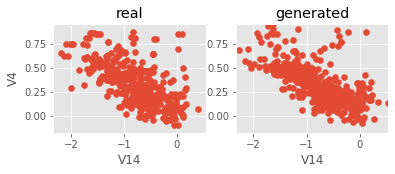

Iter: 16400; D loss: 1.299; G_loss: -0.6826; xgb_loss: 0.7195


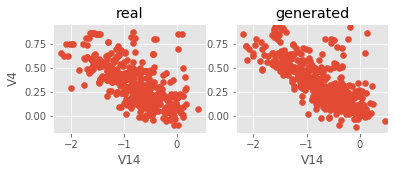

Iter: 16500; D loss: 1.292; G_loss: -0.6818; xgb_loss: 0.7581


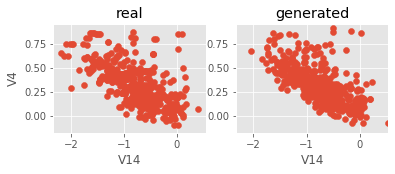

Iter: 16600; D loss: 1.295; G_loss: -0.6544; xgb_loss: 0.7581


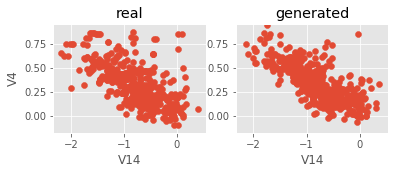

Iter: 16700; D loss: 1.322; G_loss: -0.6667; xgb_loss: 0.748


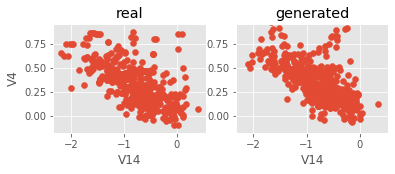

Iter: 16800; D loss: 1.307; G_loss: -0.6405; xgb_loss: 0.7785


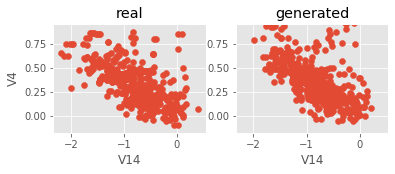

Iter: 16900; D loss: 1.302; G_loss: -0.6382; xgb_loss: 0.7622


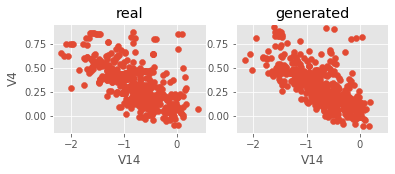

Iter: 17000; D loss: 1.293; G_loss: -0.6693; xgb_loss: 0.7724


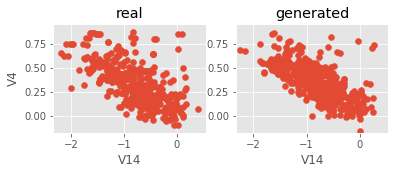

Iter: 17100; D loss: 1.306; G_loss: -0.6954; xgb_loss: 0.7744


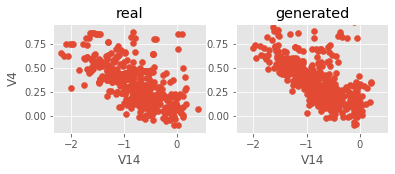

Iter: 17200; D loss: 1.296; G_loss: -0.6856; xgb_loss: 0.7866


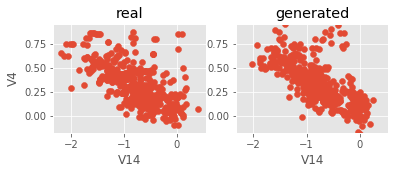

Iter: 17300; D loss: 1.286; G_loss: -0.675; xgb_loss: 0.7134


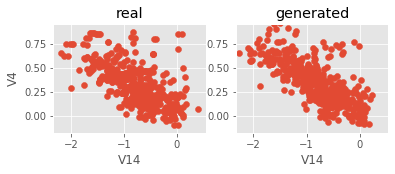

Iter: 17400; D loss: 1.303; G_loss: -0.6465; xgb_loss: 0.7073


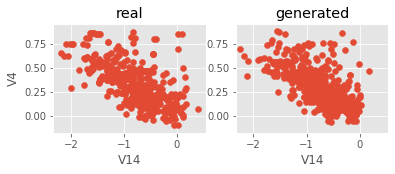

Iter: 17500; D loss: 1.313; G_loss: -0.6545; xgb_loss: 0.7581


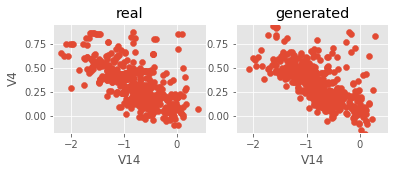

Iter: 17600; D loss: 1.3; G_loss: -0.6696; xgb_loss: 0.7276


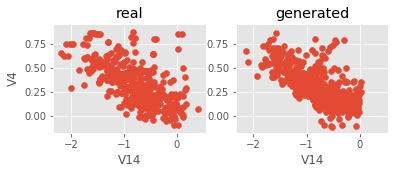

Iter: 17700; D loss: 1.287; G_loss: -0.6626; xgb_loss: 0.7846


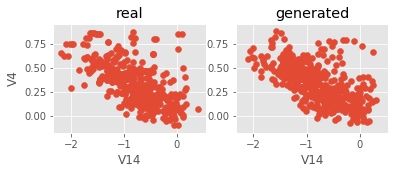

Iter: 17800; D loss: 1.293; G_loss: -0.6875; xgb_loss: 0.7439


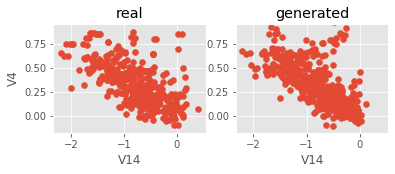

Iter: 17900; D loss: 1.285; G_loss: -0.6458; xgb_loss: 0.752


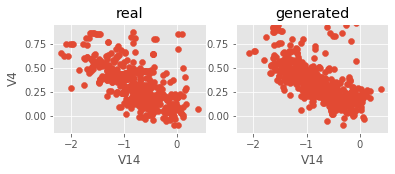

Iter: 18000; D loss: 1.296; G_loss: -0.6864; xgb_loss: 0.7236


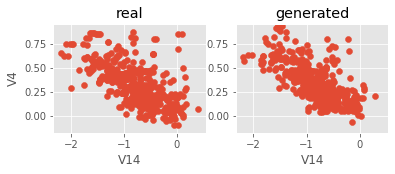

Iter: 18100; D loss: 1.305; G_loss: -0.6633; xgb_loss: 0.7622


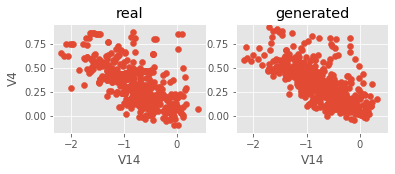

Iter: 18200; D loss: 1.304; G_loss: -0.6547; xgb_loss: 0.6931


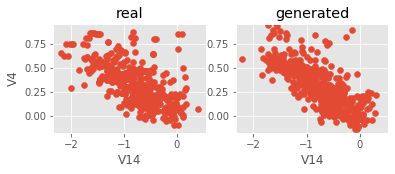

Iter: 18300; D loss: 1.279; G_loss: -0.6689; xgb_loss: 0.7215


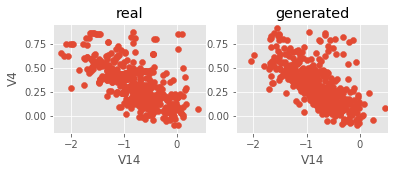

Iter: 18400; D loss: 1.297; G_loss: -0.6728; xgb_loss: 0.7358


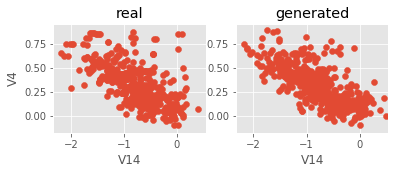

Iter: 18500; D loss: 1.3; G_loss: -0.6308; xgb_loss: 0.7154


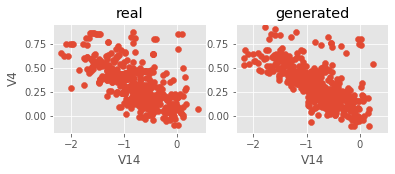

Iter: 18600; D loss: 1.311; G_loss: -0.6215; xgb_loss: 0.7602


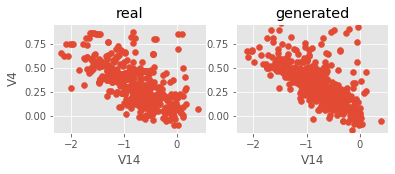

Iter: 18700; D loss: 1.316; G_loss: -0.6948; xgb_loss: 0.7439


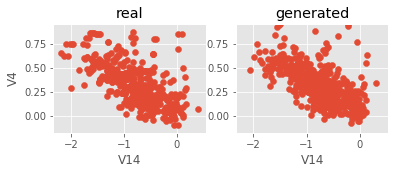

Iter: 18800; D loss: 1.313; G_loss: -0.628; xgb_loss: 0.7256


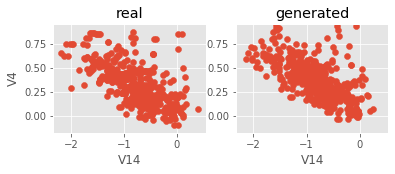

Iter: 18900; D loss: 1.307; G_loss: -0.667; xgb_loss: 0.7114


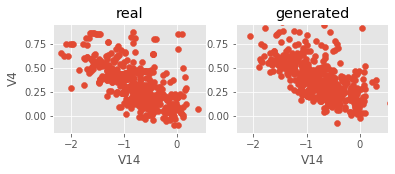

Iter: 19000; D loss: 1.298; G_loss: -0.6385; xgb_loss: 0.748


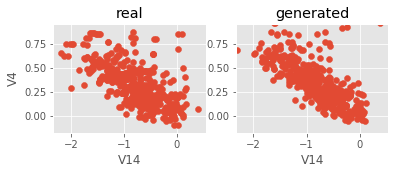

Iter: 19100; D loss: 1.291; G_loss: -0.6674; xgb_loss: 0.7419


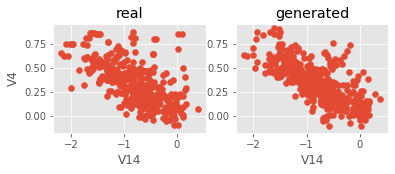

Iter: 19200; D loss: 1.302; G_loss: -0.6368; xgb_loss: 0.7195


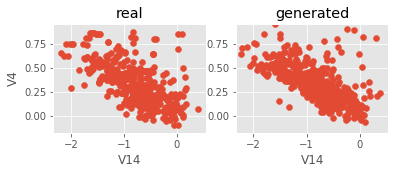

Iter: 19300; D loss: 1.311; G_loss: -0.6764; xgb_loss: 0.7724


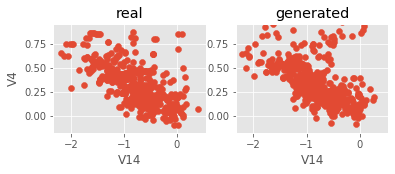

Iter: 19400; D loss: 1.311; G_loss: -0.6201; xgb_loss: 0.7378


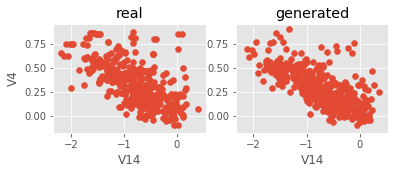

Iter: 19500; D loss: 1.309; G_loss: -0.631; xgb_loss: 0.7195


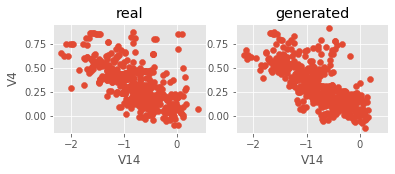

Iter: 19600; D loss: 1.297; G_loss: -0.6653; xgb_loss: 0.7419


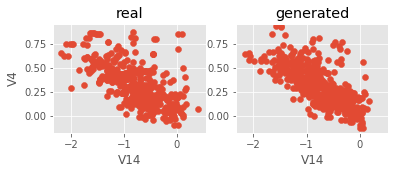

Iter: 19700; D loss: 1.313; G_loss: -0.6462; xgb_loss: 0.7805


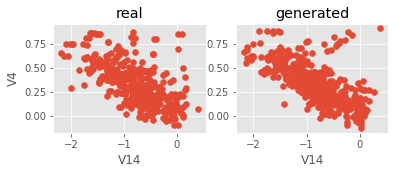

Iter: 19800; D loss: 1.311; G_loss: -0.6382; xgb_loss: 0.7439


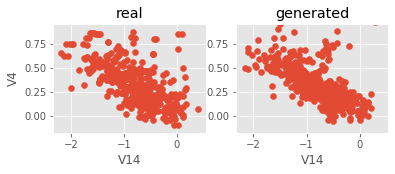

Iter: 19900; D loss: 1.307; G_loss: -0.6657; xgb_loss: 0.7175


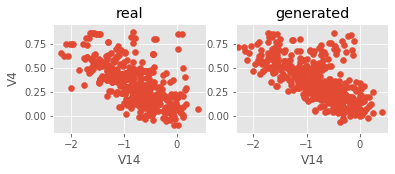

Iter: 20000; D loss: 1.287; G_loss: -0.6189; xgb_loss: 0.7541


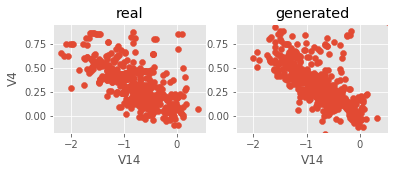

Iter: 20100; D loss: 1.303; G_loss: -0.6585; xgb_loss: 0.7073


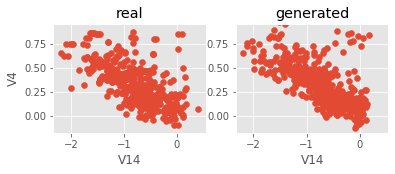

Iter: 20200; D loss: 1.29; G_loss: -0.6246; xgb_loss: 0.7764


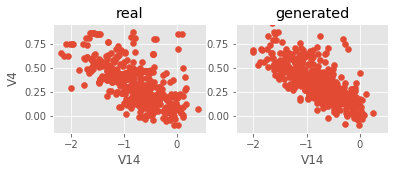

Iter: 20300; D loss: 1.308; G_loss: -0.6437; xgb_loss: 0.7358


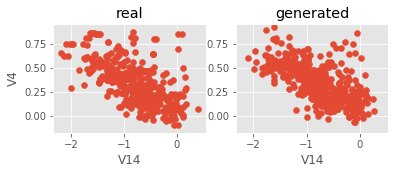

Iter: 20400; D loss: 1.295; G_loss: -0.6396; xgb_loss: 0.7398


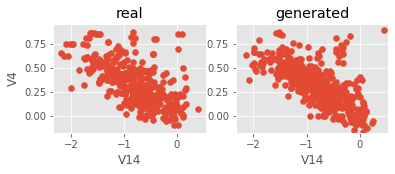

Iter: 20500; D loss: 1.292; G_loss: -0.6659; xgb_loss: 0.752


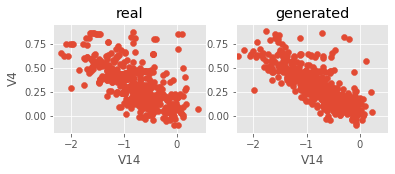

Iter: 20600; D loss: 1.326; G_loss: -0.6684; xgb_loss: 0.7378


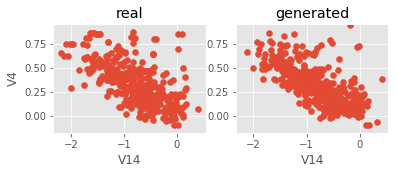

Iter: 20700; D loss: 1.303; G_loss: -0.6201; xgb_loss: 0.7439


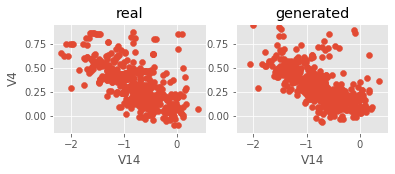

Iter: 20800; D loss: 1.299; G_loss: -0.6515; xgb_loss: 0.7337


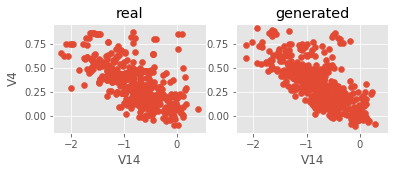

Iter: 20900; D loss: 1.3; G_loss: -0.6239; xgb_loss: 0.7561


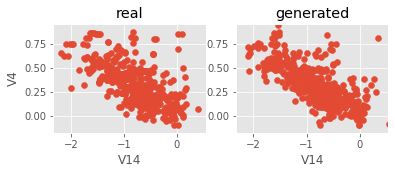

Iter: 21000; D loss: 1.305; G_loss: -0.6326; xgb_loss: 0.7093


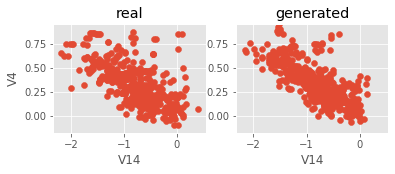

Iter: 21100; D loss: 1.299; G_loss: -0.67; xgb_loss: 0.7337


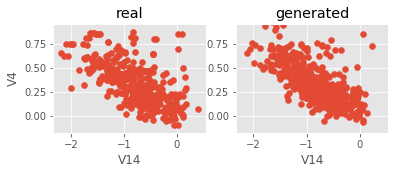

Iter: 21200; D loss: 1.298; G_loss: -0.6401; xgb_loss: 0.685


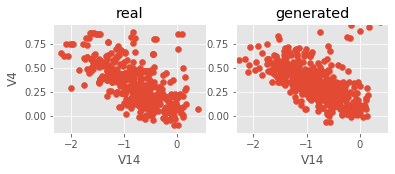

Iter: 21300; D loss: 1.307; G_loss: -0.6584; xgb_loss: 0.7866


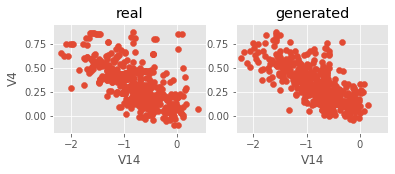

Iter: 21400; D loss: 1.31; G_loss: -0.6582; xgb_loss: 0.6931


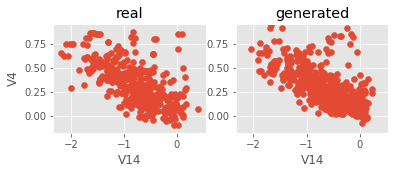

Iter: 21500; D loss: 1.295; G_loss: -0.6461; xgb_loss: 0.7195


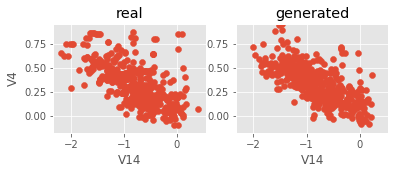

Iter: 21600; D loss: 1.303; G_loss: -0.6143; xgb_loss: 0.7317


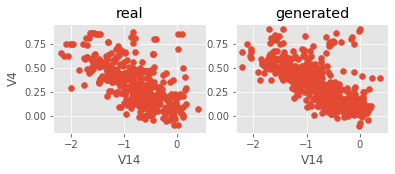

Iter: 21700; D loss: 1.304; G_loss: -0.6489; xgb_loss: 0.7297


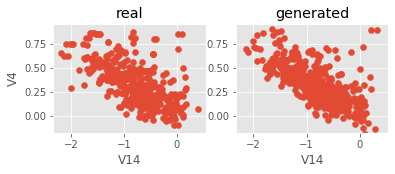

Iter: 21800; D loss: 1.303; G_loss: -0.629; xgb_loss: 0.8008


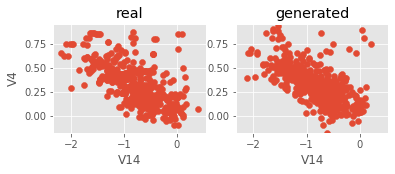

Iter: 21900; D loss: 1.3; G_loss: -0.7086; xgb_loss: 0.7561


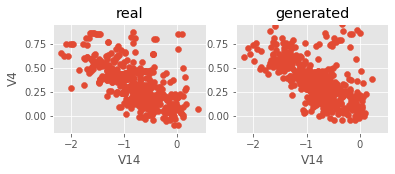

Iter: 22000; D loss: 1.293; G_loss: -0.6593; xgb_loss: 0.7764


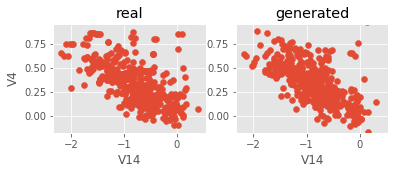

Iter: 22100; D loss: 1.292; G_loss: -0.6432; xgb_loss: 0.7541


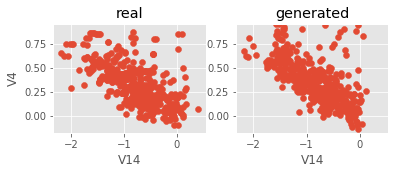

Iter: 22200; D loss: 1.284; G_loss: -0.6618; xgb_loss: 0.7866


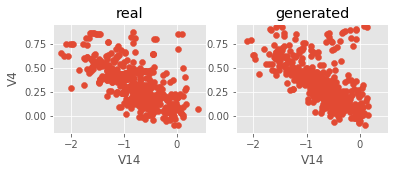

Iter: 22300; D loss: 1.307; G_loss: -0.6812; xgb_loss: 0.7134


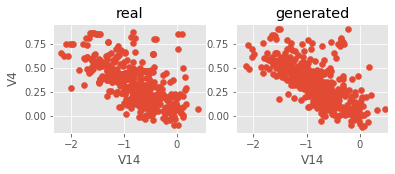

Iter: 22400; D loss: 1.29; G_loss: -0.6465; xgb_loss: 0.7785


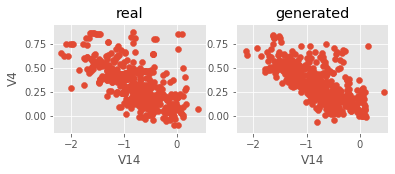

Iter: 22500; D loss: 1.3; G_loss: -0.6473; xgb_loss: 0.6972


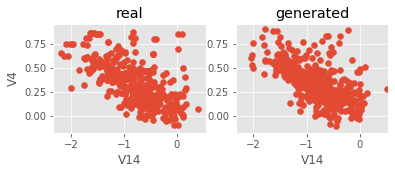

Iter: 22600; D loss: 1.306; G_loss: -0.6593; xgb_loss: 0.7663


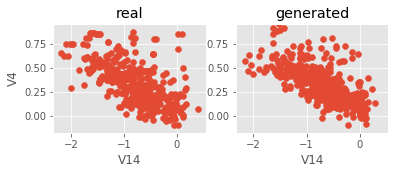

Iter: 22700; D loss: 1.283; G_loss: -0.6294; xgb_loss: 0.7439


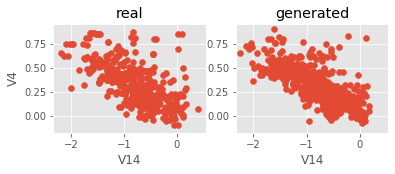

Iter: 22800; D loss: 1.29; G_loss: -0.6848; xgb_loss: 0.7439


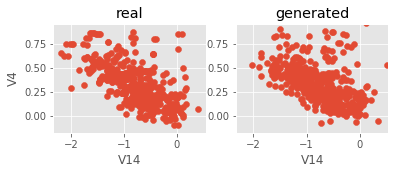

Iter: 22900; D loss: 1.301; G_loss: -0.6699; xgb_loss: 0.7602


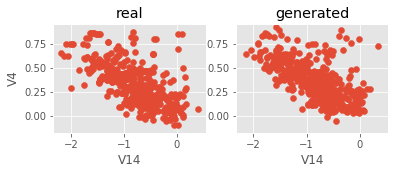

Iter: 23000; D loss: 1.275; G_loss: -0.6662; xgb_loss: 0.7866


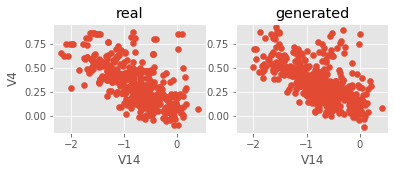

Iter: 23100; D loss: 1.3; G_loss: -0.6624; xgb_loss: 0.7337


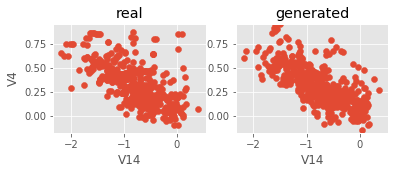

Iter: 23200; D loss: 1.296; G_loss: -0.6517; xgb_loss: 0.7256


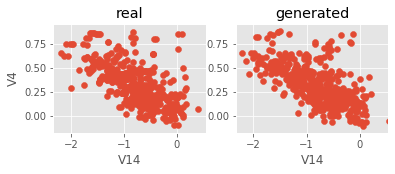

Iter: 23300; D loss: 1.297; G_loss: -0.6576; xgb_loss: 0.752


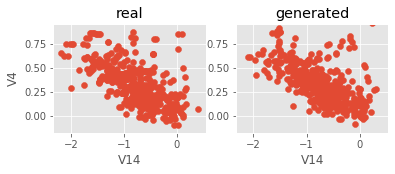

Iter: 23400; D loss: 1.292; G_loss: -0.6938; xgb_loss: 0.6911


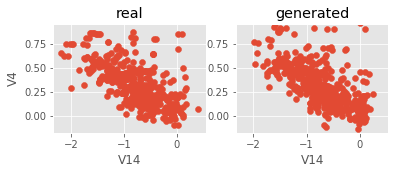

Iter: 23500; D loss: 1.294; G_loss: -0.672; xgb_loss: 0.7581


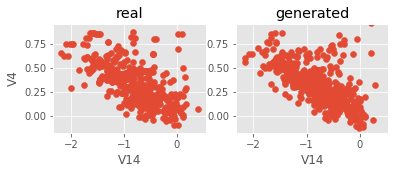

Iter: 23600; D loss: 1.303; G_loss: -0.6513; xgb_loss: 0.7846


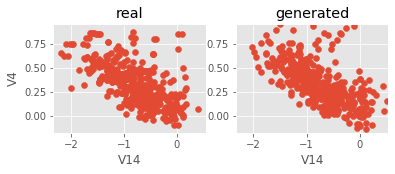

Iter: 23700; D loss: 1.304; G_loss: -0.6619; xgb_loss: 0.7805


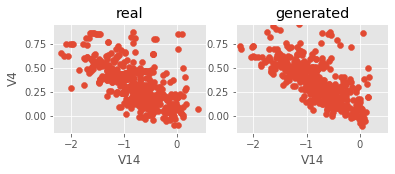

Iter: 23800; D loss: 1.298; G_loss: -0.6791; xgb_loss: 0.7642


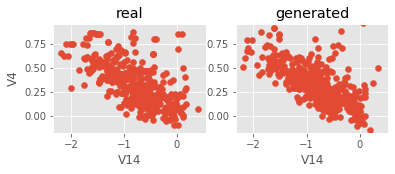

Iter: 23900; D loss: 1.3; G_loss: -0.6844; xgb_loss: 0.7581


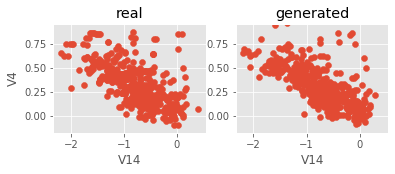

Iter: 24000; D loss: 1.298; G_loss: -0.685; xgb_loss: 0.7805


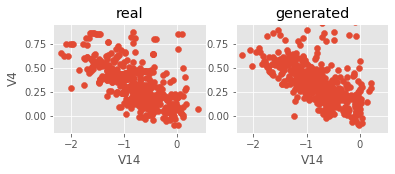

Iter: 24100; D loss: 1.298; G_loss: -0.6713; xgb_loss: 0.7459


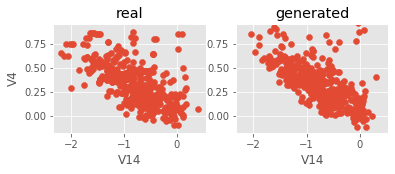

Iter: 24200; D loss: 1.304; G_loss: -0.6678; xgb_loss: 0.7256


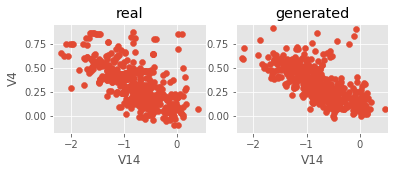

Iter: 24300; D loss: 1.29; G_loss: -0.6499; xgb_loss: 0.7459


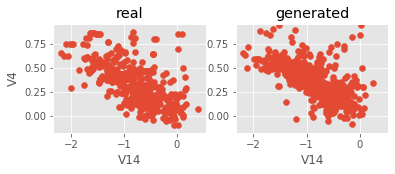

Iter: 24400; D loss: 1.288; G_loss: -0.6486; xgb_loss: 0.7622


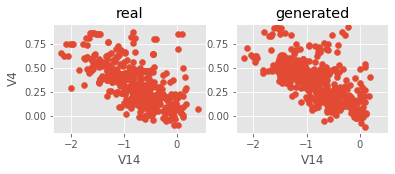

Iter: 24500; D loss: 1.298; G_loss: -0.6604; xgb_loss: 0.7622


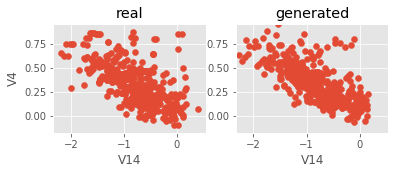

Iter: 24600; D loss: 1.306; G_loss: -0.6191; xgb_loss: 0.687


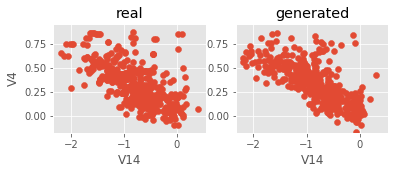

Iter: 24700; D loss: 1.32; G_loss: -0.6456; xgb_loss: 0.7459


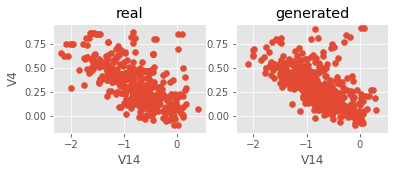

Iter: 24800; D loss: 1.31; G_loss: -0.6573; xgb_loss: 0.7256


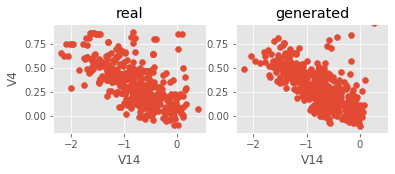

Iter: 24900; D loss: 1.316; G_loss: -0.6469; xgb_loss: 0.7053


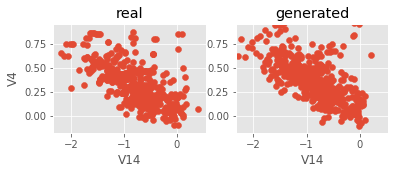

Iter: 25000; D loss: 1.318; G_loss: -0.6527; xgb_loss: 0.7805


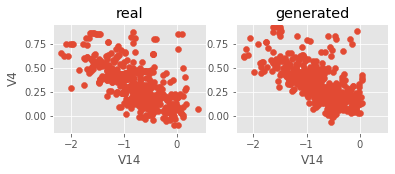

Iter: 25100; D loss: 1.317; G_loss: -0.651; xgb_loss: 0.7358


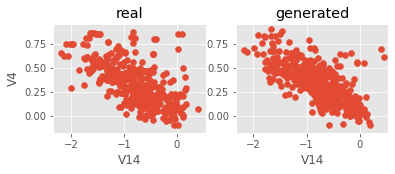

Iter: 25200; D loss: 1.311; G_loss: -0.651; xgb_loss: 0.752


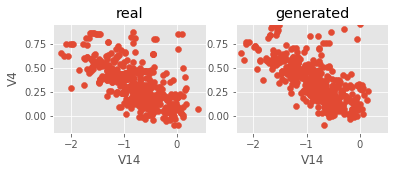

Iter: 25300; D loss: 1.308; G_loss: -0.663; xgb_loss: 0.7541


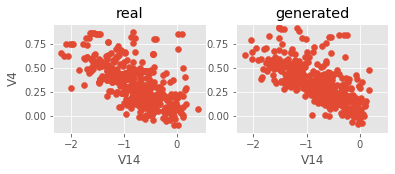

Iter: 25400; D loss: 1.298; G_loss: -0.6402; xgb_loss: 0.7622


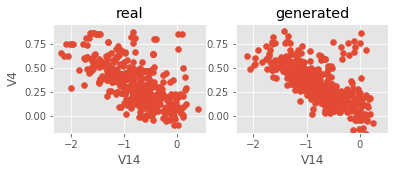

Iter: 25500; D loss: 1.305; G_loss: -0.651; xgb_loss: 0.7215


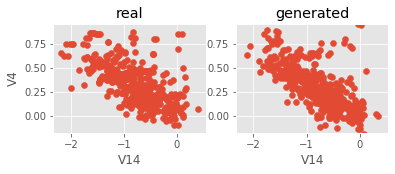

Iter: 25600; D loss: 1.321; G_loss: -0.6558; xgb_loss: 0.75


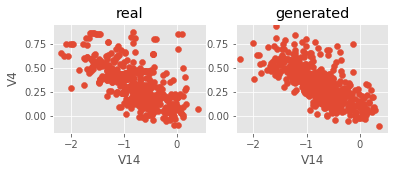

Iter: 25700; D loss: 1.312; G_loss: -0.6486; xgb_loss: 0.7785


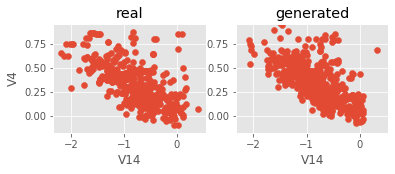

Iter: 25800; D loss: 1.292; G_loss: -0.6883; xgb_loss: 0.7439


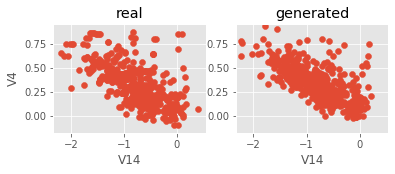

Iter: 25900; D loss: 1.291; G_loss: -0.6597; xgb_loss: 0.7764


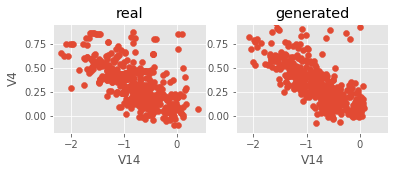

Iter: 26000; D loss: 1.301; G_loss: -0.6611; xgb_loss: 0.6829


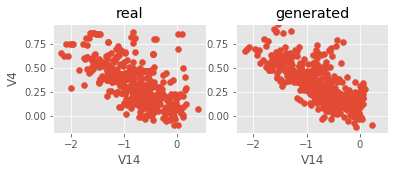

Iter: 26100; D loss: 1.31; G_loss: -0.6449; xgb_loss: 0.7236


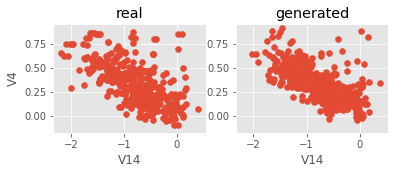

Iter: 26200; D loss: 1.294; G_loss: -0.6792; xgb_loss: 0.7073


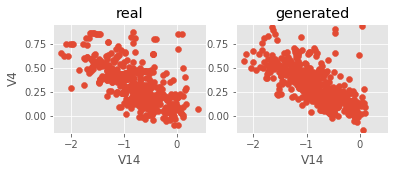

Iter: 26300; D loss: 1.29; G_loss: -0.6396; xgb_loss: 0.7459


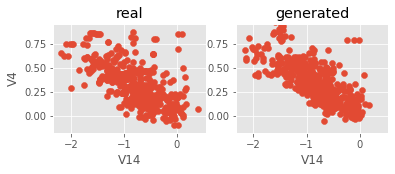

Iter: 26400; D loss: 1.307; G_loss: -0.651; xgb_loss: 0.7439


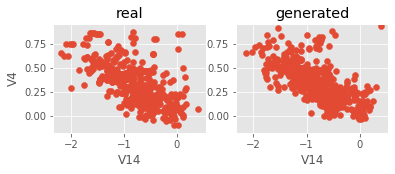

Iter: 26500; D loss: 1.308; G_loss: -0.6702; xgb_loss: 0.8089


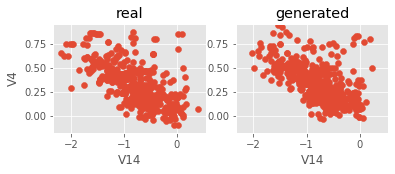

Iter: 26600; D loss: 1.309; G_loss: -0.6535; xgb_loss: 0.7276


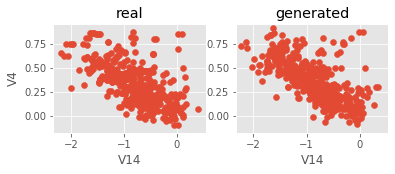

Iter: 26700; D loss: 1.29; G_loss: -0.6544; xgb_loss: 0.7663


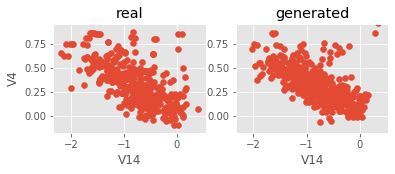

Iter: 26800; D loss: 1.327; G_loss: -0.6767; xgb_loss: 0.7378


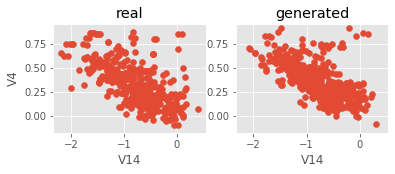

Iter: 26900; D loss: 1.284; G_loss: -0.6709; xgb_loss: 0.748


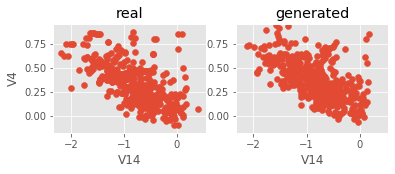

Iter: 27000; D loss: 1.32; G_loss: -0.6437; xgb_loss: 0.7236


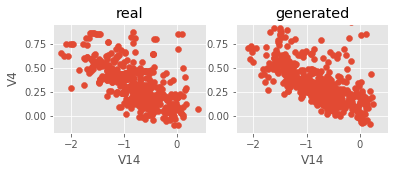

Iter: 27100; D loss: 1.302; G_loss: -0.6694; xgb_loss: 0.7602


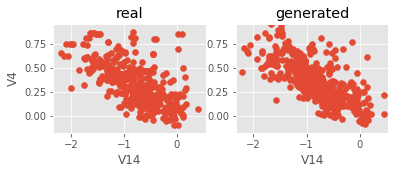

Iter: 27200; D loss: 1.303; G_loss: -0.672; xgb_loss: 0.7622


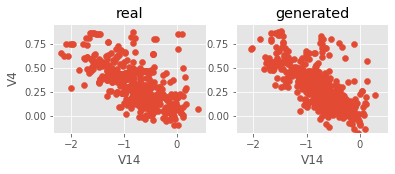

Iter: 27300; D loss: 1.309; G_loss: -0.6192; xgb_loss: 0.7439


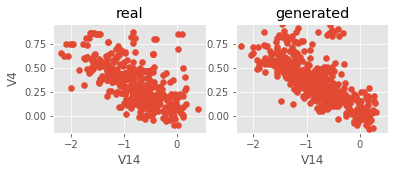

Iter: 27400; D loss: 1.297; G_loss: -0.647; xgb_loss: 0.752


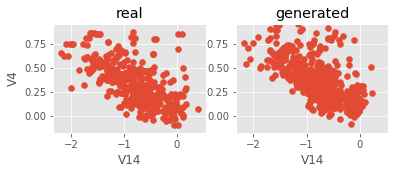

Iter: 27500; D loss: 1.308; G_loss: -0.6615; xgb_loss: 0.7602


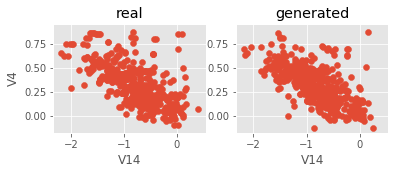

Iter: 27600; D loss: 1.303; G_loss: -0.6399; xgb_loss: 0.7215


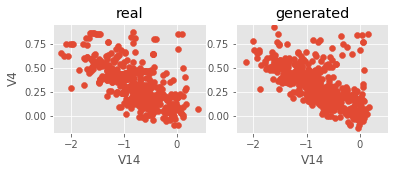

Iter: 27700; D loss: 1.312; G_loss: -0.6598; xgb_loss: 0.7602


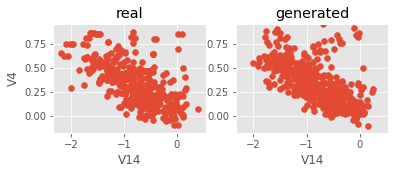

Iter: 27800; D loss: 1.276; G_loss: -0.6795; xgb_loss: 0.7561


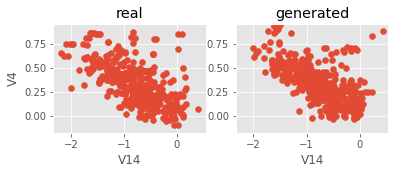

Iter: 27900; D loss: 1.301; G_loss: -0.6618; xgb_loss: 0.7317


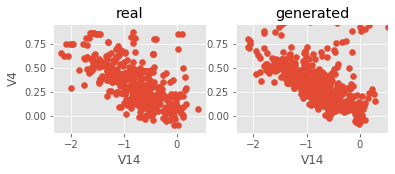

Iter: 28000; D loss: 1.308; G_loss: -0.6537; xgb_loss: 0.6951


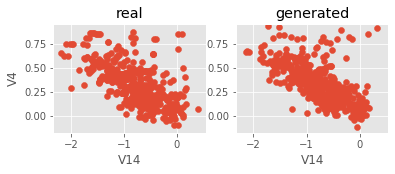

Iter: 28100; D loss: 1.305; G_loss: -0.675; xgb_loss: 0.7215


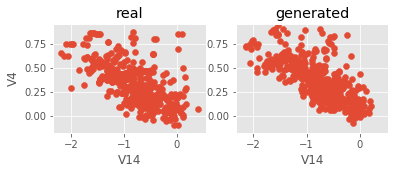

Iter: 28200; D loss: 1.312; G_loss: -0.6441; xgb_loss: 0.7541


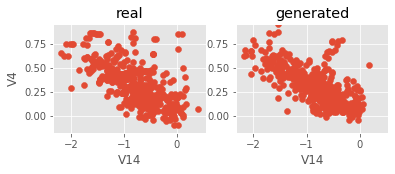

Iter: 28300; D loss: 1.296; G_loss: -0.6493; xgb_loss: 0.7134


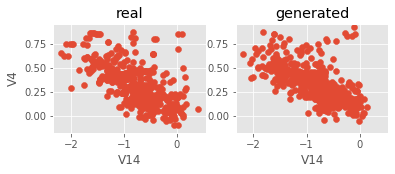

Iter: 28400; D loss: 1.301; G_loss: -0.668; xgb_loss: 0.7683


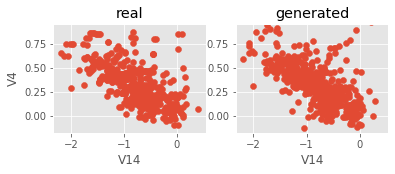

Iter: 28500; D loss: 1.302; G_loss: -0.6775; xgb_loss: 0.7256


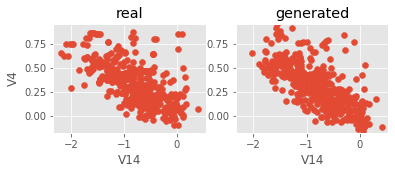

Iter: 28600; D loss: 1.3; G_loss: -0.6606; xgb_loss: 0.7541


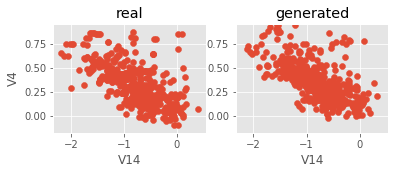

Iter: 28700; D loss: 1.31; G_loss: -0.6676; xgb_loss: 0.7236


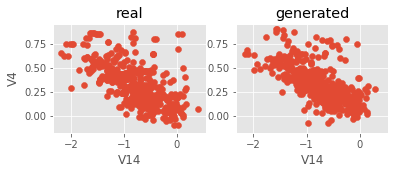

Iter: 28800; D loss: 1.29; G_loss: -0.6553; xgb_loss: 0.7276


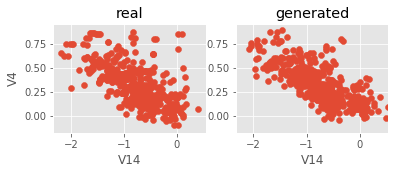

Iter: 28900; D loss: 1.306; G_loss: -0.6575; xgb_loss: 0.7175


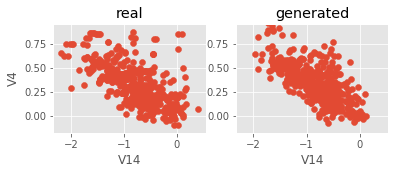

Iter: 29000; D loss: 1.309; G_loss: -0.6484; xgb_loss: 0.7358


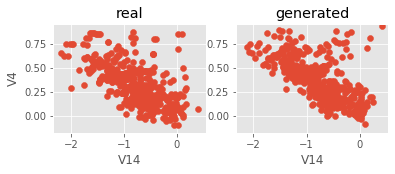

Iter: 29100; D loss: 1.286; G_loss: -0.6597; xgb_loss: 0.7398


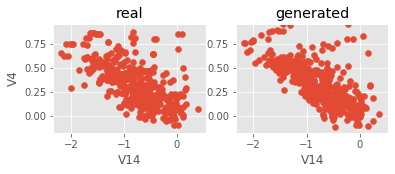

Iter: 29200; D loss: 1.292; G_loss: -0.6563; xgb_loss: 0.7398


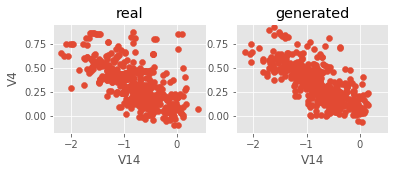

Iter: 29300; D loss: 1.286; G_loss: -0.6553; xgb_loss: 0.7724


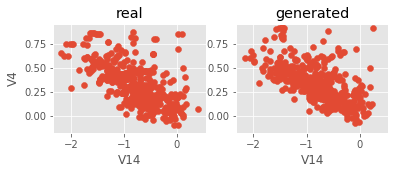

Iter: 29400; D loss: 1.292; G_loss: -0.6702; xgb_loss: 0.6972


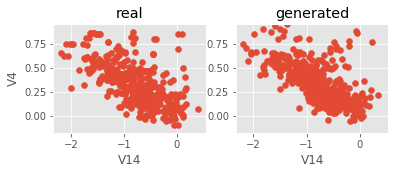

Iter: 29500; D loss: 1.265; G_loss: -0.6657; xgb_loss: 0.748


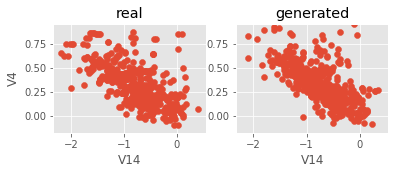

Iter: 29600; D loss: 1.3; G_loss: -0.6584; xgb_loss: 0.7276


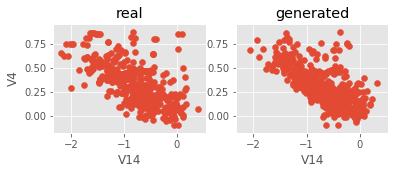

Iter: 29700; D loss: 1.298; G_loss: -0.6731; xgb_loss: 0.7724


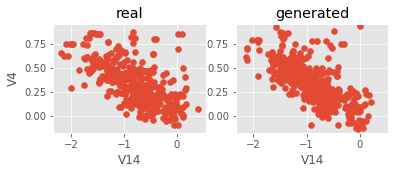

Iter: 29800; D loss: 1.297; G_loss: -0.6559; xgb_loss: 0.752


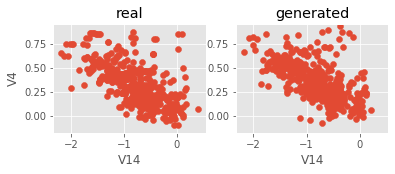

Iter: 29900; D loss: 1.307; G_loss: -0.6782; xgb_loss: 0.7541


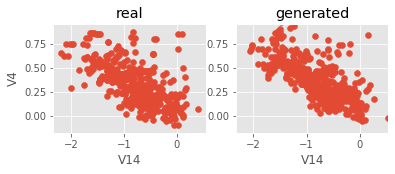

Iter: 30000; D loss: 1.305; G_loss: -0.6838; xgb_loss: 0.7236


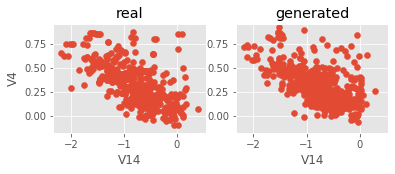

Iter: 30100; D loss: 1.306; G_loss: -0.6642; xgb_loss: 0.7805


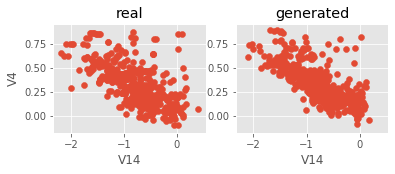

Iter: 30200; D loss: 1.297; G_loss: -0.6735; xgb_loss: 0.6911


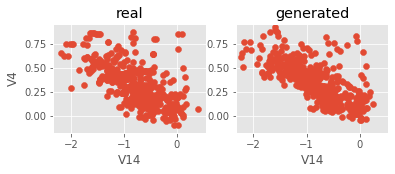

Iter: 30300; D loss: 1.297; G_loss: -0.6776; xgb_loss: 0.7398


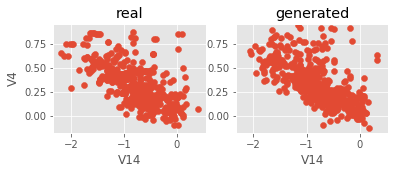

Iter: 30400; D loss: 1.286; G_loss: -0.6738; xgb_loss: 0.7154


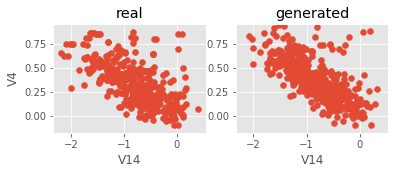

Iter: 30500; D loss: 1.305; G_loss: -0.6649; xgb_loss: 0.7195


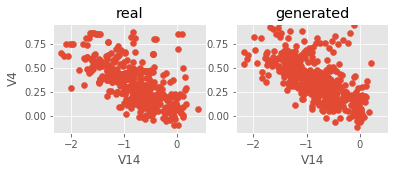

Iter: 30600; D loss: 1.295; G_loss: -0.6914; xgb_loss: 0.752


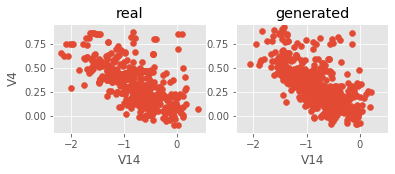

Iter: 30700; D loss: 1.292; G_loss: -0.6865; xgb_loss: 0.7459


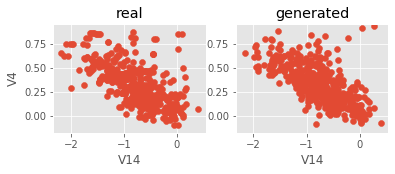

Iter: 30800; D loss: 1.294; G_loss: -0.6358; xgb_loss: 0.748


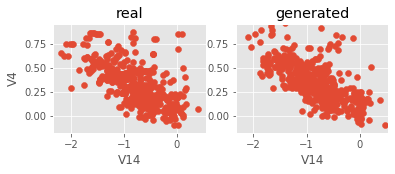

Iter: 30900; D loss: 1.299; G_loss: -0.6424; xgb_loss: 0.7276


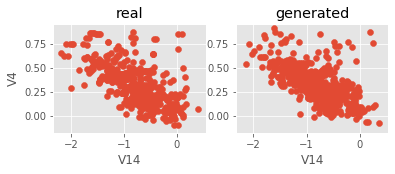

Iter: 31000; D loss: 1.309; G_loss: -0.6491; xgb_loss: 0.7785


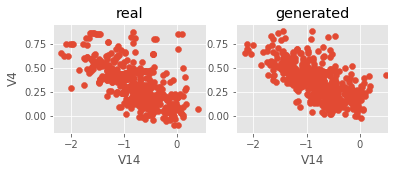

Iter: 31100; D loss: 1.308; G_loss: -0.6513; xgb_loss: 0.6911


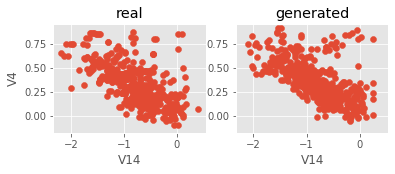

Iter: 31200; D loss: 1.317; G_loss: -0.6471; xgb_loss: 0.7093


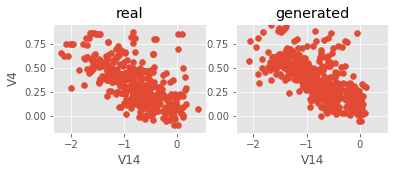

Iter: 31300; D loss: 1.314; G_loss: -0.6682; xgb_loss: 0.6951


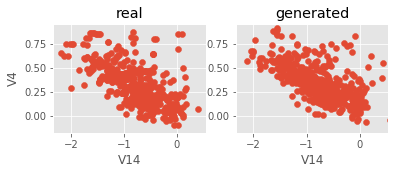

Iter: 31400; D loss: 1.308; G_loss: -0.6455; xgb_loss: 0.7541


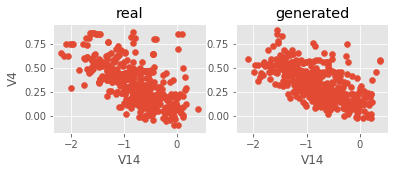

Iter: 31500; D loss: 1.317; G_loss: -0.6343; xgb_loss: 0.7317


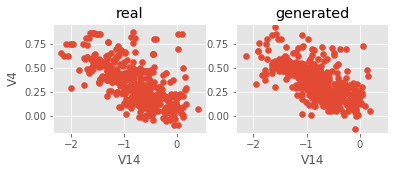

Iter: 31600; D loss: 1.31; G_loss: -0.6666; xgb_loss: 0.7358


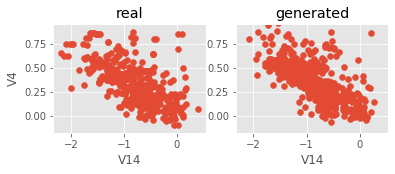

Iter: 31700; D loss: 1.289; G_loss: -0.6564; xgb_loss: 0.6931


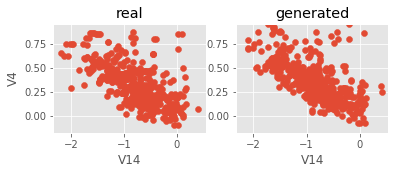

Iter: 31800; D loss: 1.329; G_loss: -0.6674; xgb_loss: 0.7256


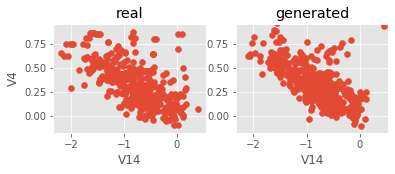

Iter: 31900; D loss: 1.304; G_loss: -0.6341; xgb_loss: 0.748


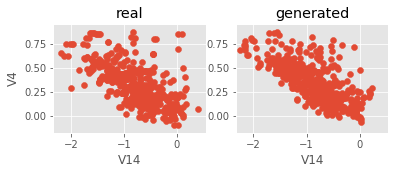

Iter: 32000; D loss: 1.296; G_loss: -0.6325; xgb_loss: 0.7378


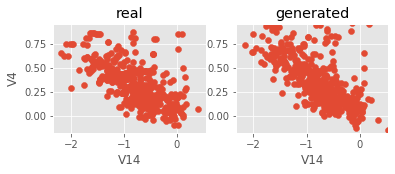

Iter: 32100; D loss: 1.306; G_loss: -0.6413; xgb_loss: 0.7459


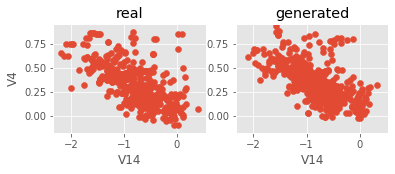

Iter: 32200; D loss: 1.303; G_loss: -0.6553; xgb_loss: 0.7256


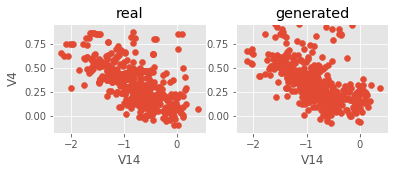

Iter: 32300; D loss: 1.314; G_loss: -0.63; xgb_loss: 0.7093


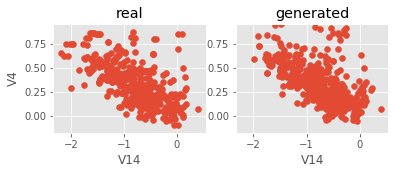

Iter: 32400; D loss: 1.299; G_loss: -0.6521; xgb_loss: 0.687


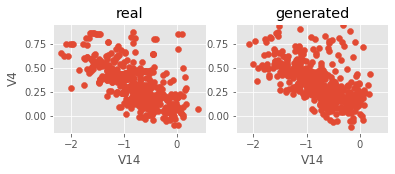

Iter: 32500; D loss: 1.327; G_loss: -0.65; xgb_loss: 0.7317


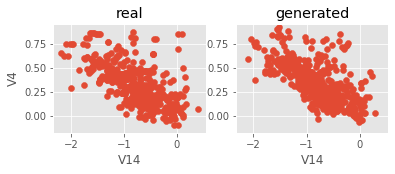

Iter: 32600; D loss: 1.292; G_loss: -0.6524; xgb_loss: 0.7297


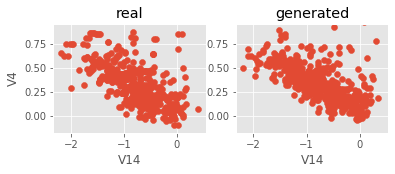

Iter: 32700; D loss: 1.322; G_loss: -0.6573; xgb_loss: 0.7866


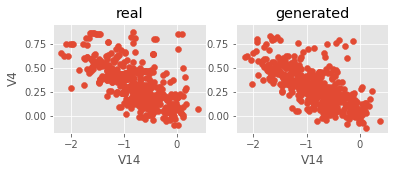

Iter: 32800; D loss: 1.3; G_loss: -0.6697; xgb_loss: 0.7805


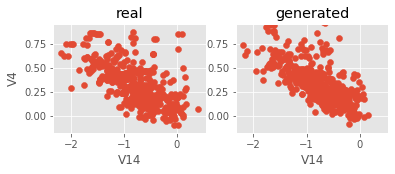

Iter: 32900; D loss: 1.309; G_loss: -0.6981; xgb_loss: 0.687


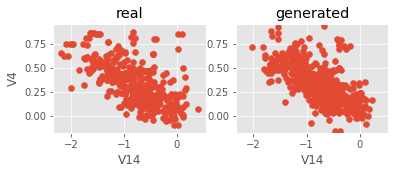

Iter: 33000; D loss: 1.299; G_loss: -0.6569; xgb_loss: 0.7033


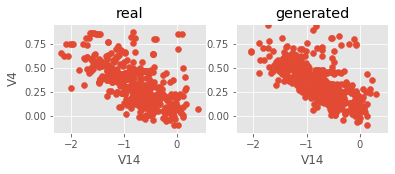

Iter: 33100; D loss: 1.304; G_loss: -0.672; xgb_loss: 0.7114


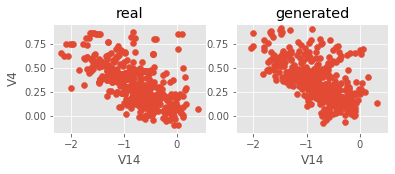

Iter: 33200; D loss: 1.308; G_loss: -0.6757; xgb_loss: 0.7459


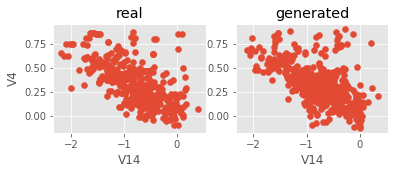

Iter: 33300; D loss: 1.295; G_loss: -0.6671; xgb_loss: 0.7073


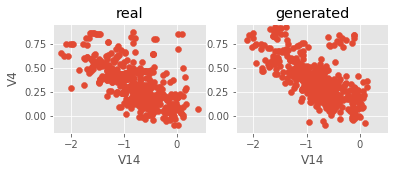

Iter: 33400; D loss: 1.308; G_loss: -0.6625; xgb_loss: 0.7439


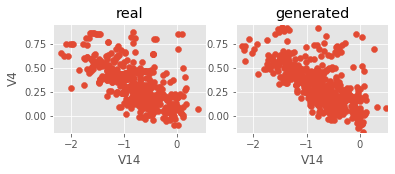

Iter: 33500; D loss: 1.302; G_loss: -0.6351; xgb_loss: 0.7215


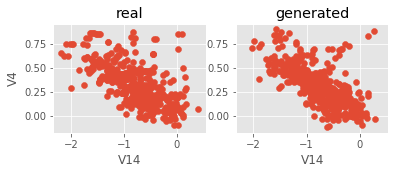

Iter: 33600; D loss: 1.288; G_loss: -0.6641; xgb_loss: 0.7276


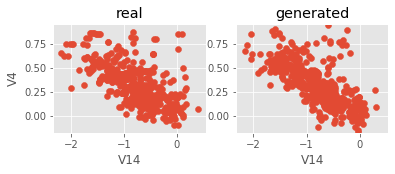

Iter: 33700; D loss: 1.314; G_loss: -0.613; xgb_loss: 0.7419


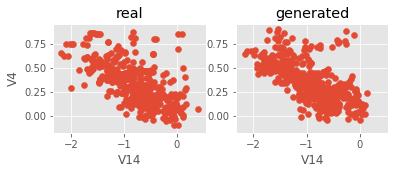

Iter: 33800; D loss: 1.31; G_loss: -0.6475; xgb_loss: 0.6992


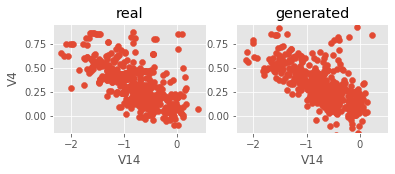

Iter: 33900; D loss: 1.313; G_loss: -0.6227; xgb_loss: 0.7317


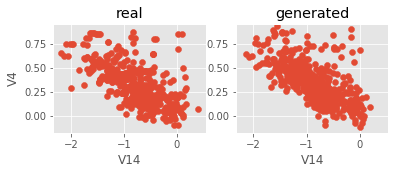

Iter: 34000; D loss: 1.298; G_loss: -0.6672; xgb_loss: 0.6992


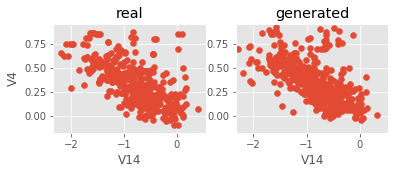

Iter: 34100; D loss: 1.274; G_loss: -0.654; xgb_loss: 0.752


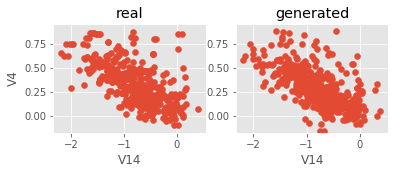

Iter: 34200; D loss: 1.295; G_loss: -0.6818; xgb_loss: 0.7175


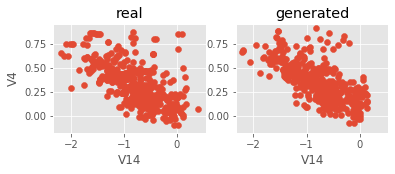

Iter: 34300; D loss: 1.308; G_loss: -0.6704; xgb_loss: 0.7134


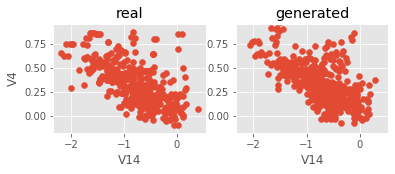

Iter: 34400; D loss: 1.303; G_loss: -0.6422; xgb_loss: 0.687


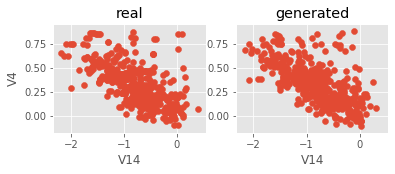

Iter: 34500; D loss: 1.302; G_loss: -0.6599; xgb_loss: 0.7419


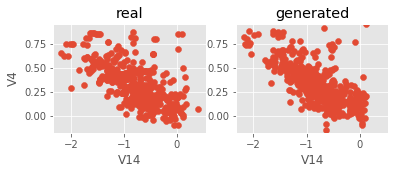

Iter: 34600; D loss: 1.303; G_loss: -0.6723; xgb_loss: 0.7764


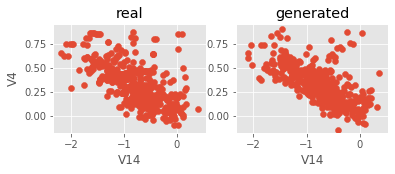

Iter: 34700; D loss: 1.289; G_loss: -0.645; xgb_loss: 0.7439


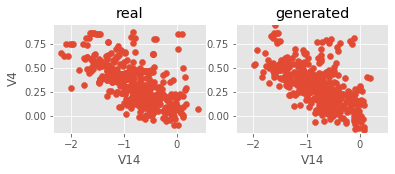

Iter: 34800; D loss: 1.29; G_loss: -0.6572; xgb_loss: 0.7297


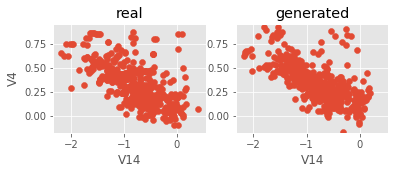

Iter: 34900; D loss: 1.288; G_loss: -0.6583; xgb_loss: 0.7439


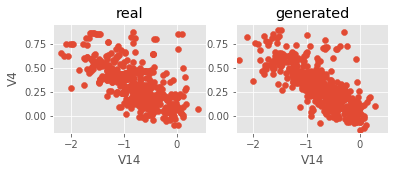

Iter: 35000; D loss: 1.301; G_loss: -0.6466; xgb_loss: 0.7175


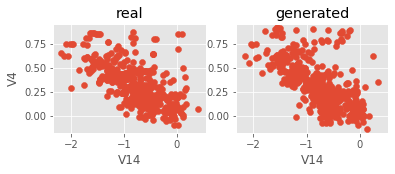

Iter: 35100; D loss: 1.292; G_loss: -0.6734; xgb_loss: 0.7459


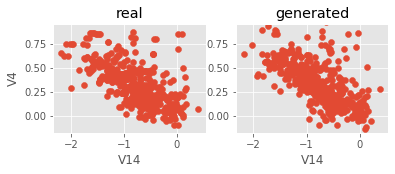

Iter: 35200; D loss: 1.3; G_loss: -0.6385; xgb_loss: 0.8008


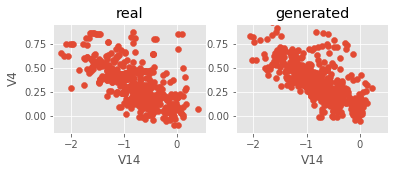

Iter: 35300; D loss: 1.304; G_loss: -0.6409; xgb_loss: 0.7419


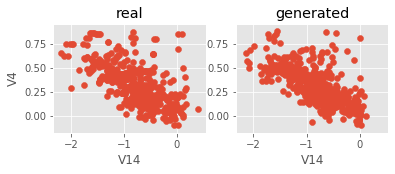

Iter: 35400; D loss: 1.325; G_loss: -0.6944; xgb_loss: 0.7317


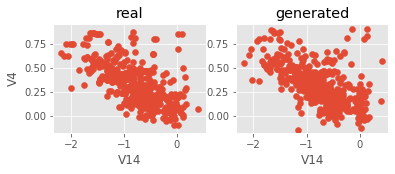

Iter: 35500; D loss: 1.295; G_loss: -0.6785; xgb_loss: 0.7256


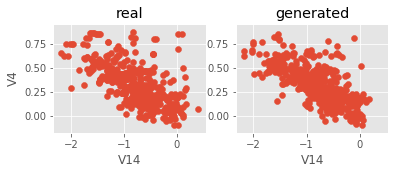

Iter: 35600; D loss: 1.293; G_loss: -0.6693; xgb_loss: 0.7683


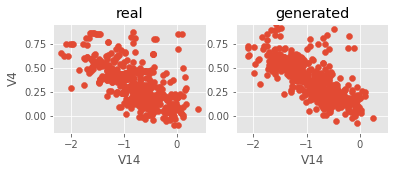

Iter: 35700; D loss: 1.292; G_loss: -0.6858; xgb_loss: 0.7398


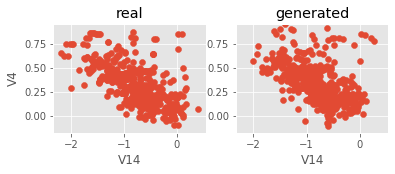

Iter: 35800; D loss: 1.295; G_loss: -0.6666; xgb_loss: 0.6992


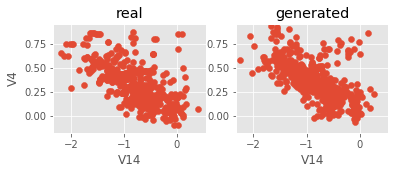

Iter: 35900; D loss: 1.302; G_loss: -0.6534; xgb_loss: 0.7256


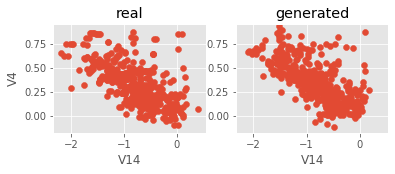

Iter: 36000; D loss: 1.31; G_loss: -0.6722; xgb_loss: 0.7033


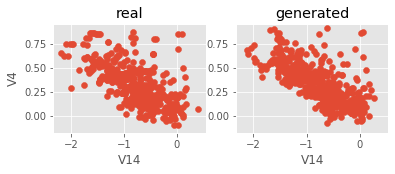

Iter: 36100; D loss: 1.289; G_loss: -0.6744; xgb_loss: 0.687


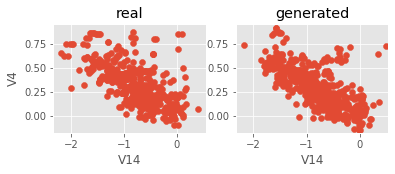

Iter: 36200; D loss: 1.301; G_loss: -0.6526; xgb_loss: 0.7622


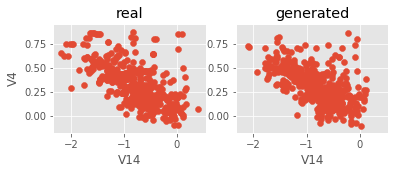

Iter: 36300; D loss: 1.304; G_loss: -0.6797; xgb_loss: 0.7439


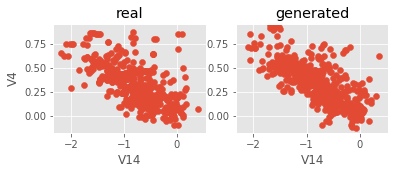

Iter: 36400; D loss: 1.279; G_loss: -0.6746; xgb_loss: 0.6911


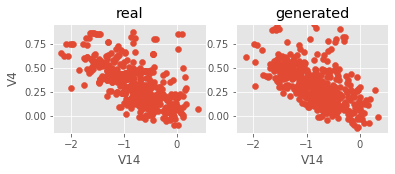

Iter: 36500; D loss: 1.298; G_loss: -0.6624; xgb_loss: 0.7276


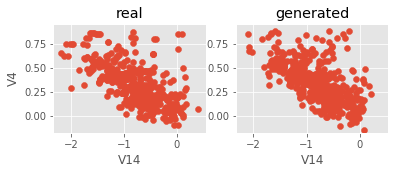

Iter: 36600; D loss: 1.295; G_loss: -0.6805; xgb_loss: 0.7459


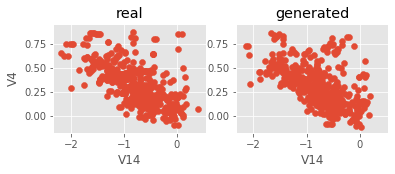

Iter: 36700; D loss: 1.293; G_loss: -0.6601; xgb_loss: 0.7073


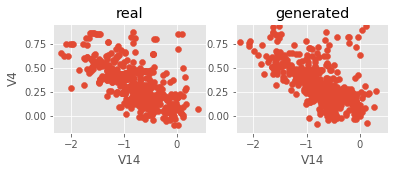

Iter: 36800; D loss: 1.303; G_loss: -0.6708; xgb_loss: 0.7297


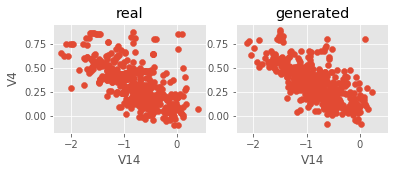

Iter: 36900; D loss: 1.307; G_loss: -0.6494; xgb_loss: 0.7378


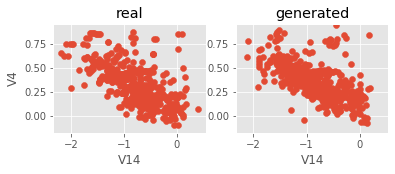

Iter: 37000; D loss: 1.301; G_loss: -0.6514; xgb_loss: 0.7195


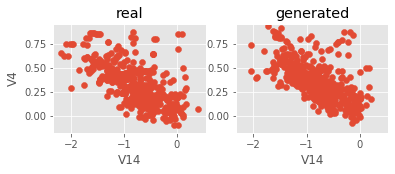

Iter: 37100; D loss: 1.311; G_loss: -0.6788; xgb_loss: 0.7154


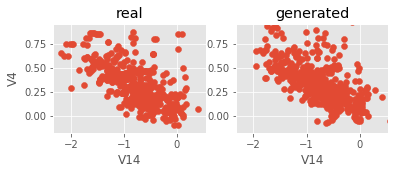

Iter: 37200; D loss: 1.304; G_loss: -0.662; xgb_loss: 0.7297


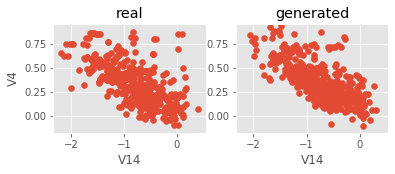

Iter: 37300; D loss: 1.322; G_loss: -0.6504; xgb_loss: 0.7215


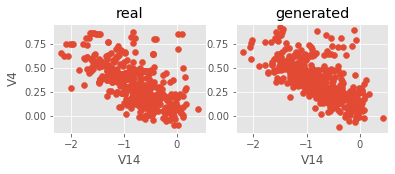

Iter: 37400; D loss: 1.314; G_loss: -0.6622; xgb_loss: 0.7073


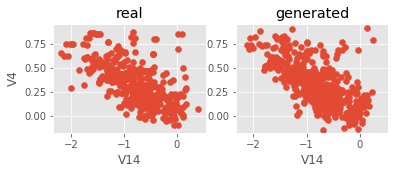

Iter: 37500; D loss: 1.322; G_loss: -0.6347; xgb_loss: 0.7541


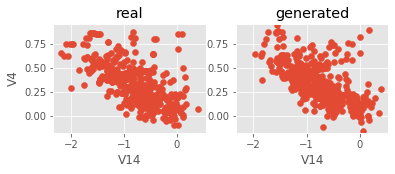

Iter: 37600; D loss: 1.305; G_loss: -0.6545; xgb_loss: 0.7764


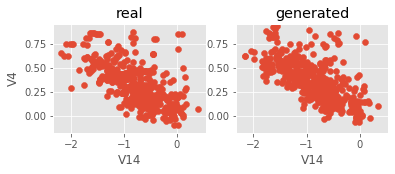

Iter: 37700; D loss: 1.314; G_loss: -0.6658; xgb_loss: 0.7541


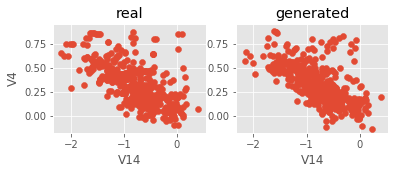

Iter: 37800; D loss: 1.317; G_loss: -0.6566; xgb_loss: 0.7215


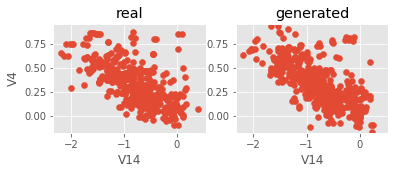

Iter: 37900; D loss: 1.311; G_loss: -0.6496; xgb_loss: 0.7622


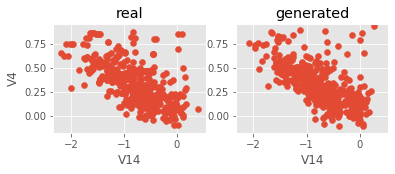

Iter: 38000; D loss: 1.332; G_loss: -0.6637; xgb_loss: 0.6606


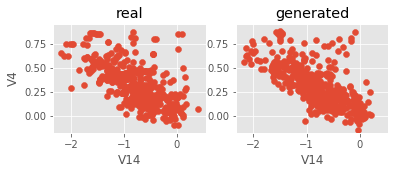

Iter: 38100; D loss: 1.307; G_loss: -0.6552; xgb_loss: 0.6321


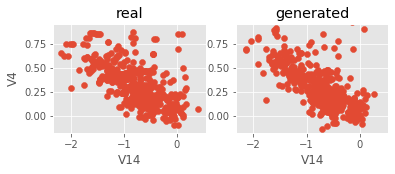

Iter: 38200; D loss: 1.312; G_loss: -0.659; xgb_loss: 0.7622


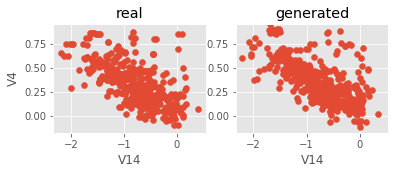

Iter: 38300; D loss: 1.307; G_loss: -0.6806; xgb_loss: 0.7602


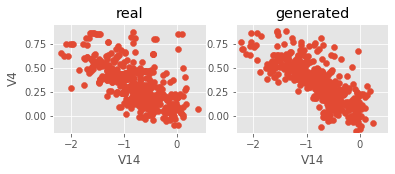

Iter: 38400; D loss: 1.343; G_loss: -0.6608; xgb_loss: 0.6829


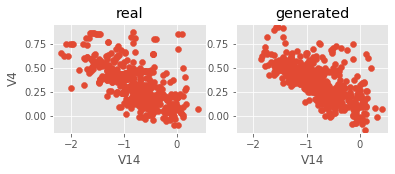

Iter: 38500; D loss: 1.293; G_loss: -0.6614; xgb_loss: 0.7561


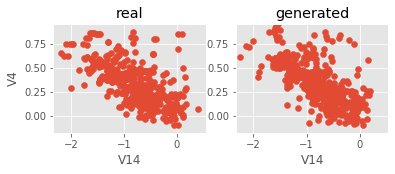

Iter: 38600; D loss: 1.306; G_loss: -0.6698; xgb_loss: 0.7175


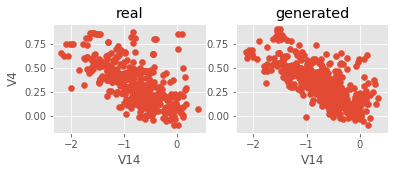

Iter: 38700; D loss: 1.301; G_loss: -0.6803; xgb_loss: 0.7602


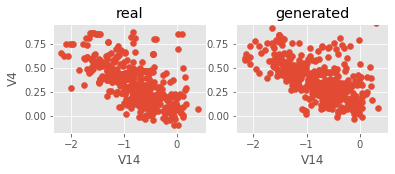

Iter: 38800; D loss: 1.291; G_loss: -0.6963; xgb_loss: 0.7439


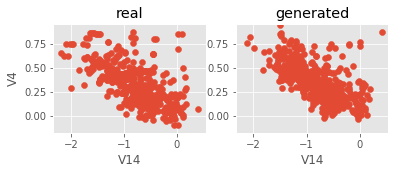

Iter: 38900; D loss: 1.305; G_loss: -0.6694; xgb_loss: 0.7581


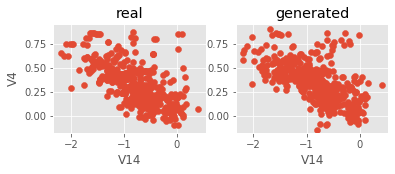

Iter: 39000; D loss: 1.297; G_loss: -0.6355; xgb_loss: 0.7439


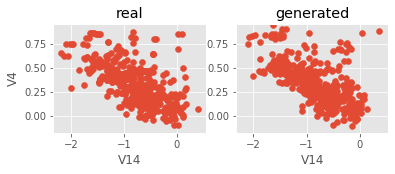

Iter: 39100; D loss: 1.284; G_loss: -0.6604; xgb_loss: 0.752


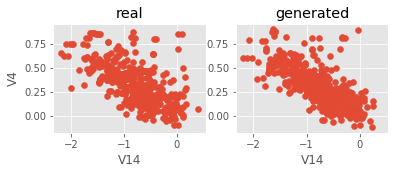

Iter: 39200; D loss: 1.284; G_loss: -0.658; xgb_loss: 0.7195


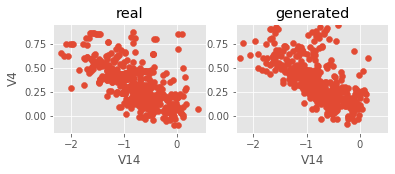

Iter: 39300; D loss: 1.333; G_loss: -0.6916; xgb_loss: 0.7175


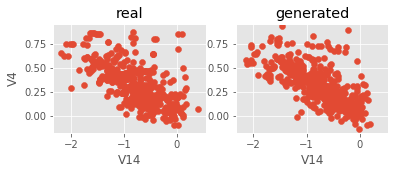

Iter: 39400; D loss: 1.306; G_loss: -0.654; xgb_loss: 0.6606


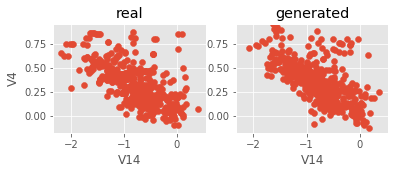

Iter: 39500; D loss: 1.296; G_loss: -0.6636; xgb_loss: 0.7337


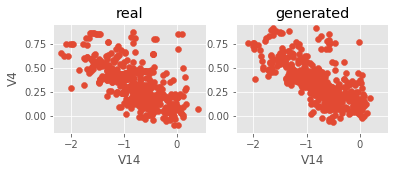

Iter: 39600; D loss: 1.317; G_loss: -0.6818; xgb_loss: 0.7602


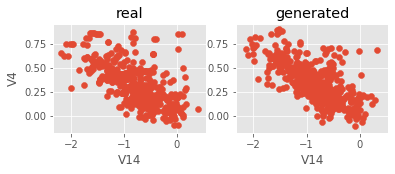

Iter: 39700; D loss: 1.297; G_loss: -0.6588; xgb_loss: 0.685


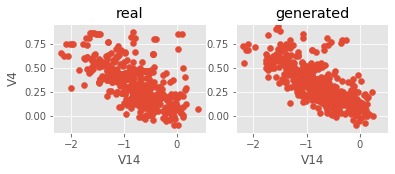

Iter: 39800; D loss: 1.307; G_loss: -0.6416; xgb_loss: 0.7134


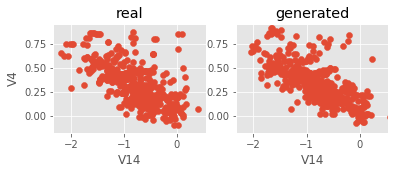

Iter: 39900; D loss: 1.304; G_loss: -0.6694; xgb_loss: 0.7317


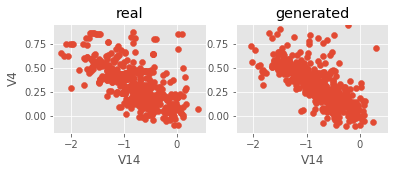

Iter: 40000; D loss: 1.32; G_loss: -0.6737; xgb_loss: 0.7439


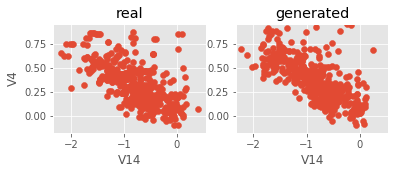

Iter: 40100; D loss: 1.293; G_loss: -0.6699; xgb_loss: 0.7358


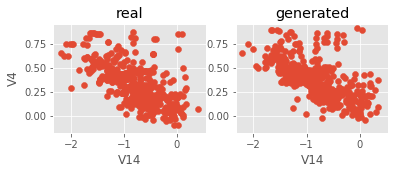

Iter: 40200; D loss: 1.303; G_loss: -0.6672; xgb_loss: 0.7012


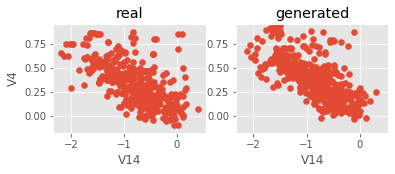

Iter: 40300; D loss: 1.303; G_loss: -0.6522; xgb_loss: 0.7398


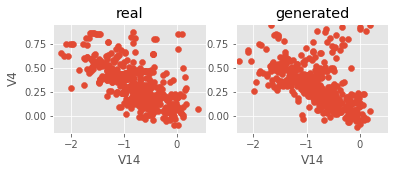

Iter: 40400; D loss: 1.305; G_loss: -0.6761; xgb_loss: 0.6829


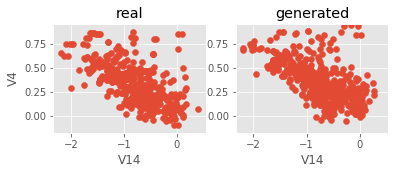

Iter: 40500; D loss: 1.299; G_loss: -0.6693; xgb_loss: 0.7337


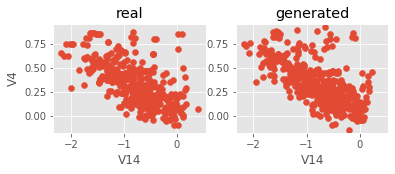

Iter: 40600; D loss: 1.304; G_loss: -0.6493; xgb_loss: 0.75


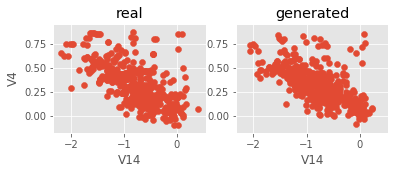

Iter: 40700; D loss: 1.301; G_loss: -0.6648; xgb_loss: 0.7033


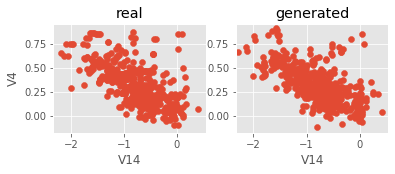

Iter: 40800; D loss: 1.301; G_loss: -0.6631; xgb_loss: 0.7419


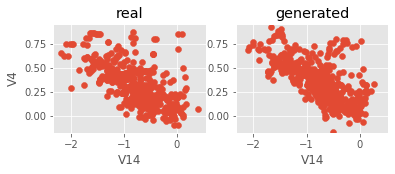

Iter: 40900; D loss: 1.3; G_loss: -0.6452; xgb_loss: 0.7073


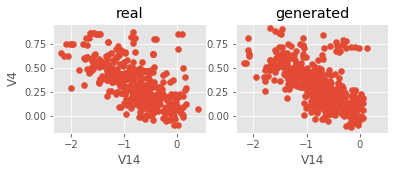

Iter: 41000; D loss: 1.326; G_loss: -0.642; xgb_loss: 0.7114


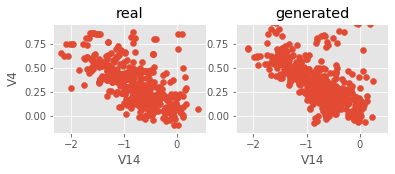

Iter: 41100; D loss: 1.307; G_loss: -0.6617; xgb_loss: 0.7642


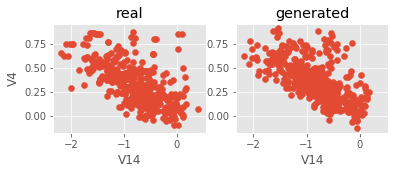

Iter: 41200; D loss: 1.307; G_loss: -0.6586; xgb_loss: 0.7175


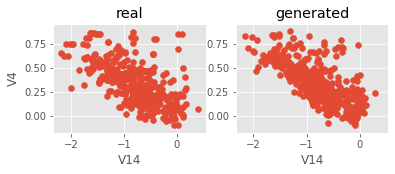

Iter: 41300; D loss: 1.305; G_loss: -0.6873; xgb_loss: 0.752


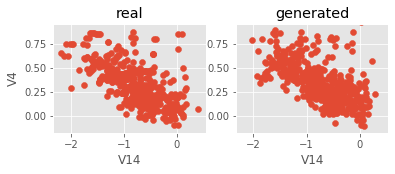

Iter: 41400; D loss: 1.293; G_loss: -0.6686; xgb_loss: 0.7378


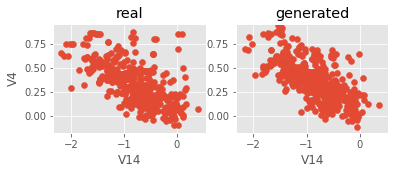

Iter: 41500; D loss: 1.293; G_loss: -0.6571; xgb_loss: 0.7439


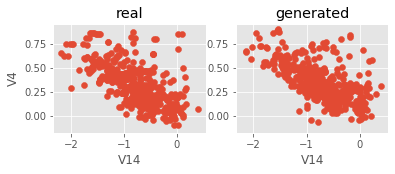

Iter: 41600; D loss: 1.299; G_loss: -0.6589; xgb_loss: 0.7276


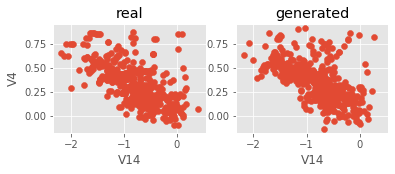

Iter: 41700; D loss: 1.306; G_loss: -0.6858; xgb_loss: 0.7419


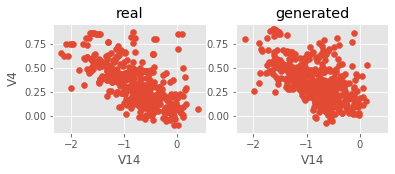

Iter: 41800; D loss: 1.294; G_loss: -0.6694; xgb_loss: 0.7093


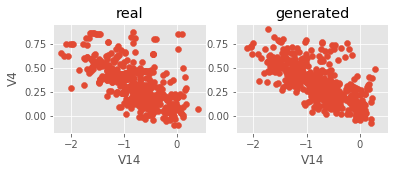

Iter: 41900; D loss: 1.296; G_loss: -0.6715; xgb_loss: 0.7581


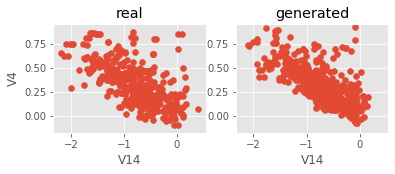

Iter: 42000; D loss: 1.302; G_loss: -0.6572; xgb_loss: 0.7215


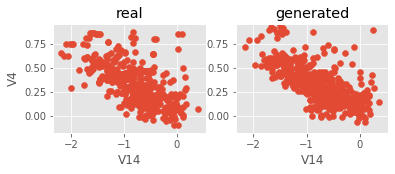

Iter: 42100; D loss: 1.308; G_loss: -0.6845; xgb_loss: 0.7276


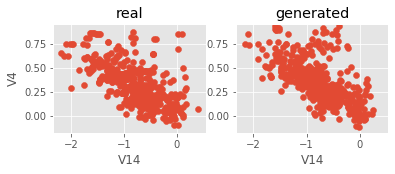

Iter: 42200; D loss: 1.307; G_loss: -0.6563; xgb_loss: 0.7337


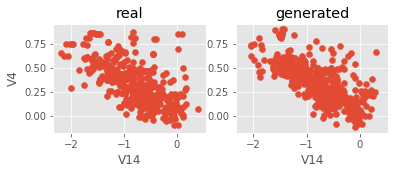

Iter: 42300; D loss: 1.291; G_loss: -0.6523; xgb_loss: 0.752


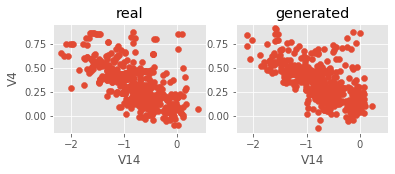

Iter: 42400; D loss: 1.298; G_loss: -0.6679; xgb_loss: 0.7134


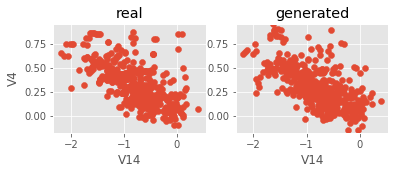

Iter: 42500; D loss: 1.295; G_loss: -0.6611; xgb_loss: 0.7297


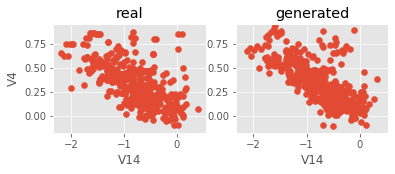

Iter: 42600; D loss: 1.317; G_loss: -0.6526; xgb_loss: 0.748


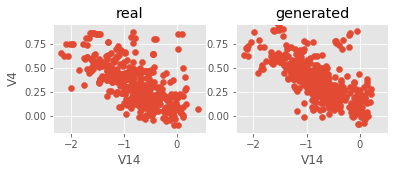

Iter: 42700; D loss: 1.315; G_loss: -0.703; xgb_loss: 0.7398


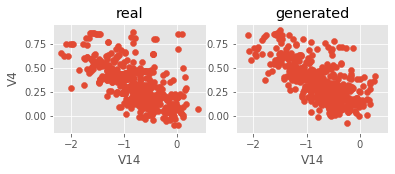

Iter: 42800; D loss: 1.281; G_loss: -0.6707; xgb_loss: 0.7439


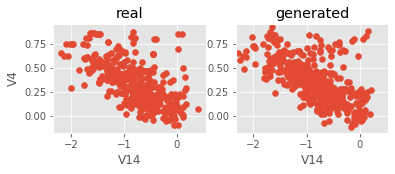

Iter: 42900; D loss: 1.285; G_loss: -0.6991; xgb_loss: 0.7663


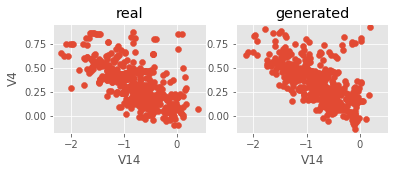

Iter: 43000; D loss: 1.311; G_loss: -0.7023; xgb_loss: 0.6606


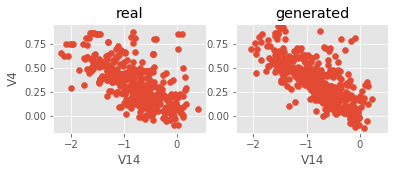

Iter: 43100; D loss: 1.306; G_loss: -0.6398; xgb_loss: 0.6911


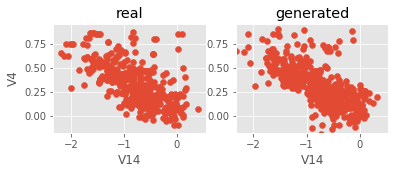

Iter: 43200; D loss: 1.309; G_loss: -0.657; xgb_loss: 0.6992


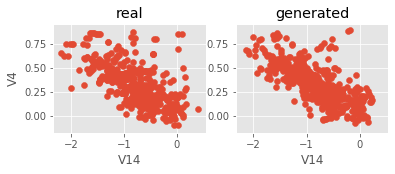

Iter: 43300; D loss: 1.32; G_loss: -0.6786; xgb_loss: 0.7378


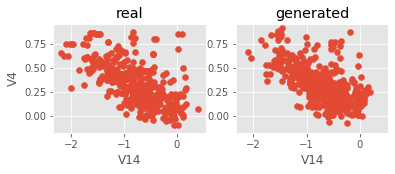

Iter: 43400; D loss: 1.324; G_loss: -0.6496; xgb_loss: 0.7561


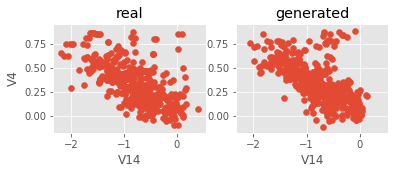

Iter: 43500; D loss: 1.31; G_loss: -0.6441; xgb_loss: 0.7053


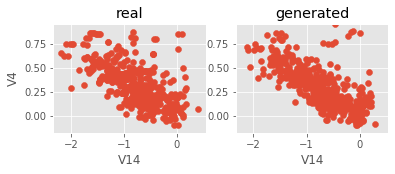

Iter: 43600; D loss: 1.317; G_loss: -0.6497; xgb_loss: 0.7195


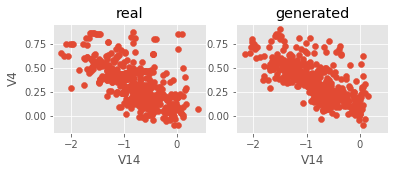

Iter: 43700; D loss: 1.297; G_loss: -0.6416; xgb_loss: 0.7358


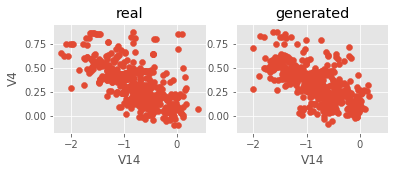

Iter: 43800; D loss: 1.314; G_loss: -0.6488; xgb_loss: 0.7602


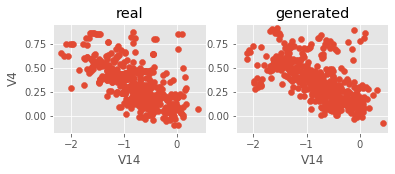

Iter: 43900; D loss: 1.318; G_loss: -0.6507; xgb_loss: 0.7398


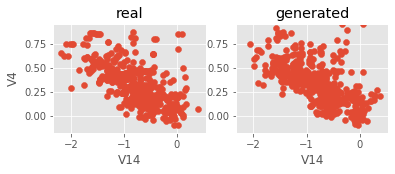

Iter: 44000; D loss: 1.298; G_loss: -0.6359; xgb_loss: 0.7317


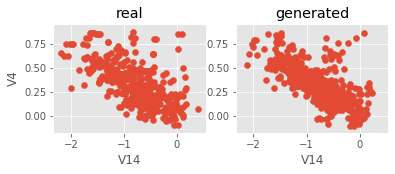

Iter: 44100; D loss: 1.314; G_loss: -0.6803; xgb_loss: 0.7398


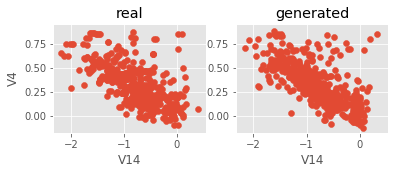

Iter: 44200; D loss: 1.316; G_loss: -0.6573; xgb_loss: 0.7337


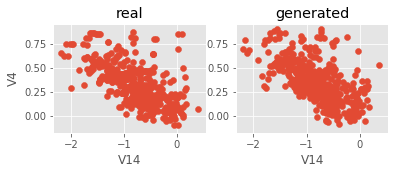

Iter: 44300; D loss: 1.302; G_loss: -0.6421; xgb_loss: 0.7541


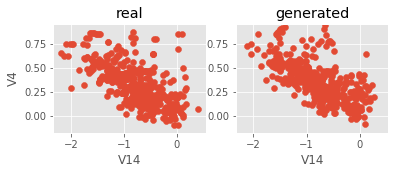

Iter: 44400; D loss: 1.307; G_loss: -0.6614; xgb_loss: 0.7358


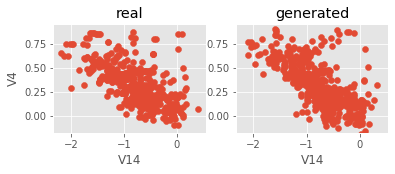

Iter: 44500; D loss: 1.318; G_loss: -0.6272; xgb_loss: 0.748


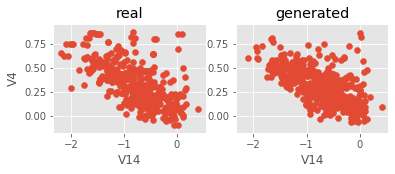

Iter: 44600; D loss: 1.316; G_loss: -0.6595; xgb_loss: 0.7602


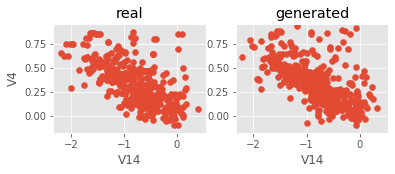

Iter: 44700; D loss: 1.296; G_loss: -0.6418; xgb_loss: 0.7114


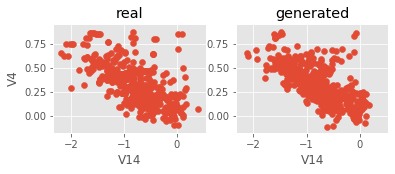

Iter: 44800; D loss: 1.303; G_loss: -0.6546; xgb_loss: 0.7317


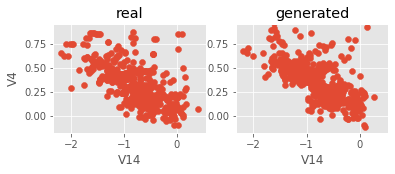

Iter: 44900; D loss: 1.291; G_loss: -0.6664; xgb_loss: 0.7439


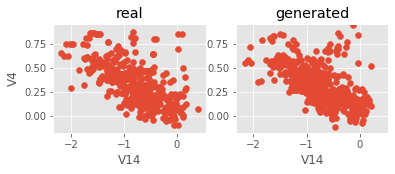

Iter: 45000; D loss: 1.322; G_loss: -0.661; xgb_loss: 0.7459


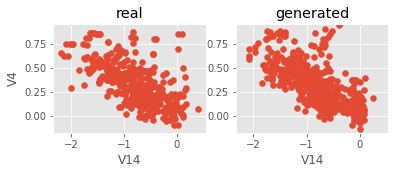

Iter: 45100; D loss: 1.31; G_loss: -0.6642; xgb_loss: 0.6951


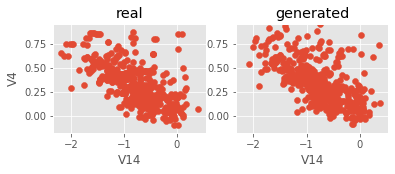

Iter: 45200; D loss: 1.309; G_loss: -0.6692; xgb_loss: 0.6667


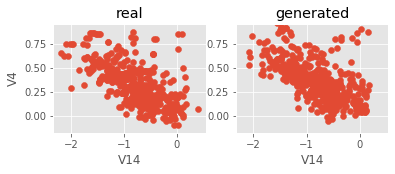

Iter: 45300; D loss: 1.304; G_loss: -0.6637; xgb_loss: 0.7093


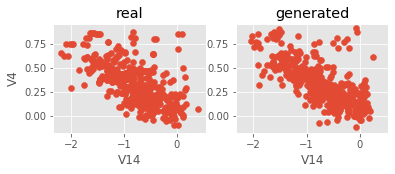

Iter: 45400; D loss: 1.315; G_loss: -0.6734; xgb_loss: 0.7358


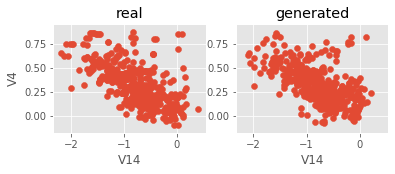

Iter: 45500; D loss: 1.307; G_loss: -0.6573; xgb_loss: 0.748


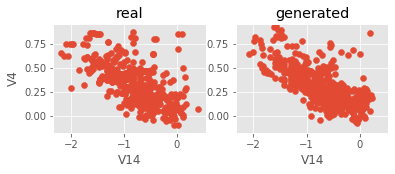

Iter: 45600; D loss: 1.311; G_loss: -0.6438; xgb_loss: 0.7439


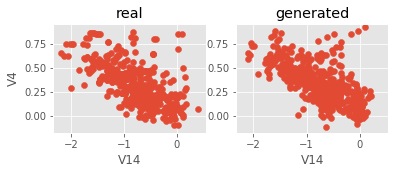

Iter: 45700; D loss: 1.3; G_loss: -0.6545; xgb_loss: 0.7134


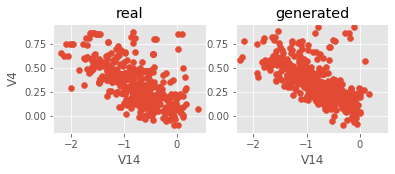

Iter: 45800; D loss: 1.315; G_loss: -0.6753; xgb_loss: 0.7378


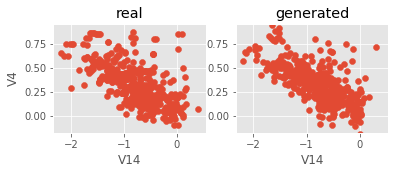

Iter: 45900; D loss: 1.306; G_loss: -0.6678; xgb_loss: 0.7378


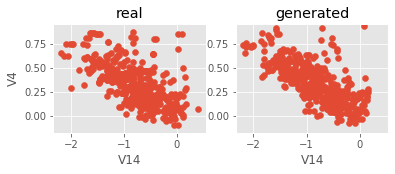

Iter: 46000; D loss: 1.318; G_loss: -0.6253; xgb_loss: 0.7825


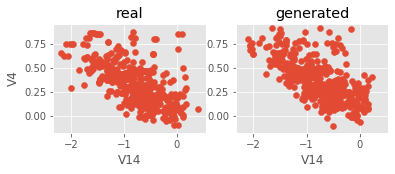

Iter: 46100; D loss: 1.302; G_loss: -0.6518; xgb_loss: 0.7073


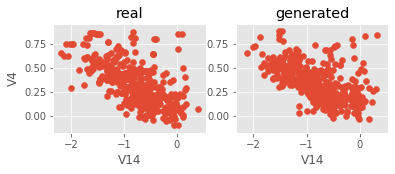

Iter: 46200; D loss: 1.304; G_loss: -0.6675; xgb_loss: 0.75


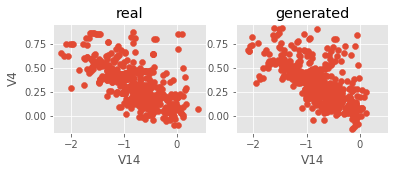

Iter: 46300; D loss: 1.299; G_loss: -0.6749; xgb_loss: 0.7602


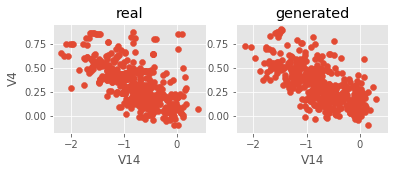

Iter: 46400; D loss: 1.3; G_loss: -0.6367; xgb_loss: 0.7154


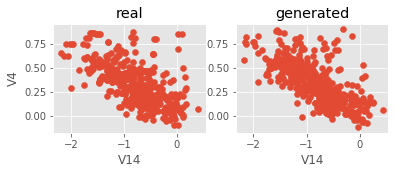

Iter: 46500; D loss: 1.299; G_loss: -0.6586; xgb_loss: 0.7398


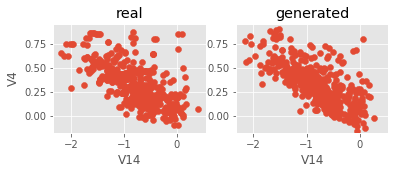

Iter: 46600; D loss: 1.311; G_loss: -0.6543; xgb_loss: 0.7114


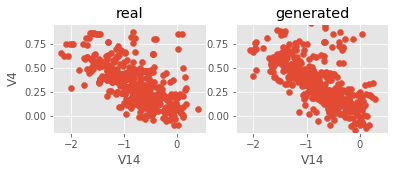

Iter: 46700; D loss: 1.291; G_loss: -0.6781; xgb_loss: 0.7236


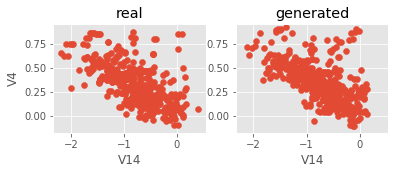

Iter: 46800; D loss: 1.314; G_loss: -0.6671; xgb_loss: 0.7642


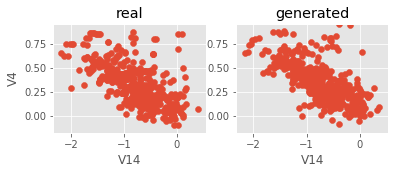

Iter: 46900; D loss: 1.292; G_loss: -0.6574; xgb_loss: 0.7622


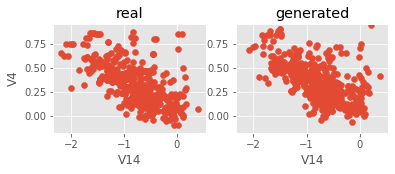

Iter: 47000; D loss: 1.312; G_loss: -0.6551; xgb_loss: 0.7256


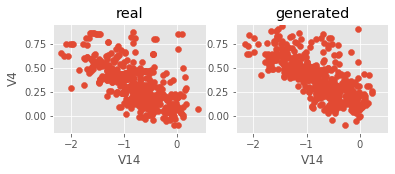

Iter: 47100; D loss: 1.303; G_loss: -0.6595; xgb_loss: 0.7154


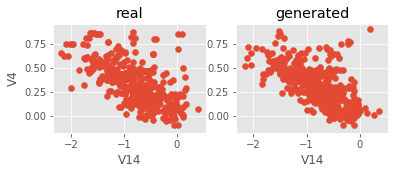

Iter: 47200; D loss: 1.306; G_loss: -0.6972; xgb_loss: 0.7358


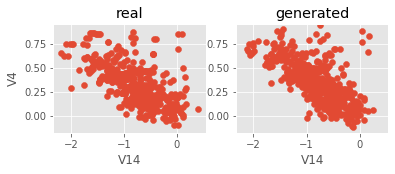

Iter: 47300; D loss: 1.291; G_loss: -0.6641; xgb_loss: 0.7337


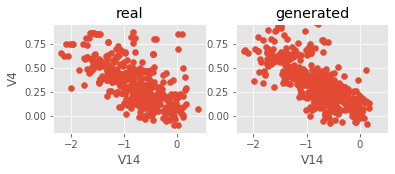

Iter: 47400; D loss: 1.3; G_loss: -0.7009; xgb_loss: 0.7541


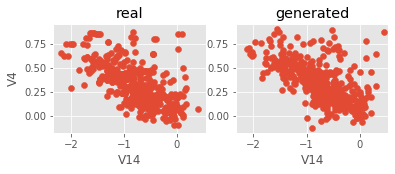

Iter: 47500; D loss: 1.299; G_loss: -0.7186; xgb_loss: 0.7642


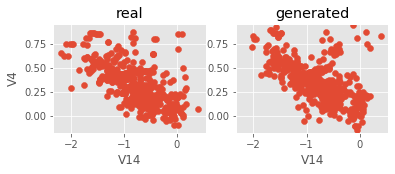

Iter: 47600; D loss: 1.311; G_loss: -0.6843; xgb_loss: 0.7236


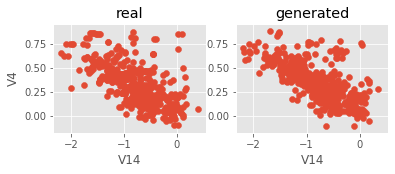

Iter: 47700; D loss: 1.284; G_loss: -0.6641; xgb_loss: 0.75


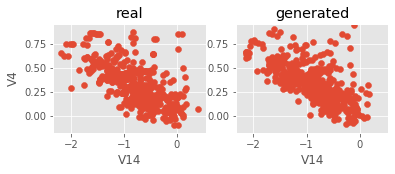

Iter: 47800; D loss: 1.29; G_loss: -0.6519; xgb_loss: 0.748


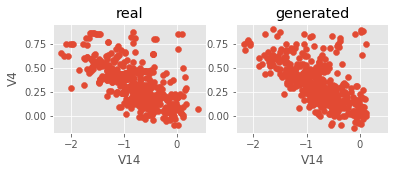

Iter: 47900; D loss: 1.303; G_loss: -0.667; xgb_loss: 0.6972


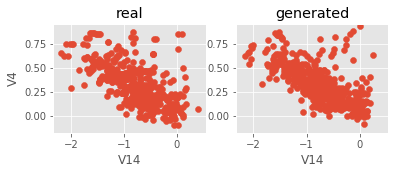

Iter: 48000; D loss: 1.295; G_loss: -0.7008; xgb_loss: 0.7195


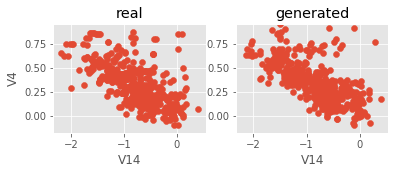

Iter: 48100; D loss: 1.295; G_loss: -0.6842; xgb_loss: 0.7256


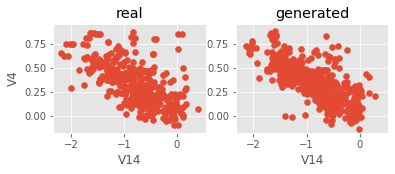

Iter: 48200; D loss: 1.276; G_loss: -0.6724; xgb_loss: 0.7073


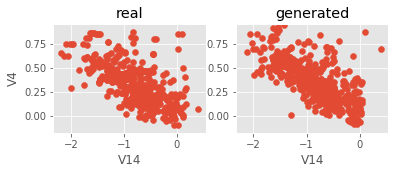

Iter: 48300; D loss: 1.3; G_loss: -0.6734; xgb_loss: 0.7093


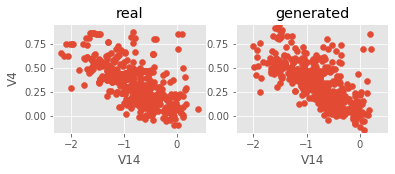

Iter: 48400; D loss: 1.29; G_loss: -0.7; xgb_loss: 0.7337


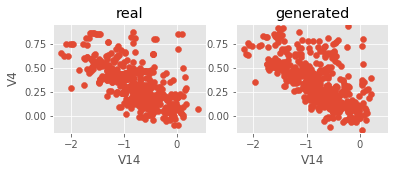

Iter: 48500; D loss: 1.293; G_loss: -0.6877; xgb_loss: 0.7073


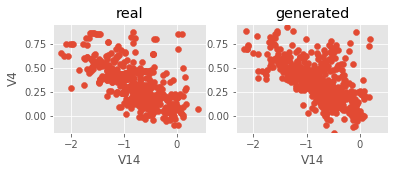

Iter: 48600; D loss: 1.297; G_loss: -0.6687; xgb_loss: 0.7215


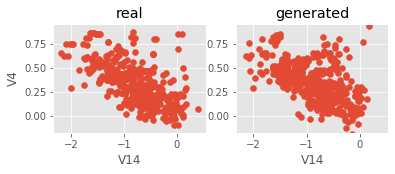

Iter: 48700; D loss: 1.289; G_loss: -0.6649; xgb_loss: 0.7012


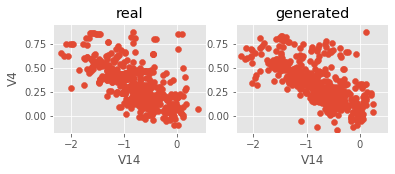

Iter: 48800; D loss: 1.299; G_loss: -0.6652; xgb_loss: 0.7256


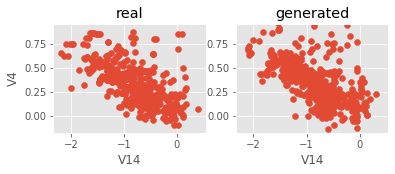

Iter: 48900; D loss: 1.302; G_loss: -0.6541; xgb_loss: 0.7276


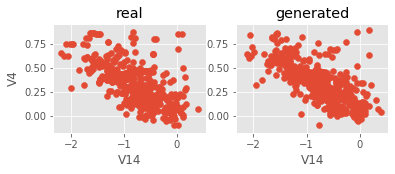

Iter: 49000; D loss: 1.299; G_loss: -0.6838; xgb_loss: 0.7724


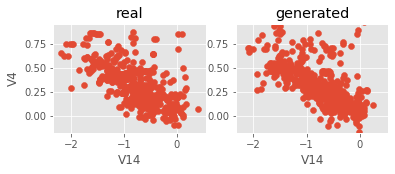

Iter: 49100; D loss: 1.269; G_loss: -0.675; xgb_loss: 0.7459


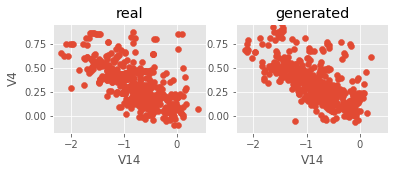

Iter: 49200; D loss: 1.319; G_loss: -0.6533; xgb_loss: 0.7398


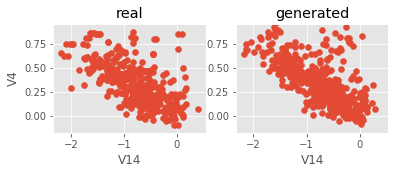

Iter: 49300; D loss: 1.334; G_loss: -0.6484; xgb_loss: 0.7215


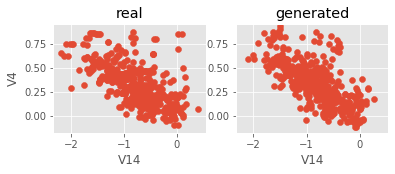

Iter: 49400; D loss: 1.304; G_loss: -0.6389; xgb_loss: 0.7358


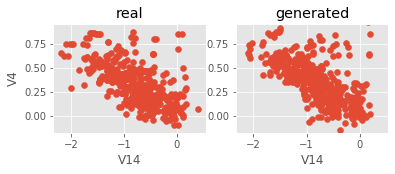

Iter: 49500; D loss: 1.31; G_loss: -0.6706; xgb_loss: 0.6707


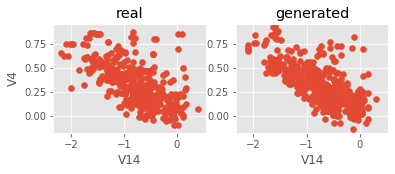

Iter: 49600; D loss: 1.315; G_loss: -0.6588; xgb_loss: 0.7033


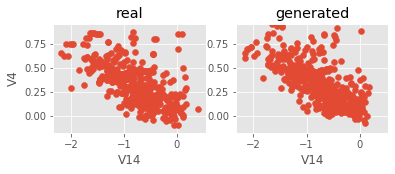

Iter: 49700; D loss: 1.315; G_loss: -0.6355; xgb_loss: 0.7215


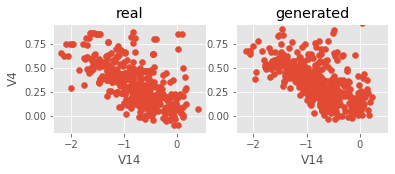

Iter: 49800; D loss: 1.305; G_loss: -0.6442; xgb_loss: 0.7276


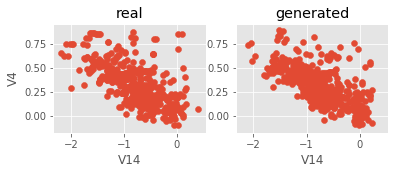

Iter: 49900; D loss: 1.322; G_loss: -0.6497; xgb_loss: 0.7276


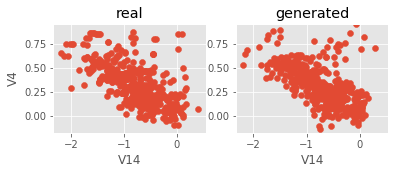

Iter: 50000; D loss: 1.308; G_loss: -0.6582; xgb_loss: 0.7297


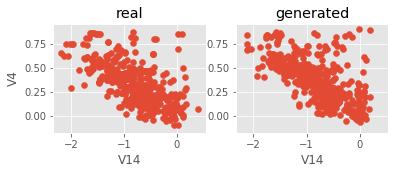

CPU times: user 24min 43s, sys: 2min 17s, total: 27min 1s
Wall time: 7min 10s


In [63]:
%%time

# Now we train the DRAGAN
# We'll xgboost test it at intervals
# We'll also save the graph weights and losses at intervals as well

for it in range(0, 50000+1):
    
    X_mb = get_data_batch(train, mb_size, seed=it)
    X_mb_p = get_perturbed_batch(X_mb) # DRAGAN

    _, D_loss_curr, d_l_r, d_l_g = sess.run(
        [D_solver, disc_cost, D_loss_real, D_loss_fake],
        feed_dict={X: X_mb, X_p: X_mb_p, z: sample_z(mb_size, z_dim)}
    )

    _, G_loss_curr = sess.run(
        [G_solver, gen_cost],
        feed_dict={z: sample_z(mb_size, z_dim)}
    )

    disc_loss_real.append(d_l_r)
    disc_loss_generated.append(d_l_g)
    combined_loss.append(G_loss_curr)
    
    if it % 100 == 0:
        test_size = 492 # The total number of fraud cases
        x = get_data_batch(train, test_size, seed=it)
        g_z = sess.run(G_sample, feed_dict={z: sample_z(test_size, z_dim)})
        xgb_loss = CheckAccuracy( x, g_z, data_cols, label_cols, seed=0, with_class=with_class, data_dim=data_dim )
        xgb_losses.append(xgb_loss)
        if xgb_loss < best_xgb: 
            best_xgb = xgb_loss
            saver.save(sess, data_dir + cache_prefix, global_step=it, write_meta_graph=False )
            
    if it % log_interval == 0:
        print('Iter: {}; D loss: {:.4}; G_loss: {:.4}; xgb_loss: {:.4}'
              .format(it, D_loss_curr, G_loss_curr, xgb_loss))
        if show:
            PlotData( x, g_z, data_cols, label_cols, seed=0, with_class=with_class, data_dim=data_dim ) 
            
        saver.save(sess, data_dir + cache_prefix, global_step=it, write_meta_graph=False )

        pickle.dump([combined_loss, disc_loss_generated, disc_loss_real, xgb_losses], 
                        open( data_dir + cache_prefix + '_losses_step_{}.pkl'.format(it) ,'wb'))
    

Iter: 50100; D loss: 1.324; G_loss: -0.6544; xgb_loss: 0.7439


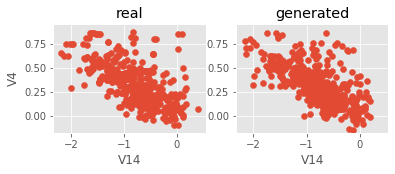

Iter: 50200; D loss: 1.303; G_loss: -0.66; xgb_loss: 0.6809


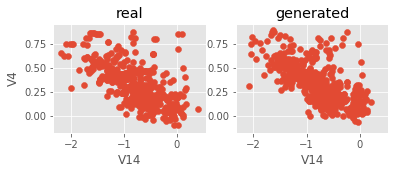

Iter: 50300; D loss: 1.303; G_loss: -0.6367; xgb_loss: 0.75


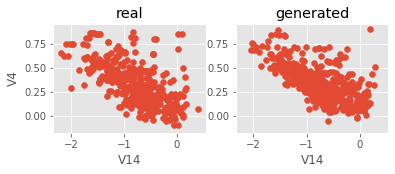

Iter: 50400; D loss: 1.312; G_loss: -0.6492; xgb_loss: 0.7215


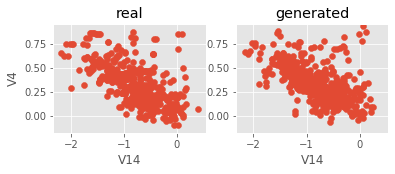

Iter: 50500; D loss: 1.298; G_loss: -0.6291; xgb_loss: 0.7215


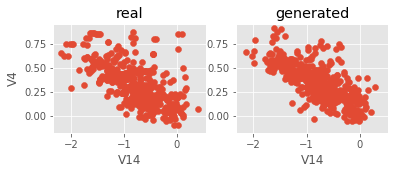

Iter: 50600; D loss: 1.339; G_loss: -0.6508; xgb_loss: 0.7764


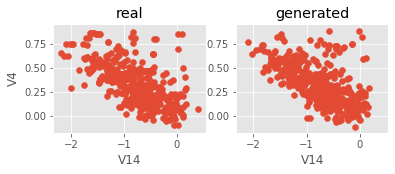

Iter: 50700; D loss: 1.333; G_loss: -0.6588; xgb_loss: 0.6809


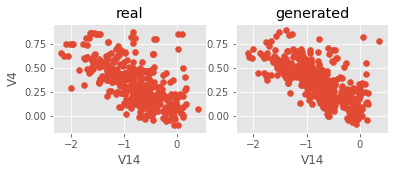

Iter: 50800; D loss: 1.292; G_loss: -0.6624; xgb_loss: 0.7398


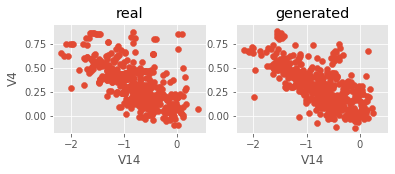

Iter: 50900; D loss: 1.312; G_loss: -0.651; xgb_loss: 0.6992


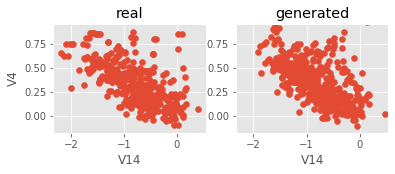

Iter: 51000; D loss: 1.3; G_loss: -0.6544; xgb_loss: 0.7825


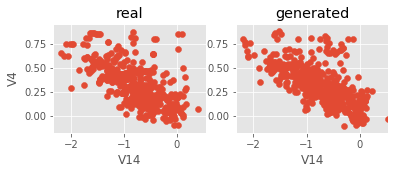

Iter: 51100; D loss: 1.296; G_loss: -0.644; xgb_loss: 0.75


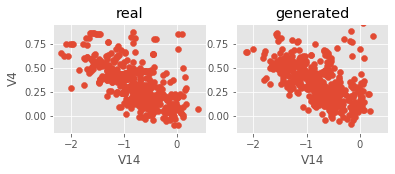

Iter: 51200; D loss: 1.304; G_loss: -0.6399; xgb_loss: 0.7053


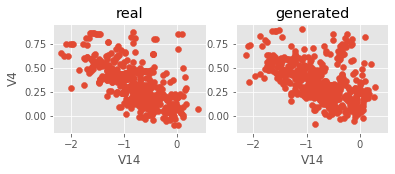

Iter: 51300; D loss: 1.312; G_loss: -0.6582; xgb_loss: 0.7114


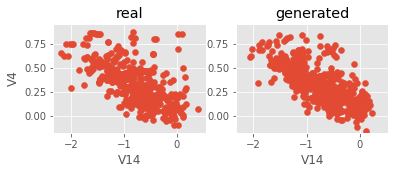

Iter: 51400; D loss: 1.302; G_loss: -0.6635; xgb_loss: 0.7642


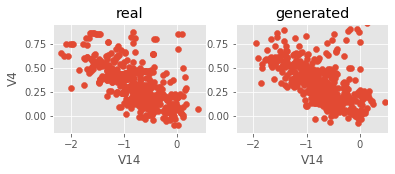

Iter: 51500; D loss: 1.3; G_loss: -0.6694; xgb_loss: 0.6789


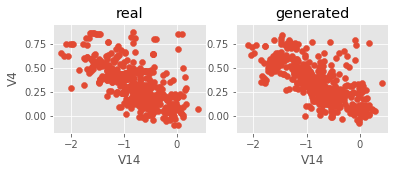

Iter: 51600; D loss: 1.302; G_loss: -0.6683; xgb_loss: 0.7215


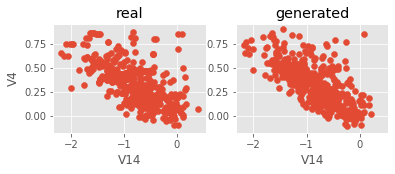

Iter: 51700; D loss: 1.309; G_loss: -0.6679; xgb_loss: 0.7378


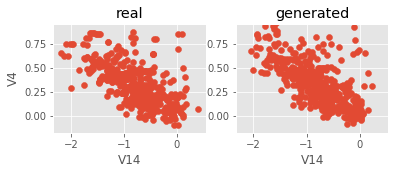

Iter: 51800; D loss: 1.291; G_loss: -0.6703; xgb_loss: 0.752


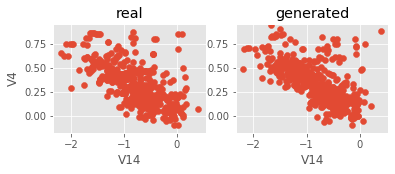

Iter: 51900; D loss: 1.302; G_loss: -0.6756; xgb_loss: 0.7398


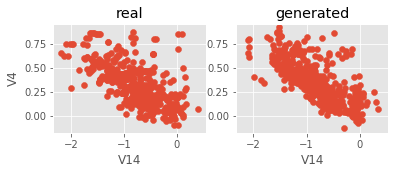

Iter: 52000; D loss: 1.309; G_loss: -0.6433; xgb_loss: 0.6972


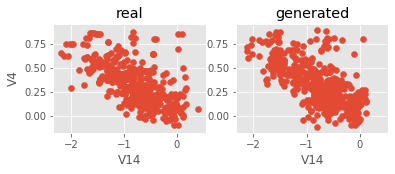

Iter: 52100; D loss: 1.315; G_loss: -0.6572; xgb_loss: 0.7114


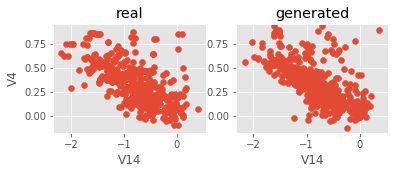

Iter: 52200; D loss: 1.301; G_loss: -0.6907; xgb_loss: 0.7236


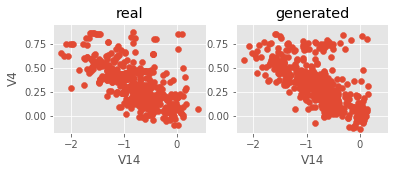

Iter: 52300; D loss: 1.308; G_loss: -0.6752; xgb_loss: 0.7236


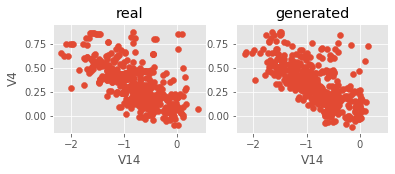

Iter: 52400; D loss: 1.291; G_loss: -0.6586; xgb_loss: 0.7419


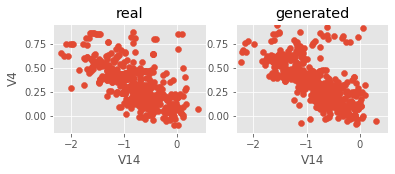

Iter: 52500; D loss: 1.303; G_loss: -0.6502; xgb_loss: 0.7175


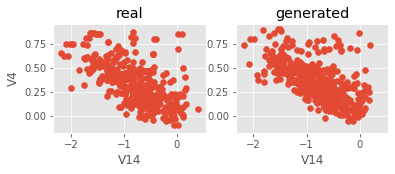

Iter: 52600; D loss: 1.313; G_loss: -0.6651; xgb_loss: 0.6687


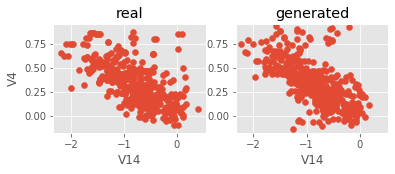

Iter: 52700; D loss: 1.314; G_loss: -0.6385; xgb_loss: 0.6951


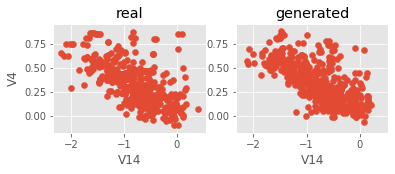

Iter: 52800; D loss: 1.309; G_loss: -0.6496; xgb_loss: 0.7154


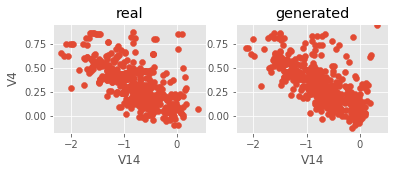

Iter: 52900; D loss: 1.306; G_loss: -0.6762; xgb_loss: 0.7642


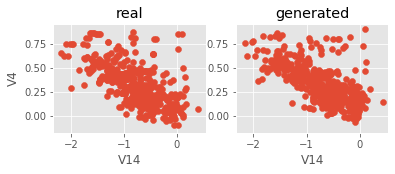

Iter: 53000; D loss: 1.305; G_loss: -0.6757; xgb_loss: 0.748


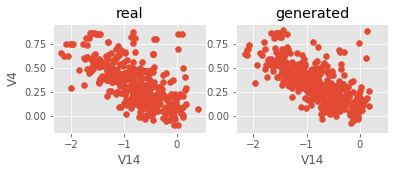

Iter: 53100; D loss: 1.309; G_loss: -0.6497; xgb_loss: 0.6951


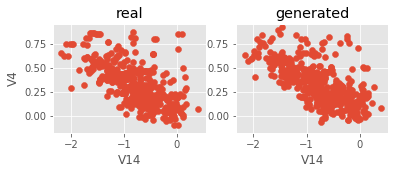

Iter: 53200; D loss: 1.305; G_loss: -0.6853; xgb_loss: 0.7724


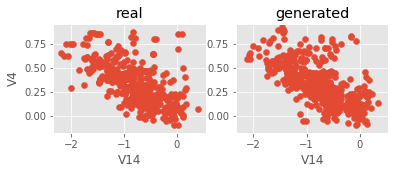

Iter: 53300; D loss: 1.313; G_loss: -0.6676; xgb_loss: 0.7114


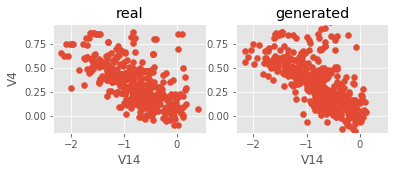

Iter: 53400; D loss: 1.318; G_loss: -0.6833; xgb_loss: 0.7033


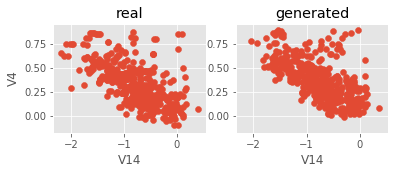

Iter: 53500; D loss: 1.327; G_loss: -0.6884; xgb_loss: 0.7317


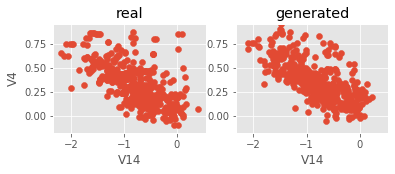

Iter: 53600; D loss: 1.315; G_loss: -0.6517; xgb_loss: 0.6789


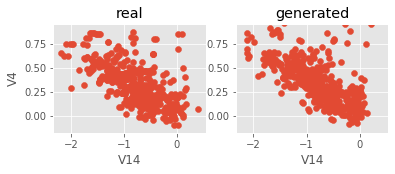

Iter: 53700; D loss: 1.293; G_loss: -0.6947; xgb_loss: 0.7378


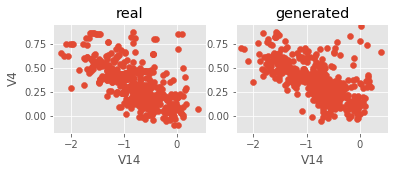

Iter: 53800; D loss: 1.304; G_loss: -0.6562; xgb_loss: 0.752


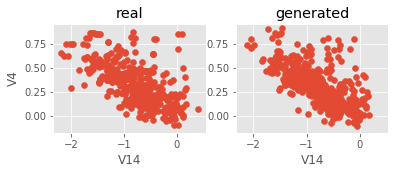

Iter: 53900; D loss: 1.316; G_loss: -0.6729; xgb_loss: 0.7642


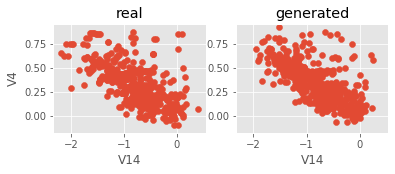

Iter: 54000; D loss: 1.281; G_loss: -0.6642; xgb_loss: 0.7053


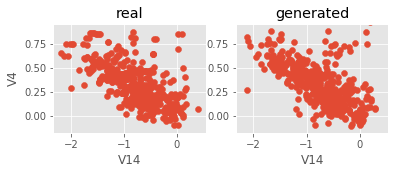

Iter: 54100; D loss: 1.294; G_loss: -0.7064; xgb_loss: 0.7378


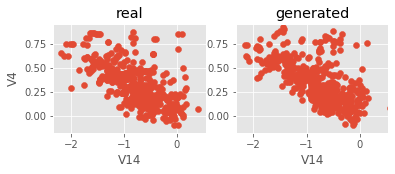

Iter: 54200; D loss: 1.304; G_loss: -0.6708; xgb_loss: 0.7175


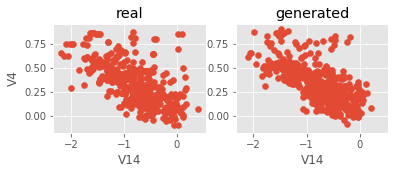

Iter: 54300; D loss: 1.292; G_loss: -0.6874; xgb_loss: 0.7134


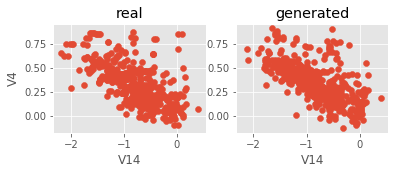

Iter: 54400; D loss: 1.291; G_loss: -0.6569; xgb_loss: 0.7093


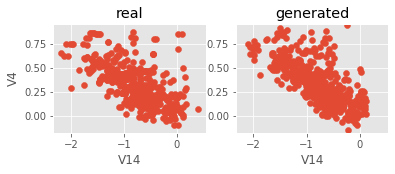

Iter: 54500; D loss: 1.305; G_loss: -0.6987; xgb_loss: 0.7337


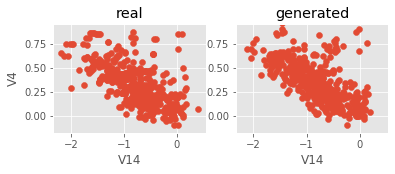

Iter: 54600; D loss: 1.301; G_loss: -0.6833; xgb_loss: 0.7398


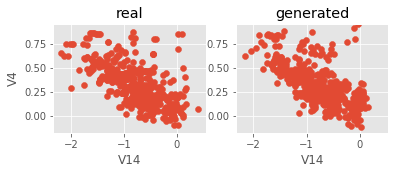

Iter: 54700; D loss: 1.295; G_loss: -0.6651; xgb_loss: 0.6524


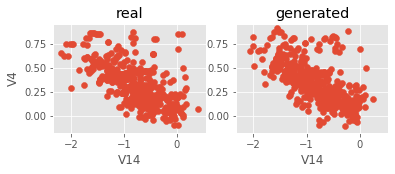

Iter: 54800; D loss: 1.303; G_loss: -0.6581; xgb_loss: 0.6992


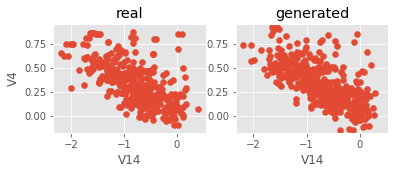

Iter: 54900; D loss: 1.301; G_loss: -0.6609; xgb_loss: 0.7134


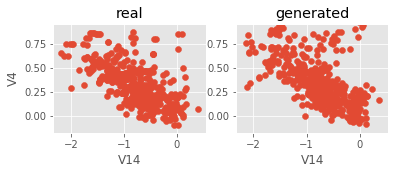

Iter: 55000; D loss: 1.292; G_loss: -0.6786; xgb_loss: 0.7256


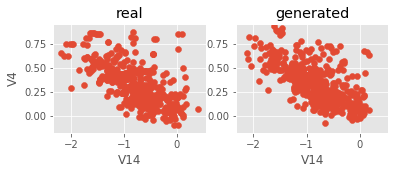

Iter: 55100; D loss: 1.296; G_loss: -0.6748; xgb_loss: 0.6768


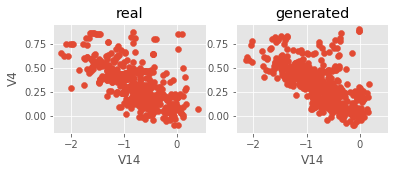

Iter: 55200; D loss: 1.286; G_loss: -0.677; xgb_loss: 0.7419


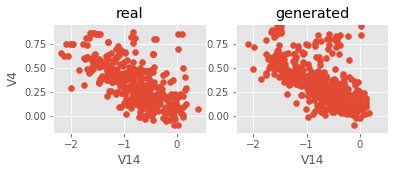

Iter: 55300; D loss: 1.301; G_loss: -0.677; xgb_loss: 0.7459


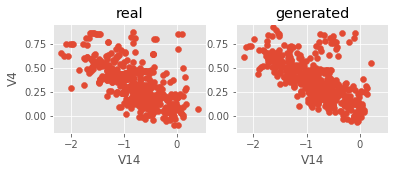

Iter: 55400; D loss: 1.326; G_loss: -0.6683; xgb_loss: 0.7337


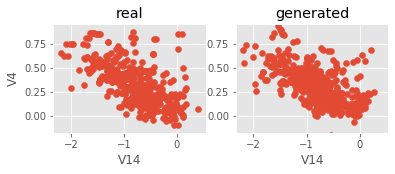

Iter: 55500; D loss: 1.297; G_loss: -0.6513; xgb_loss: 0.6707


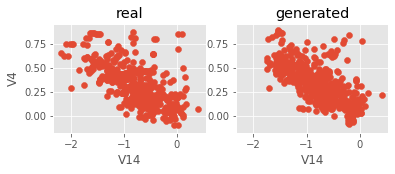

Iter: 55600; D loss: 1.312; G_loss: -0.6268; xgb_loss: 0.7256


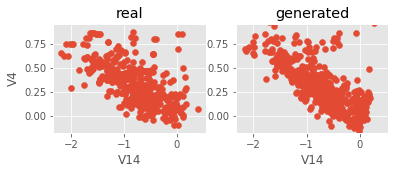

Iter: 55700; D loss: 1.308; G_loss: -0.6756; xgb_loss: 0.6931


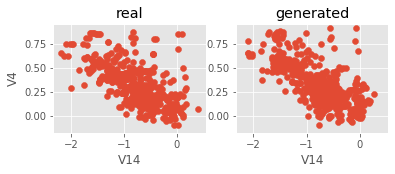

Iter: 55800; D loss: 1.29; G_loss: -0.6483; xgb_loss: 0.7256


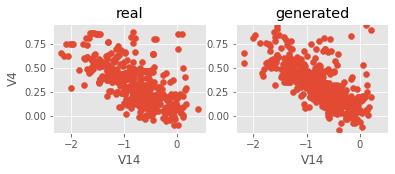

Iter: 55900; D loss: 1.298; G_loss: -0.67; xgb_loss: 0.7297


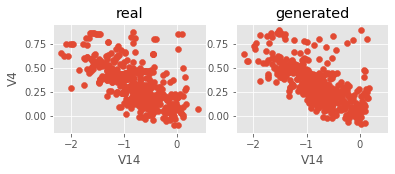

Iter: 56000; D loss: 1.314; G_loss: -0.6327; xgb_loss: 0.7317


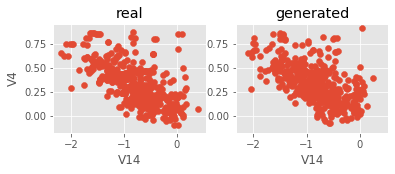

Iter: 56100; D loss: 1.322; G_loss: -0.6392; xgb_loss: 0.748


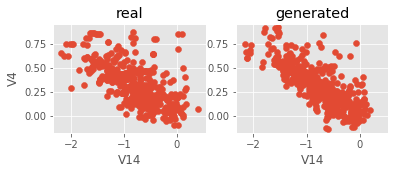

Iter: 56200; D loss: 1.322; G_loss: -0.6596; xgb_loss: 0.7093


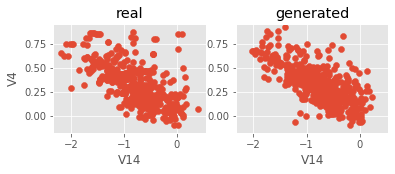

Iter: 56300; D loss: 1.31; G_loss: -0.6358; xgb_loss: 0.7398


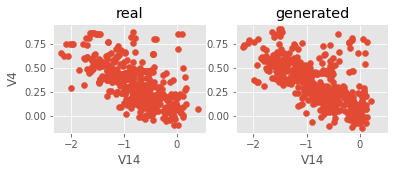

Iter: 56400; D loss: 1.31; G_loss: -0.6611; xgb_loss: 0.7195


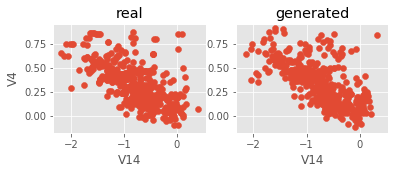

Iter: 56500; D loss: 1.312; G_loss: -0.6551; xgb_loss: 0.75


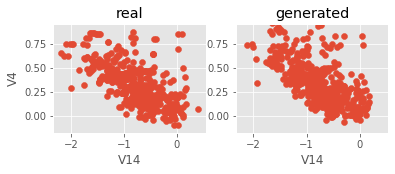

Iter: 56600; D loss: 1.288; G_loss: -0.6614; xgb_loss: 0.685


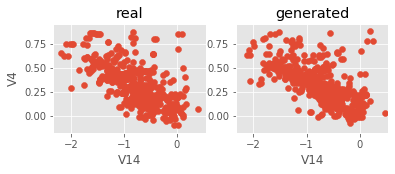

Iter: 56700; D loss: 1.291; G_loss: -0.6738; xgb_loss: 0.7134


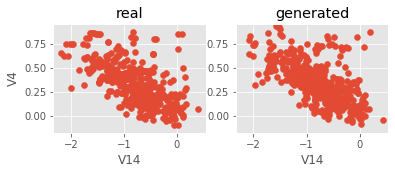

Iter: 56800; D loss: 1.306; G_loss: -0.6676; xgb_loss: 0.7053


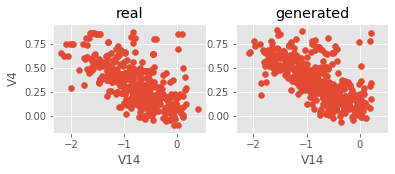

Iter: 56900; D loss: 1.311; G_loss: -0.6594; xgb_loss: 0.7175


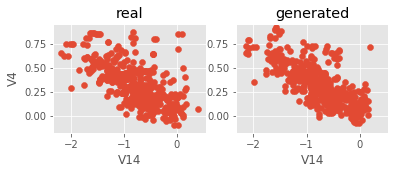

Iter: 57000; D loss: 1.302; G_loss: -0.671; xgb_loss: 0.6911


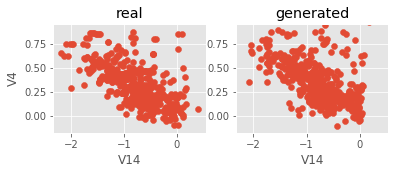

Iter: 57100; D loss: 1.304; G_loss: -0.662; xgb_loss: 0.7297


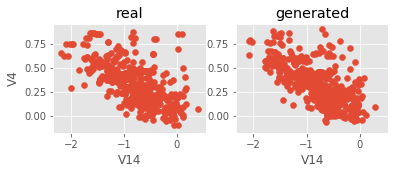

Iter: 57200; D loss: 1.306; G_loss: -0.671; xgb_loss: 0.7175


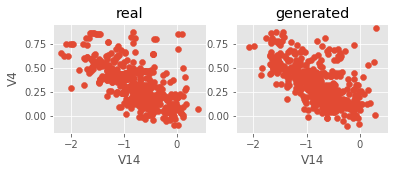

Iter: 57300; D loss: 1.305; G_loss: -0.6609; xgb_loss: 0.7093


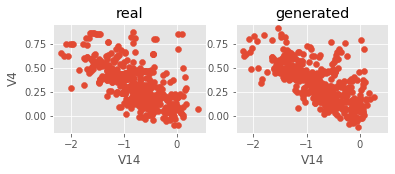

Iter: 57400; D loss: 1.301; G_loss: -0.6439; xgb_loss: 0.7581


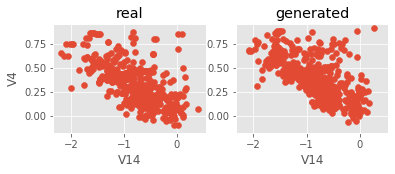

Iter: 57500; D loss: 1.318; G_loss: -0.6718; xgb_loss: 0.7236


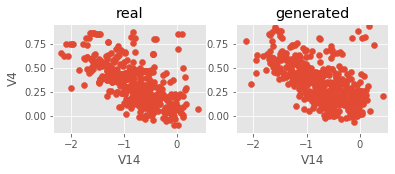

Iter: 57600; D loss: 1.317; G_loss: -0.642; xgb_loss: 0.7114


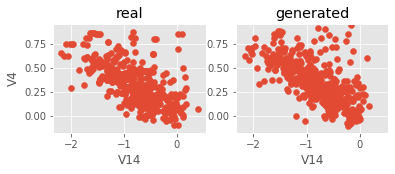

Iter: 57700; D loss: 1.316; G_loss: -0.6593; xgb_loss: 0.7459


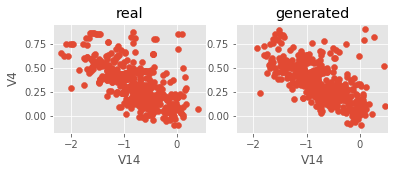

Iter: 57800; D loss: 1.319; G_loss: -0.6419; xgb_loss: 0.7561


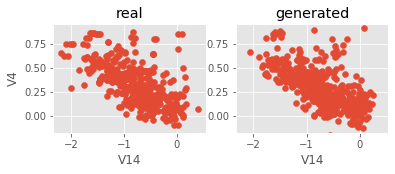

Iter: 57900; D loss: 1.328; G_loss: -0.6687; xgb_loss: 0.7378


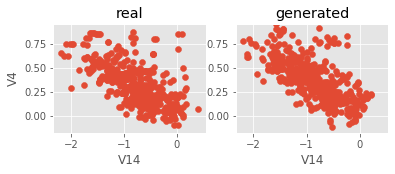

Iter: 58000; D loss: 1.308; G_loss: -0.6485; xgb_loss: 0.6972


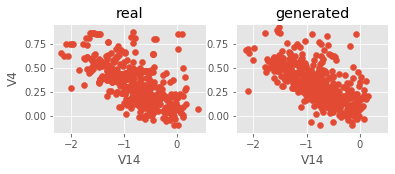

Iter: 58100; D loss: 1.303; G_loss: -0.6725; xgb_loss: 0.6789


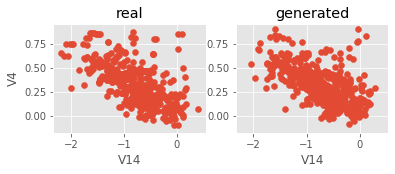

Iter: 58200; D loss: 1.288; G_loss: -0.668; xgb_loss: 0.7175


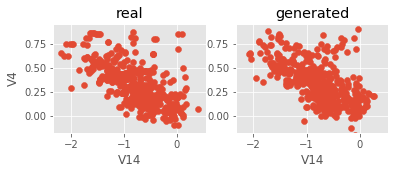

Iter: 58300; D loss: 1.315; G_loss: -0.6723; xgb_loss: 0.7195


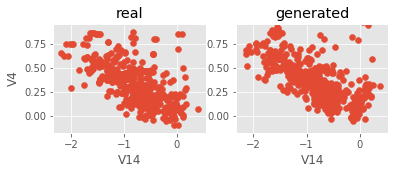

Iter: 58400; D loss: 1.295; G_loss: -0.6528; xgb_loss: 0.6911


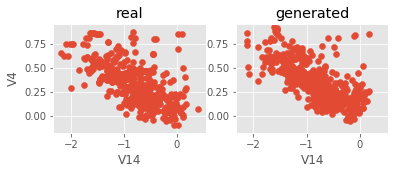

Iter: 58500; D loss: 1.287; G_loss: -0.655; xgb_loss: 0.685


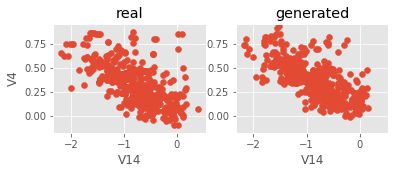

Iter: 58600; D loss: 1.293; G_loss: -0.6592; xgb_loss: 0.7317


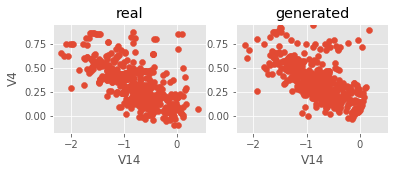

Iter: 58700; D loss: 1.306; G_loss: -0.6739; xgb_loss: 0.7134


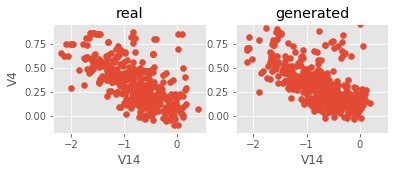

Iter: 58800; D loss: 1.301; G_loss: -0.6635; xgb_loss: 0.7703


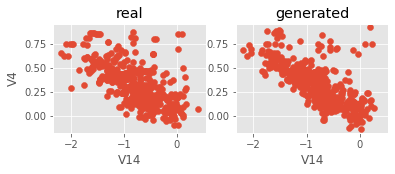

Iter: 58900; D loss: 1.321; G_loss: -0.6664; xgb_loss: 0.6931


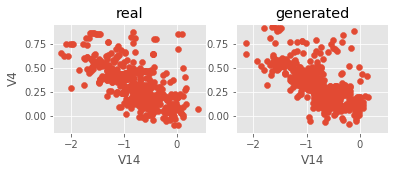

Iter: 59000; D loss: 1.288; G_loss: -0.665; xgb_loss: 0.7033


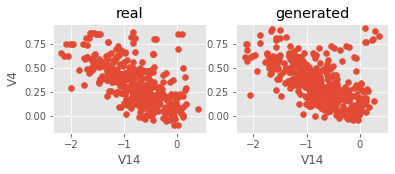

Iter: 59100; D loss: 1.296; G_loss: -0.6723; xgb_loss: 0.689


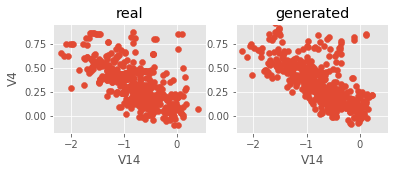

Iter: 59200; D loss: 1.304; G_loss: -0.6528; xgb_loss: 0.7073


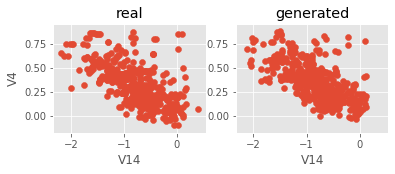

Iter: 59300; D loss: 1.306; G_loss: -0.6807; xgb_loss: 0.7114


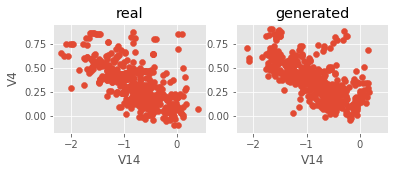

Iter: 59400; D loss: 1.287; G_loss: -0.6563; xgb_loss: 0.748


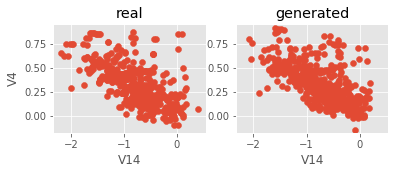

Iter: 59500; D loss: 1.303; G_loss: -0.676; xgb_loss: 0.6829


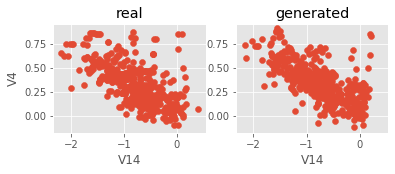

Iter: 59600; D loss: 1.285; G_loss: -0.6536; xgb_loss: 0.7317


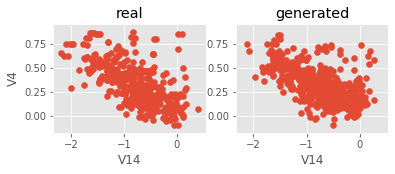

Iter: 59700; D loss: 1.29; G_loss: -0.6489; xgb_loss: 0.7663


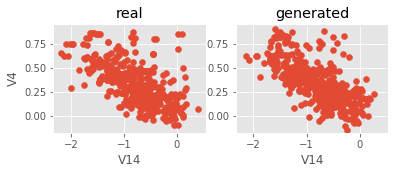

Iter: 59800; D loss: 1.317; G_loss: -0.6702; xgb_loss: 0.7134


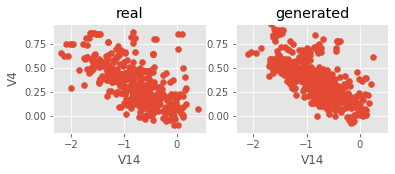

Iter: 59900; D loss: 1.295; G_loss: -0.692; xgb_loss: 0.7297


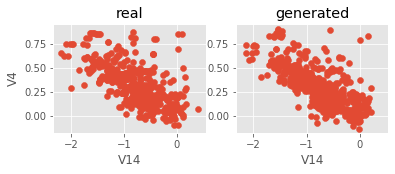

Iter: 60000; D loss: 1.295; G_loss: -0.6759; xgb_loss: 0.689


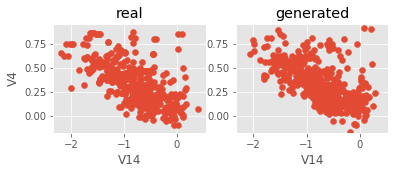

Iter: 60100; D loss: 1.316; G_loss: -0.6457; xgb_loss: 0.7093


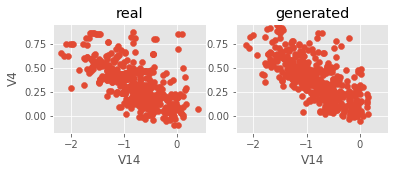

Iter: 60200; D loss: 1.302; G_loss: -0.6541; xgb_loss: 0.7337


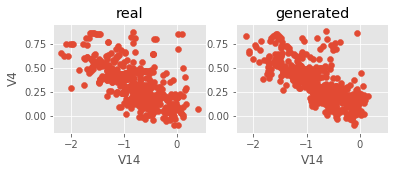

Iter: 60300; D loss: 1.278; G_loss: -0.6893; xgb_loss: 0.6951


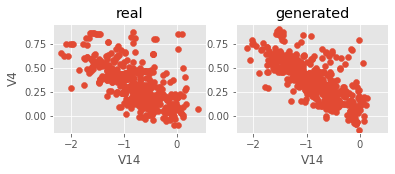

Iter: 60400; D loss: 1.294; G_loss: -0.6607; xgb_loss: 0.7459


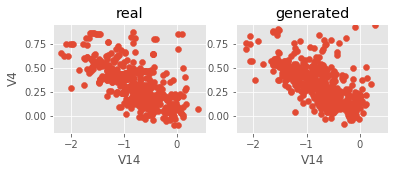

Iter: 60500; D loss: 1.306; G_loss: -0.6742; xgb_loss: 0.6646


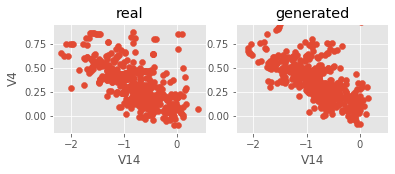

Iter: 60600; D loss: 1.29; G_loss: -0.6493; xgb_loss: 0.7317


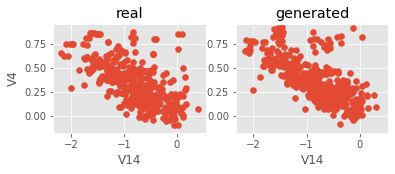

Iter: 60700; D loss: 1.301; G_loss: -0.6801; xgb_loss: 0.6809


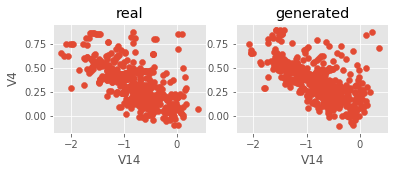

Iter: 60800; D loss: 1.301; G_loss: -0.6635; xgb_loss: 0.6992


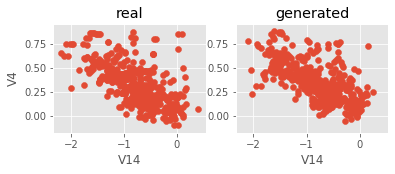

Iter: 60900; D loss: 1.304; G_loss: -0.658; xgb_loss: 0.7175


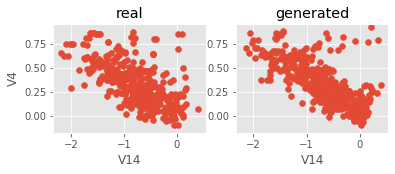

Iter: 61000; D loss: 1.308; G_loss: -0.6754; xgb_loss: 0.7053


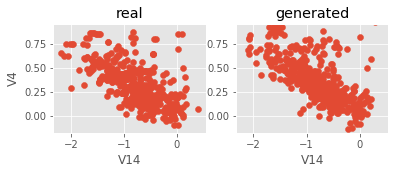

Iter: 61100; D loss: 1.317; G_loss: -0.6707; xgb_loss: 0.7602


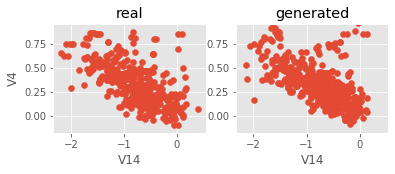

Iter: 61200; D loss: 1.306; G_loss: -0.6667; xgb_loss: 0.748


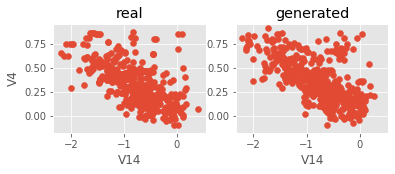

Iter: 61300; D loss: 1.315; G_loss: -0.6777; xgb_loss: 0.7581


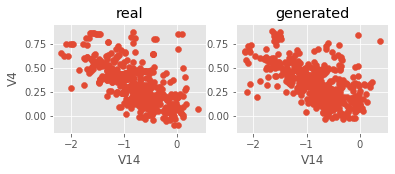

Iter: 61400; D loss: 1.303; G_loss: -0.6632; xgb_loss: 0.75


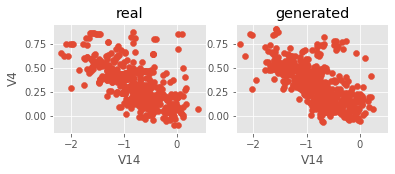

Iter: 61500; D loss: 1.314; G_loss: -0.6676; xgb_loss: 0.7459


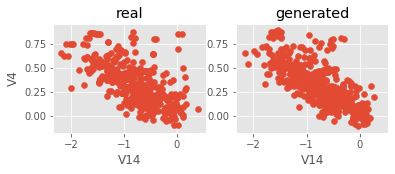

Iter: 61600; D loss: 1.313; G_loss: -0.6642; xgb_loss: 0.7276


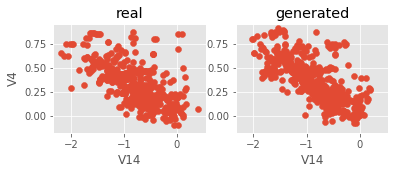

Iter: 61700; D loss: 1.31; G_loss: -0.6694; xgb_loss: 0.7276


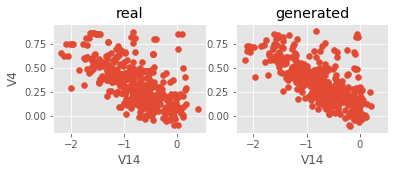

Iter: 61800; D loss: 1.315; G_loss: -0.6634; xgb_loss: 0.6911


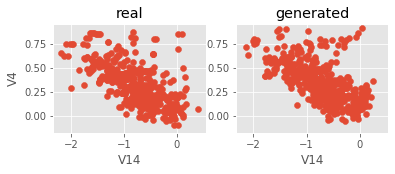

Iter: 61900; D loss: 1.323; G_loss: -0.6473; xgb_loss: 0.6992


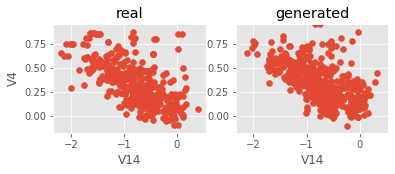

Iter: 62000; D loss: 1.306; G_loss: -0.643; xgb_loss: 0.7175


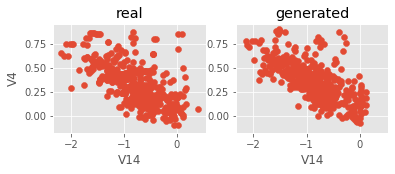

Iter: 62100; D loss: 1.315; G_loss: -0.6585; xgb_loss: 0.7012


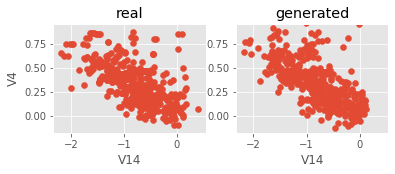

Iter: 62200; D loss: 1.299; G_loss: -0.6583; xgb_loss: 0.7276


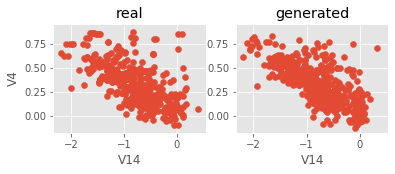

Iter: 62300; D loss: 1.313; G_loss: -0.6396; xgb_loss: 0.6951


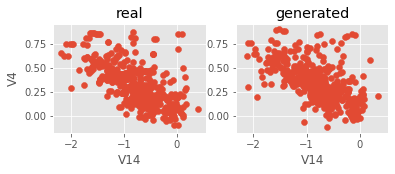

Iter: 62400; D loss: 1.321; G_loss: -0.6497; xgb_loss: 0.7215


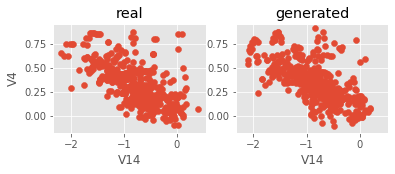

Iter: 62500; D loss: 1.324; G_loss: -0.6408; xgb_loss: 0.7703


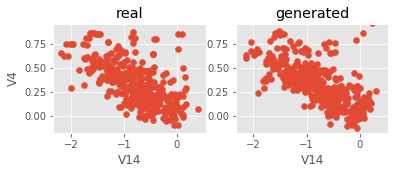

Iter: 62600; D loss: 1.315; G_loss: -0.6536; xgb_loss: 0.6728


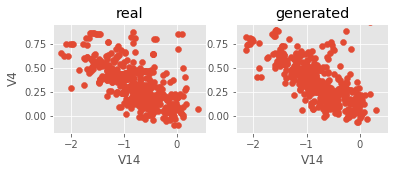

Iter: 62700; D loss: 1.312; G_loss: -0.6619; xgb_loss: 0.7073


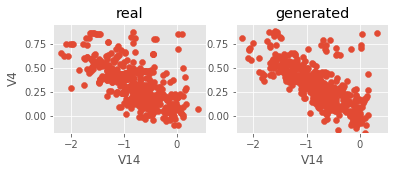

Iter: 62800; D loss: 1.333; G_loss: -0.6587; xgb_loss: 0.6992


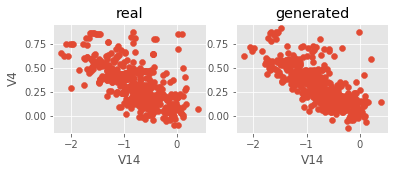

Iter: 62900; D loss: 1.303; G_loss: -0.6615; xgb_loss: 0.6972


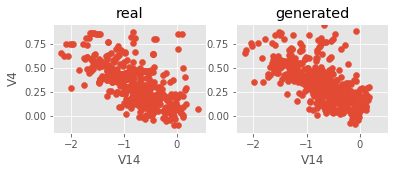

Iter: 63000; D loss: 1.31; G_loss: -0.6473; xgb_loss: 0.748


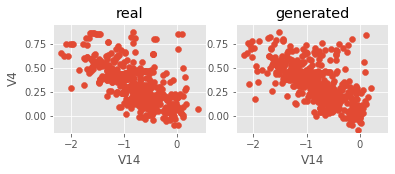

Iter: 63100; D loss: 1.287; G_loss: -0.6567; xgb_loss: 0.748


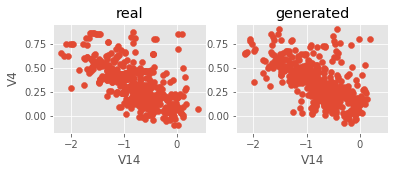

Iter: 63200; D loss: 1.291; G_loss: -0.654; xgb_loss: 0.6707


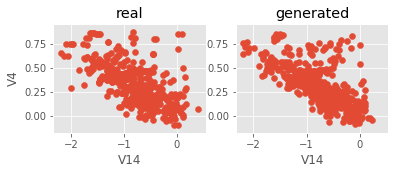

Iter: 63300; D loss: 1.291; G_loss: -0.6623; xgb_loss: 0.6931


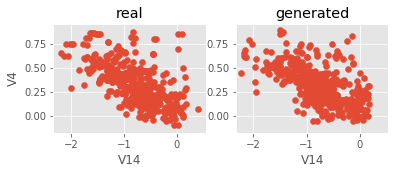

Iter: 63400; D loss: 1.299; G_loss: -0.6823; xgb_loss: 0.7033


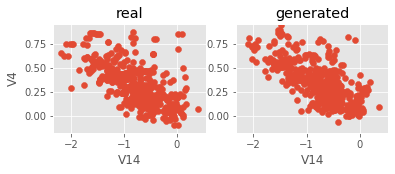

Iter: 63500; D loss: 1.326; G_loss: -0.6343; xgb_loss: 0.7297


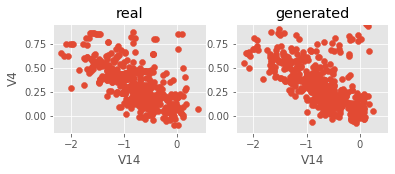

Iter: 63600; D loss: 1.305; G_loss: -0.6755; xgb_loss: 0.6951


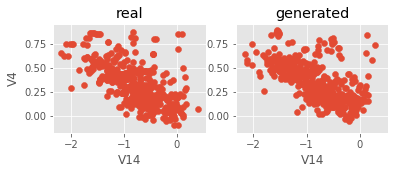

Iter: 63700; D loss: 1.302; G_loss: -0.6496; xgb_loss: 0.7581


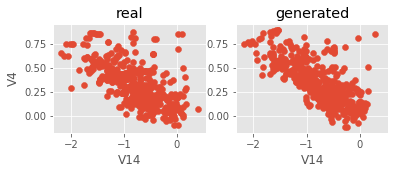

Iter: 63800; D loss: 1.312; G_loss: -0.6545; xgb_loss: 0.7114


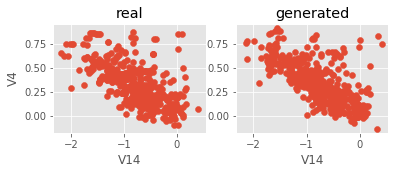

Iter: 63900; D loss: 1.295; G_loss: -0.6424; xgb_loss: 0.6931


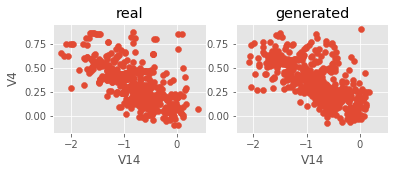

Iter: 64000; D loss: 1.314; G_loss: -0.6901; xgb_loss: 0.7236


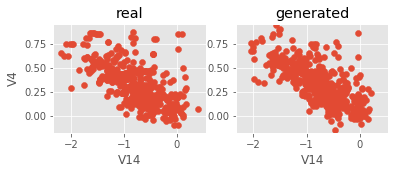

Iter: 64100; D loss: 1.309; G_loss: -0.6567; xgb_loss: 0.7053


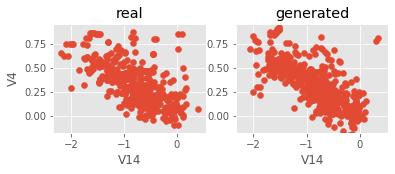

Iter: 64200; D loss: 1.31; G_loss: -0.6745; xgb_loss: 0.7317


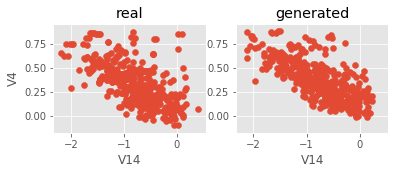

Iter: 64300; D loss: 1.306; G_loss: -0.6411; xgb_loss: 0.687


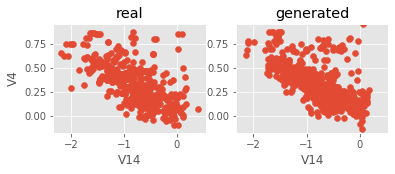

Iter: 64400; D loss: 1.324; G_loss: -0.6583; xgb_loss: 0.6809


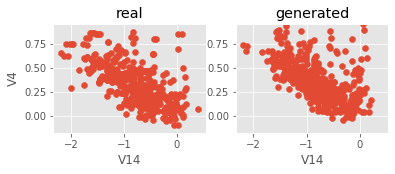

Iter: 64500; D loss: 1.301; G_loss: -0.6459; xgb_loss: 0.687


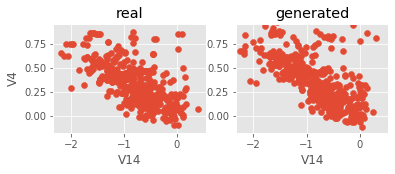

Iter: 64600; D loss: 1.301; G_loss: -0.6301; xgb_loss: 0.7175


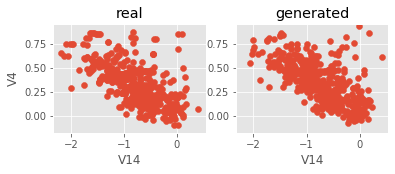

Iter: 64700; D loss: 1.314; G_loss: -0.6341; xgb_loss: 0.6992


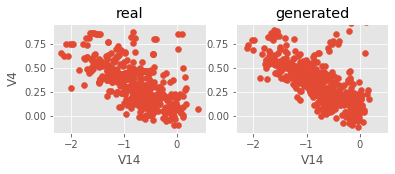

Iter: 64800; D loss: 1.309; G_loss: -0.7043; xgb_loss: 0.687


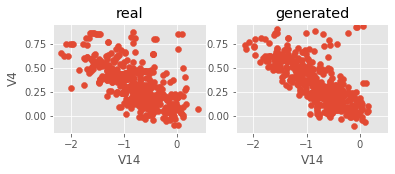

Iter: 64900; D loss: 1.313; G_loss: -0.6477; xgb_loss: 0.689


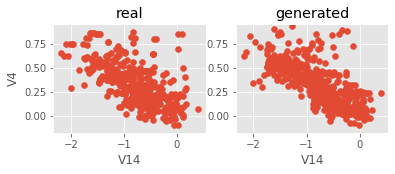

Iter: 65000; D loss: 1.316; G_loss: -0.6917; xgb_loss: 0.7053


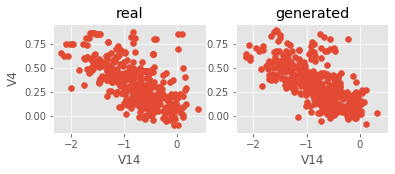

Iter: 65100; D loss: 1.297; G_loss: -0.6665; xgb_loss: 0.7337


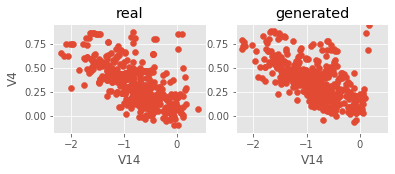

Iter: 65200; D loss: 1.3; G_loss: -0.6667; xgb_loss: 0.7703


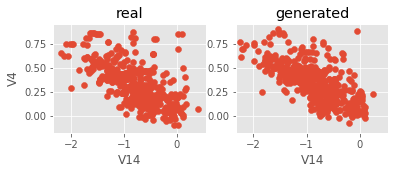

Iter: 65300; D loss: 1.304; G_loss: -0.6791; xgb_loss: 0.7297


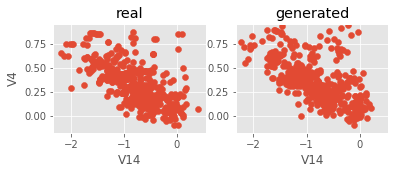

Iter: 65400; D loss: 1.308; G_loss: -0.6647; xgb_loss: 0.6606


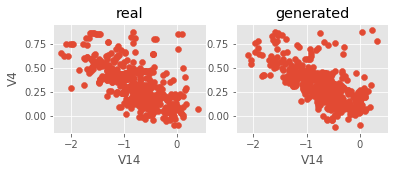

Iter: 65500; D loss: 1.312; G_loss: -0.6777; xgb_loss: 0.689


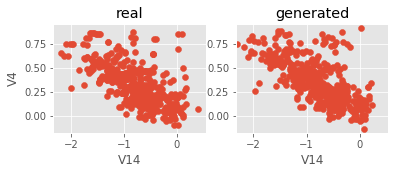

Iter: 65600; D loss: 1.298; G_loss: -0.6593; xgb_loss: 0.748


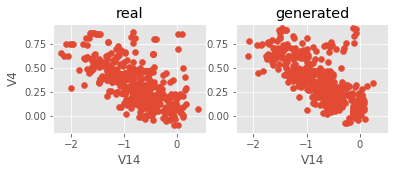

Iter: 65700; D loss: 1.305; G_loss: -0.6674; xgb_loss: 0.7337


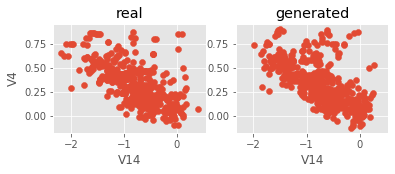

Iter: 65800; D loss: 1.296; G_loss: -0.6616; xgb_loss: 0.687


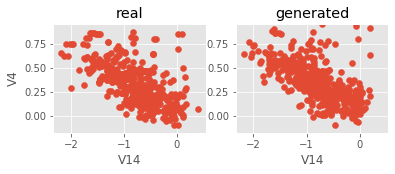

Iter: 65900; D loss: 1.303; G_loss: -0.6749; xgb_loss: 0.7561


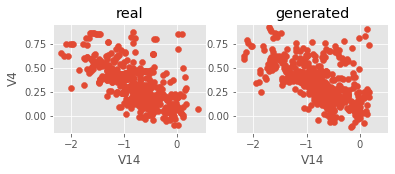

Iter: 66000; D loss: 1.28; G_loss: -0.6708; xgb_loss: 0.6321


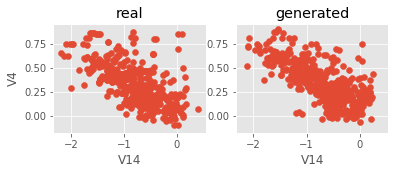

Iter: 66100; D loss: 1.296; G_loss: -0.6636; xgb_loss: 0.7053


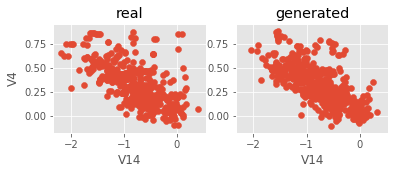

Iter: 66200; D loss: 1.318; G_loss: -0.6681; xgb_loss: 0.6809


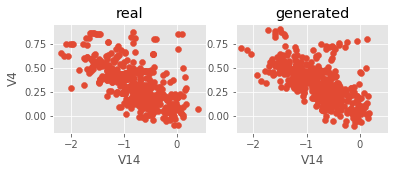

Iter: 66300; D loss: 1.293; G_loss: -0.6841; xgb_loss: 0.7297


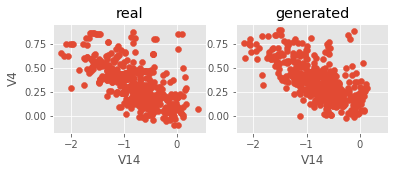

Iter: 66400; D loss: 1.298; G_loss: -0.7073; xgb_loss: 0.7154


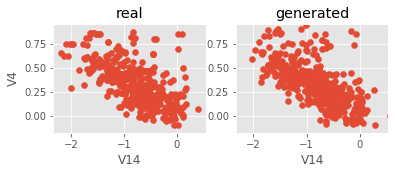

Iter: 66500; D loss: 1.296; G_loss: -0.7022; xgb_loss: 0.7459


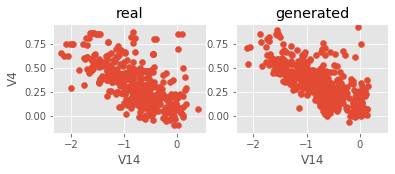

Iter: 66600; D loss: 1.278; G_loss: -0.6723; xgb_loss: 0.7236


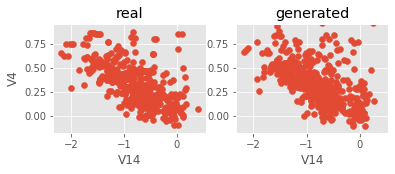

Iter: 66700; D loss: 1.294; G_loss: -0.6861; xgb_loss: 0.7358


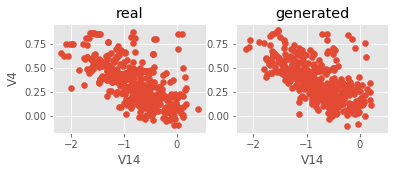

Iter: 66800; D loss: 1.288; G_loss: -0.691; xgb_loss: 0.7114


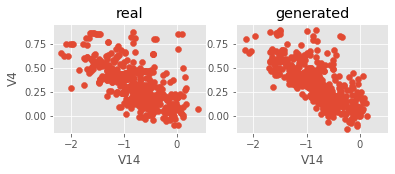

Iter: 66900; D loss: 1.298; G_loss: -0.6782; xgb_loss: 0.689


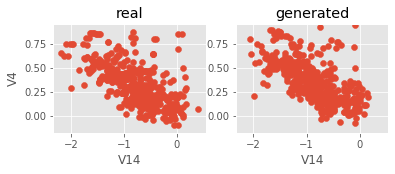

Iter: 67000; D loss: 1.306; G_loss: -0.6661; xgb_loss: 0.7195


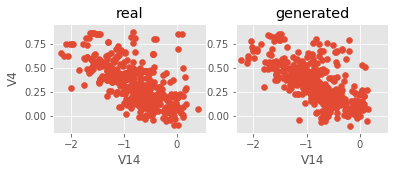

Iter: 67100; D loss: 1.282; G_loss: -0.6794; xgb_loss: 0.7276


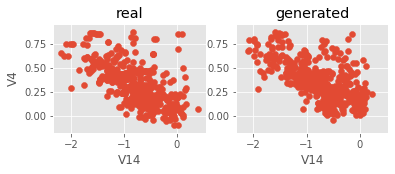

Iter: 67200; D loss: 1.304; G_loss: -0.6949; xgb_loss: 0.6951


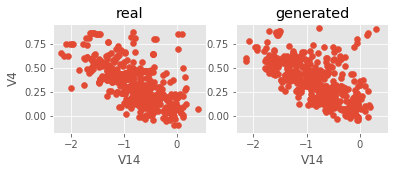

Iter: 67300; D loss: 1.296; G_loss: -0.6693; xgb_loss: 0.7012


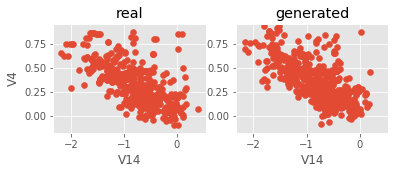

Iter: 67400; D loss: 1.292; G_loss: -0.6651; xgb_loss: 0.7256


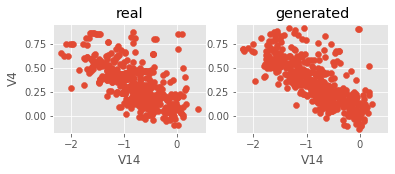

Iter: 67500; D loss: 1.302; G_loss: -0.6851; xgb_loss: 0.6687


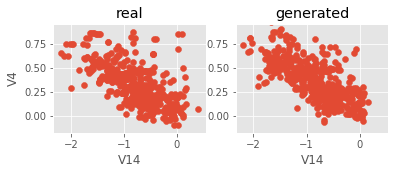

Iter: 67600; D loss: 1.296; G_loss: -0.6771; xgb_loss: 0.689


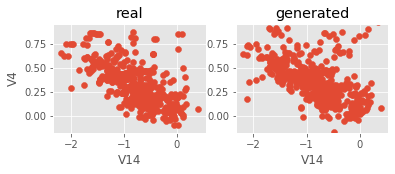

Iter: 67700; D loss: 1.313; G_loss: -0.6492; xgb_loss: 0.7358


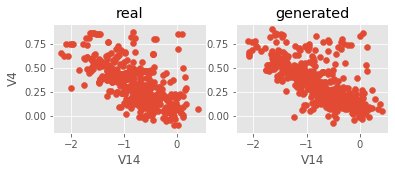

Iter: 67800; D loss: 1.307; G_loss: -0.6375; xgb_loss: 0.689


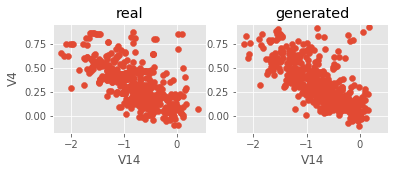

Iter: 67900; D loss: 1.299; G_loss: -0.6543; xgb_loss: 0.7236


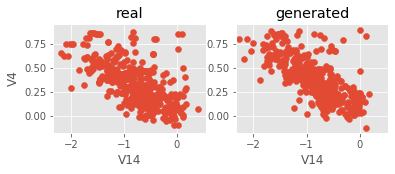

Iter: 68000; D loss: 1.323; G_loss: -0.6395; xgb_loss: 0.6687


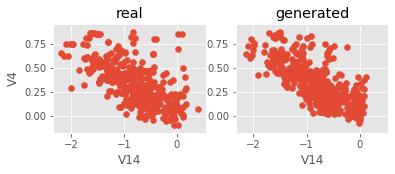

Iter: 68100; D loss: 1.316; G_loss: -0.6384; xgb_loss: 0.7419


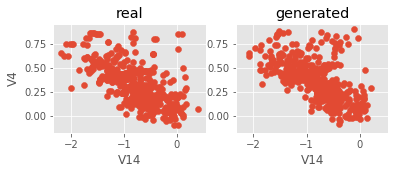

Iter: 68200; D loss: 1.325; G_loss: -0.6517; xgb_loss: 0.7297


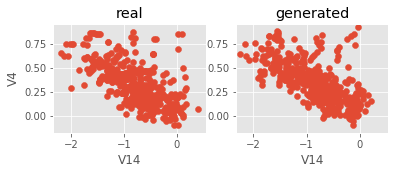

Iter: 68300; D loss: 1.328; G_loss: -0.6447; xgb_loss: 0.7154


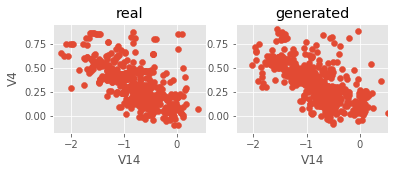

Iter: 68400; D loss: 1.297; G_loss: -0.6571; xgb_loss: 0.7276


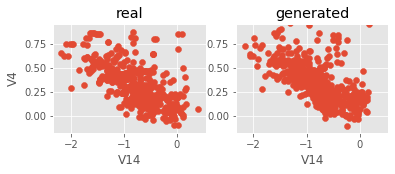

Iter: 68500; D loss: 1.325; G_loss: -0.6541; xgb_loss: 0.6565


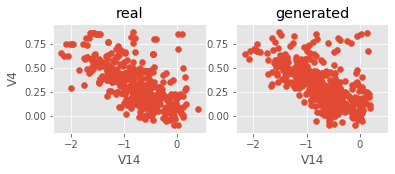

Iter: 68600; D loss: 1.347; G_loss: -0.6428; xgb_loss: 0.6606


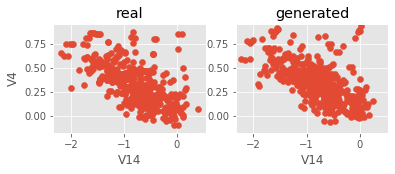

Iter: 68700; D loss: 1.299; G_loss: -0.6572; xgb_loss: 0.7317


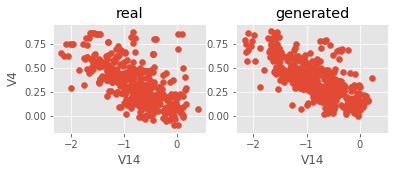

Iter: 68800; D loss: 1.328; G_loss: -0.6617; xgb_loss: 0.7134


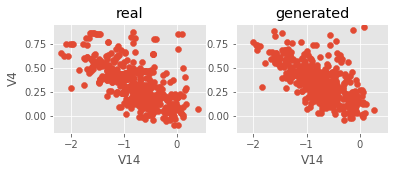

Iter: 68900; D loss: 1.307; G_loss: -0.6383; xgb_loss: 0.7195


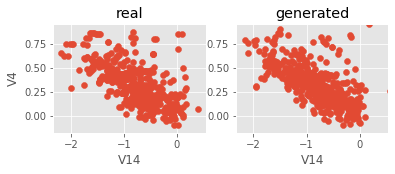

Iter: 69000; D loss: 1.297; G_loss: -0.6404; xgb_loss: 0.7154


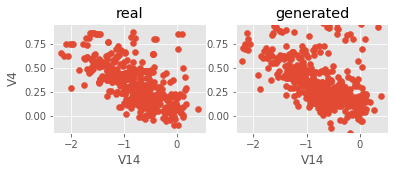

Iter: 69100; D loss: 1.309; G_loss: -0.6526; xgb_loss: 0.7154


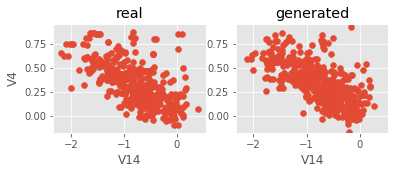

Iter: 69200; D loss: 1.329; G_loss: -0.6597; xgb_loss: 0.7256


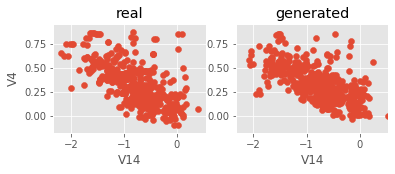

Iter: 69300; D loss: 1.287; G_loss: -0.6537; xgb_loss: 0.7398


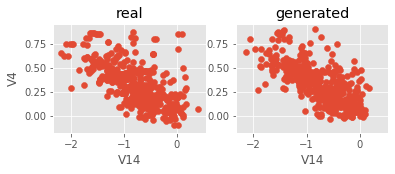

Iter: 69400; D loss: 1.321; G_loss: -0.635; xgb_loss: 0.6768


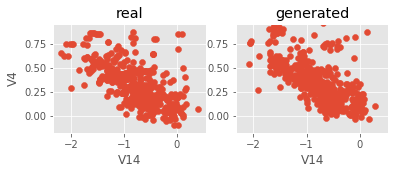

Iter: 69500; D loss: 1.317; G_loss: -0.6559; xgb_loss: 0.7134


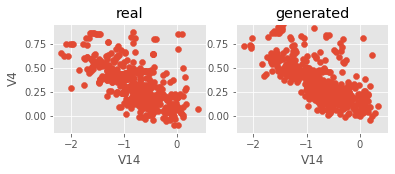

Iter: 69600; D loss: 1.299; G_loss: -0.6678; xgb_loss: 0.7703


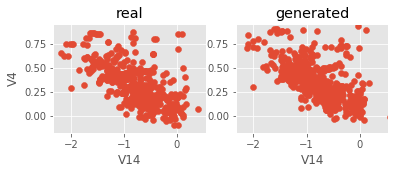

Iter: 69700; D loss: 1.304; G_loss: -0.6667; xgb_loss: 0.7134


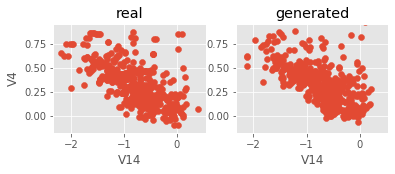

Iter: 69800; D loss: 1.315; G_loss: -0.6485; xgb_loss: 0.7276


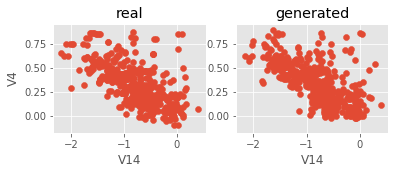

Iter: 69900; D loss: 1.32; G_loss: -0.6565; xgb_loss: 0.7439


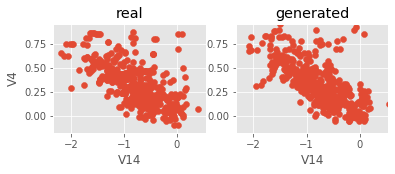

Iter: 70000; D loss: 1.321; G_loss: -0.6675; xgb_loss: 0.6992


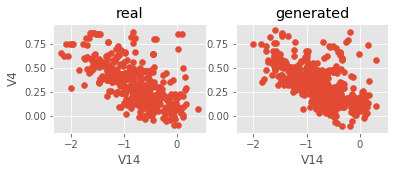

Iter: 70100; D loss: 1.297; G_loss: -0.6688; xgb_loss: 0.7093


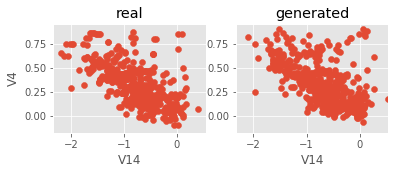

Iter: 70200; D loss: 1.326; G_loss: -0.6383; xgb_loss: 0.6972


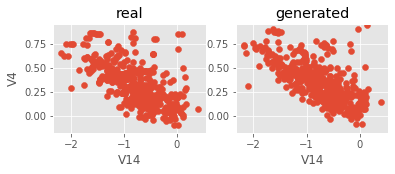

Iter: 70300; D loss: 1.305; G_loss: -0.6641; xgb_loss: 0.7114


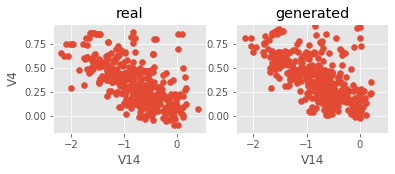

Iter: 70400; D loss: 1.313; G_loss: -0.6673; xgb_loss: 0.7256


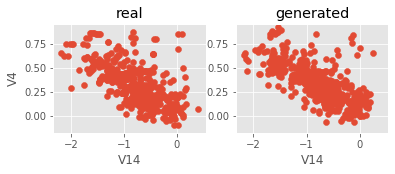

Iter: 70500; D loss: 1.295; G_loss: -0.6522; xgb_loss: 0.7154


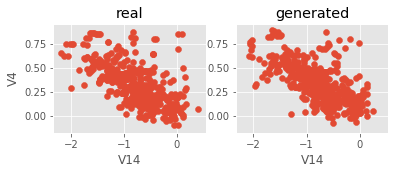

Iter: 70600; D loss: 1.307; G_loss: -0.6685; xgb_loss: 0.7236


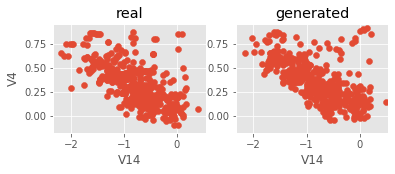

Iter: 70700; D loss: 1.305; G_loss: -0.669; xgb_loss: 0.7236


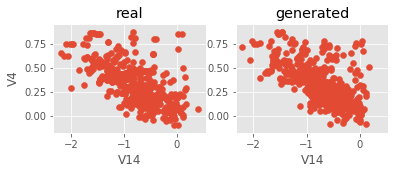

Iter: 70800; D loss: 1.285; G_loss: -0.6507; xgb_loss: 0.7033


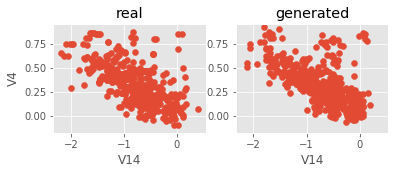

Iter: 70900; D loss: 1.309; G_loss: -0.6707; xgb_loss: 0.7114


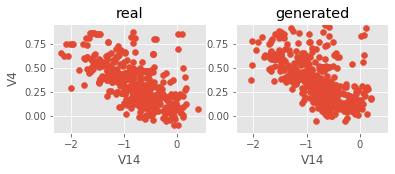

Iter: 71000; D loss: 1.305; G_loss: -0.6625; xgb_loss: 0.687


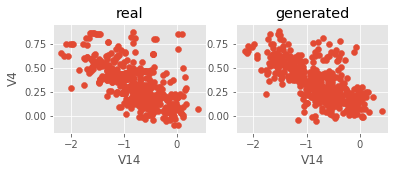

Iter: 71100; D loss: 1.306; G_loss: -0.6573; xgb_loss: 0.7805


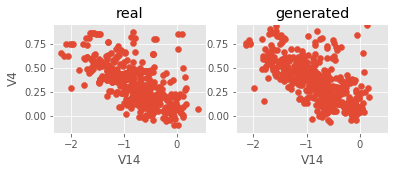

Iter: 71200; D loss: 1.305; G_loss: -0.6533; xgb_loss: 0.75


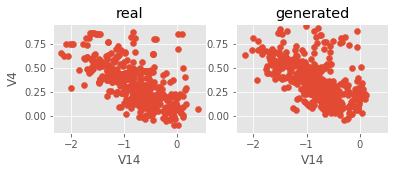

Iter: 71300; D loss: 1.29; G_loss: -0.6564; xgb_loss: 0.7541


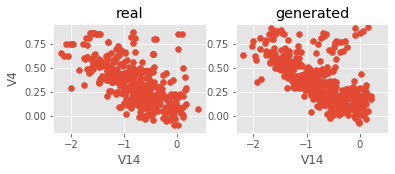

Iter: 71400; D loss: 1.327; G_loss: -0.6436; xgb_loss: 0.752


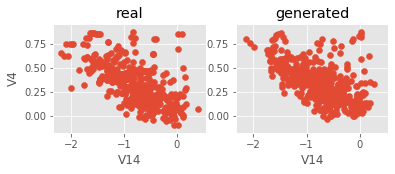

Iter: 71500; D loss: 1.31; G_loss: -0.6795; xgb_loss: 0.7825


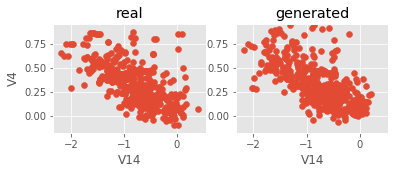

Iter: 71600; D loss: 1.301; G_loss: -0.6654; xgb_loss: 0.7683


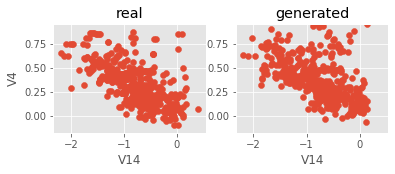

Iter: 71700; D loss: 1.303; G_loss: -0.671; xgb_loss: 0.7134


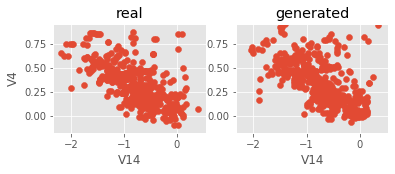

Iter: 71800; D loss: 1.304; G_loss: -0.6571; xgb_loss: 0.7093


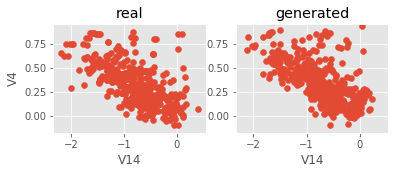

Iter: 71900; D loss: 1.307; G_loss: -0.679; xgb_loss: 0.6687


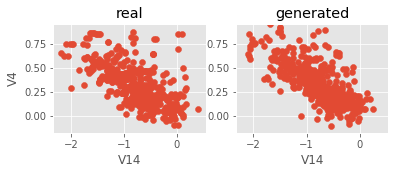

Iter: 72000; D loss: 1.29; G_loss: -0.6736; xgb_loss: 0.7154


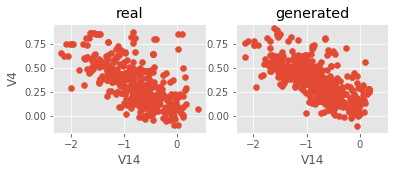

Iter: 72100; D loss: 1.298; G_loss: -0.6855; xgb_loss: 0.7114


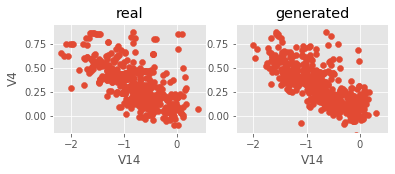

Iter: 72200; D loss: 1.289; G_loss: -0.6888; xgb_loss: 0.6931


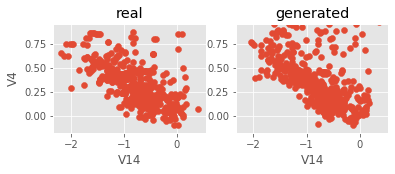

Iter: 72300; D loss: 1.305; G_loss: -0.6739; xgb_loss: 0.748


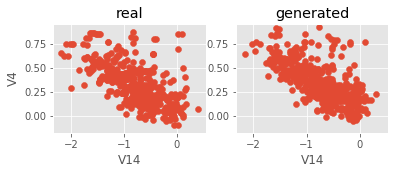

Iter: 72400; D loss: 1.308; G_loss: -0.6694; xgb_loss: 0.7215


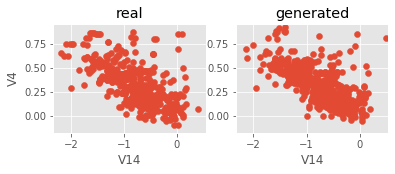

Iter: 72500; D loss: 1.308; G_loss: -0.667; xgb_loss: 0.7337


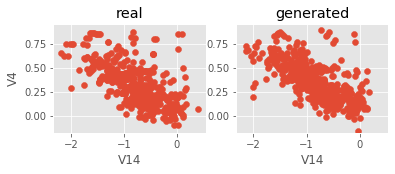

Iter: 72600; D loss: 1.287; G_loss: -0.6786; xgb_loss: 0.7317


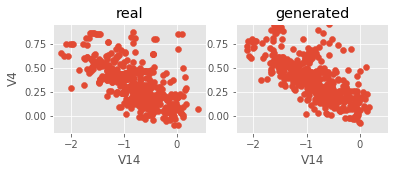

Iter: 72700; D loss: 1.286; G_loss: -0.6817; xgb_loss: 0.6992


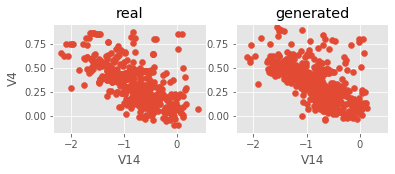

Iter: 72800; D loss: 1.31; G_loss: -0.6886; xgb_loss: 0.7134


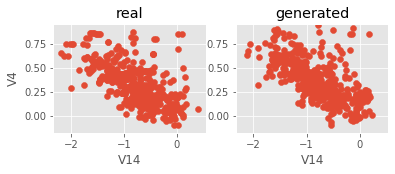

Iter: 72900; D loss: 1.29; G_loss: -0.6805; xgb_loss: 0.7419


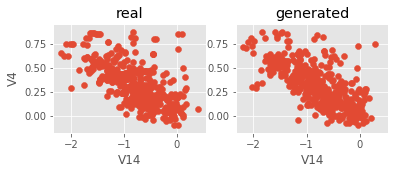

Iter: 73000; D loss: 1.302; G_loss: -0.6668; xgb_loss: 0.7053


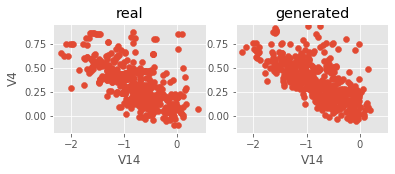

Iter: 73100; D loss: 1.285; G_loss: -0.6659; xgb_loss: 0.7622


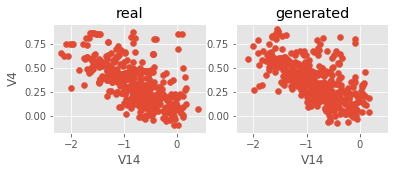

Iter: 73200; D loss: 1.295; G_loss: -0.6587; xgb_loss: 0.7378


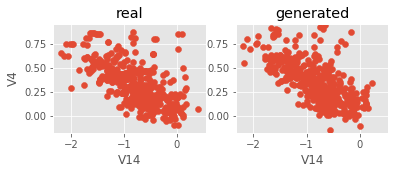

Iter: 73300; D loss: 1.294; G_loss: -0.6637; xgb_loss: 0.7175


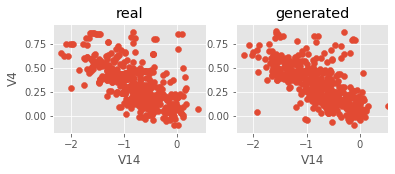

Iter: 73400; D loss: 1.295; G_loss: -0.6691; xgb_loss: 0.7154


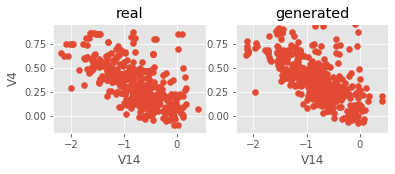

Iter: 73500; D loss: 1.301; G_loss: -0.6821; xgb_loss: 0.7358


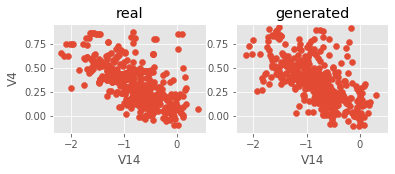

Iter: 73600; D loss: 1.3; G_loss: -0.6664; xgb_loss: 0.7744


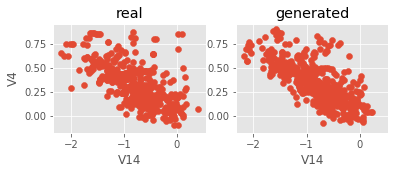

Iter: 73700; D loss: 1.306; G_loss: -0.6715; xgb_loss: 0.6931


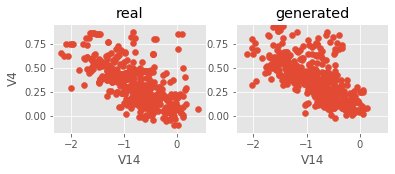

Iter: 73800; D loss: 1.311; G_loss: -0.654; xgb_loss: 0.685


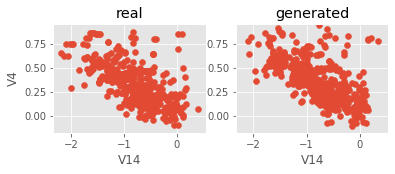

Iter: 73900; D loss: 1.31; G_loss: -0.6466; xgb_loss: 0.6972


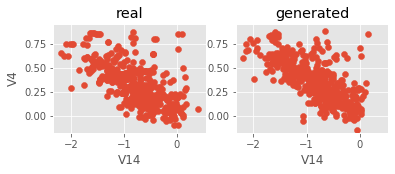

Iter: 74000; D loss: 1.32; G_loss: -0.6421; xgb_loss: 0.6809


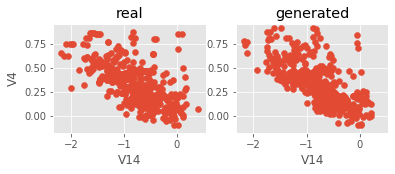

Iter: 74100; D loss: 1.319; G_loss: -0.6381; xgb_loss: 0.7439


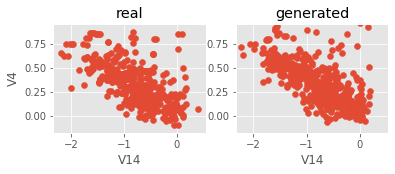

Iter: 74200; D loss: 1.307; G_loss: -0.6805; xgb_loss: 0.7053


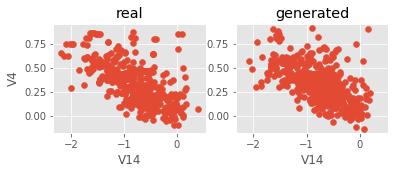

Iter: 74300; D loss: 1.298; G_loss: -0.673; xgb_loss: 0.7337


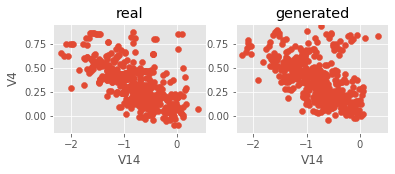

Iter: 74400; D loss: 1.29; G_loss: -0.6539; xgb_loss: 0.7154


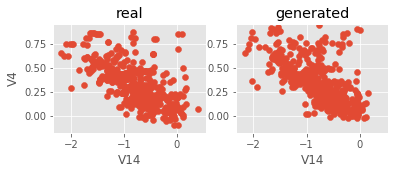

Iter: 74500; D loss: 1.315; G_loss: -0.6457; xgb_loss: 0.7073


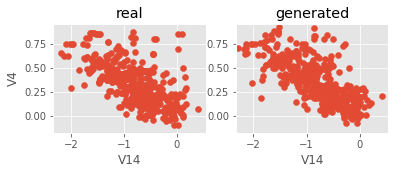

Iter: 74600; D loss: 1.312; G_loss: -0.6562; xgb_loss: 0.6606


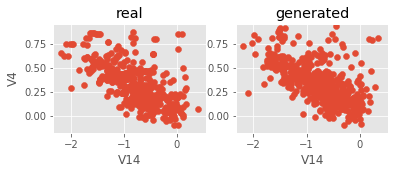

Iter: 74700; D loss: 1.349; G_loss: -0.643; xgb_loss: 0.7297


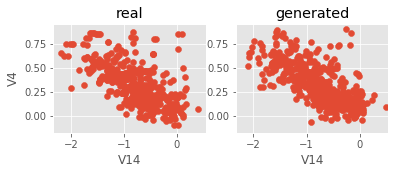

Iter: 74800; D loss: 1.316; G_loss: -0.6658; xgb_loss: 0.7073


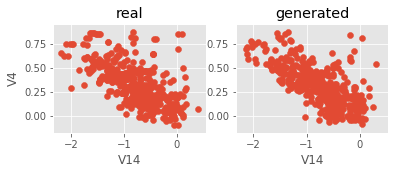

Iter: 74900; D loss: 1.301; G_loss: -0.6491; xgb_loss: 0.6667


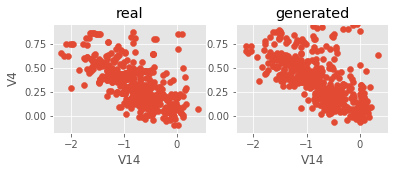

Iter: 75000; D loss: 1.31; G_loss: -0.6673; xgb_loss: 0.7317


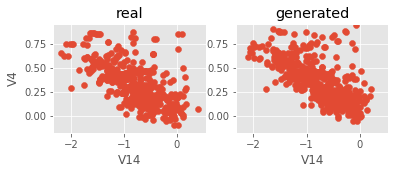

Iter: 75100; D loss: 1.335; G_loss: -0.6562; xgb_loss: 0.7256


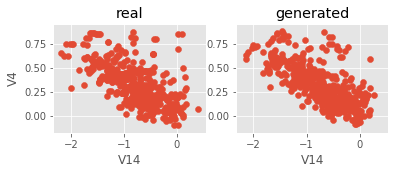

Iter: 75200; D loss: 1.318; G_loss: -0.6505; xgb_loss: 0.7195


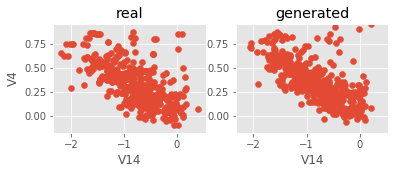

Iter: 75300; D loss: 1.31; G_loss: -0.6451; xgb_loss: 0.6972


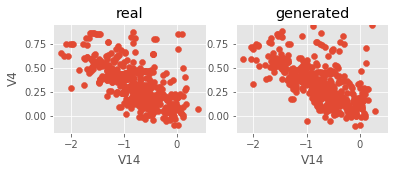

Iter: 75400; D loss: 1.344; G_loss: -0.6602; xgb_loss: 0.7073


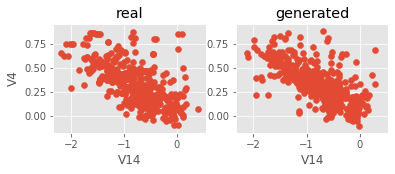

Iter: 75500; D loss: 1.315; G_loss: -0.6668; xgb_loss: 0.7337


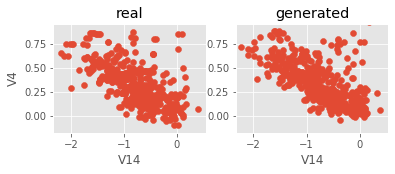

Iter: 75600; D loss: 1.304; G_loss: -0.678; xgb_loss: 0.689


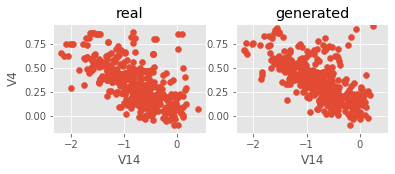

Iter: 75700; D loss: 1.315; G_loss: -0.662; xgb_loss: 0.7175


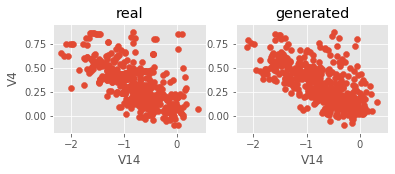

Iter: 75800; D loss: 1.31; G_loss: -0.6229; xgb_loss: 0.7358


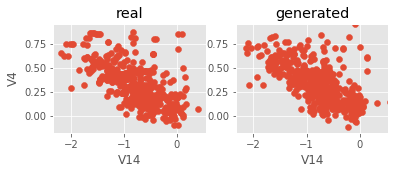

Iter: 75900; D loss: 1.334; G_loss: -0.6566; xgb_loss: 0.7215


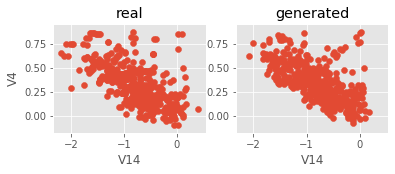

Iter: 76000; D loss: 1.31; G_loss: -0.6644; xgb_loss: 0.7276


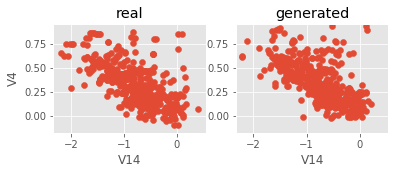

Iter: 76100; D loss: 1.308; G_loss: -0.6579; xgb_loss: 0.6931


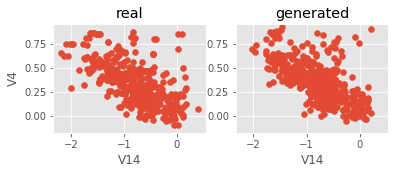

Iter: 76200; D loss: 1.312; G_loss: -0.6711; xgb_loss: 0.7541


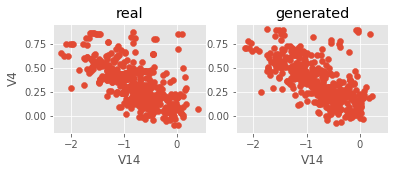

Iter: 76300; D loss: 1.312; G_loss: -0.6711; xgb_loss: 0.7053


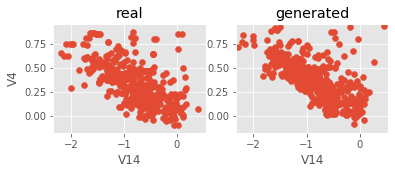

Iter: 76400; D loss: 1.306; G_loss: -0.6452; xgb_loss: 0.7053


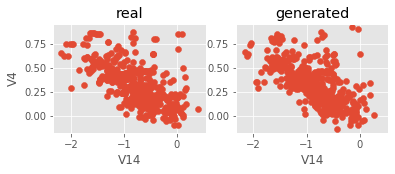

Iter: 76500; D loss: 1.301; G_loss: -0.662; xgb_loss: 0.7378


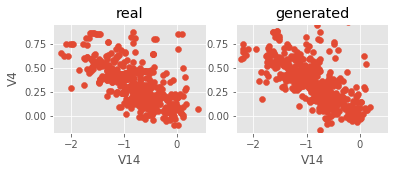

Iter: 76600; D loss: 1.323; G_loss: -0.6631; xgb_loss: 0.7297


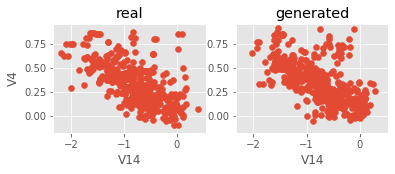

Iter: 76700; D loss: 1.301; G_loss: -0.6626; xgb_loss: 0.7236


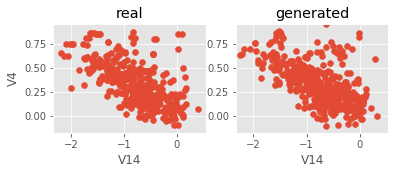

Iter: 76800; D loss: 1.307; G_loss: -0.6438; xgb_loss: 0.7724


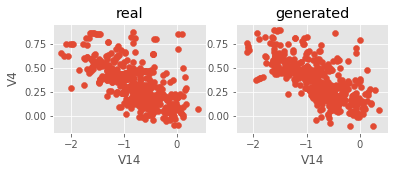

Iter: 76900; D loss: 1.314; G_loss: -0.6604; xgb_loss: 0.7033


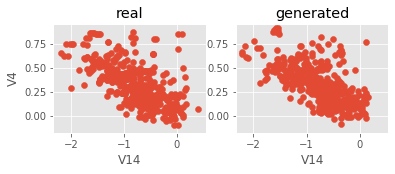

Iter: 77000; D loss: 1.309; G_loss: -0.6724; xgb_loss: 0.6707


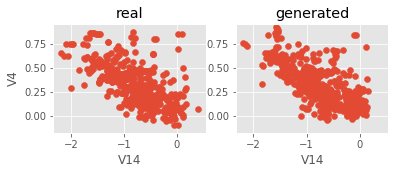

Iter: 77100; D loss: 1.31; G_loss: -0.6641; xgb_loss: 0.7053


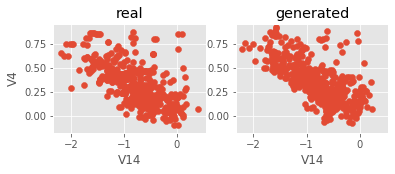

Iter: 77200; D loss: 1.296; G_loss: -0.665; xgb_loss: 0.7378


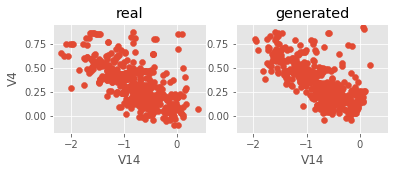

Iter: 77300; D loss: 1.296; G_loss: -0.6683; xgb_loss: 0.6809


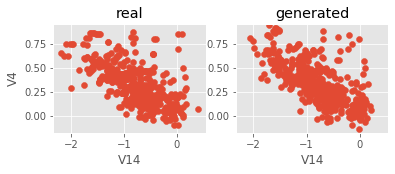

Iter: 77400; D loss: 1.293; G_loss: -0.6609; xgb_loss: 0.7093


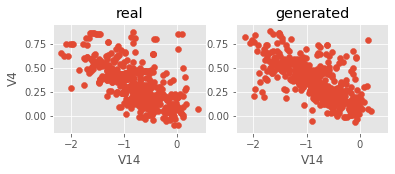

Iter: 77500; D loss: 1.306; G_loss: -0.6272; xgb_loss: 0.7337


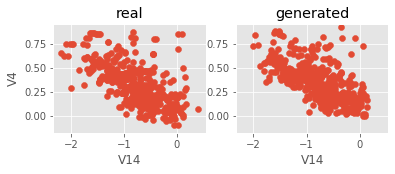

Iter: 77600; D loss: 1.305; G_loss: -0.6592; xgb_loss: 0.6972


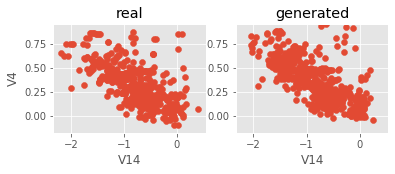

Iter: 77700; D loss: 1.283; G_loss: -0.655; xgb_loss: 0.7276


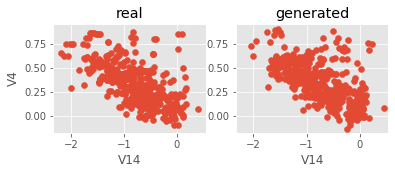

Iter: 77800; D loss: 1.304; G_loss: -0.6485; xgb_loss: 0.7175


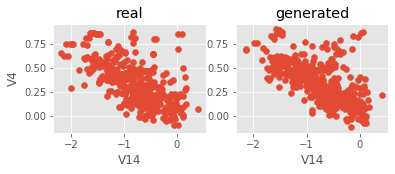

Iter: 77900; D loss: 1.301; G_loss: -0.6783; xgb_loss: 0.6951


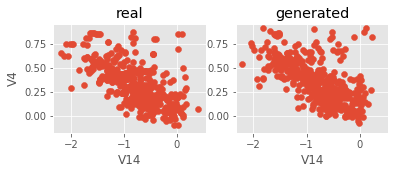

Iter: 78000; D loss: 1.313; G_loss: -0.6539; xgb_loss: 0.7419


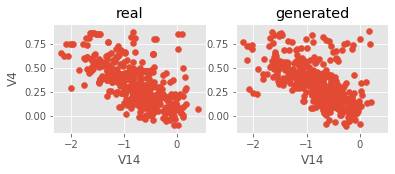

Iter: 78100; D loss: 1.316; G_loss: -0.6641; xgb_loss: 0.7683


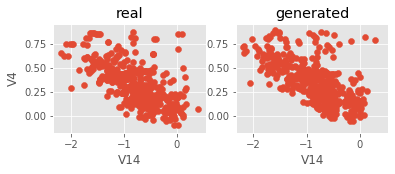

Iter: 78200; D loss: 1.296; G_loss: -0.6792; xgb_loss: 0.7195


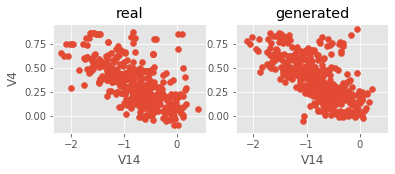

Iter: 78300; D loss: 1.308; G_loss: -0.6752; xgb_loss: 0.6931


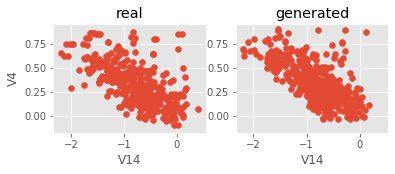

Iter: 78400; D loss: 1.3; G_loss: -0.6609; xgb_loss: 0.6748


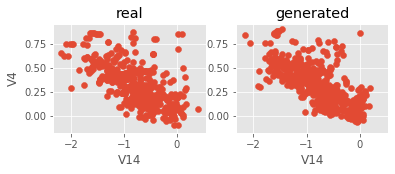

Iter: 78500; D loss: 1.315; G_loss: -0.6667; xgb_loss: 0.6829


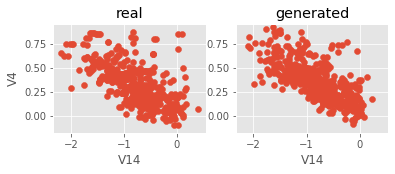

Iter: 78600; D loss: 1.3; G_loss: -0.6779; xgb_loss: 0.687


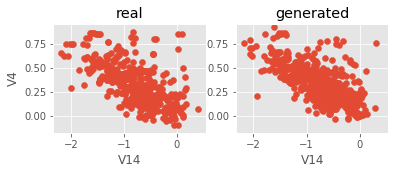

Iter: 78700; D loss: 1.315; G_loss: -0.6605; xgb_loss: 0.7317


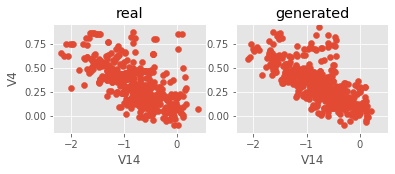

Iter: 78800; D loss: 1.293; G_loss: -0.6634; xgb_loss: 0.687


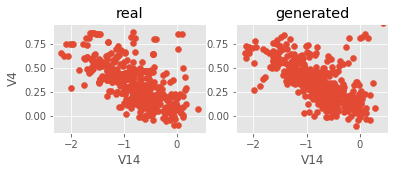

Iter: 78900; D loss: 1.313; G_loss: -0.6881; xgb_loss: 0.6829


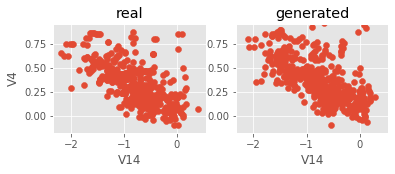

Iter: 79000; D loss: 1.302; G_loss: -0.6731; xgb_loss: 0.7378


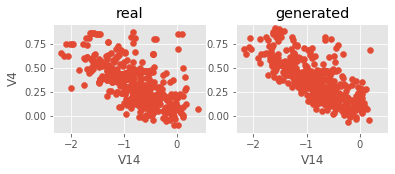

Iter: 79100; D loss: 1.286; G_loss: -0.6541; xgb_loss: 0.7093


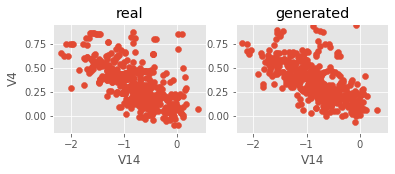

Iter: 79200; D loss: 1.307; G_loss: -0.6747; xgb_loss: 0.7256


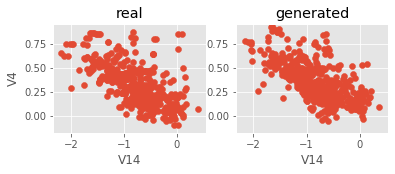

Iter: 79300; D loss: 1.312; G_loss: -0.7028; xgb_loss: 0.748


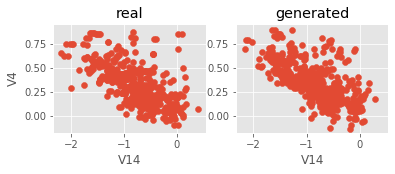

Iter: 79400; D loss: 1.291; G_loss: -0.6815; xgb_loss: 0.7663


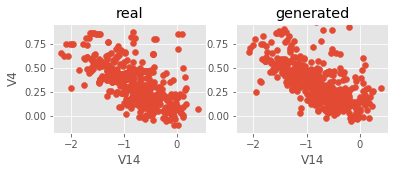

Iter: 79500; D loss: 1.272; G_loss: -0.6885; xgb_loss: 0.7358


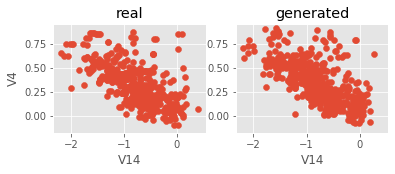

Iter: 79600; D loss: 1.308; G_loss: -0.6827; xgb_loss: 0.6931


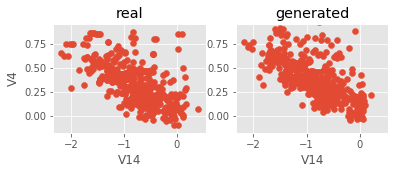

Iter: 79700; D loss: 1.279; G_loss: -0.6884; xgb_loss: 0.7195


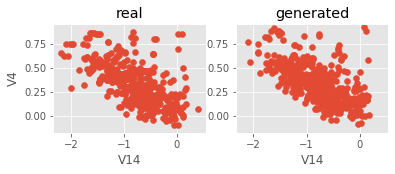

Iter: 79800; D loss: 1.309; G_loss: -0.6552; xgb_loss: 0.689


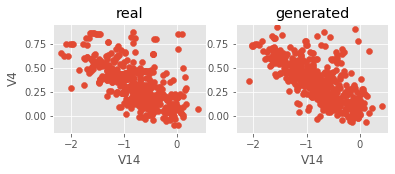

Iter: 79900; D loss: 1.307; G_loss: -0.6474; xgb_loss: 0.6646


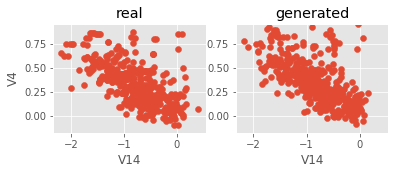

Iter: 80000; D loss: 1.324; G_loss: -0.6566; xgb_loss: 0.6992


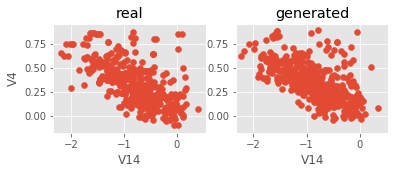

Iter: 80100; D loss: 1.312; G_loss: -0.644; xgb_loss: 0.6768


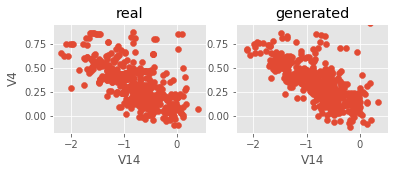

Iter: 80200; D loss: 1.321; G_loss: -0.639; xgb_loss: 0.7276


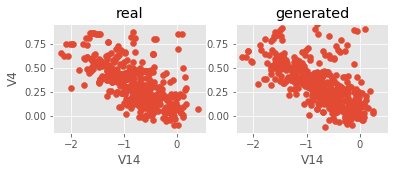

Iter: 80300; D loss: 1.331; G_loss: -0.6583; xgb_loss: 0.752


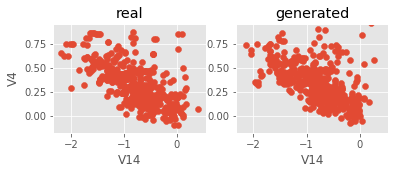

Iter: 80400; D loss: 1.301; G_loss: -0.6574; xgb_loss: 0.685


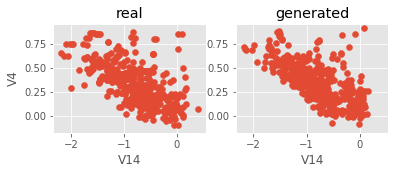

Iter: 80500; D loss: 1.31; G_loss: -0.6642; xgb_loss: 0.7114


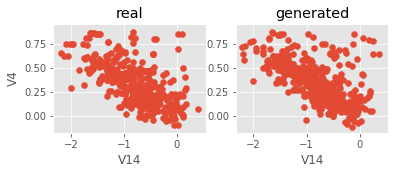

Iter: 80600; D loss: 1.302; G_loss: -0.6592; xgb_loss: 0.7175


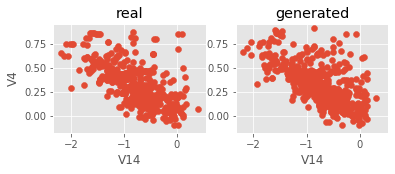

Iter: 80700; D loss: 1.299; G_loss: -0.6697; xgb_loss: 0.6687


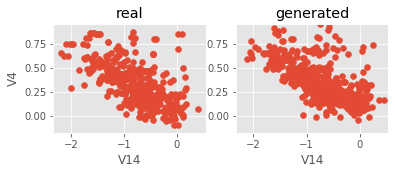

Iter: 80800; D loss: 1.327; G_loss: -0.6711; xgb_loss: 0.7297


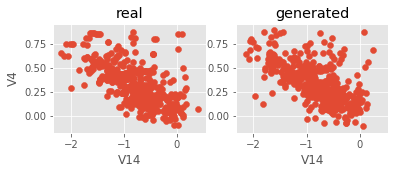

Iter: 80900; D loss: 1.317; G_loss: -0.6688; xgb_loss: 0.6911


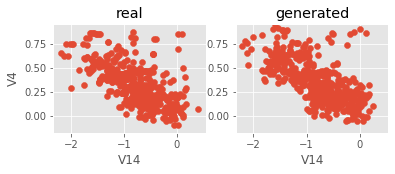

Iter: 81000; D loss: 1.329; G_loss: -0.6549; xgb_loss: 0.6992


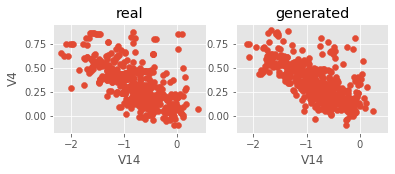

Iter: 81100; D loss: 1.317; G_loss: -0.6607; xgb_loss: 0.6687


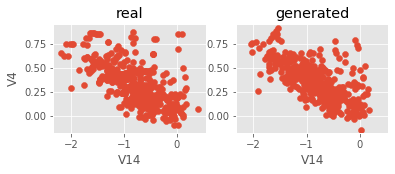

Iter: 81200; D loss: 1.302; G_loss: -0.6721; xgb_loss: 0.7215


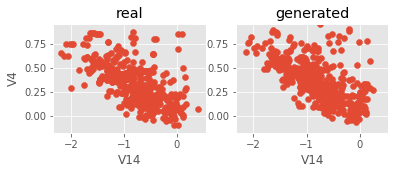

Iter: 81300; D loss: 1.309; G_loss: -0.6555; xgb_loss: 0.687


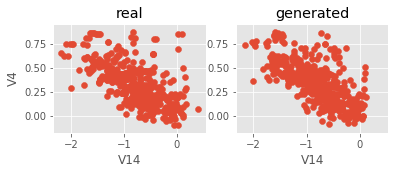

Iter: 81400; D loss: 1.332; G_loss: -0.6548; xgb_loss: 0.7154


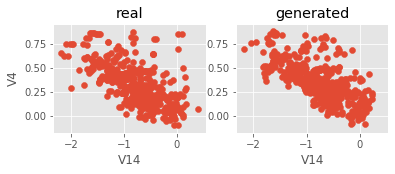

Iter: 81500; D loss: 1.321; G_loss: -0.6537; xgb_loss: 0.7175


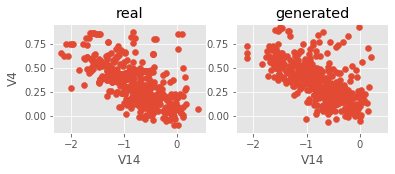

Iter: 81600; D loss: 1.328; G_loss: -0.6577; xgb_loss: 0.7033


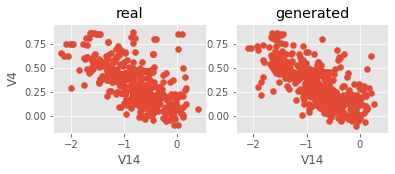

Iter: 81700; D loss: 1.317; G_loss: -0.6771; xgb_loss: 0.7033


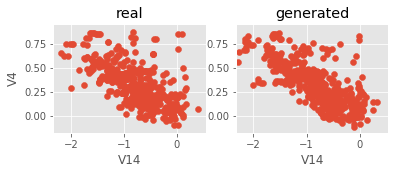

Iter: 81800; D loss: 1.321; G_loss: -0.6268; xgb_loss: 0.687


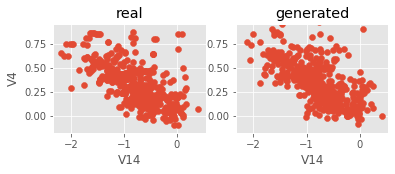

Iter: 81900; D loss: 1.316; G_loss: -0.6462; xgb_loss: 0.7439


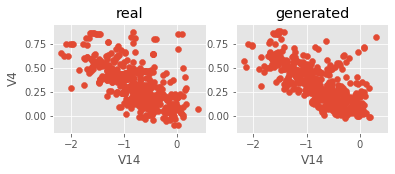

Iter: 82000; D loss: 1.311; G_loss: -0.6235; xgb_loss: 0.7134


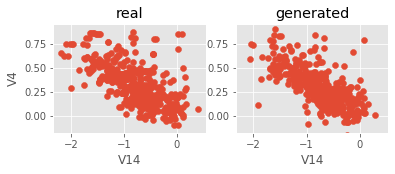

Iter: 82100; D loss: 1.329; G_loss: -0.6848; xgb_loss: 0.6809


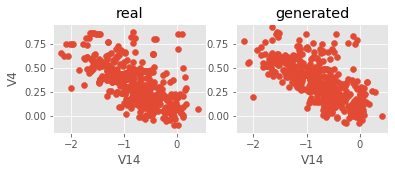

Iter: 82200; D loss: 1.3; G_loss: -0.6641; xgb_loss: 0.6931


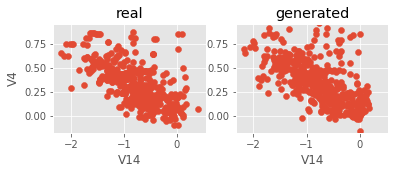

Iter: 82300; D loss: 1.309; G_loss: -0.6517; xgb_loss: 0.6748


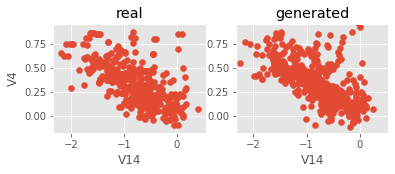

Iter: 82400; D loss: 1.305; G_loss: -0.6569; xgb_loss: 0.7093


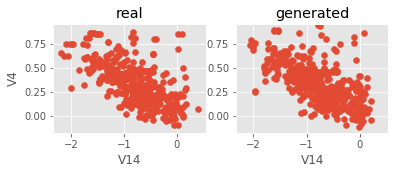

Iter: 82500; D loss: 1.301; G_loss: -0.6531; xgb_loss: 0.7337


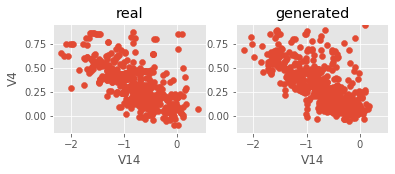

Iter: 82600; D loss: 1.291; G_loss: -0.6536; xgb_loss: 0.6809


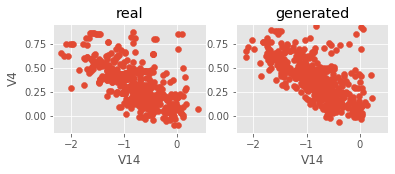

Iter: 82700; D loss: 1.323; G_loss: -0.6463; xgb_loss: 0.6951


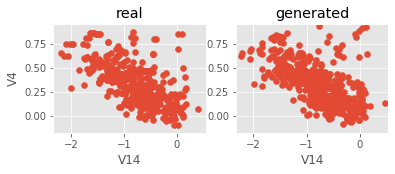

Iter: 82800; D loss: 1.316; G_loss: -0.659; xgb_loss: 0.7236


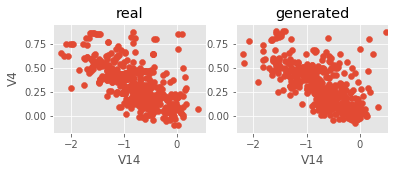

Iter: 82900; D loss: 1.322; G_loss: -0.6806; xgb_loss: 0.748


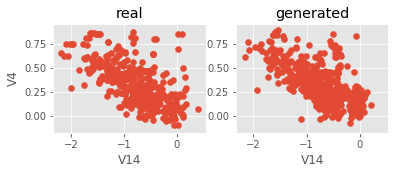

Iter: 83000; D loss: 1.315; G_loss: -0.673; xgb_loss: 0.7236


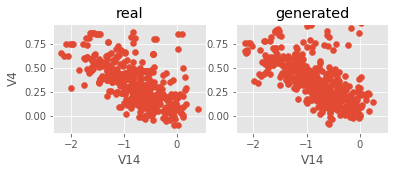

Iter: 83100; D loss: 1.321; G_loss: -0.6572; xgb_loss: 0.7012


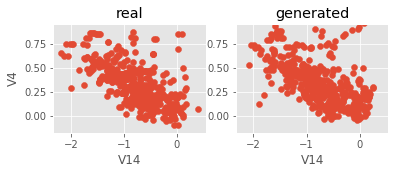

Iter: 83200; D loss: 1.291; G_loss: -0.6661; xgb_loss: 0.7276


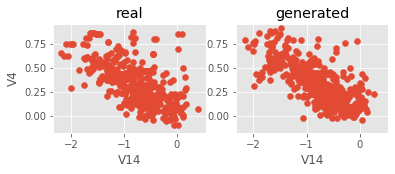

Iter: 83300; D loss: 1.313; G_loss: -0.673; xgb_loss: 0.6768


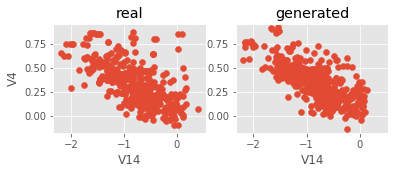

Iter: 83400; D loss: 1.308; G_loss: -0.656; xgb_loss: 0.7154


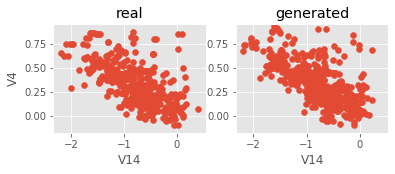

Iter: 83500; D loss: 1.296; G_loss: -0.6919; xgb_loss: 0.7012


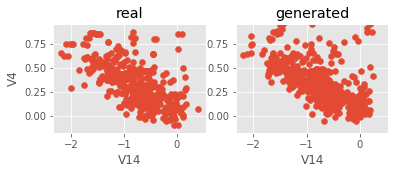

Iter: 83600; D loss: 1.317; G_loss: -0.6693; xgb_loss: 0.7053


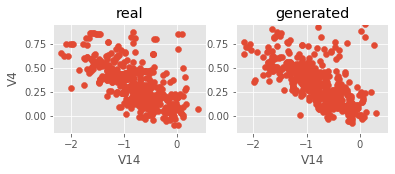

Iter: 83700; D loss: 1.291; G_loss: -0.6761; xgb_loss: 0.7215


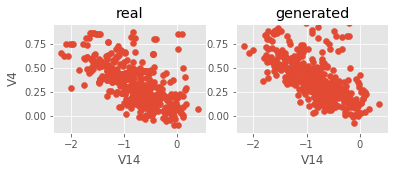

Iter: 83800; D loss: 1.32; G_loss: -0.6809; xgb_loss: 0.7378


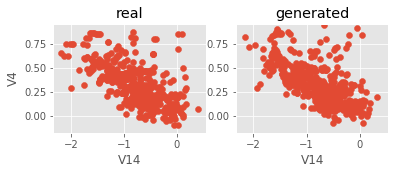

Iter: 83900; D loss: 1.313; G_loss: -0.6605; xgb_loss: 0.685


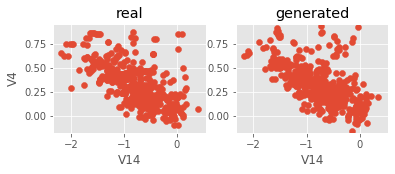

Iter: 84000; D loss: 1.329; G_loss: -0.6544; xgb_loss: 0.7134


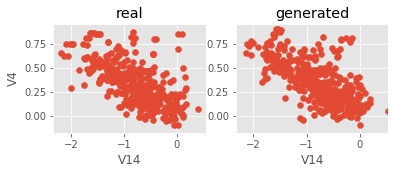

Iter: 84100; D loss: 1.304; G_loss: -0.6951; xgb_loss: 0.6626


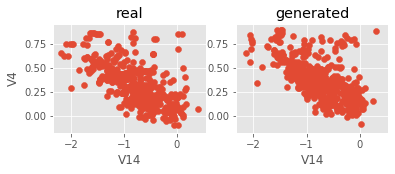

Iter: 84200; D loss: 1.319; G_loss: -0.6791; xgb_loss: 0.6646


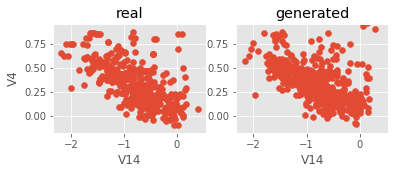

Iter: 84300; D loss: 1.312; G_loss: -0.6736; xgb_loss: 0.6789


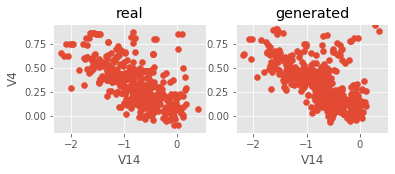

Iter: 84400; D loss: 1.316; G_loss: -0.654; xgb_loss: 0.685


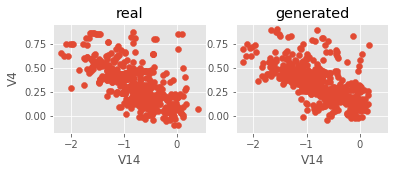

Iter: 84500; D loss: 1.321; G_loss: -0.6602; xgb_loss: 0.7073


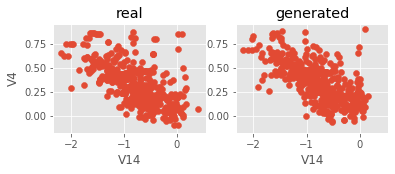

Iter: 84600; D loss: 1.315; G_loss: -0.6571; xgb_loss: 0.7195


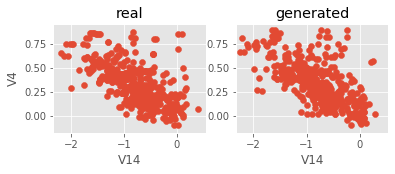

Iter: 84700; D loss: 1.309; G_loss: -0.666; xgb_loss: 0.7663


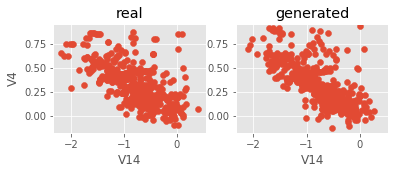

Iter: 84800; D loss: 1.301; G_loss: -0.6744; xgb_loss: 0.7419


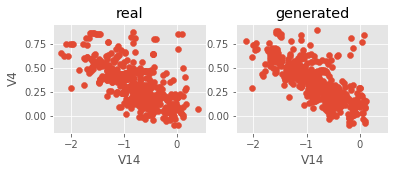

Iter: 84900; D loss: 1.285; G_loss: -0.6685; xgb_loss: 0.7276


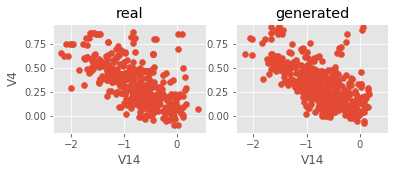

Iter: 85000; D loss: 1.289; G_loss: -0.6501; xgb_loss: 0.7114


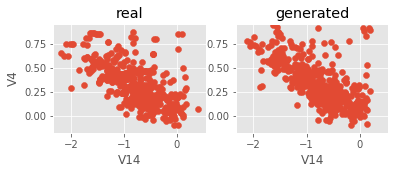

Iter: 85100; D loss: 1.301; G_loss: -0.6792; xgb_loss: 0.7195


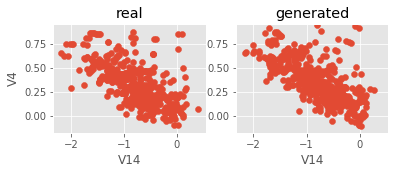

Iter: 85200; D loss: 1.289; G_loss: -0.6902; xgb_loss: 0.6748


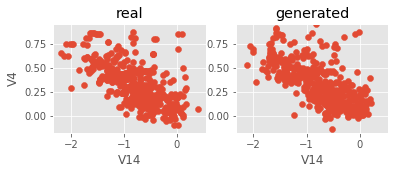

Iter: 85300; D loss: 1.318; G_loss: -0.6669; xgb_loss: 0.7703


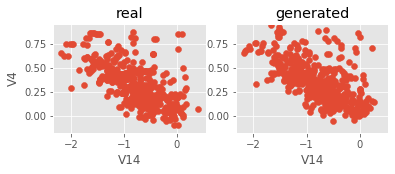

Iter: 85400; D loss: 1.309; G_loss: -0.7097; xgb_loss: 0.6829


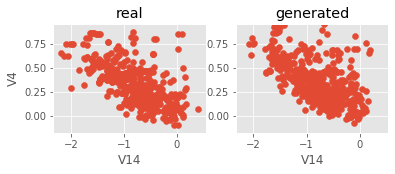

Iter: 85500; D loss: 1.311; G_loss: -0.676; xgb_loss: 0.7073


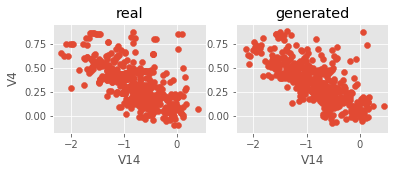

Iter: 85600; D loss: 1.305; G_loss: -0.6664; xgb_loss: 0.7236


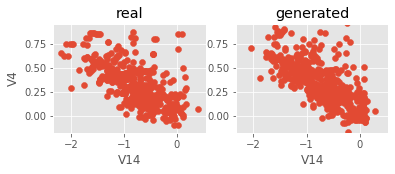

Iter: 85700; D loss: 1.297; G_loss: -0.672; xgb_loss: 0.6992


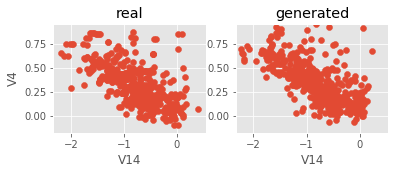

Iter: 85800; D loss: 1.31; G_loss: -0.6748; xgb_loss: 0.687


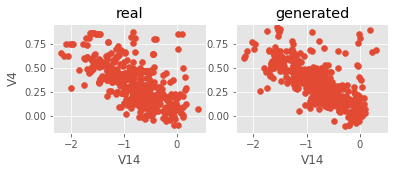

Iter: 85900; D loss: 1.292; G_loss: -0.6866; xgb_loss: 0.6809


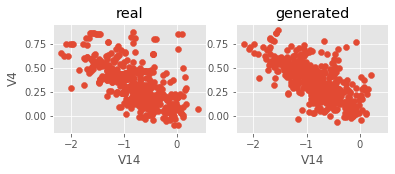

Iter: 86000; D loss: 1.306; G_loss: -0.6821; xgb_loss: 0.689


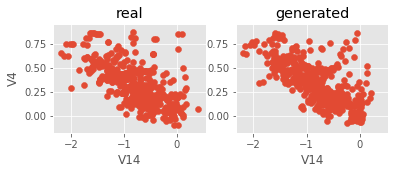

Iter: 86100; D loss: 1.319; G_loss: -0.6479; xgb_loss: 0.6748


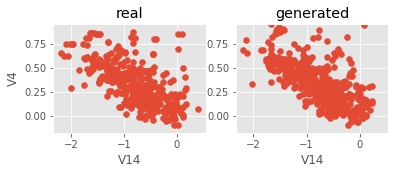

Iter: 86200; D loss: 1.305; G_loss: -0.6496; xgb_loss: 0.6992


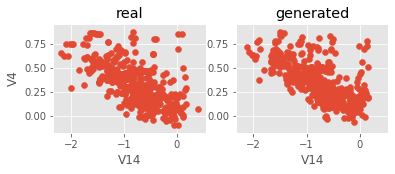

Iter: 86300; D loss: 1.309; G_loss: -0.6587; xgb_loss: 0.687


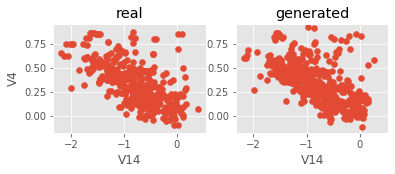

Iter: 86400; D loss: 1.314; G_loss: -0.6664; xgb_loss: 0.6667


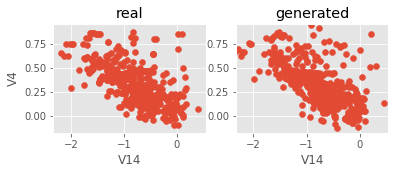

Iter: 86500; D loss: 1.298; G_loss: -0.6607; xgb_loss: 0.6728


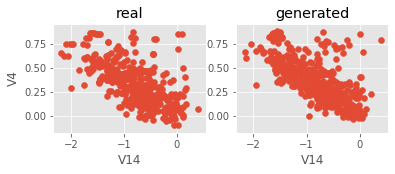

Iter: 86600; D loss: 1.307; G_loss: -0.6455; xgb_loss: 0.6911


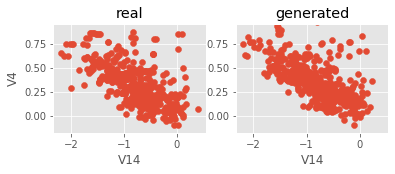

Iter: 86700; D loss: 1.295; G_loss: -0.6661; xgb_loss: 0.7093


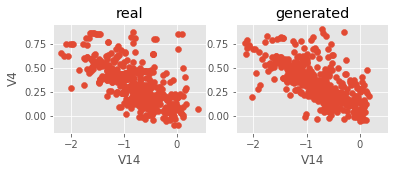

Iter: 86800; D loss: 1.324; G_loss: -0.6495; xgb_loss: 0.7317


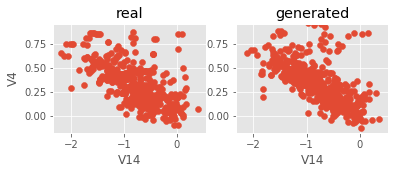

Iter: 86900; D loss: 1.313; G_loss: -0.6517; xgb_loss: 0.7033


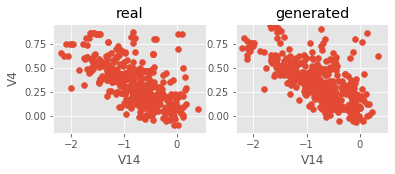

Iter: 87000; D loss: 1.332; G_loss: -0.6568; xgb_loss: 0.748


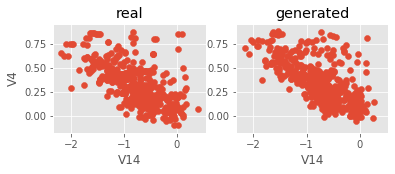

Iter: 87100; D loss: 1.303; G_loss: -0.6634; xgb_loss: 0.6585


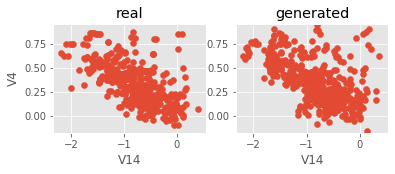

Iter: 87200; D loss: 1.31; G_loss: -0.6452; xgb_loss: 0.7297


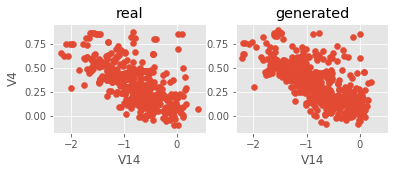

Iter: 87300; D loss: 1.305; G_loss: -0.6458; xgb_loss: 0.6951


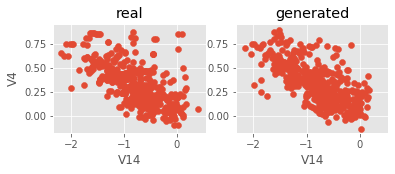

Iter: 87400; D loss: 1.307; G_loss: -0.643; xgb_loss: 0.7134


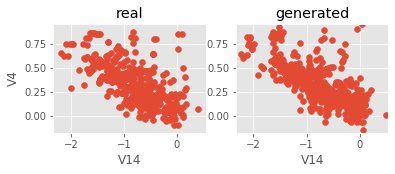

Iter: 87500; D loss: 1.321; G_loss: -0.6546; xgb_loss: 0.7175


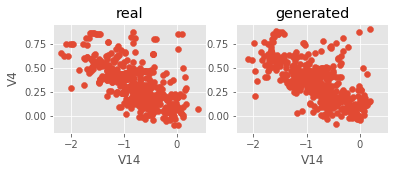

Iter: 87600; D loss: 1.312; G_loss: -0.6319; xgb_loss: 0.7398


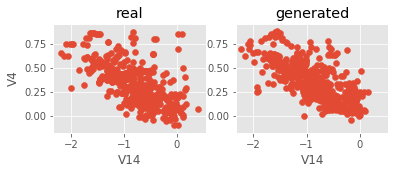

Iter: 87700; D loss: 1.316; G_loss: -0.6656; xgb_loss: 0.7378


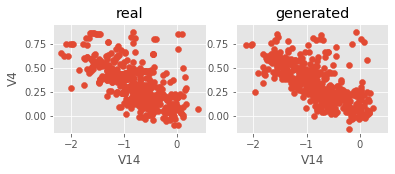

Iter: 87800; D loss: 1.317; G_loss: -0.6645; xgb_loss: 0.7398


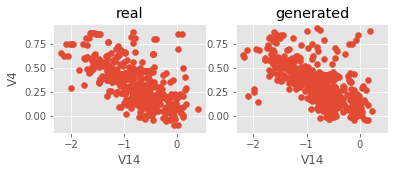

Iter: 87900; D loss: 1.306; G_loss: -0.6558; xgb_loss: 0.7195


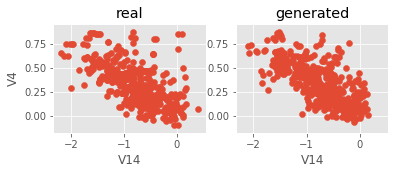

Iter: 88000; D loss: 1.341; G_loss: -0.6319; xgb_loss: 0.752


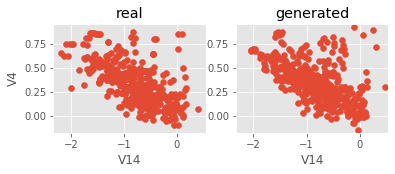

Iter: 88100; D loss: 1.318; G_loss: -0.6585; xgb_loss: 0.7053


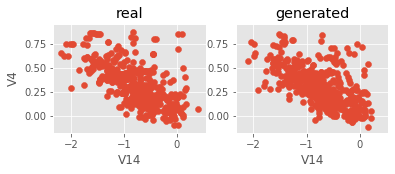

Iter: 88200; D loss: 1.306; G_loss: -0.6655; xgb_loss: 0.7276


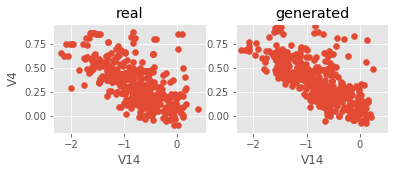

Iter: 88300; D loss: 1.293; G_loss: -0.6772; xgb_loss: 0.6301


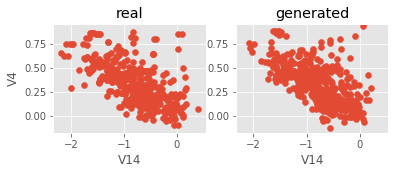

Iter: 88400; D loss: 1.319; G_loss: -0.6943; xgb_loss: 0.6931


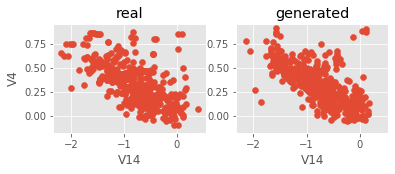

Iter: 88500; D loss: 1.328; G_loss: -0.6701; xgb_loss: 0.7053


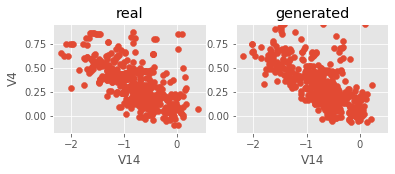

Iter: 88600; D loss: 1.317; G_loss: -0.6903; xgb_loss: 0.6972


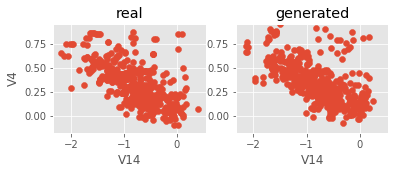

Iter: 88700; D loss: 1.317; G_loss: -0.6621; xgb_loss: 0.6972


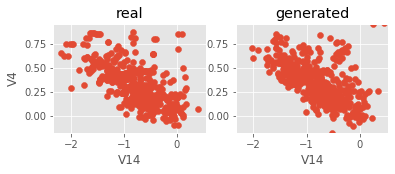

Iter: 88800; D loss: 1.312; G_loss: -0.6827; xgb_loss: 0.6707


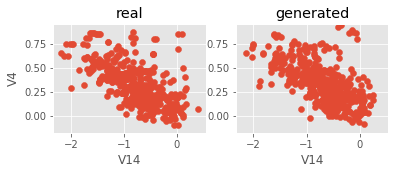

Iter: 88900; D loss: 1.308; G_loss: -0.6683; xgb_loss: 0.6768


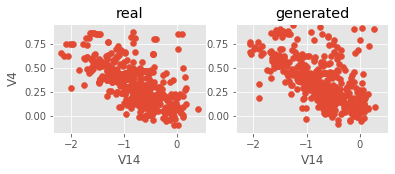

Iter: 89000; D loss: 1.298; G_loss: -0.6557; xgb_loss: 0.7154


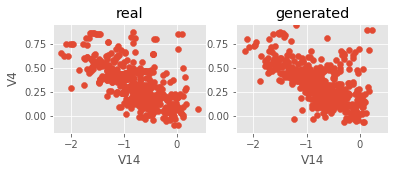

Iter: 89100; D loss: 1.301; G_loss: -0.6629; xgb_loss: 0.6911


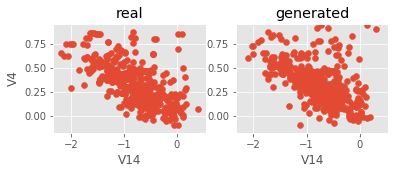

Iter: 89200; D loss: 1.314; G_loss: -0.6644; xgb_loss: 0.7073


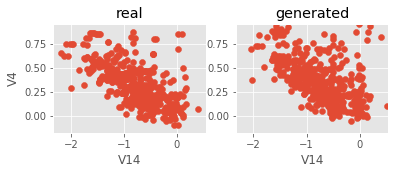

Iter: 89300; D loss: 1.291; G_loss: -0.6461; xgb_loss: 0.7154


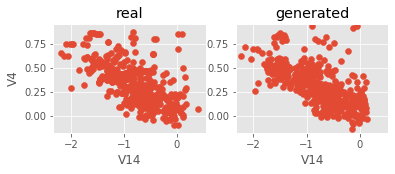

Iter: 89400; D loss: 1.32; G_loss: -0.6809; xgb_loss: 0.7215


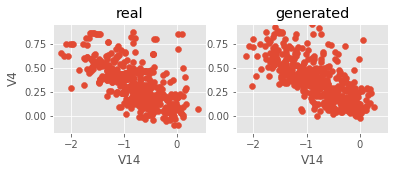

Iter: 89500; D loss: 1.306; G_loss: -0.6798; xgb_loss: 0.6646


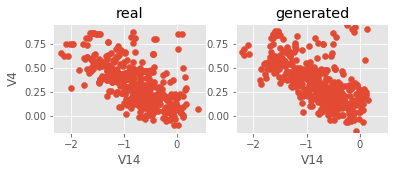

Iter: 89600; D loss: 1.303; G_loss: -0.6985; xgb_loss: 0.689


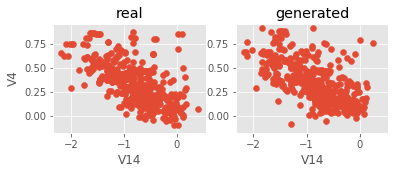

Iter: 89700; D loss: 1.293; G_loss: -0.6803; xgb_loss: 0.7073


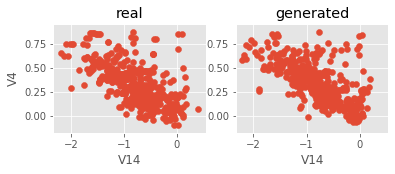

Iter: 89800; D loss: 1.303; G_loss: -0.6779; xgb_loss: 0.7012


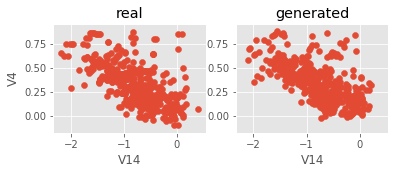

Iter: 89900; D loss: 1.316; G_loss: -0.6716; xgb_loss: 0.689


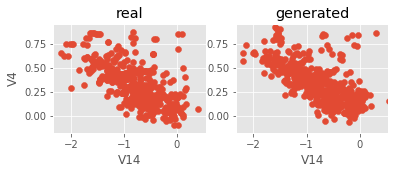

Iter: 90000; D loss: 1.306; G_loss: -0.6706; xgb_loss: 0.7195


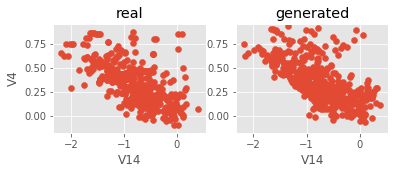

Iter: 90100; D loss: 1.325; G_loss: -0.6655; xgb_loss: 0.7317


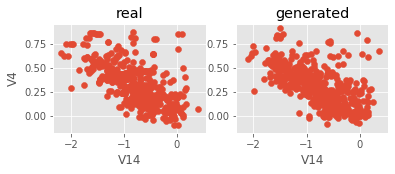

Iter: 90200; D loss: 1.3; G_loss: -0.6695; xgb_loss: 0.6585


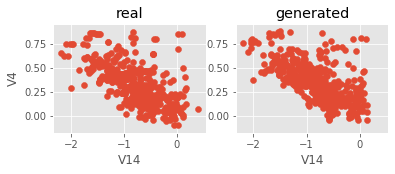

Iter: 90300; D loss: 1.318; G_loss: -0.656; xgb_loss: 0.7093


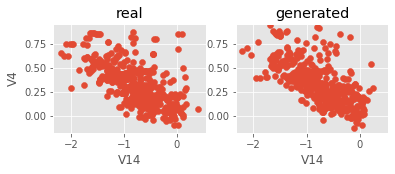

Iter: 90400; D loss: 1.3; G_loss: -0.6829; xgb_loss: 0.7215


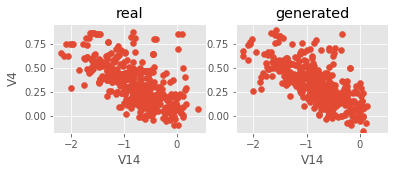

Iter: 90500; D loss: 1.311; G_loss: -0.671; xgb_loss: 0.7033


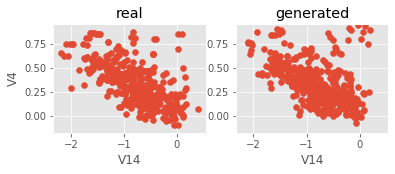

Iter: 90600; D loss: 1.312; G_loss: -0.6449; xgb_loss: 0.75


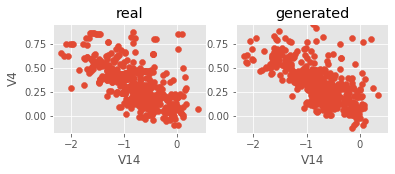

Iter: 90700; D loss: 1.311; G_loss: -0.6734; xgb_loss: 0.7317


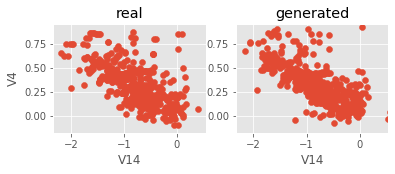

Iter: 90800; D loss: 1.298; G_loss: -0.6683; xgb_loss: 0.7114


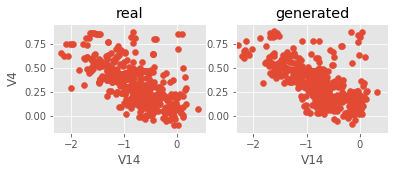

Iter: 90900; D loss: 1.306; G_loss: -0.6869; xgb_loss: 0.685


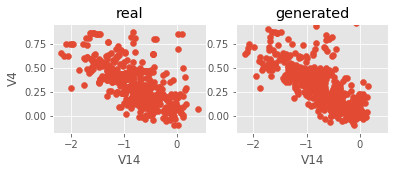

Iter: 91000; D loss: 1.295; G_loss: -0.6708; xgb_loss: 0.6911


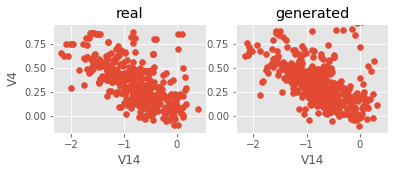

Iter: 91100; D loss: 1.302; G_loss: -0.6703; xgb_loss: 0.7195


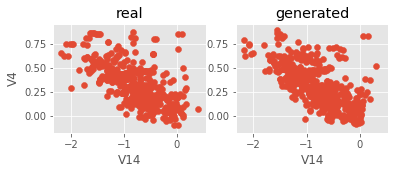

Iter: 91200; D loss: 1.308; G_loss: -0.6625; xgb_loss: 0.7175


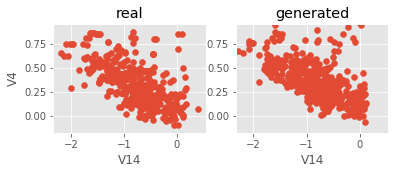

Iter: 91300; D loss: 1.307; G_loss: -0.6702; xgb_loss: 0.6829


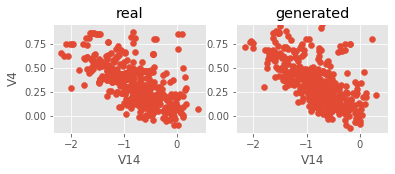

Iter: 91400; D loss: 1.316; G_loss: -0.6815; xgb_loss: 0.6931


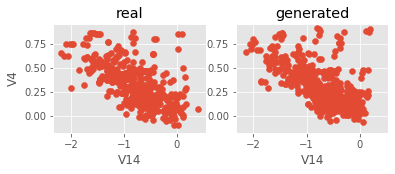

Iter: 91500; D loss: 1.304; G_loss: -0.6689; xgb_loss: 0.748


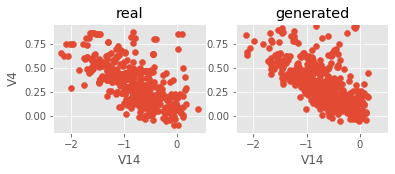

Iter: 91600; D loss: 1.299; G_loss: -0.6994; xgb_loss: 0.7053


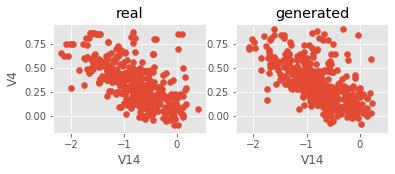

Iter: 91700; D loss: 1.318; G_loss: -0.6915; xgb_loss: 0.7297


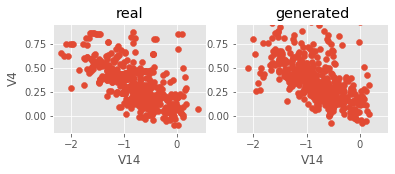

Iter: 91800; D loss: 1.319; G_loss: -0.6723; xgb_loss: 0.6484


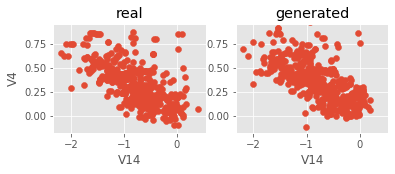

Iter: 91900; D loss: 1.324; G_loss: -0.6693; xgb_loss: 0.7317


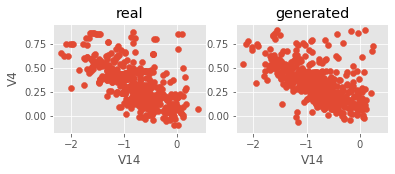

Iter: 92000; D loss: 1.286; G_loss: -0.6735; xgb_loss: 0.7073


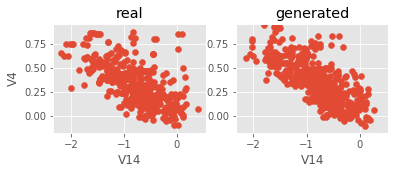

Iter: 92100; D loss: 1.304; G_loss: -0.6607; xgb_loss: 0.6748


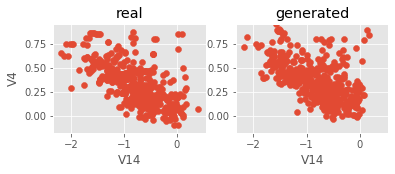

Iter: 92200; D loss: 1.297; G_loss: -0.6557; xgb_loss: 0.685


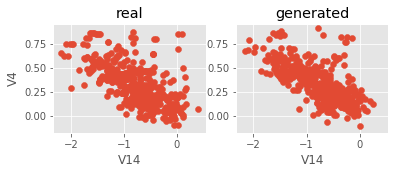

Iter: 92300; D loss: 1.32; G_loss: -0.6539; xgb_loss: 0.7195


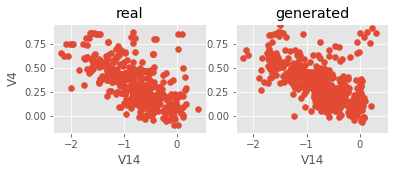

Iter: 92400; D loss: 1.297; G_loss: -0.6515; xgb_loss: 0.7073


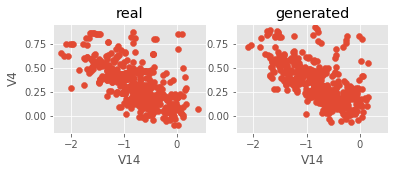

Iter: 92500; D loss: 1.311; G_loss: -0.6462; xgb_loss: 0.6565


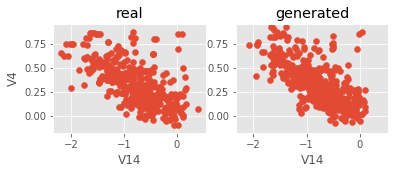

Iter: 92600; D loss: 1.312; G_loss: -0.6647; xgb_loss: 0.7195


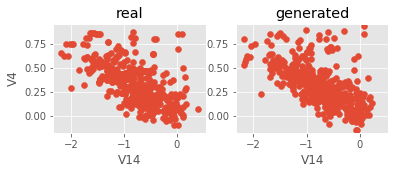

Iter: 92700; D loss: 1.311; G_loss: -0.6586; xgb_loss: 0.6504


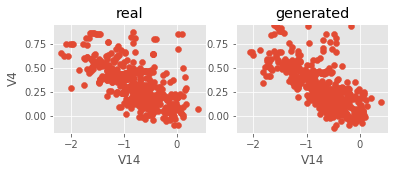

Iter: 92800; D loss: 1.316; G_loss: -0.6462; xgb_loss: 0.6504


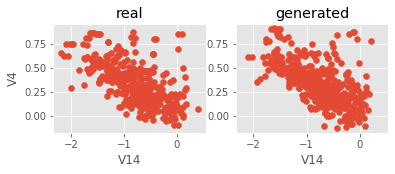

Iter: 92900; D loss: 1.316; G_loss: -0.6567; xgb_loss: 0.7337


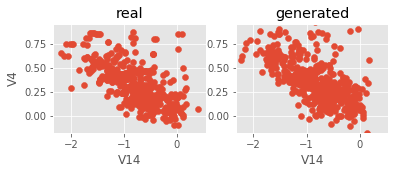

Iter: 93000; D loss: 1.314; G_loss: -0.6497; xgb_loss: 0.685


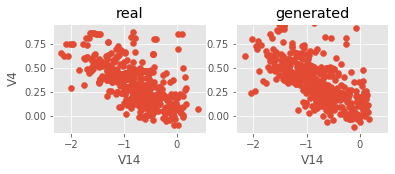

Iter: 93100; D loss: 1.323; G_loss: -0.6485; xgb_loss: 0.7134


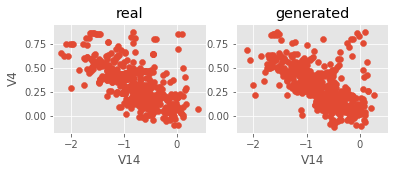

Iter: 93200; D loss: 1.317; G_loss: -0.6696; xgb_loss: 0.7378


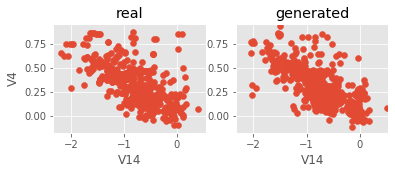

Iter: 93300; D loss: 1.311; G_loss: -0.672; xgb_loss: 0.7114


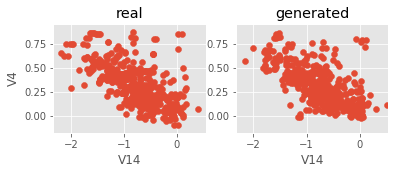

Iter: 93400; D loss: 1.315; G_loss: -0.6427; xgb_loss: 0.7053


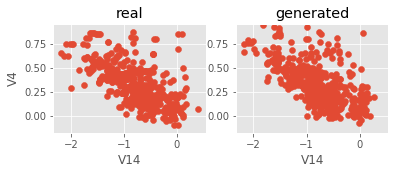

Iter: 93500; D loss: 1.301; G_loss: -0.6552; xgb_loss: 0.7236


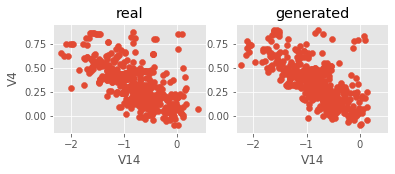

Iter: 93600; D loss: 1.308; G_loss: -0.6629; xgb_loss: 0.7154


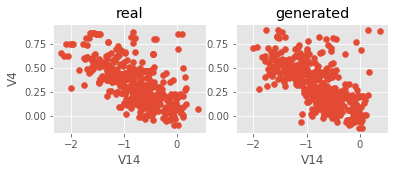

Iter: 93700; D loss: 1.323; G_loss: -0.6594; xgb_loss: 0.7419


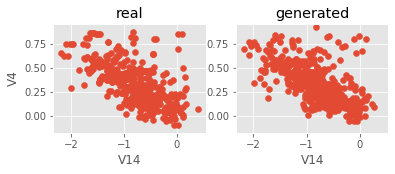

Iter: 93800; D loss: 1.291; G_loss: -0.6518; xgb_loss: 0.7012


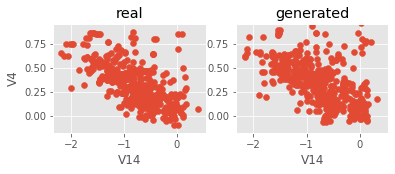

Iter: 93900; D loss: 1.296; G_loss: -0.6749; xgb_loss: 0.7154


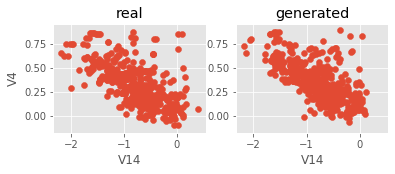

Iter: 94000; D loss: 1.307; G_loss: -0.6351; xgb_loss: 0.6565


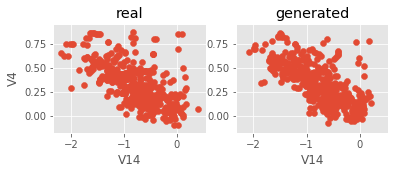

Iter: 94100; D loss: 1.303; G_loss: -0.654; xgb_loss: 0.7012


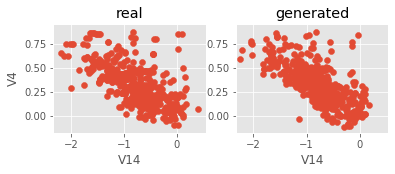

Iter: 94200; D loss: 1.3; G_loss: -0.6504; xgb_loss: 0.7561


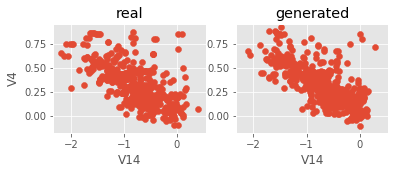

Iter: 94300; D loss: 1.32; G_loss: -0.662; xgb_loss: 0.685


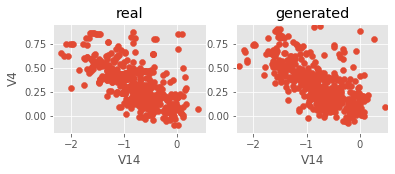

Iter: 94400; D loss: 1.304; G_loss: -0.6516; xgb_loss: 0.6362


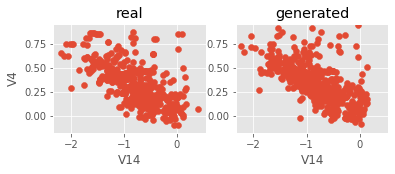

Iter: 94500; D loss: 1.306; G_loss: -0.658; xgb_loss: 0.6911


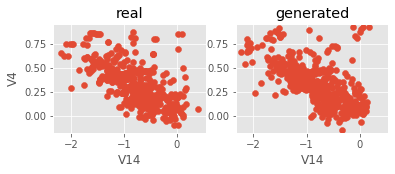

Iter: 94600; D loss: 1.332; G_loss: -0.6569; xgb_loss: 0.6809


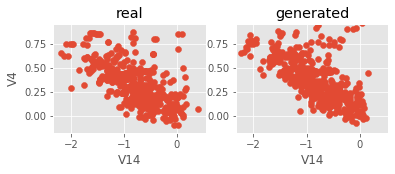

Iter: 94700; D loss: 1.319; G_loss: -0.6382; xgb_loss: 0.7033


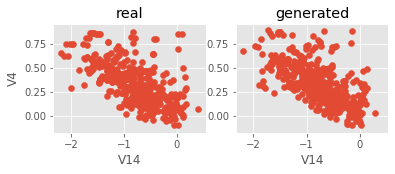

Iter: 94800; D loss: 1.298; G_loss: -0.6496; xgb_loss: 0.624


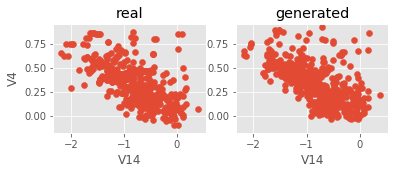

Iter: 94900; D loss: 1.32; G_loss: -0.6473; xgb_loss: 0.6829


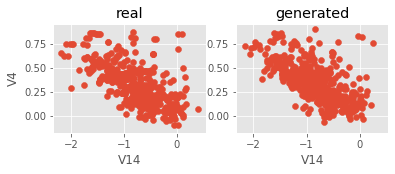

Iter: 95000; D loss: 1.298; G_loss: -0.659; xgb_loss: 0.6951


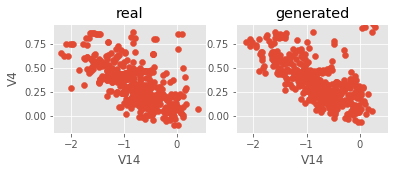

Iter: 95100; D loss: 1.315; G_loss: -0.6675; xgb_loss: 0.7154


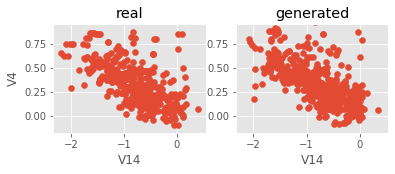

Iter: 95200; D loss: 1.315; G_loss: -0.6713; xgb_loss: 0.7195


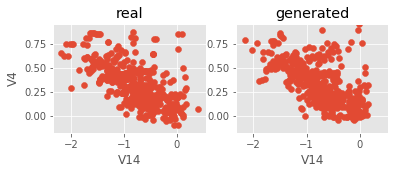

Iter: 95300; D loss: 1.302; G_loss: -0.6656; xgb_loss: 0.7378


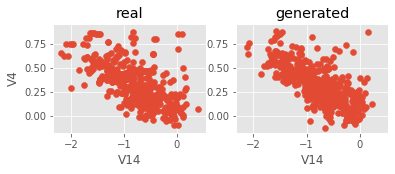

Iter: 95400; D loss: 1.331; G_loss: -0.6494; xgb_loss: 0.7297


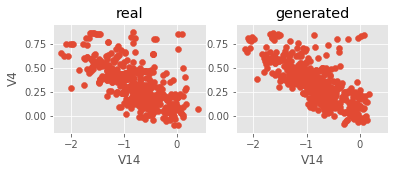

Iter: 95500; D loss: 1.292; G_loss: -0.682; xgb_loss: 0.7256


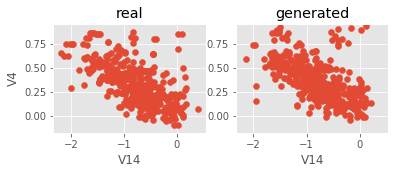

Iter: 95600; D loss: 1.307; G_loss: -0.6792; xgb_loss: 0.6972


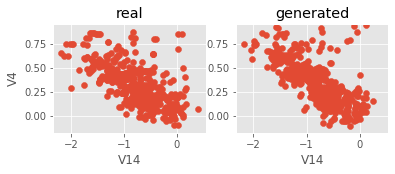

Iter: 95700; D loss: 1.307; G_loss: -0.676; xgb_loss: 0.6972


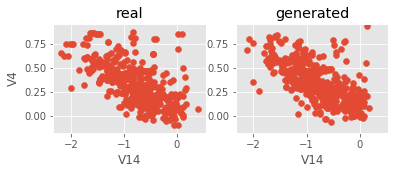

Iter: 95800; D loss: 1.309; G_loss: -0.66; xgb_loss: 0.685


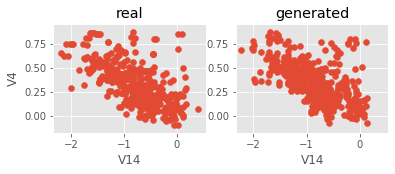

Iter: 95900; D loss: 1.31; G_loss: -0.6634; xgb_loss: 0.7093


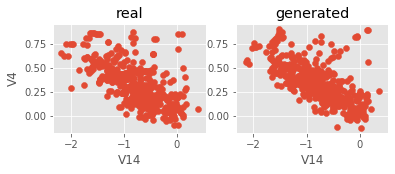

Iter: 96000; D loss: 1.308; G_loss: -0.6744; xgb_loss: 0.7012


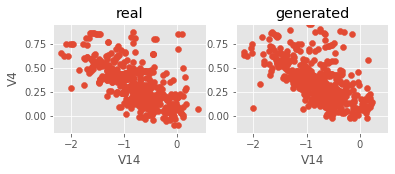

Iter: 96100; D loss: 1.315; G_loss: -0.6918; xgb_loss: 0.7317


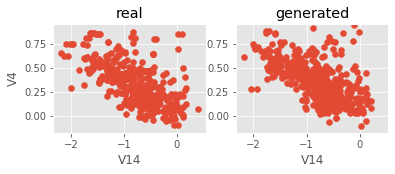

Iter: 96200; D loss: 1.313; G_loss: -0.6655; xgb_loss: 0.7215


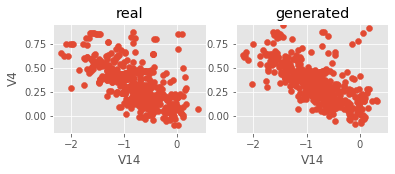

Iter: 96300; D loss: 1.316; G_loss: -0.6631; xgb_loss: 0.7276


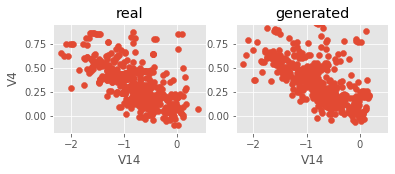

Iter: 96400; D loss: 1.314; G_loss: -0.673; xgb_loss: 0.7256


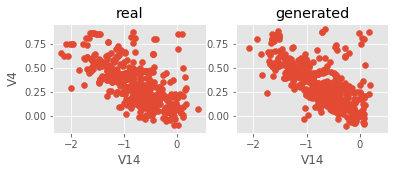

Iter: 96500; D loss: 1.316; G_loss: -0.6576; xgb_loss: 0.6931


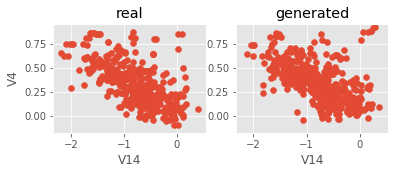

Iter: 96600; D loss: 1.307; G_loss: -0.6763; xgb_loss: 0.7114


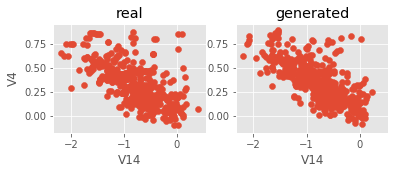

Iter: 96700; D loss: 1.31; G_loss: -0.6406; xgb_loss: 0.6911


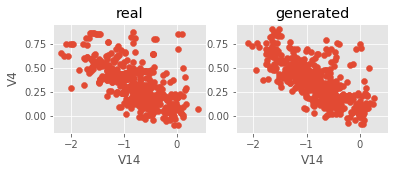

Iter: 96800; D loss: 1.329; G_loss: -0.6426; xgb_loss: 0.6809


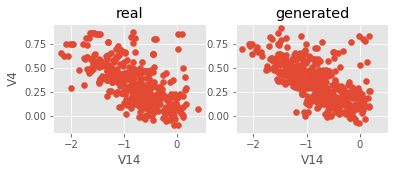

Iter: 96900; D loss: 1.322; G_loss: -0.6495; xgb_loss: 0.7215


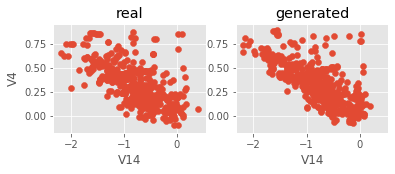

Iter: 97000; D loss: 1.306; G_loss: -0.6642; xgb_loss: 0.6972


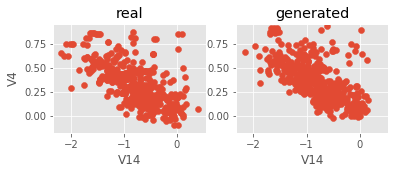

Iter: 97100; D loss: 1.308; G_loss: -0.7155; xgb_loss: 0.689


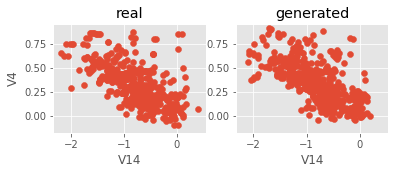

Iter: 97200; D loss: 1.323; G_loss: -0.6669; xgb_loss: 0.75


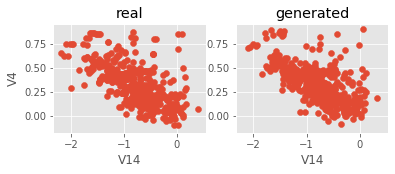

Iter: 97300; D loss: 1.318; G_loss: -0.6886; xgb_loss: 0.7297


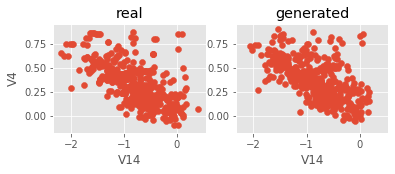

Iter: 97400; D loss: 1.305; G_loss: -0.6924; xgb_loss: 0.7317


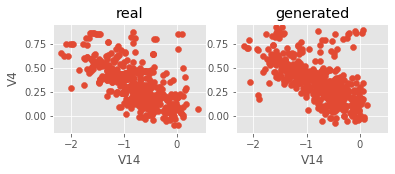

Iter: 97500; D loss: 1.3; G_loss: -0.7052; xgb_loss: 0.7236


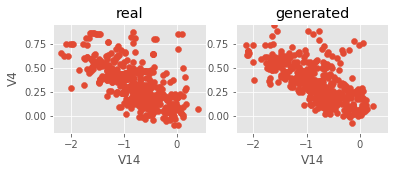

Iter: 97600; D loss: 1.31; G_loss: -0.6821; xgb_loss: 0.7053


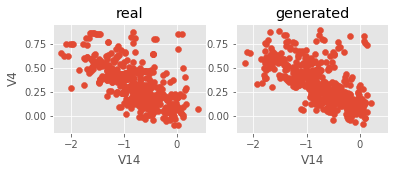

Iter: 97700; D loss: 1.319; G_loss: -0.7058; xgb_loss: 0.6768


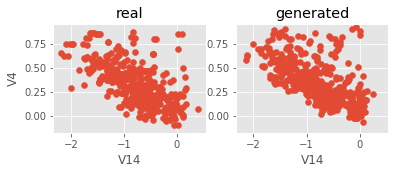

Iter: 97800; D loss: 1.312; G_loss: -0.672; xgb_loss: 0.7175


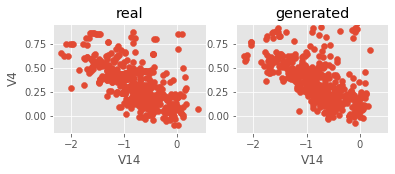

Iter: 97900; D loss: 1.288; G_loss: -0.6626; xgb_loss: 0.7154


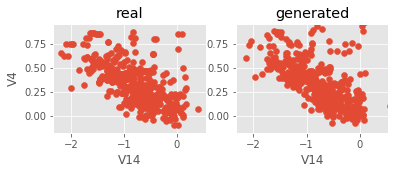

Iter: 98000; D loss: 1.308; G_loss: -0.6759; xgb_loss: 0.7093


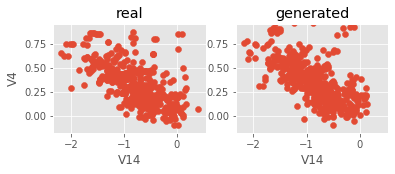

Iter: 98100; D loss: 1.288; G_loss: -0.6772; xgb_loss: 0.6972


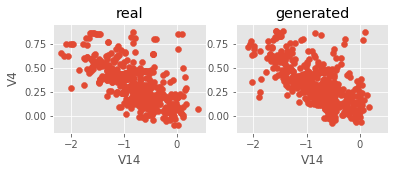

Iter: 98200; D loss: 1.312; G_loss: -0.6613; xgb_loss: 0.6972


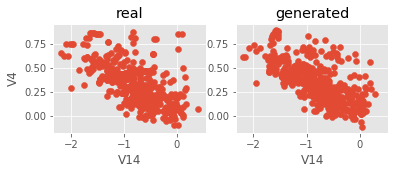

Iter: 98300; D loss: 1.314; G_loss: -0.6678; xgb_loss: 0.6931


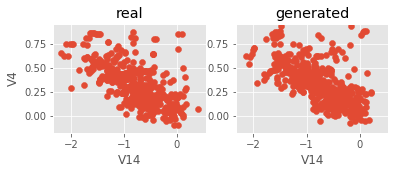

Iter: 98400; D loss: 1.316; G_loss: -0.6503; xgb_loss: 0.7114


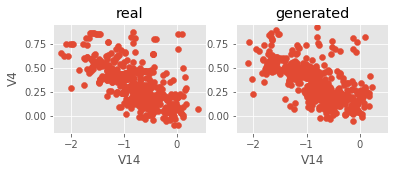

Iter: 98500; D loss: 1.322; G_loss: -0.6622; xgb_loss: 0.7073


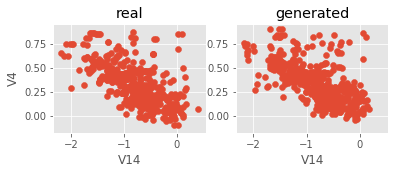

Iter: 98600; D loss: 1.319; G_loss: -0.6473; xgb_loss: 0.75


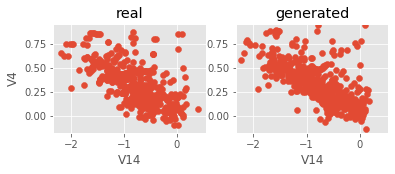

Iter: 98700; D loss: 1.307; G_loss: -0.6398; xgb_loss: 0.7358


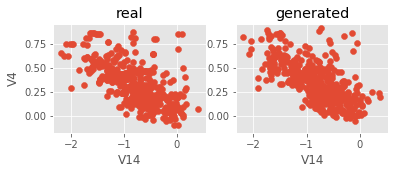

Iter: 98800; D loss: 1.323; G_loss: -0.6574; xgb_loss: 0.6707


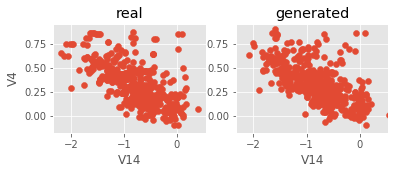

Iter: 98900; D loss: 1.302; G_loss: -0.6681; xgb_loss: 0.7378


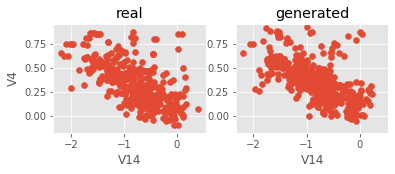

Iter: 99000; D loss: 1.319; G_loss: -0.6445; xgb_loss: 0.6748


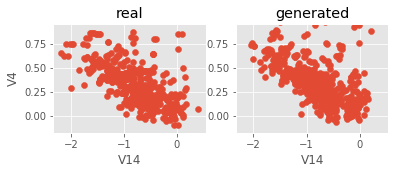

Iter: 99100; D loss: 1.309; G_loss: -0.6448; xgb_loss: 0.7317


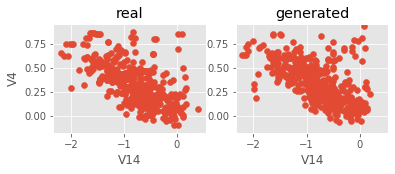

Iter: 99200; D loss: 1.319; G_loss: -0.644; xgb_loss: 0.687


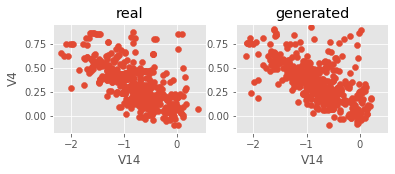

Iter: 99300; D loss: 1.303; G_loss: -0.6417; xgb_loss: 0.7093


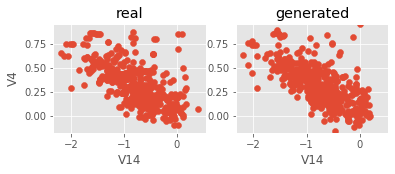

Iter: 99400; D loss: 1.321; G_loss: -0.6524; xgb_loss: 0.7317


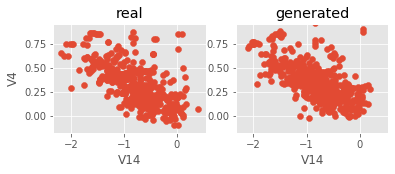

Iter: 99500; D loss: 1.325; G_loss: -0.6591; xgb_loss: 0.7033


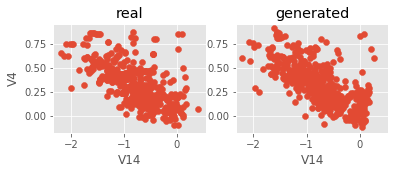

Iter: 99600; D loss: 1.309; G_loss: -0.6627; xgb_loss: 0.7134


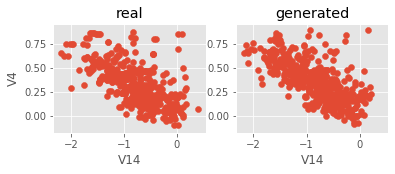

Iter: 99700; D loss: 1.334; G_loss: -0.6526; xgb_loss: 0.6748


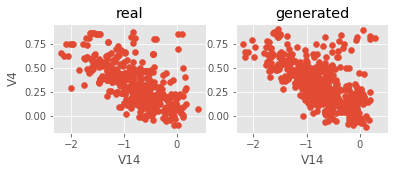

Iter: 99800; D loss: 1.306; G_loss: -0.657; xgb_loss: 0.7561


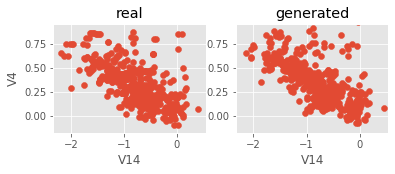

Iter: 99900; D loss: 1.316; G_loss: -0.6272; xgb_loss: 0.687


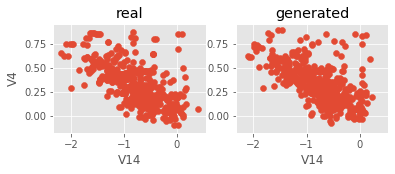

Iter: 100000; D loss: 1.316; G_loss: -0.6551; xgb_loss: 0.7154


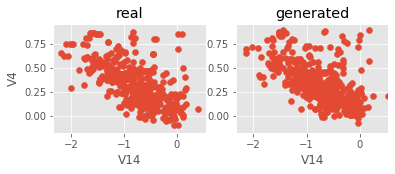

CPU times: user 27min 43s, sys: 2min 37s, total: 30min 21s
Wall time: 10min 38s


In [64]:
%%time

# for continued training

for it in range(50001, 100001):
    
    X_mb = get_data_batch(train, mb_size, seed=it)
    X_mb_p = get_perturbed_batch(X_mb) # DRAGAN

    _, D_loss_curr, d_l_r, d_l_g = sess.run(
        [D_solver, disc_cost, D_loss_real, D_loss_fake],
        feed_dict={X: X_mb, X_p: X_mb_p, z: sample_z(mb_size, z_dim)}
    )

    _, G_loss_curr = sess.run(
        [G_solver, gen_cost],
        feed_dict={z: sample_z(mb_size, z_dim)}
    )

    disc_loss_real.append(d_l_r)
    disc_loss_generated.append(d_l_g)
    combined_loss.append(G_loss_curr)
    
    if it % 100 == 0:
        test_size = 492 # mb_size
        x = get_data_batch(train, test_size, seed=it)
        g_z = sess.run(G_sample, feed_dict={z: sample_z(test_size, z_dim)})
        xgb_loss = CheckAccuracy( x, g_z, data_cols, label_cols, seed=0, with_class=with_class, data_dim=data_dim )
        xgb_losses.append(xgb_loss)
#         if xgb_loss < best_xgb: best_xgb = xgb_loss
            
    if it % log_interval == 0:
        print('Iter: {}; D loss: {:.4}; G_loss: {:.4}; xgb_loss: {:.4}'
              .format(it, D_loss_curr, G_loss_curr, xgb_loss))
        if show:
            PlotData( x, g_z, data_cols, label_cols, seed=0, with_class=with_class, data_dim=data_dim ) 
            
        saver.save(sess, data_dir + cache_prefix, global_step=it, write_meta_graph=False )

        pickle.dump([combined_loss, disc_loss_generated, disc_loss_real, xgb_losses], 
                        open( data_dir + cache_prefix + '_losses_step_{}.pkl'.format(it) ,'wb'))
    

In [65]:
# # For checking if you graph operations list has changed while you weren't looking
# print( len( sess.graph.get_operations() ) )

In [66]:
# # We should be able to import the graph and weights this way, we just need to redefine whatever operation we want to peform

# tf.reset_default_graph()
# sess = tf.Session()
# print( len( sess.graph.get_operations() ) )

# saver = tf.train.import_meta_graph(data_dir + cache_prefix + '.meta')
# print( len( sess.graph.get_operations() ) )

In [67]:
# Or we can just define the network like we did before and just load the weights
# That way we already have all the operations defined

# So, to load stored graph, with operations defined locally:

tf.reset_default_graph()
sess = tf.Session()
print( len( sess.graph.get_operations() ) )

[ D_solver, disc_cost, D_loss_real, D_loss_fake,
 X, X_p, z,
 G_solver, gen_cost, G_sample ] = \
    define_DRAGAN_network( X_dim=X_dim, h_dim=h_dim, z_dim=z_dim, learning_rate=learning_rate, mb_size=mb_size, seed=global_seed ) ;

sess = tf.Session()

np.random.seed(global_seed)
tf.set_random_seed(global_seed)
sess.graph.seed = global_seed

sess.run(tf.global_variables_initializer())

saver = tf.train.Saver( max_to_keep=10000 ) # 20 Mb+ for all, 1.5 Mb for thetas only

print( len( sess.graph.get_operations() ) )


0
1023


In [68]:
# To load saved weights and test

saver.restore(sess, data_dir + cache_prefix + '-45400' )

print( len( sess.graph.get_operations() ) )

g_z = sess.run(G_sample, feed_dict={z: sample_z(test_size, z_dim)})
# g_z


INFO:tensorflow:Restoring parameters from cache/DRAGAN-45400
1023


In [69]:
# %%time

# We can test the generated data using the functions from the 'GAN Data Testing' Section
# You'll need to load the functions from that section for this to work

# The labels for the generate data will all be 1, as they are supposed to be fraud data
g_z_df = pd.DataFrame( np.hstack( [g_z[:,:len(data_cols)], np.ones((len(g_z),1))] ), columns=data.columns )

n_train_fraud, train_real_set, test_real_set, train_fraud_set, test_fraud_set = MakeCrossFolds(g_z_df)
    
t_DRAGAN = Run_CV_Xgb(n_train_fraud, train_real_set, test_real_set, train_fraud_set, test_fraud_set)


NameError: name 'MakeCrossFolds' is not defined

In [70]:
# Looks like still no increase in recall

t_DRAGAN.groupby('ratio')[['recall']].aggregate(['mean','std'])

NameError: name 't_DRAGAN' is not defined

In [71]:

# To load saved losses

prefix = 'DRAGAN'

[combined_loss, disc_loss_generated, disc_loss_real, xgb_losses] = pickle.load(open(data_dir+prefix+'_losses_step_100000.pkl','rb'))


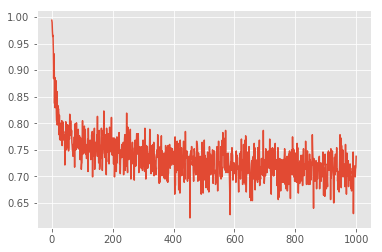

In [ ]:

# Let's look at the xgboost losses

w = 1
plt.plot( pd.DataFrame(xgb_losses[:]).rolling(w).mean() ) ;
# plt.savefig('plots/171031_xgb_loss_DRAGAN_lr1e-4_mb128_hdim128.png')

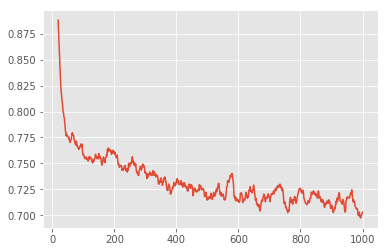

In [ ]:
# Let's look at the smoothed xgboost losses

w = 20
plt.plot( pd.DataFrame(xgb_losses[:]).rolling(w).mean() ) ;
# plt.savefig('plots/171031_xgb_loss_DRAGAN_lr1e-4_mb128_hdim128.png')

In [ ]:

# Let's find the best xgboost loss

best_step = xgb_losses.index( np.array(xgb_losses).min() ) * 100
print( best_step, np.array(xgb_losses).min() )

xgb100 = [ xgb_losses[i] for i in range(0, len(xgb_losses), 1) ]
best_step = xgb100.index( min(xgb100) ) * log_interval
print( best_step, min(xgb100) )

45400 0.621951219512
45400 0.621951219512


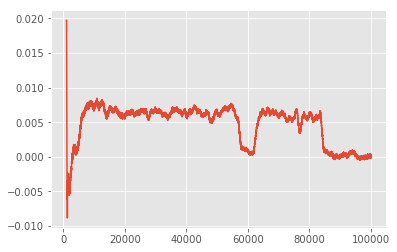

In [ ]:

# Let's look at training losses

# plt.plot( (np.array(disc_loss_real) - np.array(disc_loss_generated)) )

w = 1000
# plt.plot( list(range(0,5001,1)), pd.rolling_mean((np.array(disc_loss_real) - np.array(disc_loss_generated)),w) )
plt.plot( pd.DataFrame(disc_loss_real[:]).rolling(w).mean() - pd.DataFrame(disc_loss_generated[:]).rolling(w).mean() ) ;

# plt.ylim([-0.005,0.015])

# plt.xlim([50000,110000])
# plt.ylim([-0.001,0.002])